In [1]:
import os
import numpy as np
import pandas as pd
import multiprocessing
import tensorflow as tf
from sklearn.metrics import f1_score
from tensorflow.keras.utils import Sequence, to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras import metrics
from tensorflow.keras.callbacks import Callback
from typing import List, Tuple, Dict, Optional, Callable, Union

import random
import psutil
import time
from datetime import datetime
from threading import Thread
import queue
from dataclasses import dataclass
from concurrent.futures import ThreadPoolExecutor
from functools import partial
import logging
import matplotlib.pyplot as plt
from tqdm import tqdm
import seaborn as sns
import GPUtil

# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s'
)
logger = logging.getLogger(__name__)

# Basic Configuration
RND_SEED = 0
GPU_ID = 0
USE_GPU = True
IMG_SHAPE = (64, 64)

# Set random seeds
random.seed(RND_SEED)
np.random.seed(RND_SEED)
tf.random.set_seed(RND_SEED)

# GPU Setup
if tf.config.list_physical_devices('GPU') and USE_GPU:
    gpus = tf.config.list_physical_devices('GPU')
    try:
        # Configure GPU memory growth
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        gpu_name = gpus[0].name
        device = '/GPU:0'
        print(f"Using GPU - {gpu_name}")
    except Exception as e:
        print(f"GPU initialization failed: {e}")
        device = '/CPU:0'
else:
    device = '/CPU:0'
    print("Using CPU")

# Print system info
print(f"\nUsing device: {device}")
N_CPU_CORES = multiprocessing.cpu_count()
print(f"Number of CPU cores available: {N_CPU_CORES}")

# Set base folder
BASE_FOLDER = os.path.join("..", "input", "tlvmc-parkinsons-freezing-gait-prediction")

# Configure pandas display
pd.set_option('display.max_columns', 30)
pd.set_option('display.max_rows', 200)

with tf.device(device):
    pass

# Display memory info
memory = psutil.virtual_memory()
print(f"\nSystem Memory:")
print(f"Total RAM: {memory.total / (1024**3):.1f} GB")
print(f"Available RAM: {memory.available / (1024**3):.1f} GB")

Using GPU - /physical_device:GPU:0

Using device: /GPU:0
Number of CPU cores available: 12

System Memory:
Total RAM: 15.9 GB
Available RAM: 4.8 GB


In [2]:
try:
    from pynvml import *
    nvmlInit()
    NVIDIA_SMI_AVAILABLE = True
except Exception as e:
    NVIDIA_SMI_AVAILABLE = False
    print(f"Error initializing NVML: {e}")

print(f"NVIDIA_SMI: {NVIDIA_SMI_AVAILABLE}")

NVIDIA_SMI: True


In [3]:
class ResourceMonitor:
    """
    Monitor system resources during federated learning training.
    
    Attributes:
        interval: Sampling interval in seconds
        gpu_enabled: Whether GPU monitoring is enabled
        resources: Dictionary storing resource usage history
        is_monitoring: Flag to control monitoring thread
    """
    
    def __init__(self, interval: float = 1.0):
        self.interval = interval
        self.gpu_enabled = len(GPUtil.getGPUs()) > 0
        self.resources = {
            'timestamp': [],
            'cpu_percent': [],
            'memory_percent': [],
            'memory_used_gb': [],
            'gpu_utilization': [] if self.gpu_enabled else None,
            'gpu_memory_used': [] if self.gpu_enabled else None
        }
        self.is_monitoring = False
        self._start_time = None
        self._monitor_thread = None
        
    def start(self):
        """Start resource monitoring."""
        self._start_time = time.time()
        self.is_monitoring = True
        self._monitor_thread = threading.Thread(target=self._monitor_resources)
        self._monitor_thread.start()
        
    def stop(self):
        """Stop resource monitoring."""
        self.is_monitoring = False
        if self._monitor_thread:
            self._monitor_thread.join()
            
    def _monitor_resources(self):
        """Monitor system resources at specified intervals."""
        while self.is_monitoring:
            timestamp = time.time() - self._start_time
            
            # CPU and Memory
            cpu_percent = psutil.cpu_percent()
            memory = psutil.virtual_memory()
            
            self.resources['timestamp'].append(timestamp)
            self.resources['cpu_percent'].append(cpu_percent)
            self.resources['memory_percent'].append(memory.percent)
            self.resources['memory_used_gb'].append(memory.used / (1024**3))
            
            # GPU if available
            if self.gpu_enabled:
                gpus = GPUtil.getGPUs()
                gpu_util = np.mean([gpu.load * 100 for gpu in gpus])
                gpu_mem = np.mean([gpu.memoryUsed for gpu in gpus])
                self.resources['gpu_utilization'].append(gpu_util)
                self.resources['gpu_memory_used'].append(gpu_mem)
            
            time.sleep(self.interval)
    
    def plot_resources(self, figsize=(15, 10)):
        """Plot resource usage over time."""
        df = pd.DataFrame({
            'Time (s)': self.resources['timestamp'],
            'CPU (%)': self.resources['cpu_percent'],
            'Memory (%)': self.resources['memory_percent'],
            'Memory (GB)': self.resources['memory_used_gb']
        })
        
        num_plots = 4 if self.gpu_enabled else 3
        fig, axes = plt.subplots(num_plots, 1, figsize=figsize)
        
        # CPU Usage
        sns.lineplot(data=df, x='Time (s)', y='CPU (%)', ax=axes[0])
        axes[0].set_title('CPU Utilization')
        axes[0].grid(True)
        
        # Memory Percentage
        sns.lineplot(data=df, x='Time (s)', y='Memory (%)', ax=axes[1])
        axes[1].set_title('Memory Utilization')
        axes[1].grid(True)
        
        # Memory in GB
        sns.lineplot(data=df, x='Time (s)', y='Memory (GB)', ax=axes[2])
        axes[2].set_title('Memory Usage (GB)')
        axes[2].grid(True)
        
        # GPU if available
        if self.gpu_enabled:
            gpu_df = pd.DataFrame({
                'Time (s)': self.resources['timestamp'],
                'GPU (%)': self.resources['gpu_utilization'],
                'GPU Memory (MB)': self.resources['gpu_memory_used']
            })
            sns.lineplot(data=gpu_df, x='Time (s)', y='GPU (%)', ax=axes[3])
            axes[3].set_title('GPU Utilization')
            axes[3].grid(True)
        
        plt.tight_layout()
        plt.show()
    
    def get_summary(self) -> Dict[str, float]:
        """Get summary statistics of resource usage."""
        summary = {
            'duration_seconds': self.resources['timestamp'][-1],
            'avg_cpu_percent': np.mean(self.resources['cpu_percent']),
            'max_cpu_percent': max(self.resources['cpu_percent']),
            'avg_memory_gb': np.mean(self.resources['memory_used_gb']),
            'max_memory_gb': max(self.resources['memory_used_gb']),
            'avg_memory_percent': np.mean(self.resources['memory_percent']),
            'max_memory_percent': max(self.resources['memory_percent'])
        }
        
        if self.gpu_enabled:
            summary.update({
                'avg_gpu_percent': np.mean(self.resources['gpu_utilization']),
                'max_gpu_percent': max(self.resources['gpu_utilization']),
                'avg_gpu_memory_mb': np.mean(self.resources['gpu_memory_used']),
                'max_gpu_memory_mb': max(self.resources['gpu_memory_used'])
            })
            
        return summary

class ResourceMonitorCallback(tf.keras.callbacks.Callback):
    """Keras callback for resource monitoring during training."""
    
    def __init__(self, monitor: ResourceMonitor):
        super().__init__()
        self.monitor = monitor
    
    def on_train_begin(self, logs=None):
        self.monitor.start()
    
    def on_train_end(self, logs=None):
        self.monitor.stop()
        self.monitor.plot_resources()
        
        summary = self.monitor.get_summary()
        print("\nResource Usage Summary:")
        for key, value in summary.items():
            print(f"{key}: {value:.2f}")

In [4]:
monitor = ResourceMonitor(interval=1.0)  # Sample every second
monitor_callback = ResourceMonitorCallback(monitor)

In [5]:
logging.getLogger().handlers.clear()  # Clear any existing handlers
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    force=True
)

class GafGenerator(Sequence):
    """
    Generator for Gramian Angular Field images with caching and error handling.
    Minimal augmentation to preserve GAF properties.
    """
    
    def __init__(
        self,
        directories: List[str],
        batch_size: int = 32,
        image_size: Tuple[int, int] = (64, 64),
        shuffle: bool = True,
        augment: bool = False,
        num_classes: int = 2,
        num_workers: int = 4,
        max_cache_size: int = 1000
    ):
        try:
            self.directories = self._validate_directories(directories)
            self.batch_size = batch_size
            self.image_size = image_size
            self.shuffle = shuffle
            self.augment = augment
            self.num_classes = num_classes
            self.num_workers = num_workers
            
            self.max_cache_size = max_cache_size
            self.cache = {}
            
            self.image_paths = self._load_paths()
            self.samples = len(self.image_paths[0])
            
            self.executor = ThreadPoolExecutor(max_workers=num_workers)
            
            self.datagen = ImageDataGenerator(
                rescale=1/255.0,
                brightness_range=(0.95, 1.05) if augment else None
            )
            
            logging.info(f"Initialized generator with {self.samples} samples")
            self._display_class_distribution()
            
            self.on_epoch_end()
            
        except Exception as e:
            logging.error(f"Initialization failed: {str(e)}")
            raise

    # Remove _setup_logging method

    def _display_class_distribution(self):
        try:
            distribution = {}
            for path in self.image_paths[0]:
                label = self._get_class_from_filename(os.path.basename(path))
                distribution[label] = distribution.get(label, 0) + 1
            
            logging.info("\nClass distribution:")
            for label, count in sorted(distribution.items()):
                percentage = (count/self.samples) * 100
                logging.info(f"Class {label}: {count} images ({percentage:.1f}%)")
        except Exception as e:
            logging.error(f"Error calculating class distribution: {str(e)}")

    def _validate_directories(self, directories: List[str]) -> List[str]:
        """Validate input directories"""
        for directory in directories:
            if not os.path.exists(directory):
                raise ValueError(f"Directory not found: {directory}")
            if not os.listdir(directory):
                raise ValueError(f"Directory is empty: {directory}")
        return directories

    def _load_paths(self) -> List[List[str]]:
        """Load and validate image paths"""
        image_paths = []
        for directory in self.directories:
            branch_paths = sorted([
                os.path.join(directory, fname) 
                for fname in os.listdir(directory) 
                if fname.lower().endswith(('.jpg', '.png', '.jpeg'))
            ])
            
            if not branch_paths:
                raise ValueError(f"No valid images found in {directory}")
            
            image_paths.append(branch_paths)
            logging.info(f"Loaded {len(branch_paths)} images from {directory}")
            
        return image_paths
    
    def _display_class_distribution(self):
        """Display class distribution in the dataset"""
        try:
            distribution = {}
            for path in self.image_paths[0]:
                label = self._get_class_from_filename(os.path.basename(path))
                distribution[label] = distribution.get(label, 0) + 1
            
            logging.info("\nClass distribution:")
            for label, count in sorted(distribution.items()):
                percentage = (count/self.samples) * 100
                logging.info(f"Class {label}: {count} images ({percentage:.1f}%)")
        except Exception as e:
            logging.error(f"Error calculating class distribution: {str(e)}")

    def _load_and_process_image(self, path: str) -> np.ndarray:
        """Load and process a single image with caching"""
        try:
            if path in self.cache:
                return self.cache[path]
            
            image = img_to_array(load_img(path, target_size=self.image_size))
            
            if len(self.cache) < self.max_cache_size:
                self.cache[path] = image
                
            return image
            
        except Exception as e:
            logging.error(f"Error loading image {path}: {str(e)}")
            raise

    def __len__(self) -> int:
        """Get number of batches per epoch"""
        return int(np.ceil(self.samples / self.batch_size))

    def __getitem__(self, index: int) -> Tuple[List[np.ndarray], np.ndarray]:
        """Get batch at position index"""
        try:
            batch_paths = [
                paths[index * self.batch_size:(index + 1) * self.batch_size]
                for paths in self.image_paths
            ]
            
            # Process images
            images_per_branch = []
            for branch_paths in batch_paths:
                # Load images in parallel
                load_fn = partial(self._load_and_process_image)
                images = list(self.executor.map(load_fn, branch_paths))
                images = np.array(images)
                
                # Apply standardization
                images = self.datagen.standardize(images)
                images_per_branch.append(images)
            
            labels = np.array([
                self._get_class_from_filename(os.path.basename(path))
                for path in batch_paths[0]
            ])
            labels = to_categorical(labels, num_classes=self.num_classes)
            
            return images_per_branch, labels
            
        except Exception as e:
            logging.error(f"Error generating batch {index}: {str(e)}")
            raise

    def on_epoch_end(self):
        """Handle end of epoch operations"""
        if self.shuffle:
            for branch_paths in self.image_paths:
                np.random.shuffle(branch_paths)
            logging.info("Shuffled data for next epoch")

    def _get_class_from_filename(self, filename: str) -> int:
        """Extract class label from filename"""
        try:
            return int(filename.split('_')[-1].split('.')[0])
        except Exception as e:
            logging.error(f"Error parsing class from filename {filename}: {str(e)}")
            raise

    def cleanup(self):
        """Cleanup resources"""
        try:
            self.executor.shutdown()
            self.cache.clear()
            logging.info("Successfully cleaned up resources")
        except Exception as e:
            logging.error(f"Error during cleanup: {str(e)}")

    def get_data_distribution(self) -> Dict:
        """Get dataset statistics"""
        try:
            stats = {
                "total_samples": self.samples,
                "batches_per_epoch": len(self),
                "classes": {},
                "samples_per_directory": {
                    os.path.basename(d): len(p) 
                    for d, p in zip(self.directories, self.image_paths)
                }
            }
            
            for path in self.image_paths[0]:
                label = self._get_class_from_filename(os.path.basename(path))
                stats["classes"][label] = stats["classes"].get(label, 0) + 1
                
            return stats
        except Exception as e:
            logging.error(f"Error getting data distribution: {str(e)}")
            raise

In [6]:
class PerClassF1Score(tf.keras.metrics.Metric):
    """
    Custom metric to calculate per-class F1 scores for multi-class classification.
    
    Attributes:
        num_classes (int): Number of classes in the classification problem
        tp (tf.Variable): True positives counter for each class
        fp (tf.Variable): False positives counter for each class
        fn (tf.Variable): False negatives counter for each class
    """
    
    def __init__(self, num_classes: int, name: str = 'per_class_f1', **kwargs):
        super().__init__(name=name, **kwargs)
        self.num_classes = num_classes
        # Initialize metrics trackers
        self.tp = self.add_weight(shape=(num_classes,), initializer='zeros', name='tp')
        self.fp = self.add_weight(shape=(num_classes,), initializer='zeros', name='fp')
        self.fn = self.add_weight(shape=(num_classes,), initializer='zeros', name='fn')
    
    def update_state(self, y_true: tf.Tensor, y_pred: tf.Tensor, 
                    sample_weight: Optional[tf.Tensor] = None) -> None:
        """
        Updates the state variables of the metric.
        
        Args:
            y_true: Ground truth labels
            y_pred: Model predictions
            sample_weight: Optional sample weights
        """
        y_pred = tf.argmax(y_pred, axis=1)
        y_true = tf.argmax(y_true, axis=1)
        
        for i in range(self.num_classes):
            y_true_class = tf.cast(tf.equal(y_true, i), tf.float32)
            y_pred_class = tf.cast(tf.equal(y_pred, i), tf.float32)
            
            true_positives = tf.reduce_sum(y_true_class * y_pred_class)
            false_positives = tf.reduce_sum((1 - y_true_class) * y_pred_class)
            false_negatives = tf.reduce_sum(y_true_class * (1 - y_pred_class))
            
            self.tp.assign(tf.tensor_scatter_nd_add(self.tp, [[i]], [true_positives]))
            self.fp.assign(tf.tensor_scatter_nd_add(self.fp, [[i]], [false_positives]))
            self.fn.assign(tf.tensor_scatter_nd_add(self.fn, [[i]], [false_negatives]))

    def result(self) -> tf.Tensor:
        """Computes and returns the metric result."""
        precision = self.tp / (self.tp + self.fp + tf.keras.backend.epsilon())
        recall = self.tp / (self.tp + self.fn + tf.keras.backend.epsilon())
        f1_scores = 2 * precision * recall / (precision + recall + tf.keras.backend.epsilon())
        return f1_scores

    def reset_state(self) -> None:
        """Resets all metric state variables."""
        self.tp.assign(tf.zeros_like(self.tp))
        self.fp.assign(tf.zeros_like(self.fp))
        self.fn.assign(tf.zeros_like(self.fn))

    def get_config(self) -> Dict:
        """Returns the config dictionary for serialization."""
        config = super().get_config()
        config.update({"num_classes": self.num_classes})
        return config

class MetricsDisplayCallback(Callback):
    """
    Callback to display and visualize per-class metrics during training.
    
    Attributes:
        num_classes (int): Number of classes in the classification problem
        class_names (List[str]): Optional list of class names for better visualization
    """
    
    def __init__(self, num_classes: int, class_names: Optional[List[str]] = None):
        super().__init__()
        self.num_classes = num_classes
        self.class_names = class_names or [f"Class {i}" for i in range(num_classes)]
        self.history = {
            'precision': [],
            'recall': [],
            'f1_scores': []
        }
        
    def on_epoch_begin(self, epoch: int, logs: Optional[Dict] = None) -> None:
        """Called at the beginning of each epoch."""
        print(f"\nEpoch {epoch + 1}")
        
    def on_epoch_end(self, epoch: int, logs: Optional[Dict] = None) -> None:
        """
        Called at the end of each epoch to display and visualize metrics.
        
        Args:
            epoch: Current epoch number
            logs: Dictionary containing metric results
        """
        metrics = self.model.metrics
        f1_metric = next((m for m in metrics if isinstance(m, PerClassF1Score)), None)
        
        if f1_metric:
            precision = f1_metric.tp / (f1_metric.tp + f1_metric.fp + tf.keras.backend.epsilon())
            recall = f1_metric.tp / (f1_metric.tp + f1_metric.fn + tf.keras.backend.epsilon())
            f1_scores = f1_metric.result()
            
            # Convert to numpy for easier handling
            precision = precision.numpy()
            recall = recall.numpy()
            f1_scores = f1_scores.numpy()
            
            # Store metrics history
            self.history['precision'].append(precision)
            self.history['recall'].append(recall)
            self.history['f1_scores'].append(f1_scores)
            
            # Display metrics table
            self._display_metrics_table(precision, recall, f1_scores)
            
            # Plot metrics
            self._plot_metrics(precision, recall, f1_scores)
            
        # Display other metrics
        print("\nOther metrics:")
        for metric_name, value in (logs or {}).items():
            if metric_name != 'per_class_f1':
                if isinstance(value, (np.ndarray, tf.Tensor)):
                    value = float(np.mean(value.numpy() if hasattr(value, 'numpy') else value))
                print(f"{metric_name}: {value:.4f}")
    
    def _display_metrics_table(self, precision: np.ndarray, recall: np.ndarray, 
                             f1_scores: np.ndarray) -> None:
        """Displays a formatted table of metrics."""
        df = pd.DataFrame({
            'Class': self.class_names,
            'Precision': precision,
            'Recall': recall,
            'F1-Score': f1_scores
        })
        
        print("\nPer-class metrics:")
        print(df.to_string(index=False, float_format=lambda x: f"{x:.4f}"))
        
        # Display averages
        averages = pd.DataFrame({
            'Class': ['Average'],
            'Precision': [precision.mean()],
            'Recall': [recall.mean()],
            'F1-Score': [f1_scores.mean()]
        })
        print("\nAverages:")
        print(averages.to_string(index=False, float_format=lambda x: f"{x:.4f}"))
    
    def _plot_metrics(self, precision: np.ndarray, recall: np.ndarray, 
                     f1_scores: np.ndarray) -> None:
        """Creates and displays visualization of metrics."""
        plt.figure(figsize=(15, 5))
        
        # Bar plot of all metrics
        x = np.arange(len(self.class_names))
        width = 0.25
        
        plt.bar(x - width, precision, width, label='Precision')
        plt.bar(x, recall, width, label='Recall')
        plt.bar(x + width, f1_scores, width, label='F1-Score')
        
        plt.xlabel('Classes')
        plt.ylabel('Score')
        plt.title('Per-class Performance Metrics')
        plt.xticks(x, self.class_names, rotation=45)
        plt.legend()
        plt.tight_layout()
        plt.show()

In [7]:
DEBUG = True

In [8]:
class FederatedClient:
    """Client in federated learning system"""
    
    def __init__(self, client_id: int, model_fn, train_generator, valid_generator=None):
        self.client_id = client_id
        self.model = model_fn()
        
        metrics = [
            'accuracy',
            tf.keras.metrics.Precision(name='precision'),
            tf.keras.metrics.Recall(name='recall'),
            PerClassF1Score(num_classes=train_generator.num_classes)
        ]
        
        self.model.compile(
            optimizer=self.model.optimizer,
            loss=self.model.loss,
            metrics=metrics
        )
        self.train_generator = train_generator
        self.valid_generator = valid_generator
        self.best_weights = None
        self.best_val_loss = float('inf')
        
        if DEBUG:
            print(f"\nClient {client_id} Initialization:")
            print(f"Training samples: {train_generator.samples}")
            if valid_generator:
                print(f"Validation samples: {valid_generator.samples}")
    
    def train(self, global_weights, local_epochs: int, 
              patience: int = 3, 
              verbose: int = 1,
              callbacks: List = None) -> Tuple[List[np.ndarray], Dict]:
        """
        Args:
            global_weights: Weights from the global model
            local_epochs: Number of epochs to train locally
            patience: Early stopping patience
            verbose: Verbosity mode (0 = silent, 1 = progress bar, 2 = one line per epoch)
            callbacks: List of additional Keras callbacks
            
        Returns:
            Tuple of (updated weights, training history)
        """
        self.model.set_weights(global_weights)
        
        if callbacks is None:
            callbacks = []
            
        callbacks.append(
            tf.keras.callbacks.EarlyStopping(
                monitor='val_loss',
                patience=patience,
                restore_best_weights=True
            )
        )
        print(f"\n{'='*20} Training Client {self.client_id + 1} {'='*20}")
        
        best_val_loss = float('inf')
        best_weights = None
        patience_counter = 0
        
        history = {
            'val_loss': [], 'loss': [], 'per_class_f1': [], 
            'accuracy': [], 'precision': [], 'recall': [], 
            'val_accuracy': [], 'val_precision': [], 'val_recall': []
        }
        
        for epoch in tqdm(range(local_epochs), desc="Local epochs"):
            epoch_history = self.model.fit(
                self.train_generator,
                epochs=1,
                validation_data=self.valid_generator,
                verbose=verbose,
                callbacks=callbacks
            ).history
            
            # Update history
            for key in epoch_history:
                if key not in history:
                    history[key] = []
                history[key].extend(epoch_history[key])
            
            # Print epoch summary
            print(f"\nEpoch {epoch+1}/{local_epochs}")
            print(f"Loss: {epoch_history['loss'][0]:.4f}, Val Loss: {epoch_history['val_loss'][0]:.4f}")
            print(f"Accuracy: {epoch_history['accuracy'][0]:.4f}, Val Accuracy: {epoch_history['val_accuracy'][0]:.4f}")
            
            # Early stopping check
            current_val_loss = epoch_history['val_loss'][0]
            if current_val_loss < best_val_loss:
                best_val_loss = current_val_loss
                best_weights = self.model.get_weights()
                patience_counter = 0
            else:
                patience_counter += 1
            
            if patience_counter >= patience:
                print(f"Early stopping triggered for client {self.client_id}")
                break
        
        # Update best weights
        if best_val_loss < self.best_val_loss:
            self.best_val_loss = best_val_loss
            self.best_weights = best_weights
        
        return best_weights, history

In [9]:
from typing import List, Dict, Optional, Union, Callable
MetricValue = Union[float, np.ndarray]
MetricsDict = Dict[str, MetricValue]

@dataclass
class FederatedMetrics:
    """Stores metrics for federated learning rounds."""
    round_number: int
    client_metrics: List[MetricsDict]
    global_metrics: Optional[MetricsDict] = None

class FederatedServer:
    """
    Central server for federated learning that coordinates model aggregation.
    
    Attributes:
        global_model: Global model that aggregates client updates
        clients: List of federated clients
        best_global_weights: Best performing model weights
        best_global_val_loss: Best validation loss achieved
        metrics_history: List of metrics from all training rounds
    """
    def __init__(self, model_fn: Callable[[], tf.keras.Model]):
        self.global_model = model_fn()
        self.clients: List['FederatedClient'] = []
        self.best_global_weights = None
        self.best_global_val_loss = float('inf')
        self.metrics_history: List[FederatedMetrics] = []
        
    def add_client(self, client: 'FederatedClient') -> None:
        """Add a client to the federated learning system."""
        self.clients.append(client)
    
    def aggregate_weights(self, 
                         client_weights: List[List[np.ndarray]], 
                         client_val_losses: List[float]) -> List[np.ndarray]:
        """
        Aggregate client weights using validation loss-based weighted averaging.
        
        Args:
            client_weights: List of weight arrays from each client
            client_val_losses: Validation losses from each client
            
        Returns:
            Aggregated model weights
        """
        # Compute weight factors inversely proportional to validation loss
        total_inverse_loss = sum(1/loss for loss in client_val_losses)
        client_weights_factors = [(1/val_loss)/total_inverse_loss for val_loss in client_val_losses]
        
        # Apply weights to client updates
        weighted_weights = [
            [w * factor for w in weights]
            for weights, factor in zip(client_weights, client_weights_factors)
        ]
        
        # Average weights across clients
        averaged_weights = [
            sum(weights_list) 
            for weights_list in zip(*weighted_weights)
        ]
        
        return averaged_weights

    def evaluate(self, test_generator) -> List[float]:
        """Evaluate the global model on test data."""
        return self.global_model.evaluate(test_generator, verbose=0)
    
    def plot_training_history(self) -> None:
        """Plot training metrics history."""
        metrics_df = self._create_metrics_dataframe()
        
        # Plot regular metrics
        regular_metrics = [col for col in metrics_df.columns if 'Class' not in col]
        if regular_metrics:
            plt.figure(figsize=(12, 6))
            for metric in regular_metrics:
                plt.plot(metrics_df.index, metrics_df[metric], label=metric)
            plt.xlabel('Round')
            plt.ylabel('Metric Value')
            plt.title('Training Metrics Over Rounds')
            plt.legend()
            plt.grid(True)
            plt.show()
        
        # Plot per-class F1 scores if available
        f1_metrics = [col for col in metrics_df.columns if 'Class' in col]
        if f1_metrics:
            plt.figure(figsize=(12, 6))
            for metric in f1_metrics:
                plt.plot(metrics_df.index, metrics_df[metric], label=metric)
            plt.xlabel('Round')
            plt.ylabel('F1 Score')
            plt.title('Per-class F1 Scores Over Rounds')
            plt.legend()
            plt.grid(True)
            plt.show()
    
    def _create_metrics_dataframe(self) -> pd.DataFrame:
        """Create a DataFrame from training metrics history."""
        regular_metrics = {}
        f1_metrics = {}
        
        for round_metrics in self.metrics_history:
            round_num = round_metrics.round_number
            for metric_name, value in round_metrics.global_metrics.items():
                if metric_name == 'per_class_f1':
                    for i, score in enumerate(value):
                        f1_metrics.setdefault(f'Class {i} F1', []).append(score)
                else:
                    regular_metrics.setdefault(metric_name, []).append(value)
        
        metrics_df = pd.DataFrame(regular_metrics)
        if f1_metrics:
            f1_df = pd.DataFrame(f1_metrics)
            metrics_df = pd.concat([metrics_df, f1_df], axis=1)
        
        metrics_df.index = [f'Round {i+1}' for i in range(len(self.metrics_history))]
        return metrics_df


In [10]:
def split_data_for_clients(
    train_generator: 'GafGenerator',
    num_clients: int
) -> List[List[List[str]]]:
    """
    Split training data among federated clients.
    
    Args:
        train_generator: Data generator containing all training data
        num_clients: Number of clients to split data between
        
    Returns:
        List of data splits for each client
    """
    image_paths_list = train_generator.image_paths
    total_samples = len(image_paths_list[0])
    assert all(len(paths) == total_samples for paths in image_paths_list)
    
    indices = list(range(total_samples))
    if train_generator.shuffle:
        random.shuffle(indices)
    
    # Split indices among clients
    samples_per_client = total_samples // num_clients
    client_indices = [
        indices[i * samples_per_client:(i + 1) * samples_per_client]
        for i in range(num_clients)
    ]
    
    # Handle remaining samples
    if total_samples % num_clients != 0:
        remaining = indices[num_clients * samples_per_client:]
        client_indices[-1].extend(remaining)
    
    # Create client datasets
    return [
        [[branch_paths[i] for i in client_idx] for branch_paths in image_paths_list]
        for client_idx in client_indices
    ]

def train_federated(
    server: FederatedServer,
    num_rounds: int,
    local_epochs: int,
    test_generator: Optional['GafGenerator'] = None,
    local_patience: int = 3,
    global_patience: int = 5,
    verbose: int = 1
) -> List[FederatedMetrics]:
    """
    Train a federated learning system.
    
    Args:
        server: Federated learning server
        num_rounds: Number of federated learning rounds
        local_epochs: Number of epochs for local client training
        test_generator: Optional generator for evaluation
        local_patience: Early stopping patience for client training
        global_patience: Early stopping patience for global model
        verbose: Whether to print detailed progress
        
    Returns:
        List of training metrics for each round
    """
    global_patience_counter = 0
    best_global_val_loss = float('inf')
    callbacks = [
        MetricsDisplayCallback(num_classes=2),
        ResourceMonitorCallback(monitor),
        tf.keras.callbacks.ModelCheckpoint(
            'best_model.h5',
            monitor='val_accuracy',
            save_best_only=True,
            mode='max',
            verbose=1
        )
    ]
    for round_num in tqdm(range(num_rounds), desc='Federated Learning Rounds'):
        if verbose:
            print(f"\nFederated Learning Round {round_num + 1}/{num_rounds}")
        
        # Get current global weights
        global_weights = server.global_model.get_weights()
        
        # Train clients
        client_weights = []
        client_metrics = []
        client_val_losses = []
        
        for client in (tqdm(server.clients, desc='Training Clients') if verbose else server.clients):
            weights, metrics = client.train(
                global_weights,
                local_epochs=local_epochs,
                patience=local_patience,
                verbose=verbose if verbose <= 1 else 1,
                callbacks=callbacks
            )
            client_weights.append(weights)
            client_val_losses.append(metrics['val_loss'][-1])
            client_metrics.append(metrics)
        
        # Aggregate weights
        new_global_weights = server.aggregate_weights(client_weights, client_val_losses)
        server.global_model.set_weights(new_global_weights)
        
        # Evaluate global model
        test_results = None
        if test_generator is not None:
            test_metrics = server.evaluate(test_generator)
            test_results = dict(zip(server.global_model.metrics_names, test_metrics))
            
            if verbose:
                print("\nTest metrics:")
                _print_metrics(test_results)
            
            # Global early stopping
            current_val_loss = test_results['loss']
            if current_val_loss < best_global_val_loss:
                best_global_val_loss = current_val_loss
                server.best_global_weights = new_global_weights
                global_patience_counter = 0
            else:
                global_patience_counter += 1
            
            if global_patience_counter >= global_patience:
                if verbose:
                    print("\nGlobal early stopping triggered")
                server.global_model.set_weights(server.best_global_weights)
                break
        
        # Record metrics
        round_metrics = FederatedMetrics(
            round_number=round_num,
            client_metrics=client_metrics,
            global_metrics=test_results
        )
        server.metrics_history.append(round_metrics)
        
        if verbose:
            print("\nRound Summary:")
            _print_metrics(_aggregate_client_metrics(client_metrics))
    
    # Plot training history
    server.plot_training_history()
    
    return server.metrics_history

def _print_metrics(metrics: Dict[str, Union[float, np.ndarray]]) -> None:
    """Helper function to print metrics in a formatted way."""
    for metric_name, value in metrics.items():
        if metric_name == 'per_class_f1':
            print("\nPer-class F1 scores:")
            for class_idx, f1_score in enumerate(value):
                print(f"Class {class_idx}: {float(f1_score):.4f}")
        else:
            if isinstance(value, (np.ndarray, tf.Tensor)):
                value = float(np.mean(value))
            print(f"{metric_name}: {value:.4f}")

def _aggregate_client_metrics(
    client_metrics: List[Dict[str, List[Union[float, np.ndarray]]]]
) -> Dict[str, Union[float, np.ndarray]]:
    """Aggregate metrics across clients."""
    aggregated = {}
    for metric in client_metrics[0].keys():
        if metric == 'per_class_f1':
            f1_scores = np.stack([cm[metric][-1] for cm in client_metrics])
            aggregated[metric] = np.mean(f1_scores, axis=0)
        else:
            aggregated[metric] = np.mean([cm[metric][-1] for cm in client_metrics])
    return aggregated

In [11]:
img_shape=(64, 64)

In [12]:
# Define paths and parameters
train_directories = ["data/AccAP/train", "data/AccML/train", "data/AccV/train"]
val_directories = ["data/AccAP/valid", "data/AccML/valid", "data/AccV/valid"]

# Configure logging to avoid duplicates
logging.getLogger().handlers.clear()
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    force=True
)

print("\n=== Initializing Data Generators ===")

train_generator = GafGenerator(
    directories=train_directories,
    batch_size=32,
    image_size=img_shape,
    shuffle=True,
    augment=True,
    num_classes=2,
    num_workers=4,
    max_cache_size=1000
)

print("\n=== Training Data Statistics ===")
train_stats = train_generator.get_data_distribution()
print(f"Total samples: {train_stats['total_samples']:,}")
print(f"Batches per epoch: {train_stats['batches_per_epoch']}")
print("Class distribution:")
for label, count in train_stats['classes'].items():
    percentage = (count / train_stats['total_samples']) * 100
    print(f"  Class {label}: {count:,} samples ({percentage:.1f}%)")


valid_generator = GafGenerator(
    directories=val_directories,
    batch_size=32,
    image_size=img_shape,
    shuffle=False,
    augment=False,
    num_classes=2,
    num_workers=4,
    max_cache_size=500
)

print("\n=== Validation Data Statistics ===")
val_stats = valid_generator.get_data_distribution()
print(f"Total samples: {val_stats['total_samples']:,}")
print(f"Batches per epoch: {val_stats['batches_per_epoch']}")
print("Class distribution:")
for label, count in val_stats['classes'].items():
    percentage = (count / val_stats['total_samples']) * 100
    print(f"  Class {label}: {count:,} samples ({percentage:.1f}%)")

try:
    train_batch = next(iter(train_generator))
    valid_batch = next(iter(valid_generator))
    
    print("\n=== Batch Information ===")
    print("Training batch shapes:")
    for i, shape in enumerate(x.shape for x in train_batch[0]):
        print(f"  Branch {i+1}: {shape}")
    
    print("Validation batch shapes:")
    for i, shape in enumerate(x.shape for x in valid_batch[0]):
        print(f"  Branch {i+1}: {shape}")
    
except Exception as e:
    logging.error(f"Error verifying data loading: {str(e)}")
    raise

print("\n=== Data Generator Initialization Complete ===")

2024-11-13 13:58:18,132 - INFO - Loaded 8288 images from data/AccAP/train
2024-11-13 13:58:18,148 - INFO - Loaded 8288 images from data/AccML/train
2024-11-13 13:58:18,163 - INFO - Loaded 8288 images from data/AccV/train
2024-11-13 13:58:18,163 - INFO - Initialized generator with 8288 samples
2024-11-13 13:58:18,195 - INFO - 
Class distribution:
2024-11-13 13:58:18,195 - INFO - Class 0: 5106 images (61.6%)
2024-11-13 13:58:18,195 - INFO - Class 1: 3182 images (38.4%)
2024-11-13 13:58:18,226 - INFO - Shuffled data for next epoch
2024-11-13 13:58:18,288 - INFO - Loaded 2410 images from data/AccAP/valid



=== Initializing Data Generators ===

=== Training Data Statistics ===
Total samples: 8,288
Batches per epoch: 259
Class distribution:
  Class 0: 5,106 samples (61.6%)
  Class 1: 3,182 samples (38.4%)


2024-11-13 13:58:18,288 - INFO - Loaded 2410 images from data/AccML/valid
2024-11-13 13:58:18,304 - INFO - Loaded 2410 images from data/AccV/valid
2024-11-13 13:58:18,304 - INFO - Initialized generator with 2410 samples
2024-11-13 13:58:18,304 - INFO - 
Class distribution:
2024-11-13 13:58:18,304 - INFO - Class 0: 1700 images (70.5%)
2024-11-13 13:58:18,304 - INFO - Class 1: 710 images (29.5%)



=== Validation Data Statistics ===
Total samples: 2,410
Batches per epoch: 76
Class distribution:
  Class 0: 1,700 samples (70.5%)
  Class 1: 710 samples (29.5%)

=== Batch Information ===
Training batch shapes:
  Branch 1: (32, 64, 64, 3)
  Branch 2: (32, 64, 64, 3)
  Branch 3: (32, 64, 64, 3)
Validation batch shapes:
  Branch 1: (32, 64, 64, 3)
  Branch 2: (32, 64, 64, 3)
  Branch 3: (32, 64, 64, 3)

=== Data Generator Initialization Complete ===


In [13]:
def create_client_generator(base_generator, client_image_paths):
    client_generator = GafGenerator(
        directories=base_generator.directories,
        batch_size=base_generator.batch_size,
        image_size=base_generator.image_size,
        shuffle=base_generator.shuffle,
        augment=base_generator.augment,
        num_classes=base_generator.num_classes
    )
    
    client_generator.image_paths = client_image_paths
    client_generator.samples = len(client_image_paths[0])
    
    return client_generator

In [14]:
import tensorflow as tf
from tensorflow.keras.layers import (Input, Conv2D, MaxPooling2D, Dense, Concatenate, BatchNormalization,
                                     Dropout, GlobalAveragePooling2D)
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.metrics import Precision, Recall
from tensorflow.keras import backend as K

def create_multi_input_cnn(input_shape1=(64, 64, 3), input_shape2=(64, 64, 3), input_shape3=(64, 64, 3)):
    def f1_metric(y_true, y_pred):
        """
        Calculate F1 score for multi-class classification.
        
        Args:
            y_true: One-hot encoded true labels
            y_pred: Model predictions (softmax outputs)
            
        Returns:
            F1 score averaged across all classes
        """
        # Convert predictions from softmax probabilities to class labels
        y_pred = tf.argmax(y_pred, axis=-1)
        y_true = tf.argmax(y_true, axis=-1)
        
        # Convert to one-hot for per-class metrics
        y_pred = tf.one_hot(y_pred, 2)
        y_true = tf.one_hot(y_true, 2)
        
        # Calculate per-class metrics
        tp = tf.reduce_sum(y_true * y_pred, axis=0)
        fp = tf.reduce_sum((1 - y_true) * y_pred, axis=0)
        fn = tf.reduce_sum(y_true * (1 - y_pred), axis=0)
        
        # Calculate precision and recall per class
        precision = tp / (tp + fp + K.epsilon())
        recall = tp / (tp + fn + K.epsilon())
        
        # Calculate F1 score per class
        f1 = 2 * precision * recall / (precision + recall + K.epsilon())
        
        # Return macro average of F1 scores
        return tf.reduce_mean(f1)
    
    # Define CNN model for each branch with a similar structure as cnn_2d_model_optimized
    def cnn_branch(input_shape):
        inputs = Input(shape=input_shape)
        x = Conv2D(32, (3, 3), activation='relu')(inputs)
        x = BatchNormalization()(x)
        x = MaxPooling2D((2, 2))(x)
        x = Dropout(0.2)(x)

        x = Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.001))(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D((2, 2))(x)
        x = Dropout(0.2)(x)

        x = Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.001))(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D((2, 2))(x)
        x = Dropout(0.4)(x)

        x = GlobalAveragePooling2D()(x)
        return inputs, x

    # Create three branches
    input1, output1 = cnn_branch(input_shape1)
    input2, output2 = cnn_branch(input_shape2)
    input3, output3 = cnn_branch(input_shape3)

    # Concatenate branch outputs
    merged = Concatenate()([output1, output2, output3])
    x = Dense(128, activation='relu', kernel_regularizer=l2(0.001))(merged)
    x = Dropout(0.4)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.2)(x)

    outputs = Dense(2, activation='softmax')(x)

    model = Model(inputs=[input1, input2, input3], outputs=outputs)

    # f1_score = F1Score(num_classes=2, average='micro')
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', Precision(name='precision'), Recall(name='recall'), f1_metric])
    return model


In [15]:
def create_federated_learning_system(
    num_clients: int,
    train_generator,
    valid_generator=None,
    input_shape1=(64, 64, 3),
    input_shape2=(64, 64, 3),
    input_shape3=(64, 64, 3),
    num_classes=2
):
    def model_fn():
        return create_multi_input_cnn(
            input_shape1=input_shape1,
            input_shape2=input_shape2,
            input_shape3=input_shape3
        )
    
    server = FederatedServer(model_fn)
    
    client_datasets = split_data_for_clients(train_generator, num_clients)
    
    for i, client_image_paths in enumerate(client_datasets):
        client_train_generator = create_client_generator(train_generator, client_image_paths)
        
        client = FederatedClient(
            client_id=i,
            model_fn=model_fn,
            train_generator=client_train_generator,
            valid_generator=valid_generator
        )
        server.add_client(client)
        
        print(f"Client {i} created with {client_train_generator.samples} samples")
    
    return server

2024-11-13 13:58:30,653 - INFO - Loaded 8288 images from data/AccAP/train
2024-11-13 13:58:30,669 - INFO - Loaded 8288 images from data/AccML/train
2024-11-13 13:58:30,684 - INFO - Loaded 8288 images from data/AccV/train
2024-11-13 13:58:30,684 - INFO - Initialized generator with 8288 samples
2024-11-13 13:58:30,716 - INFO - 
Class distribution:
2024-11-13 13:58:30,716 - INFO - Class 0: 5106 images (61.6%)
2024-11-13 13:58:30,716 - INFO - Class 1: 3182 images (38.4%)
2024-11-13 13:58:30,716 - INFO - Shuffled data for next epoch
2024-11-13 13:58:30,919 - INFO - Loaded 8288 images from data/AccAP/train
2024-11-13 13:58:30,950 - INFO - Loaded 8288 images from data/AccML/train
2024-11-13 13:58:30,966 - INFO - Loaded 8288 images from data/AccV/train
2024-11-13 13:58:30,966 - INFO - Initialized generator with 8288 samples
2024-11-13 13:58:31,007 - INFO - 
Class distribution:
2024-11-13 13:58:31,007 - INFO - Class 0: 5106 images (61.6%)
2024-11-13 13:58:31,007 - INFO - Class 1: 3182 images (3


Client 0 Initialization:
Training samples: 1657
Validation samples: 2410
Client 0 created with 1657 samples


2024-11-13 13:58:31,221 - INFO - Loaded 8288 images from data/AccAP/train
2024-11-13 13:58:31,237 - INFO - Loaded 8288 images from data/AccML/train
2024-11-13 13:58:31,268 - INFO - Loaded 8288 images from data/AccV/train
2024-11-13 13:58:31,268 - INFO - Initialized generator with 8288 samples
2024-11-13 13:58:31,299 - INFO - 
Class distribution:
2024-11-13 13:58:31,299 - INFO - Class 0: 5106 images (61.6%)
2024-11-13 13:58:31,299 - INFO - Class 1: 3182 images (38.4%)
2024-11-13 13:58:31,299 - INFO - Shuffled data for next epoch



Client 1 Initialization:
Training samples: 1657
Validation samples: 2410
Client 1 created with 1657 samples


2024-11-13 13:58:31,585 - INFO - Loaded 8288 images from data/AccAP/train
2024-11-13 13:58:31,616 - INFO - Loaded 8288 images from data/AccML/train
2024-11-13 13:58:31,631 - INFO - Loaded 8288 images from data/AccV/train
2024-11-13 13:58:31,631 - INFO - Initialized generator with 8288 samples
2024-11-13 13:58:31,663 - INFO - 
Class distribution:
2024-11-13 13:58:31,663 - INFO - Class 0: 5106 images (61.6%)
2024-11-13 13:58:31,663 - INFO - Class 1: 3182 images (38.4%)
2024-11-13 13:58:31,678 - INFO - Shuffled data for next epoch



Client 2 Initialization:
Training samples: 1657
Validation samples: 2410
Client 2 created with 1657 samples


2024-11-13 13:58:31,876 - INFO - Loaded 8288 images from data/AccAP/train
2024-11-13 13:58:31,892 - INFO - Loaded 8288 images from data/AccML/train
2024-11-13 13:58:31,908 - INFO - Loaded 8288 images from data/AccV/train
2024-11-13 13:58:31,908 - INFO - Initialized generator with 8288 samples
2024-11-13 13:58:31,939 - INFO - 
Class distribution:
2024-11-13 13:58:31,939 - INFO - Class 0: 5106 images (61.6%)
2024-11-13 13:58:31,939 - INFO - Class 1: 3182 images (38.4%)
2024-11-13 13:58:31,955 - INFO - Shuffled data for next epoch



Client 3 Initialization:
Training samples: 1657
Validation samples: 2410
Client 3 created with 1657 samples

Client 4 Initialization:
Training samples: 1660
Validation samples: 2410
Client 4 created with 1660 samples


Federated Learning Rounds:   0%|          | 0/5 [00:00<?, ?it/s]


Federated Learning Round 1/5



Training Clients:   0%|          | 0/5 [00:00<?, ?it/s]


==================== Training Client 1 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.2706 - accuracy: 0.6307 - precision: 0.6307 - recall: 0.6307 - per_class_f1: 0.5935
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.6681  0.7365    0.7006
Class 1     0.1642  0.1239    0.1413

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4161  0.4302    0.4209


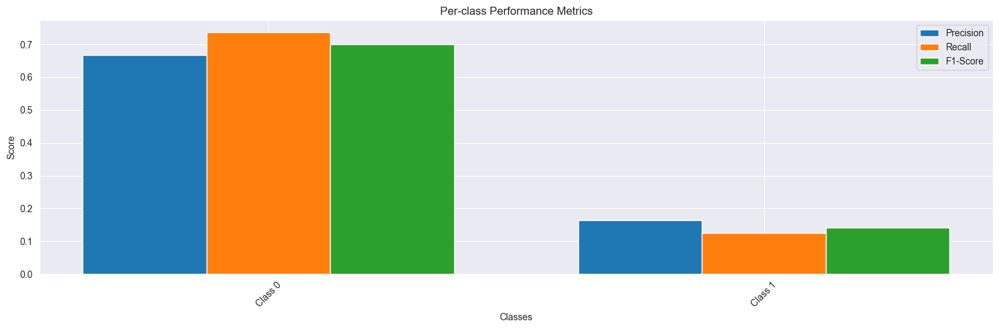


Other metrics:
loss: 1.2706
accuracy: 0.6307
precision: 0.6307
recall: 0.6307
val_loss: 1.2315
val_accuracy: 0.5560
val_precision: 0.5560
val_recall: 0.5560
val_per_class_f1: 0.4209

Epoch 1: val_accuracy improved from -inf to 0.55602, saving model to best_model.h5
52/52 [==============================] - 113s 2s/step - loss: 1.2706 - accuracy: 0.6307 - precision: 0.6307 - recall: 0.6307 - per_class_f1: 0.5935 - val_loss: 1.2315 - val_accuracy: 0.5560 - val_precision: 0.5560 - val_recall: 0.5560 - val_per_class_f1: 0.4209


2024-11-13 14:00:27,329 - INFO - Shuffled data for next epoch


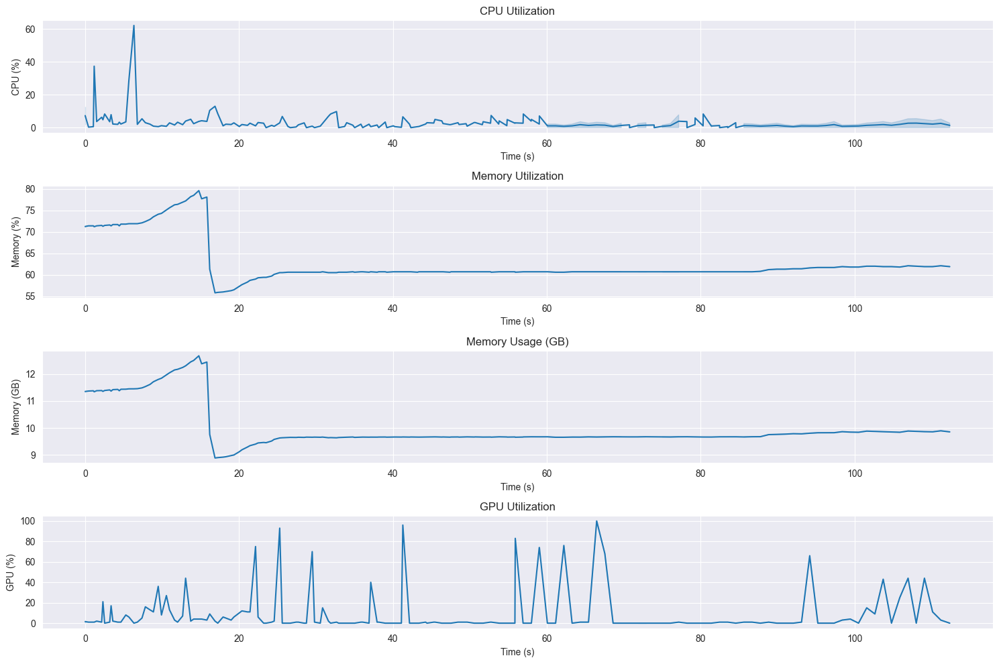



Local epochs:  17%|█▋        | 1/6 [01:58<09:54, 118.84s/it]


Resource Usage Summary:
duration_seconds: 112.37
avg_cpu_percent: 2.83
max_cpu_percent: 62.20
avg_memory_gb: 10.00
max_memory_gb: 12.67
avg_memory_percent: 62.81
max_memory_percent: 79.60
avg_gpu_percent: 9.28
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2151.82
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 1.2706, Val Loss: 1.2315
Accuracy: 0.6307, Val Accuracy: 0.5560

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.1115 - accuracy: 0.6982 - precision: 0.6982 - recall: 0.6982 - per_class_f1: 0.6692
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.0000  0.0000    0.0000
Class 1     0.2946  1.0000    0.4551

Averages:
  Class  Precision  Recall  F1-Score
Average     0.1473  0.5000    0.2276


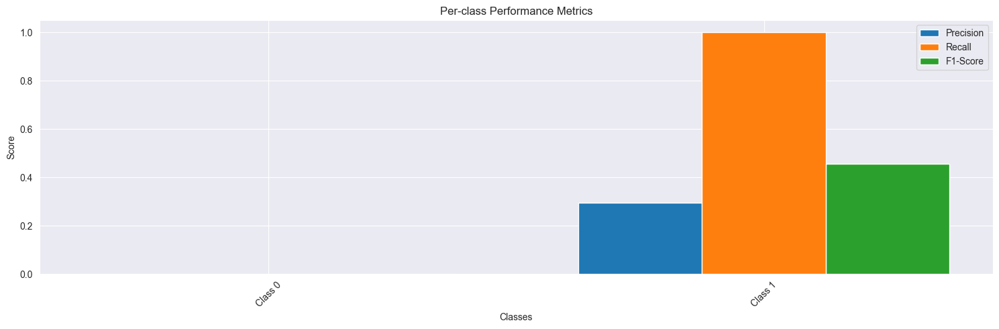


Other metrics:
loss: 1.1115
accuracy: 0.6982
precision: 0.6982
recall: 0.6982
val_loss: 1.7094
val_accuracy: 0.2946
val_precision: 0.2946
val_recall: 0.2946
val_per_class_f1: 0.2276

Epoch 1: val_accuracy did not improve from 0.55602
52/52 [==============================] - 15s 280ms/step - loss: 1.1115 - accuracy: 0.6982 - precision: 0.6982 - recall: 0.6982 - per_class_f1: 0.6692 - val_loss: 1.7094 - val_accuracy: 0.2946 - val_precision: 0.2946 - val_recall: 0.2946 - val_per_class_f1: 0.2276


2024-11-13 14:00:45,823 - INFO - Shuffled data for next epoch


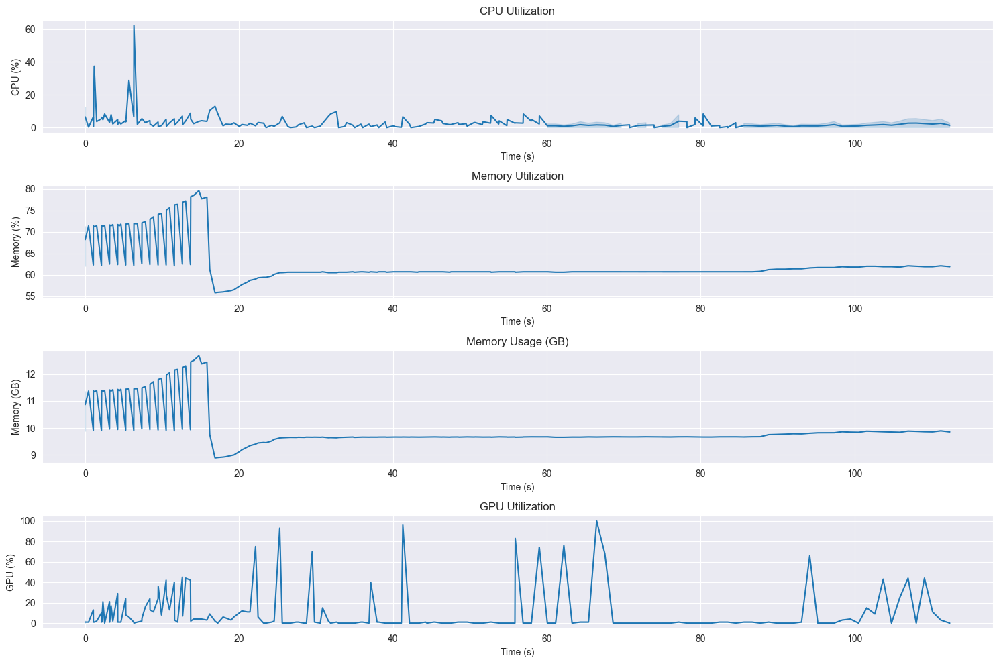



Local epochs:  33%|███▎      | 2/6 [02:16<03:57, 59.43s/it] 


Resource Usage Summary:
duration_seconds: 13.68
avg_cpu_percent: 2.98
max_cpu_percent: 62.20
avg_memory_gb: 10.00
max_memory_gb: 12.67
avg_memory_percent: 62.78
max_memory_percent: 79.60
avg_gpu_percent: 10.08
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2167.63
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 1.1115, Val Loss: 1.7094
Accuracy: 0.6982, Val Accuracy: 0.2946

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.0528 - accuracy: 0.7266 - precision: 0.7266 - recall: 0.7266 - per_class_f1: 0.6985
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.0000  0.0000    0.0000
Class 1     0.2946  1.0000    0.4551

Averages:
  Class  Precision  Recall  F1-Score
Average     0.1473  0.5000    0.2276


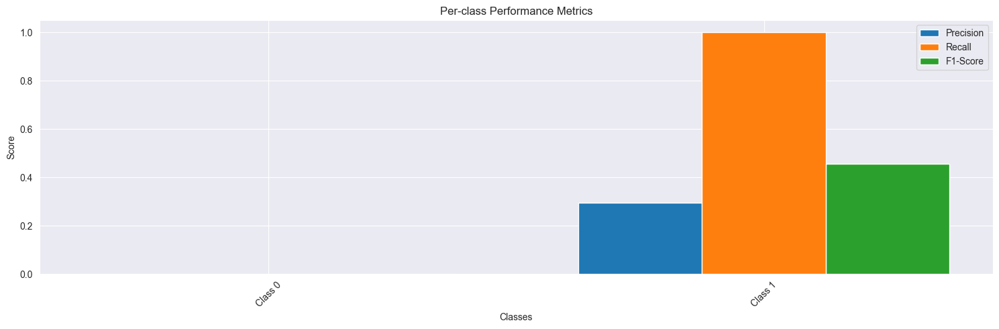


Other metrics:
loss: 1.0528
accuracy: 0.7266
precision: 0.7266
recall: 0.7266
val_loss: 1.7457
val_accuracy: 0.2946
val_precision: 0.2946
val_recall: 0.2946
val_per_class_f1: 0.2276

Epoch 1: val_accuracy did not improve from 0.55602
52/52 [==============================] - 15s 280ms/step - loss: 1.0528 - accuracy: 0.7266 - precision: 0.7266 - recall: 0.7266 - per_class_f1: 0.6985 - val_loss: 1.7457 - val_accuracy: 0.2946 - val_precision: 0.2946 - val_recall: 0.2946 - val_per_class_f1: 0.2276


2024-11-13 14:01:03,644 - INFO - Shuffled data for next epoch


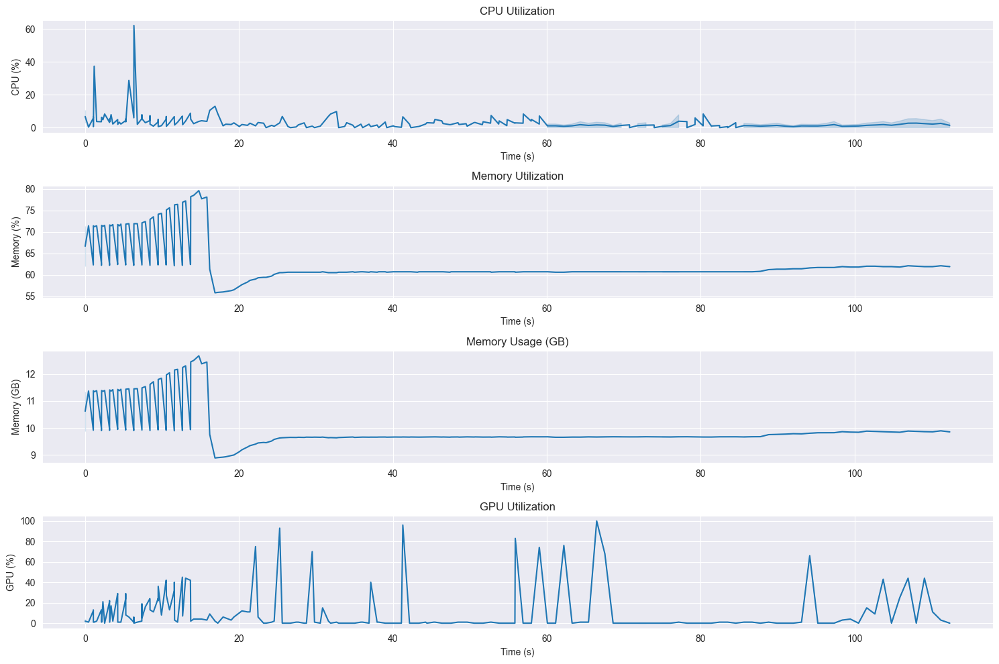



Local epochs:  50%|█████     | 3/6 [02:34<02:01, 40.38s/it]


Resource Usage Summary:
duration_seconds: 13.70
avg_cpu_percent: 3.15
max_cpu_percent: 62.20
avg_memory_gb: 10.00
max_memory_gb: 12.67
avg_memory_percent: 62.76
max_memory_percent: 79.60
avg_gpu_percent: 10.73
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2181.65
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 1.0528, Val Loss: 1.7457
Accuracy: 0.7266, Val Accuracy: 0.2946

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9872 - accuracy: 0.7502 - precision: 0.7502 - recall: 0.7502 - per_class_f1: 0.7282
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.0000  0.0000    0.0000
Class 1     0.2946  1.0000    0.4551

Averages:
  Class  Precision  Recall  F1-Score
Average     0.1473  0.5000    0.2276


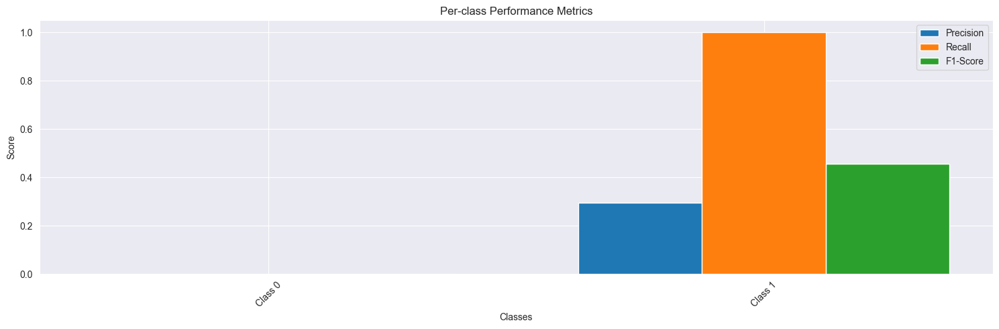


Other metrics:
loss: 0.9872
accuracy: 0.7502
precision: 0.7502
recall: 0.7502
val_loss: 2.3616
val_accuracy: 0.2946
val_precision: 0.2946
val_recall: 0.2946
val_per_class_f1: 0.2276

Epoch 1: val_accuracy did not improve from 0.55602
52/52 [==============================] - 15s 283ms/step - loss: 0.9872 - accuracy: 0.7502 - precision: 0.7502 - recall: 0.7502 - per_class_f1: 0.7282 - val_loss: 2.3616 - val_accuracy: 0.2946 - val_precision: 0.2946 - val_recall: 0.2946 - val_per_class_f1: 0.2276


2024-11-13 14:01:21,539 - INFO - Shuffled data for next epoch


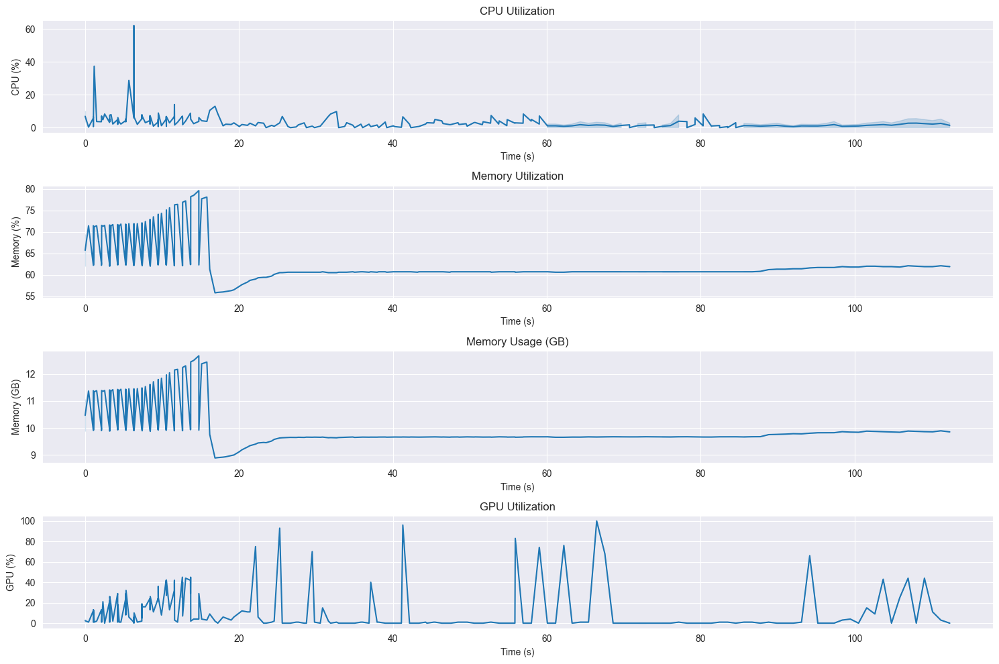

Local epochs:  50%|█████     | 3/6 [02:53<02:53, 57.73s/it]

Training Clients:  20%|██        | 1/5 [02:53<11:32, 173.22s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 3.38
max_cpu_percent: 62.20
avg_memory_gb: 9.99
max_memory_gb: 12.67
avg_memory_percent: 62.73
max_memory_percent: 79.60
avg_gpu_percent: 11.57
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2195.01
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.9872, Val Loss: 2.3616
Accuracy: 0.7502, Val Accuracy: 0.2946
Early stopping triggered for client 0

==================== Training Client 2 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.2950 - accuracy: 0.6228 - precision: 0.6228 - recall: 0.6228 - per_class_f1: 0.5928
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.6762  0.7506    0.7115
Class 1     0.1893  0.1394    0.1606

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4327  0.4450    0.4360


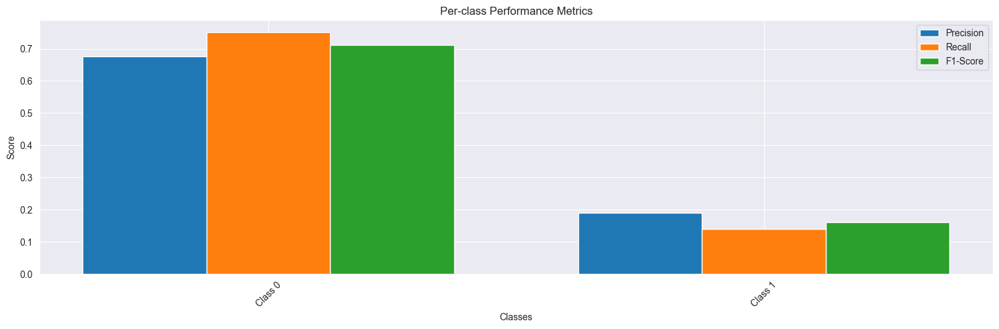


Other metrics:
loss: 1.2950
accuracy: 0.6228
precision: 0.6228
recall: 0.6228
val_loss: 1.2294
val_accuracy: 0.5705
val_precision: 0.5705
val_recall: 0.5705
val_per_class_f1: 0.4360

Epoch 1: val_accuracy improved from 0.55602 to 0.57054, saving model to best_model.h5
52/52 [==============================] - 75s 1s/step - loss: 1.2950 - accuracy: 0.6228 - precision: 0.6228 - recall: 0.6228 - per_class_f1: 0.5928 - val_loss: 1.2294 - val_accuracy: 0.5705 - val_precision: 0.5705 - val_recall: 0.5705 - val_per_class_f1: 0.4360


2024-11-13 14:02:41,716 - INFO - Shuffled data for next epoch


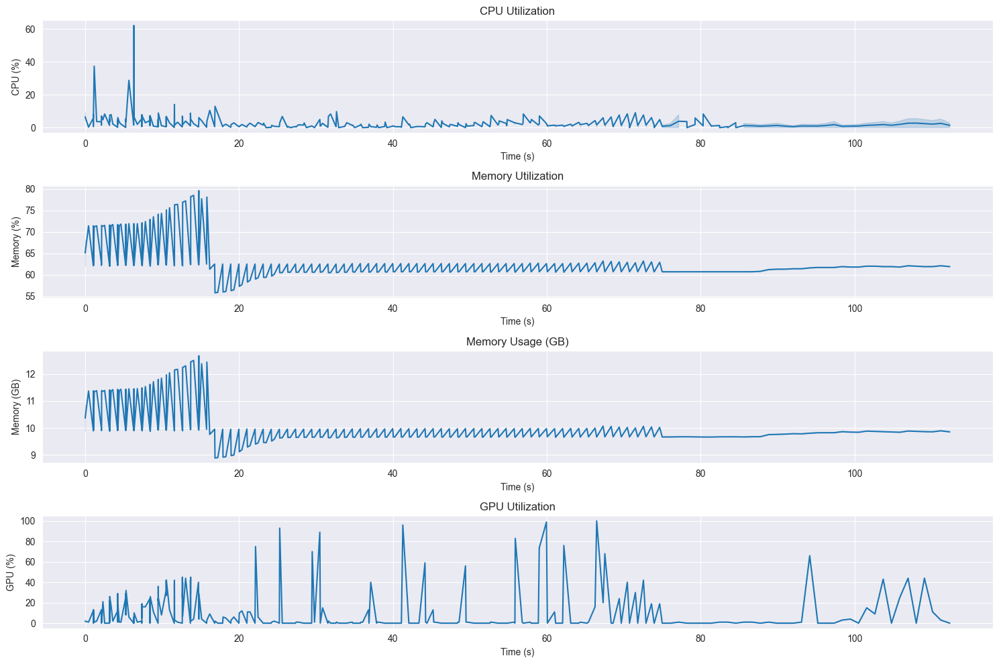



Local epochs:  17%|█▋        | 1/6 [01:19<06:38, 79.69s/it]


Resource Usage Summary:
duration_seconds: 74.67
avg_cpu_percent: 3.07
max_cpu_percent: 62.20
avg_memory_gb: 9.99
max_memory_gb: 12.67
avg_memory_percent: 62.70
max_memory_percent: 79.60
avg_gpu_percent: 11.06
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2242.43
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 1.2950, Val Loss: 1.2294
Accuracy: 0.6228, Val Accuracy: 0.5705

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.1051 - accuracy: 0.7103 - precision: 0.7103 - recall: 0.7103 - per_class_f1: 0.6871
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7022  0.9847    0.8198
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3511  0.4924    0.4099


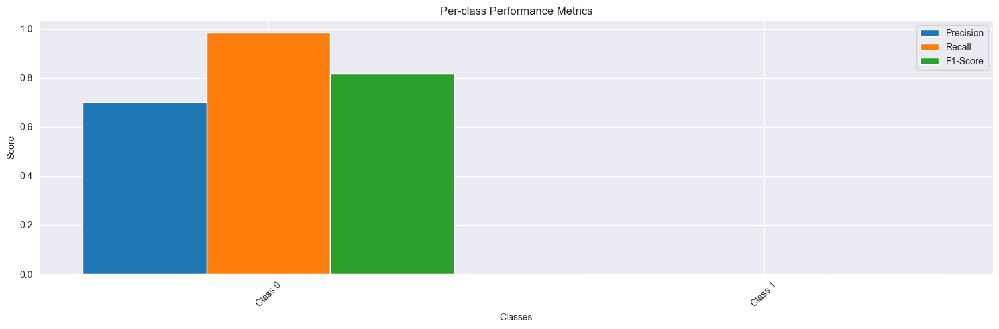


Other metrics:
loss: 1.1051
accuracy: 0.7103
precision: 0.7103
recall: 0.7103
val_loss: 1.1760
val_accuracy: 0.6946
val_precision: 0.6946
val_recall: 0.6946
val_per_class_f1: 0.4099

Epoch 1: val_accuracy improved from 0.57054 to 0.69461, saving model to best_model.h5
52/52 [==============================] - 15s 283ms/step - loss: 1.1051 - accuracy: 0.7103 - precision: 0.7103 - recall: 0.7103 - per_class_f1: 0.6871 - val_loss: 1.1760 - val_accuracy: 0.6946 - val_precision: 0.6946 - val_recall: 0.6946 - val_per_class_f1: 0.4099


2024-11-13 14:03:00,053 - INFO - Shuffled data for next epoch


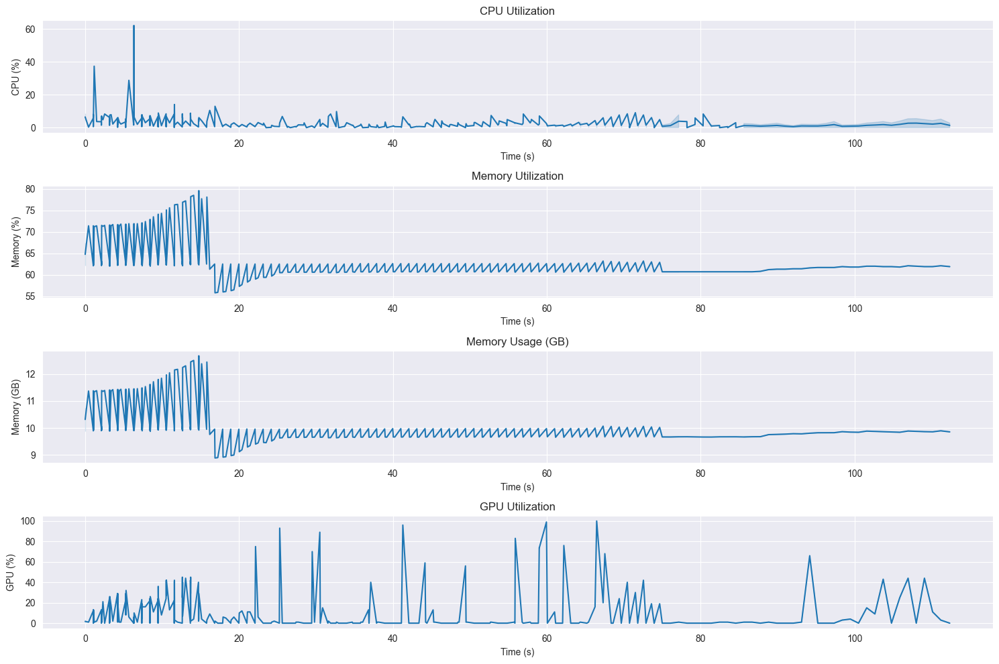



Local epochs:  33%|███▎      | 2/6 [01:38<02:55, 43.97s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 3.20
max_cpu_percent: 62.20
avg_memory_gb: 9.99
max_memory_gb: 12.67
avg_memory_percent: 62.71
max_memory_percent: 79.60
avg_gpu_percent: 11.33
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2249.85
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 1.1051, Val Loss: 1.1760
Accuracy: 0.7103, Val Accuracy: 0.6946

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.0443 - accuracy: 0.7453 - precision: 0.7453 - recall: 0.7453 - per_class_f1: 0.7277
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0100    0.0198
Class 1     0.2967  1.0000    0.4576

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6483  0.5050    0.2387


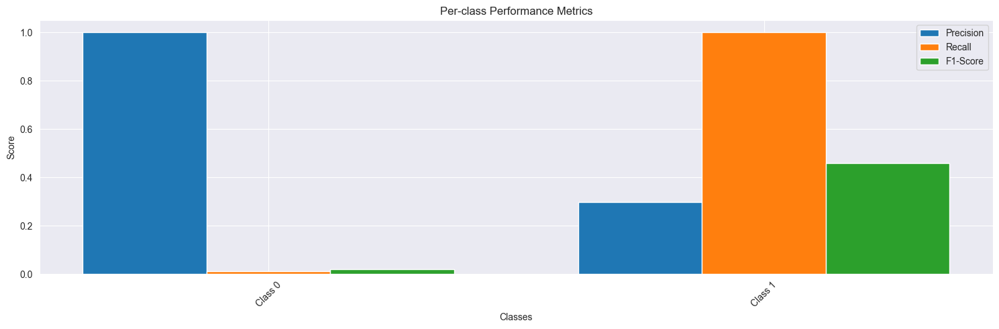


Other metrics:
loss: 1.0443
accuracy: 0.7453
precision: 0.7453
recall: 0.7453
val_loss: 1.2839
val_accuracy: 0.3017
val_precision: 0.3017
val_recall: 0.3017
val_per_class_f1: 0.2387

Epoch 1: val_accuracy did not improve from 0.69461
52/52 [==============================] - 15s 286ms/step - loss: 1.0443 - accuracy: 0.7453 - precision: 0.7453 - recall: 0.7453 - per_class_f1: 0.7277 - val_loss: 1.2839 - val_accuracy: 0.3017 - val_precision: 0.3017 - val_recall: 0.3017 - val_per_class_f1: 0.2387


2024-11-13 14:03:19,113 - INFO - Shuffled data for next epoch


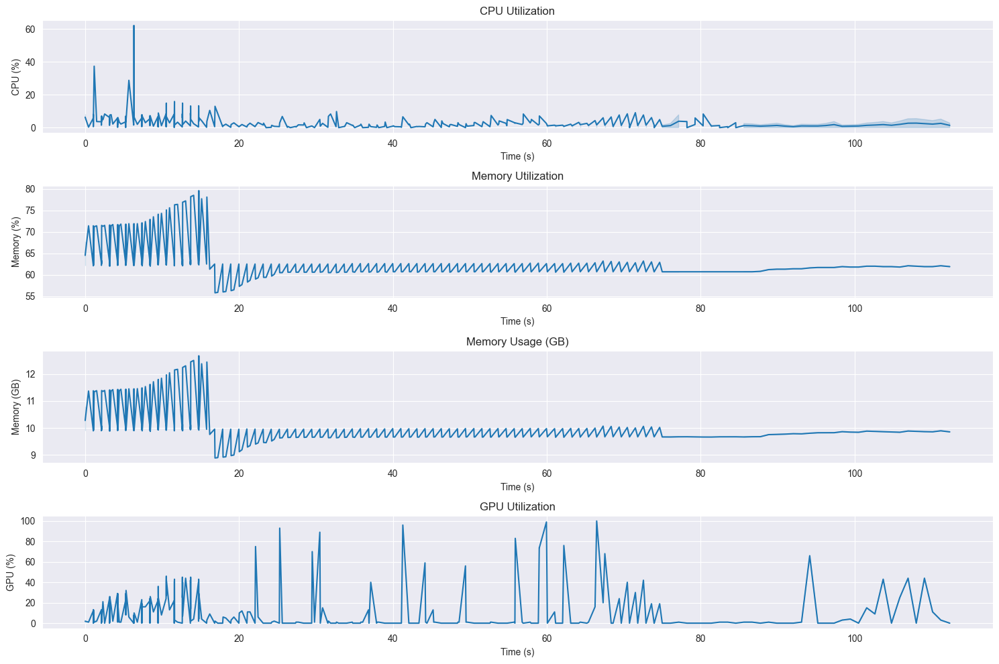



Local epochs:  50%|█████     | 3/6 [01:57<01:37, 32.53s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 3.40
max_cpu_percent: 62.20
avg_memory_gb: 9.99
max_memory_gb: 12.67
avg_memory_percent: 62.74
max_memory_percent: 79.60
avg_gpu_percent: 11.72
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2256.66
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 1.0443, Val Loss: 1.2839
Accuracy: 0.7453, Val Accuracy: 0.3017

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.0049 - accuracy: 0.7320 - precision: 0.7320 - recall: 0.7320 - per_class_f1: 0.7132
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0047    0.0094
Class 1     0.2956  1.0000    0.4563

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6478  0.5024    0.2328


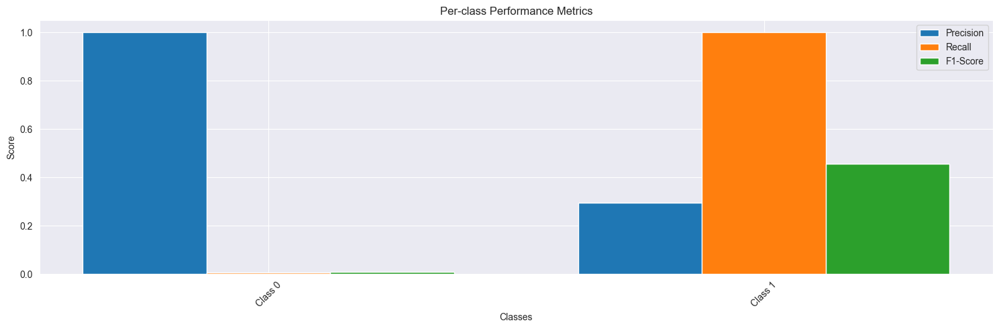


Other metrics:
loss: 1.0049
accuracy: 0.7320
precision: 0.7320
recall: 0.7320
val_loss: 1.5520
val_accuracy: 0.2979
val_precision: 0.2979
val_recall: 0.2979
val_per_class_f1: 0.2328

Epoch 1: val_accuracy did not improve from 0.69461
52/52 [==============================] - 16s 304ms/step - loss: 1.0049 - accuracy: 0.7320 - precision: 0.7320 - recall: 0.7320 - per_class_f1: 0.7132 - val_loss: 1.5520 - val_accuracy: 0.2979 - val_precision: 0.2979 - val_recall: 0.2979 - val_per_class_f1: 0.2328


2024-11-13 14:03:39,026 - INFO - Shuffled data for next epoch


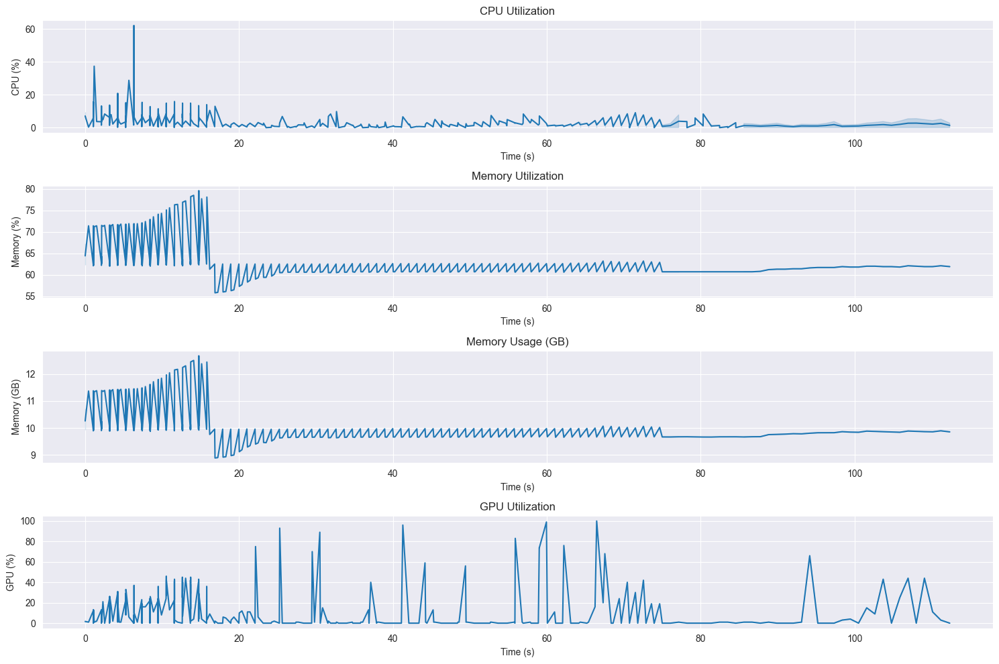



Local epochs:  67%|██████▋   | 4/6 [02:17<00:55, 27.58s/it]


Resource Usage Summary:
duration_seconds: 15.79
avg_cpu_percent: 3.85
max_cpu_percent: 62.20
avg_memory_gb: 10.00
max_memory_gb: 12.67
avg_memory_percent: 62.79
max_memory_percent: 79.60
avg_gpu_percent: 12.32
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2263.32
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 1.0049, Val Loss: 1.5520
Accuracy: 0.7320, Val Accuracy: 0.2979

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9499 - accuracy: 0.7556 - precision: 0.7556 - recall: 0.7556 - per_class_f1: 0.7390
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0076    0.0152
Class 1     0.2962  1.0000    0.4570

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6481  0.5038    0.2361


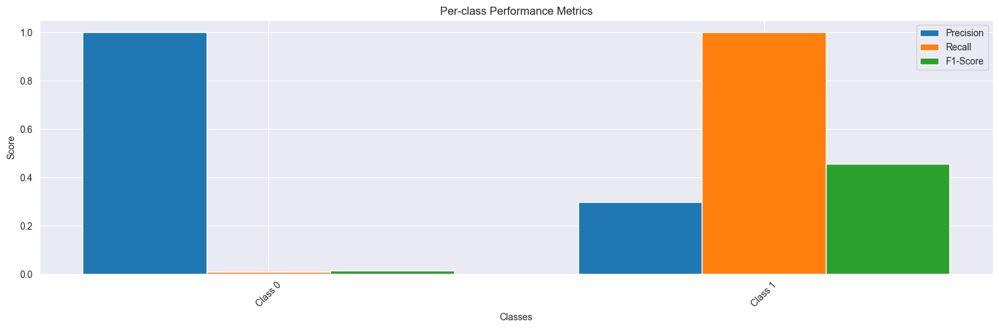


Other metrics:
loss: 0.9499
accuracy: 0.7556
precision: 0.7556
recall: 0.7556
val_loss: 1.4822
val_accuracy: 0.3000
val_precision: 0.3000
val_recall: 0.3000
val_per_class_f1: 0.2361

Epoch 1: val_accuracy did not improve from 0.69461
52/52 [==============================] - 15s 294ms/step - loss: 0.9499 - accuracy: 0.7556 - precision: 0.7556 - recall: 0.7556 - per_class_f1: 0.7390 - val_loss: 1.4822 - val_accuracy: 0.3000 - val_precision: 0.3000 - val_recall: 0.3000 - val_per_class_f1: 0.2361


2024-11-13 14:03:58,536 - INFO - Shuffled data for next epoch


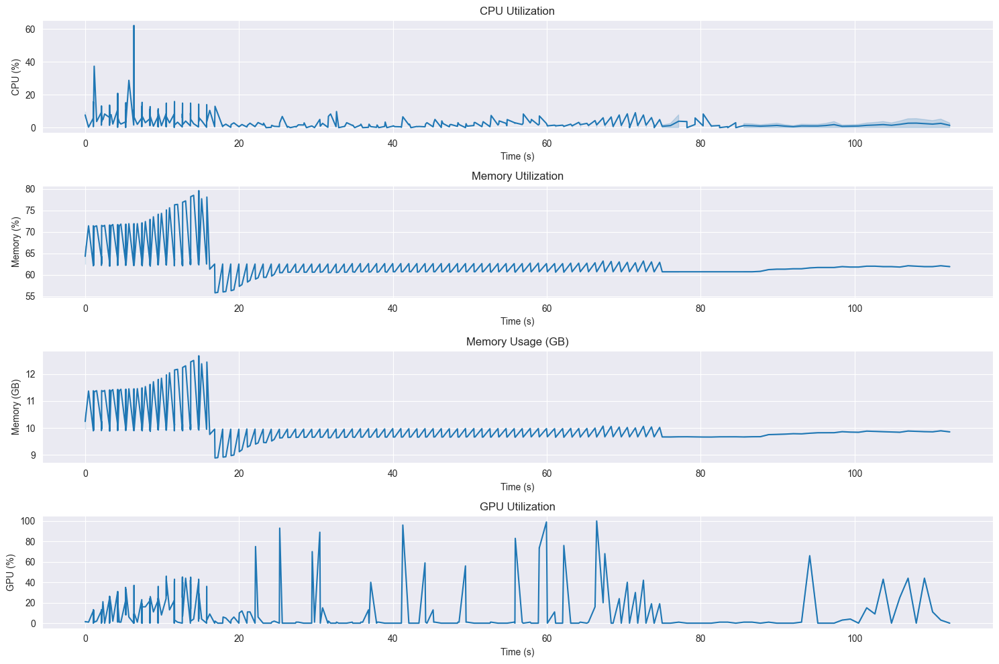

Local epochs:  67%|██████▋   | 4/6 [02:36<01:18, 39.13s/it]

Training Clients:  40%|████      | 2/5 [05:29<08:10, 163.42s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 4.14
max_cpu_percent: 62.20
avg_memory_gb: 10.01
max_memory_gb: 12.67
avg_memory_percent: 62.82
max_memory_percent: 79.60
avg_gpu_percent: 12.68
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2269.08
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.9499, Val Loss: 1.4822
Accuracy: 0.7556, Val Accuracy: 0.3000
Early stopping triggered for client 1

==================== Training Client 3 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.2814 - accuracy: 0.6017 - precision: 0.6017 - recall: 0.6017 - per_class_f1: 0.5640
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7054  1.0000    0.8273
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3527  0.5000    0.4136


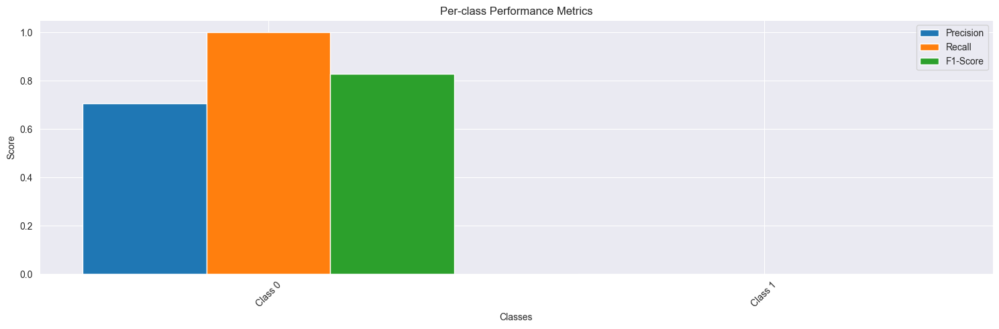


Other metrics:
loss: 1.2814
accuracy: 0.6017
precision: 0.6017
recall: 0.6017
val_loss: 1.1726
val_accuracy: 0.7054
val_precision: 0.7054
val_recall: 0.7054
val_per_class_f1: 0.4136

Epoch 1: val_accuracy improved from 0.69461 to 0.70539, saving model to best_model.h5
52/52 [==============================] - 69s 1s/step - loss: 1.2814 - accuracy: 0.6017 - precision: 0.6017 - recall: 0.6017 - per_class_f1: 0.5640 - val_loss: 1.1726 - val_accuracy: 0.7054 - val_precision: 0.7054 - val_recall: 0.7054 - val_per_class_f1: 0.4136


2024-11-13 14:05:11,717 - INFO - Shuffled data for next epoch


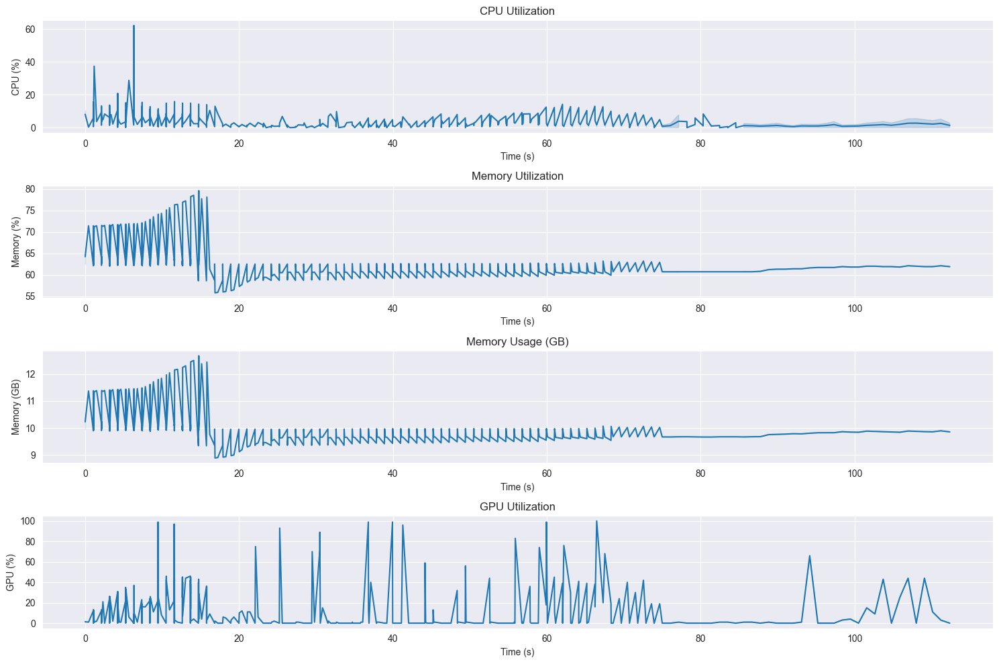



Local epochs:  17%|█▋        | 1/6 [01:13<06:07, 73.45s/it]


Resource Usage Summary:
duration_seconds: 68.34
avg_cpu_percent: 4.40
max_cpu_percent: 62.20
avg_memory_gb: 9.94
max_memory_gb: 12.67
avg_memory_percent: 62.43
max_memory_percent: 79.60
avg_gpu_percent: 12.93
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2289.97
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 1.2814, Val Loss: 1.1726
Accuracy: 0.6017, Val Accuracy: 0.7054

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.1170 - accuracy: 0.6807 - precision: 0.6807 - recall: 0.6807 - per_class_f1: 0.6548
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7053  0.9994    0.8270
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3526  0.4997    0.4135


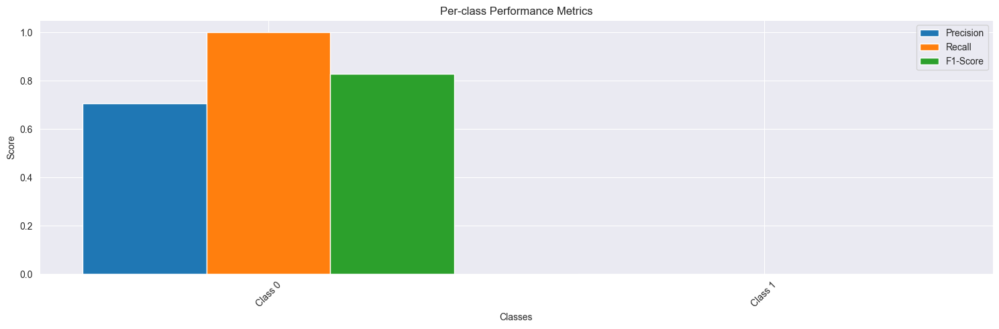


Other metrics:
loss: 1.1170
accuracy: 0.6807
precision: 0.6807
recall: 0.6807
val_loss: 1.1308
val_accuracy: 0.7050
val_precision: 0.7050
val_recall: 0.7050
val_per_class_f1: 0.4135

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 293ms/step - loss: 1.1170 - accuracy: 0.6807 - precision: 0.6807 - recall: 0.6807 - per_class_f1: 0.6548 - val_loss: 1.1308 - val_accuracy: 0.7050 - val_precision: 0.7050 - val_recall: 0.7050 - val_per_class_f1: 0.4135


2024-11-13 14:05:30,830 - INFO - Shuffled data for next epoch


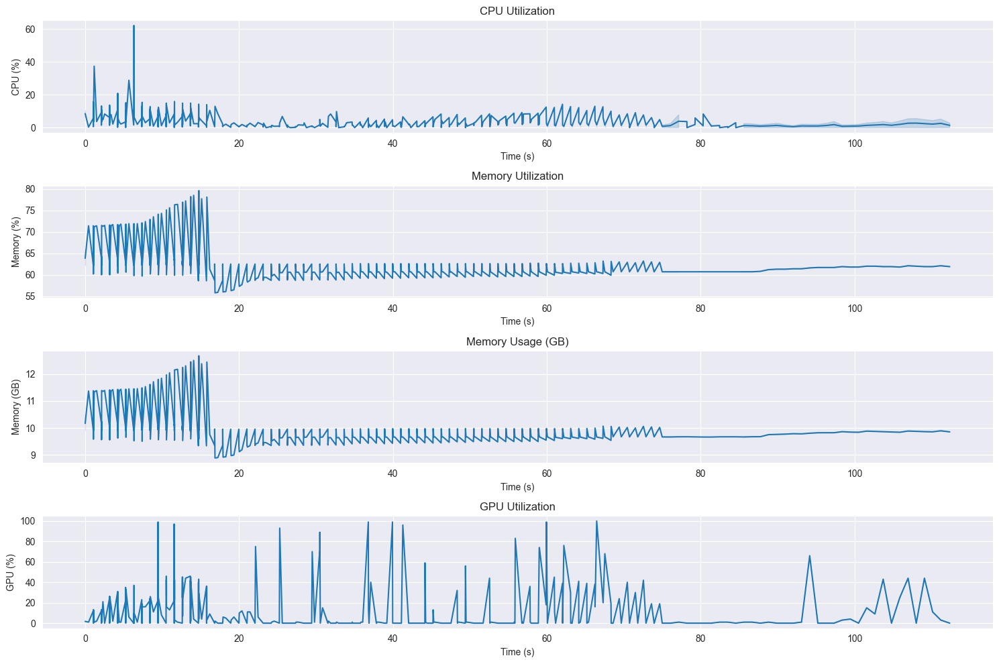



Local epochs:  33%|███▎      | 2/6 [01:32<02:45, 41.45s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 4.60
max_cpu_percent: 62.20
avg_memory_gb: 9.93
max_memory_gb: 12.67
avg_memory_percent: 62.36
max_memory_percent: 79.60
avg_gpu_percent: 13.19
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2293.91
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 1.1170, Val Loss: 1.1308
Accuracy: 0.6807, Val Accuracy: 0.7050

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.0545 - accuracy: 0.7212 - precision: 0.7212 - recall: 0.7212 - per_class_f1: 0.7010
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.6935  0.9359    0.7967
Class 1     0.0603  0.0099    0.0169

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3769  0.4729    0.4068


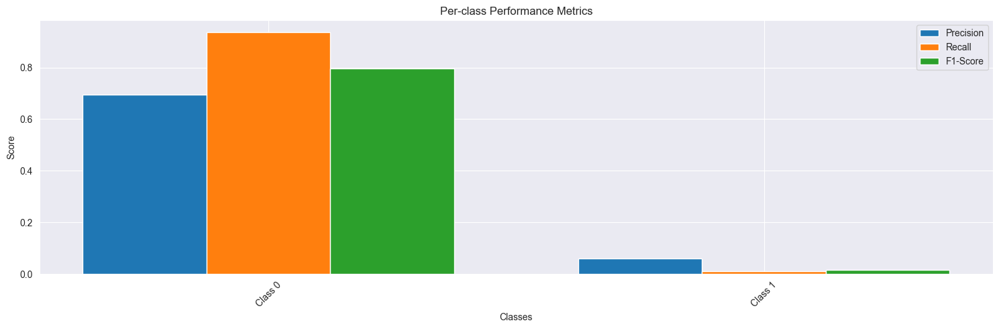


Other metrics:
loss: 1.0545
accuracy: 0.7212
precision: 0.7212
recall: 0.7212
val_loss: 1.1410
val_accuracy: 0.6631
val_precision: 0.6631
val_recall: 0.6631
val_per_class_f1: 0.4068

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 295ms/step - loss: 1.0545 - accuracy: 0.7212 - precision: 0.7212 - recall: 0.7212 - per_class_f1: 0.7010 - val_loss: 1.1410 - val_accuracy: 0.6631 - val_precision: 0.6631 - val_recall: 0.6631 - val_per_class_f1: 0.4068


2024-11-13 14:05:50,036 - INFO - Shuffled data for next epoch


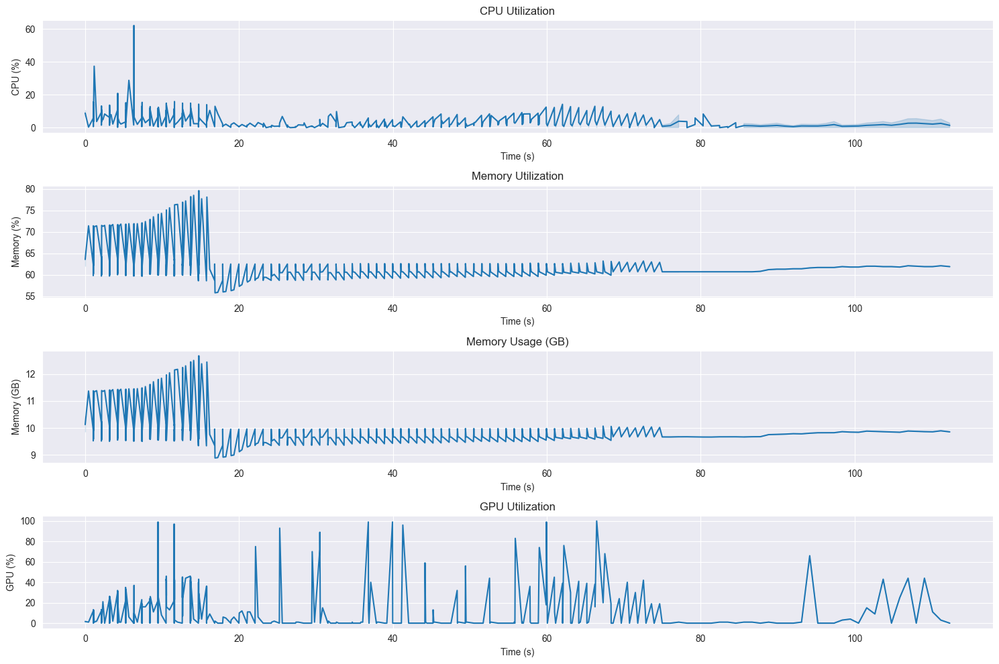



Local epochs:  50%|█████     | 3/6 [01:51<01:33, 31.32s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 4.77
max_cpu_percent: 62.20
avg_memory_gb: 9.92
max_memory_gb: 12.67
avg_memory_percent: 62.28
max_memory_percent: 79.60
avg_gpu_percent: 13.50
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2297.61
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 1.0545, Val Loss: 1.1410
Accuracy: 0.7212, Val Accuracy: 0.6631

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9820 - accuracy: 0.7375 - precision: 0.7375 - recall: 0.7375 - per_class_f1: 0.7178
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7047  0.9953    0.8252
Class 1     0.1111  0.0014    0.0028

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4079  0.4984    0.4140


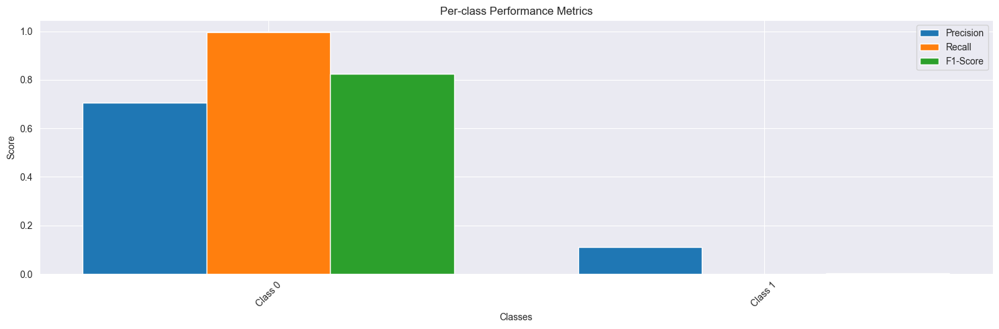


Other metrics:
loss: 0.9820
accuracy: 0.7375
precision: 0.7375
recall: 0.7375
val_loss: 1.0668
val_accuracy: 0.7025
val_precision: 0.7025
val_recall: 0.7025
val_per_class_f1: 0.4140

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 296ms/step - loss: 0.9820 - accuracy: 0.7375 - precision: 0.7375 - recall: 0.7375 - per_class_f1: 0.7178 - val_loss: 1.0668 - val_accuracy: 0.7025 - val_precision: 0.7025 - val_recall: 0.7025 - val_per_class_f1: 0.4140


2024-11-13 14:06:09,345 - INFO - Shuffled data for next epoch


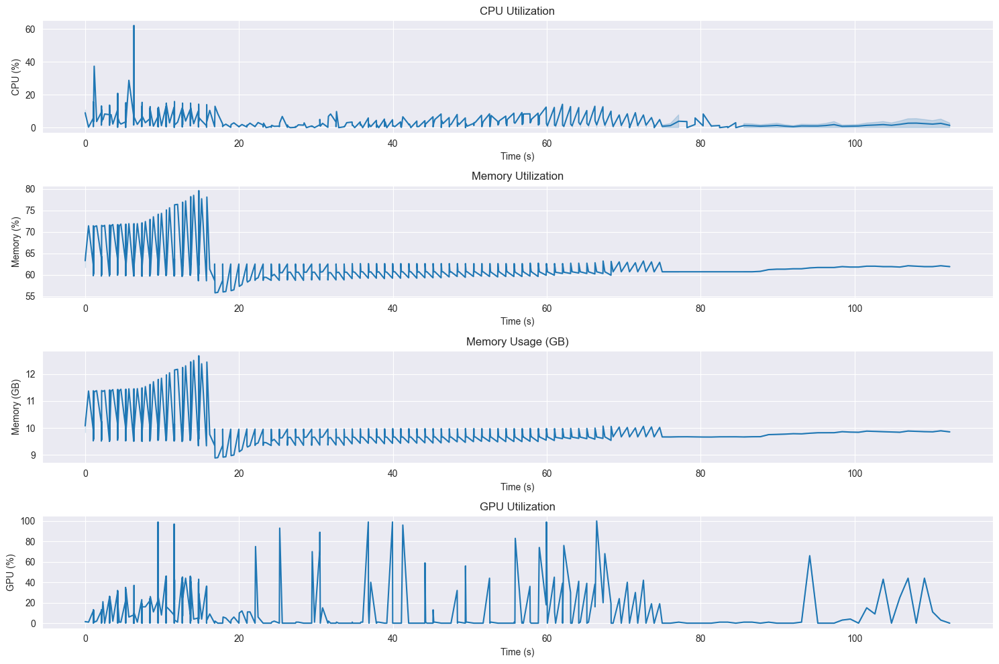



Local epochs:  67%|██████▋   | 4/6 [02:10<00:52, 26.46s/it]


Resource Usage Summary:
duration_seconds: 14.70
avg_cpu_percent: 4.92
max_cpu_percent: 62.20
avg_memory_gb: 9.91
max_memory_gb: 12.67
avg_memory_percent: 62.21
max_memory_percent: 79.60
avg_gpu_percent: 13.65
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2301.09
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.9820, Val Loss: 1.0668
Accuracy: 0.7375, Val Accuracy: 0.7025

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9547 - accuracy: 0.7326 - precision: 0.7326 - recall: 0.7326 - per_class_f1: 0.7103
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7043  0.9947    0.8247
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3521  0.4974    0.4123


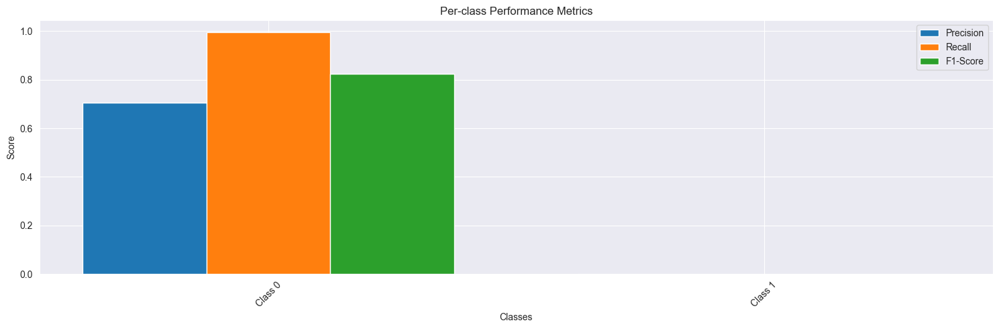


Other metrics:
loss: 0.9547
accuracy: 0.7326
precision: 0.7326
recall: 0.7326
val_loss: 1.0593
val_accuracy: 0.7017
val_precision: 0.7017
val_recall: 0.7017
val_per_class_f1: 0.4123

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 296ms/step - loss: 0.9547 - accuracy: 0.7326 - precision: 0.7326 - recall: 0.7326 - per_class_f1: 0.7103 - val_loss: 1.0593 - val_accuracy: 0.7017 - val_precision: 0.7017 - val_recall: 0.7017 - val_per_class_f1: 0.4123


2024-11-13 14:06:28,362 - INFO - Shuffled data for next epoch


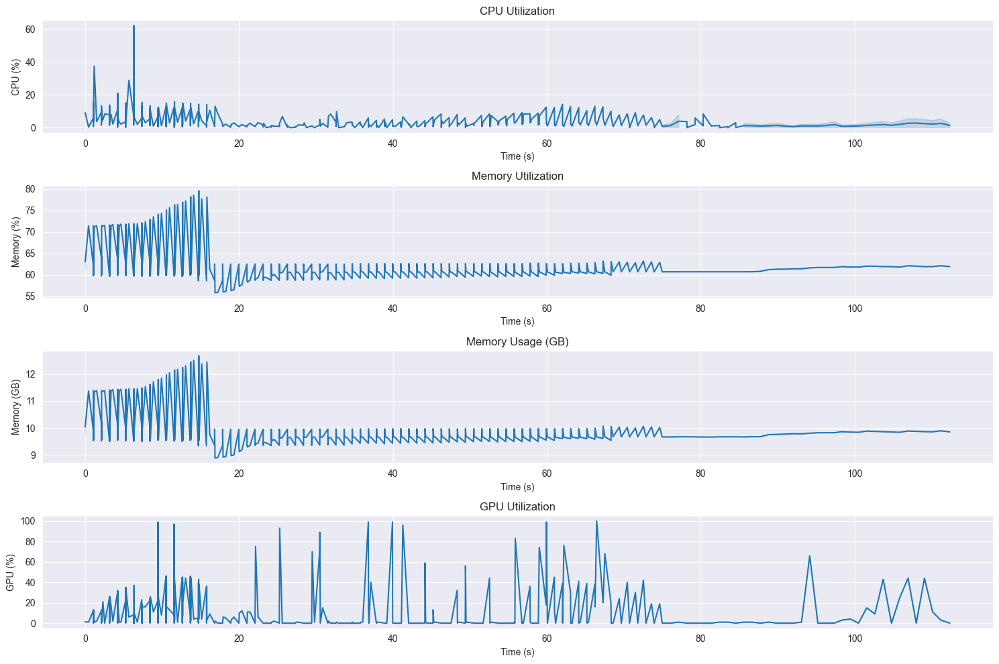



Local epochs:  83%|████████▎ | 5/6 [02:29<00:23, 23.83s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 5.04
max_cpu_percent: 62.20
avg_memory_gb: 9.90
max_memory_gb: 12.67
avg_memory_percent: 62.14
max_memory_percent: 79.60
avg_gpu_percent: 13.93
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2304.37
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.9547, Val Loss: 1.0593
Accuracy: 0.7326, Val Accuracy: 0.7017

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8901 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7534
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7393  0.3453    0.4707
Class 1     0.3113  0.7085    0.4325

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5253  0.5269    0.4516


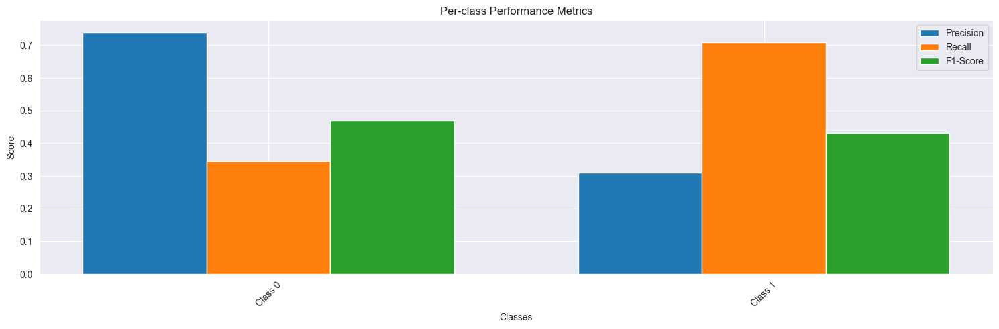


Other metrics:
loss: 0.8901
accuracy: 0.7683
precision: 0.7683
recall: 0.7683
val_loss: 1.1313
val_accuracy: 0.4523
val_precision: 0.4523
val_recall: 0.4523
val_per_class_f1: 0.4516

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 297ms/step - loss: 0.8901 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7534 - val_loss: 1.1313 - val_accuracy: 0.4523 - val_precision: 0.4523 - val_recall: 0.4523 - val_per_class_f1: 0.4516


2024-11-13 14:06:47,636 - INFO - Shuffled data for next epoch


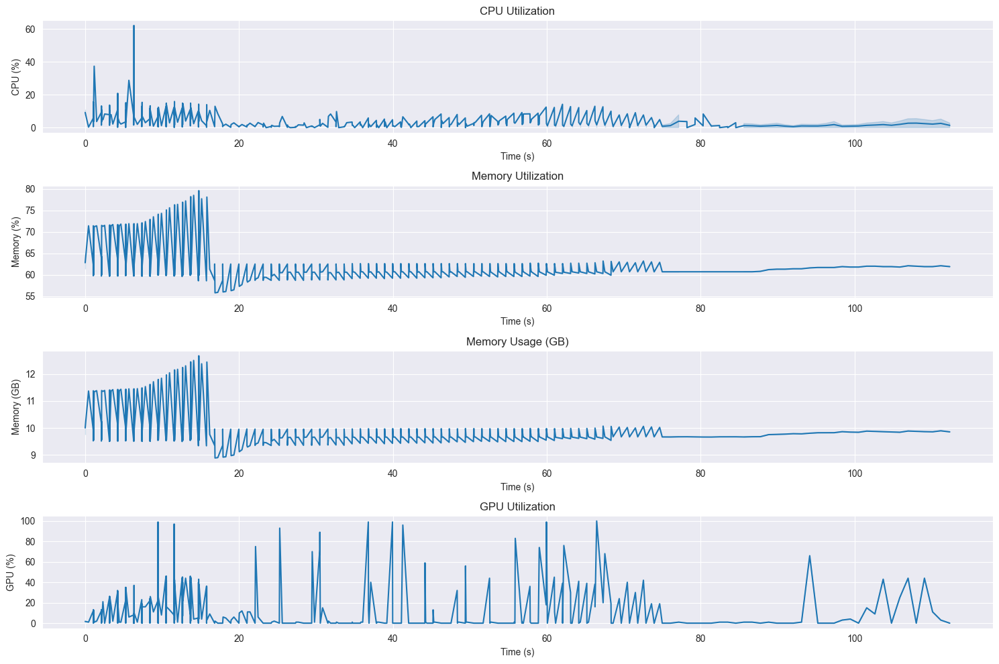



Local epochs: 100%|██████████| 6/6 [02:49<00:00, 28.21s/it]

Training Clients:  60%|██████    | 3/5 [08:19<05:32, 166.11s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 5.15
max_cpu_percent: 62.20
avg_memory_gb: 9.89
max_memory_gb: 12.67
avg_memory_percent: 62.08
max_memory_percent: 79.60
avg_gpu_percent: 14.10
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2307.47
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.8901, Val Loss: 1.1313
Accuracy: 0.7683, Val Accuracy: 0.4523

==================== Training Client 4 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.2842 - accuracy: 0.5987 - precision: 0.5987 - recall: 0.5987 - per_class_f1: 0.5629
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9897  0.0565    0.1068
Class 1     0.3065  0.9986    0.4691

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6481  0.5275    0.2880


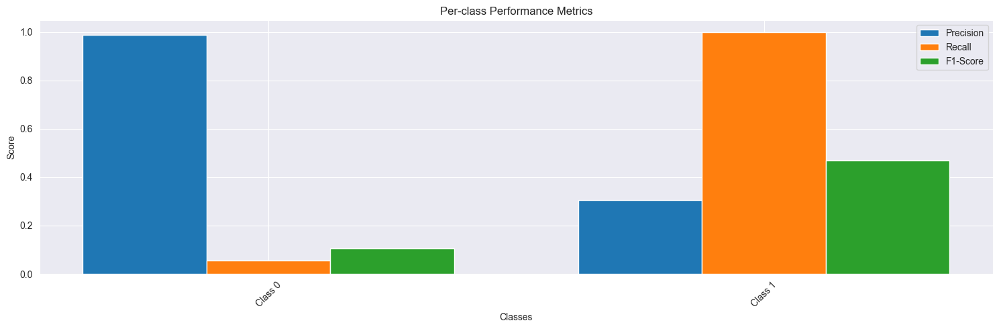


Other metrics:
loss: 1.2842
accuracy: 0.5987
precision: 0.5987
recall: 0.5987
val_loss: 1.2710
val_accuracy: 0.3340
val_precision: 0.3340
val_recall: 0.3340
val_per_class_f1: 0.2880

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 64s 1s/step - loss: 1.2842 - accuracy: 0.5987 - precision: 0.5987 - recall: 0.5987 - per_class_f1: 0.5629 - val_loss: 1.2710 - val_accuracy: 0.3340 - val_precision: 0.3340 - val_recall: 0.3340 - val_per_class_f1: 0.2880


2024-11-13 14:07:56,034 - INFO - Shuffled data for next epoch


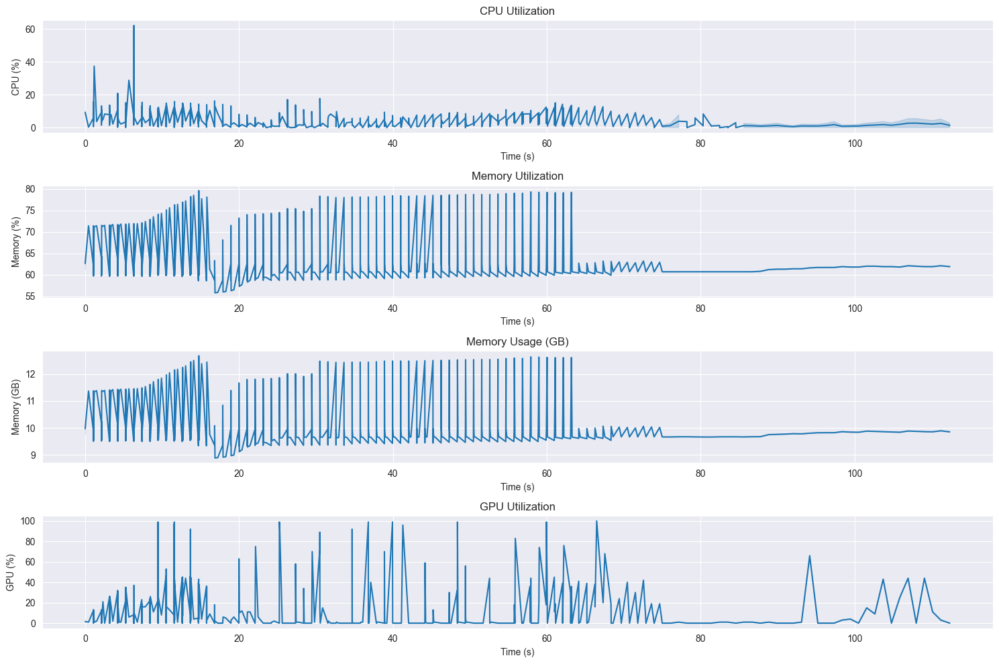



Local epochs:  17%|█▋        | 1/6 [01:08<05:42, 68.43s/it]


Resource Usage Summary:
duration_seconds: 63.20
avg_cpu_percent: 5.51
max_cpu_percent: 62.20
avg_memory_gb: 10.06
max_memory_gb: 12.67
avg_memory_percent: 63.15
max_memory_percent: 79.60
avg_gpu_percent: 14.53
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2318.46
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 1.2842, Val Loss: 1.2710
Accuracy: 0.5987, Val Accuracy: 0.3340

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.1196 - accuracy: 0.6904 - precision: 0.6904 - recall: 0.6904 - per_class_f1: 0.6676
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0118    0.0233
Class 1     0.2971  1.0000    0.4581

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6485  0.5059    0.2407


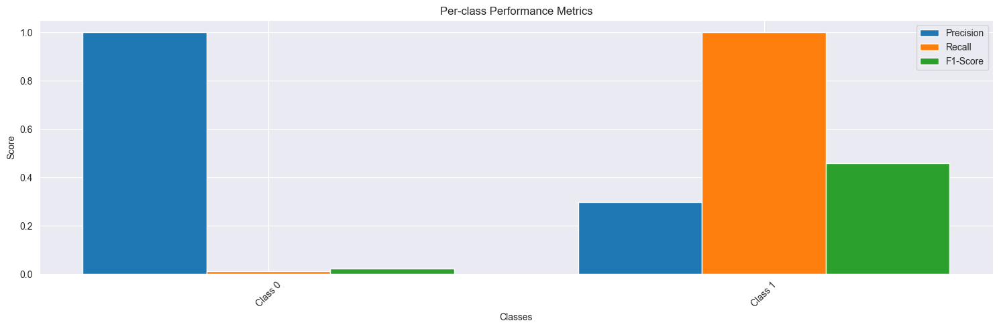


Other metrics:
loss: 1.1196
accuracy: 0.6904
precision: 0.6904
recall: 0.6904
val_loss: 1.2990
val_accuracy: 0.3029
val_precision: 0.3029
val_recall: 0.3029
val_per_class_f1: 0.2407

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 294ms/step - loss: 1.1196 - accuracy: 0.6904 - precision: 0.6904 - recall: 0.6904 - per_class_f1: 0.6676 - val_loss: 1.2990 - val_accuracy: 0.3029 - val_precision: 0.3029 - val_recall: 0.3029 - val_per_class_f1: 0.2407


2024-11-13 14:08:15,238 - INFO - Shuffled data for next epoch


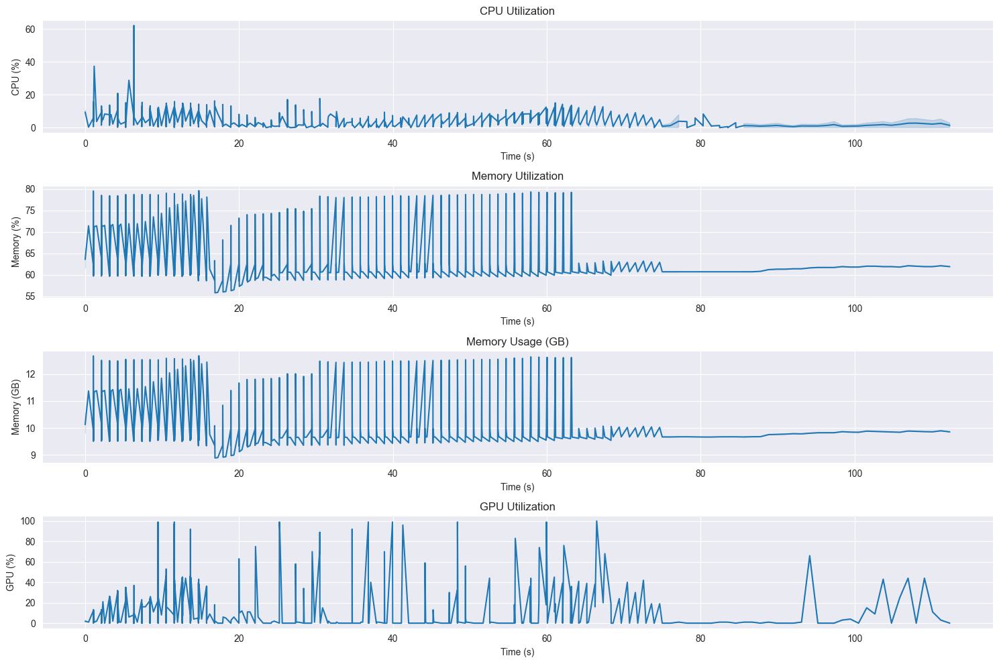



Local epochs:  33%|███▎      | 2/6 [01:27<02:38, 39.55s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 5.64
max_cpu_percent: 62.20
avg_memory_gb: 10.12
max_memory_gb: 12.71
avg_memory_percent: 63.53
max_memory_percent: 79.80
avg_gpu_percent: 14.69
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2320.82
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 1.1196, Val Loss: 1.2990
Accuracy: 0.6904, Val Accuracy: 0.3029

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.0396 - accuracy: 0.7302 - precision: 0.7302 - recall: 0.7302 - per_class_f1: 0.7146
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9432  0.0488    0.0928
Class 1     0.3036  0.9930    0.4650

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6234  0.5209    0.2789


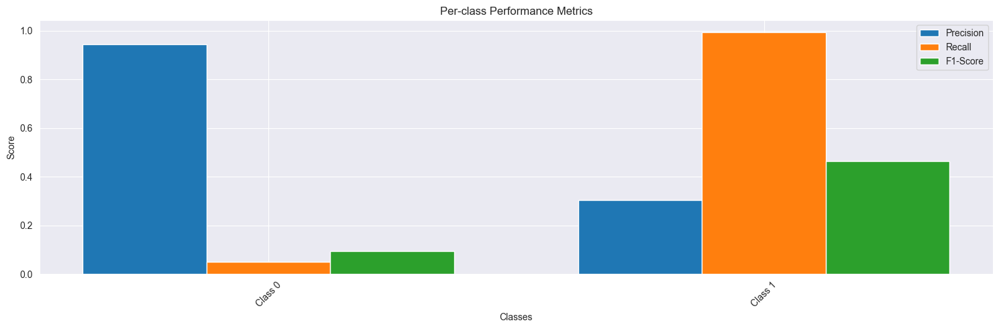


Other metrics:
loss: 1.0396
accuracy: 0.7302
precision: 0.7302
recall: 0.7302
val_loss: 1.2015
val_accuracy: 0.3270
val_precision: 0.3270
val_recall: 0.3270
val_per_class_f1: 0.2789

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 295ms/step - loss: 1.0396 - accuracy: 0.7302 - precision: 0.7302 - recall: 0.7302 - per_class_f1: 0.7146 - val_loss: 1.2015 - val_accuracy: 0.3270 - val_precision: 0.3270 - val_recall: 0.3270 - val_per_class_f1: 0.2789


2024-11-13 14:08:34,584 - INFO - Shuffled data for next epoch


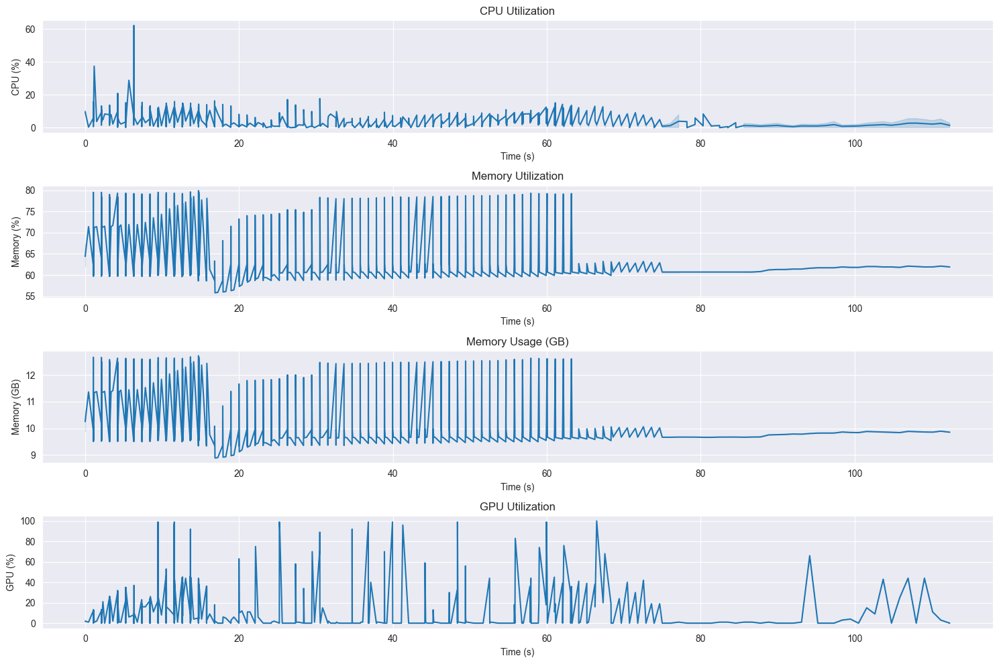



Local epochs:  50%|█████     | 3/6 [01:46<01:30, 30.24s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 5.78
max_cpu_percent: 62.20
avg_memory_gb: 10.18
max_memory_gb: 12.72
avg_memory_percent: 63.91
max_memory_percent: 79.90
avg_gpu_percent: 14.85
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2323.07
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 1.0396, Val Loss: 1.2015
Accuracy: 0.7302, Val Accuracy: 0.3270

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9835 - accuracy: 0.7465 - precision: 0.7465 - recall: 0.7465 - per_class_f1: 0.7313
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0082    0.0163
Class 1     0.2963  1.0000    0.4572

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6482  0.5041    0.2368


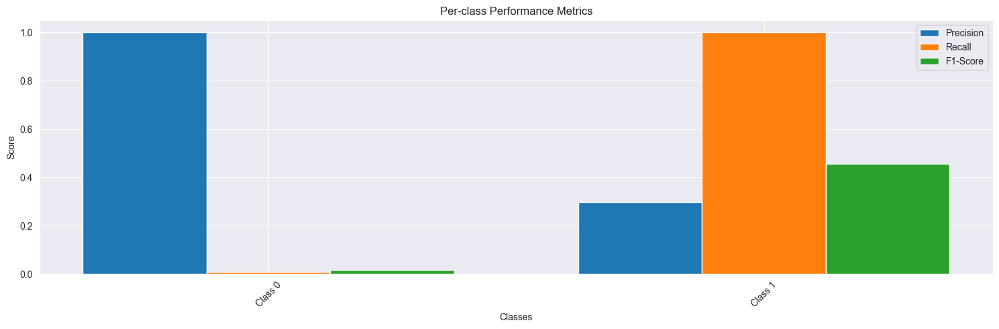


Other metrics:
loss: 0.9835
accuracy: 0.7465
precision: 0.7465
recall: 0.7465
val_loss: 1.3421
val_accuracy: 0.3004
val_precision: 0.3004
val_recall: 0.3004
val_per_class_f1: 0.2368

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 299ms/step - loss: 0.9835 - accuracy: 0.7465 - precision: 0.7465 - recall: 0.7465 - per_class_f1: 0.7313 - val_loss: 1.3421 - val_accuracy: 0.3004 - val_precision: 0.3004 - val_recall: 0.3004 - val_per_class_f1: 0.2368


2024-11-13 14:08:53,989 - INFO - Shuffled data for next epoch


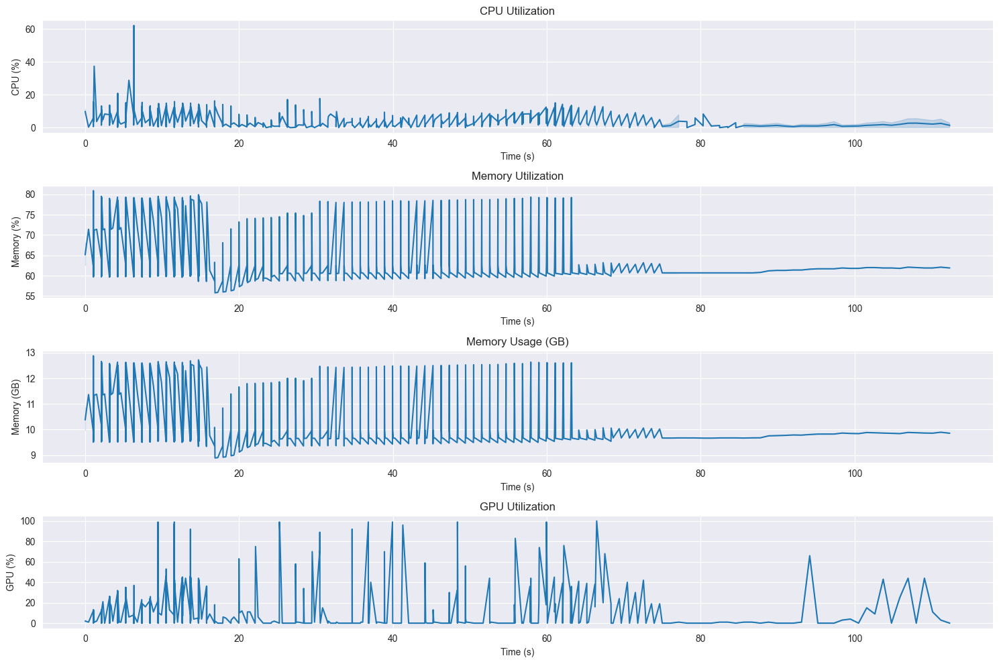



Local epochs:  67%|██████▋   | 4/6 [02:06<00:51, 25.92s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 5.90
max_cpu_percent: 62.20
avg_memory_gb: 10.24
max_memory_gb: 12.88
avg_memory_percent: 64.26
max_memory_percent: 80.90
avg_gpu_percent: 15.05
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2325.22
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.9835, Val Loss: 1.3421
Accuracy: 0.7465, Val Accuracy: 0.3004

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9419 - accuracy: 0.7592 - precision: 0.7592 - recall: 0.7592 - per_class_f1: 0.7455
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8125  0.2447    0.3761
Class 1     0.3235  0.8648    0.4709

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5680  0.5547    0.4235


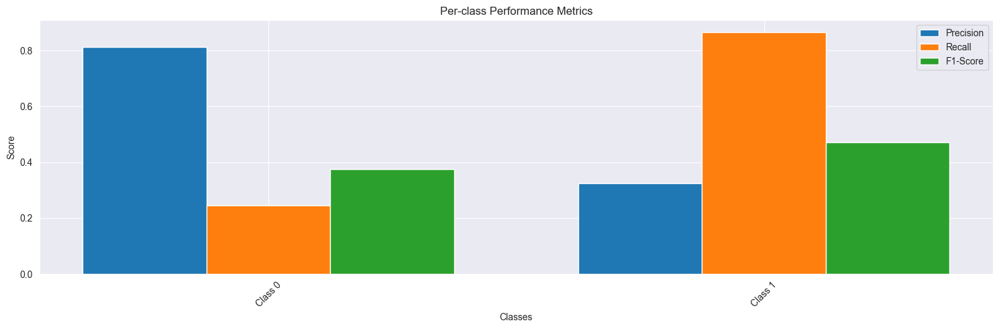


Other metrics:
loss: 0.9419
accuracy: 0.7592
precision: 0.7592
recall: 0.7592
val_loss: 1.1330
val_accuracy: 0.4274
val_precision: 0.4274
val_recall: 0.4274
val_per_class_f1: 0.4235

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 297ms/step - loss: 0.9419 - accuracy: 0.7592 - precision: 0.7592 - recall: 0.7592 - per_class_f1: 0.7455 - val_loss: 1.1330 - val_accuracy: 0.4274 - val_precision: 0.4274 - val_recall: 0.4274 - val_per_class_f1: 0.4235


2024-11-13 14:09:13,181 - INFO - Shuffled data for next epoch


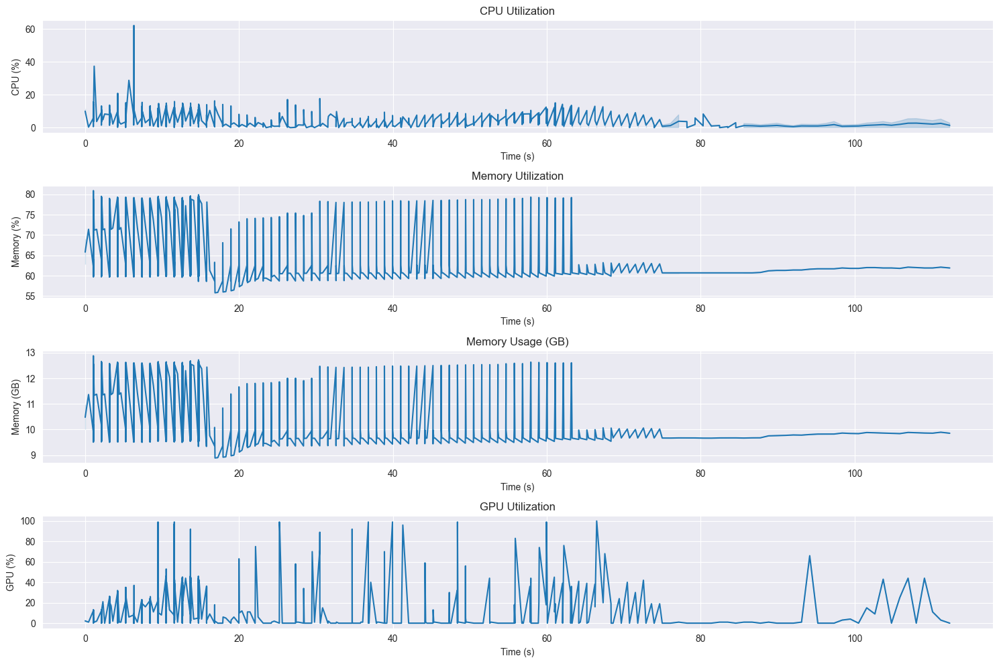



Local epochs:  83%|████████▎ | 5/6 [02:25<00:23, 23.58s/it]


Resource Usage Summary:
duration_seconds: 14.71
avg_cpu_percent: 6.02
max_cpu_percent: 62.20
avg_memory_gb: 10.29
max_memory_gb: 12.88
avg_memory_percent: 64.60
max_memory_percent: 80.90
avg_gpu_percent: 15.21
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2327.27
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.9419, Val Loss: 1.1330
Accuracy: 0.7592, Val Accuracy: 0.4274

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8808 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7552
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8389  0.2053    0.3299
Class 1     0.3225  0.9056    0.4756

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5807  0.5555    0.4027


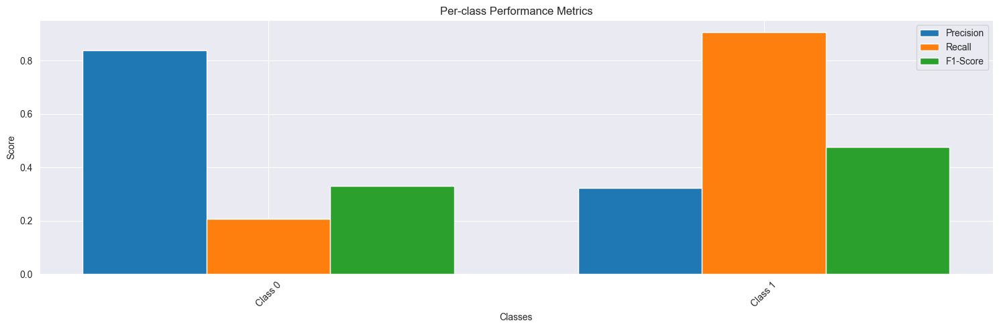


Other metrics:
loss: 0.8808
accuracy: 0.7683
precision: 0.7683
recall: 0.7683
val_loss: 1.1357
val_accuracy: 0.4116
val_precision: 0.4116
val_recall: 0.4116
val_per_class_f1: 0.4027

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 295ms/step - loss: 0.8808 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7552 - val_loss: 1.1357 - val_accuracy: 0.4116 - val_precision: 0.4116 - val_recall: 0.4116 - val_per_class_f1: 0.4027


2024-11-13 14:09:32,470 - INFO - Shuffled data for next epoch


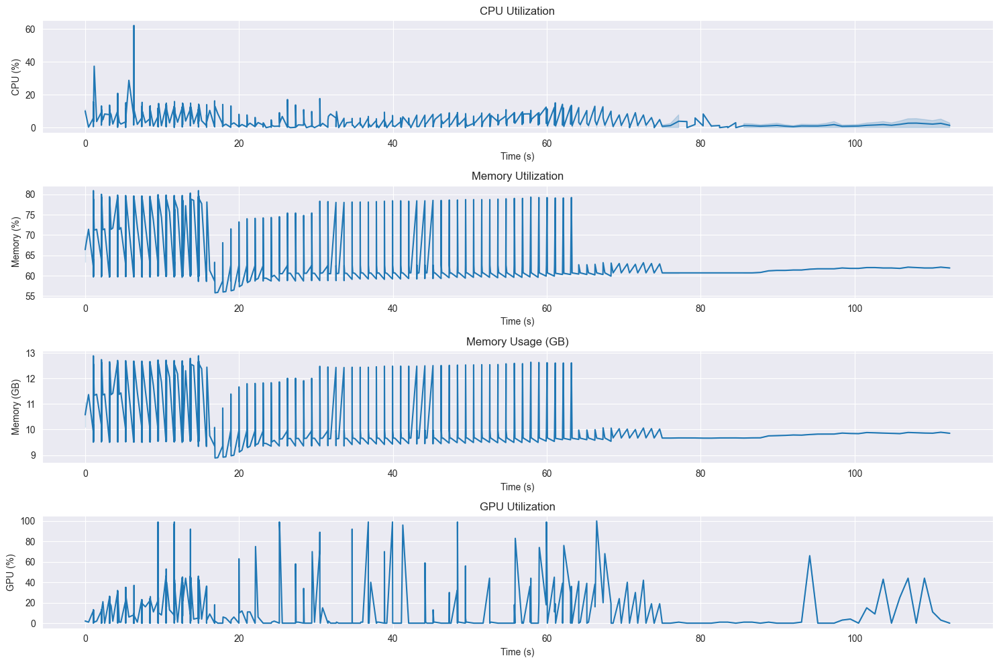



Local epochs: 100%|██████████| 6/6 [02:44<00:00, 27.47s/it]

Training Clients:  80%|████████  | 4/5 [11:03<02:45, 165.62s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 6.14
max_cpu_percent: 62.20
avg_memory_gb: 10.34
max_memory_gb: 12.88
avg_memory_percent: 64.94
max_memory_percent: 80.90
avg_gpu_percent: 15.35
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2329.23
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.8808, Val Loss: 1.1357
Accuracy: 0.7683, Val Accuracy: 0.4116

==================== Training Client 5 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.2610 - accuracy: 0.6325 - precision: 0.6325 - recall: 0.6325 - per_class_f1: 0.6048
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7049  0.9976    0.8261
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3525  0.4988    0.4131


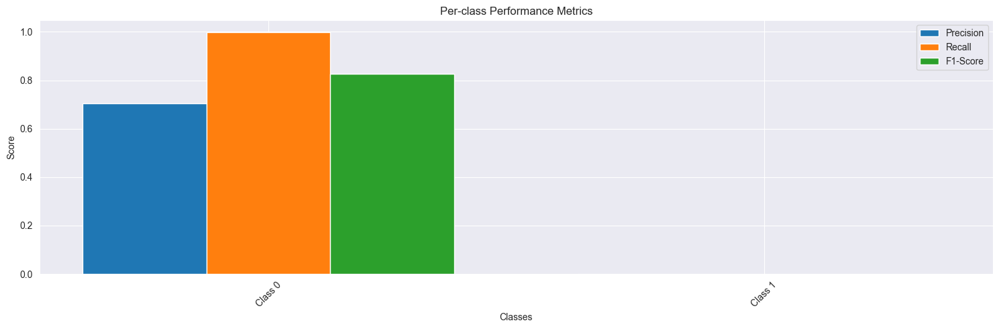


Other metrics:
loss: 1.2610
accuracy: 0.6325
precision: 0.6325
recall: 0.6325
val_loss: 1.2106
val_accuracy: 0.7037
val_precision: 0.7037
val_recall: 0.7037
val_per_class_f1: 0.4131

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 66s 1s/step - loss: 1.2610 - accuracy: 0.6325 - precision: 0.6325 - recall: 0.6325 - per_class_f1: 0.6048 - val_loss: 1.2106 - val_accuracy: 0.7037 - val_precision: 0.7037 - val_recall: 0.7037 - val_per_class_f1: 0.4131


2024-11-13 14:10:43,100 - INFO - Shuffled data for next epoch


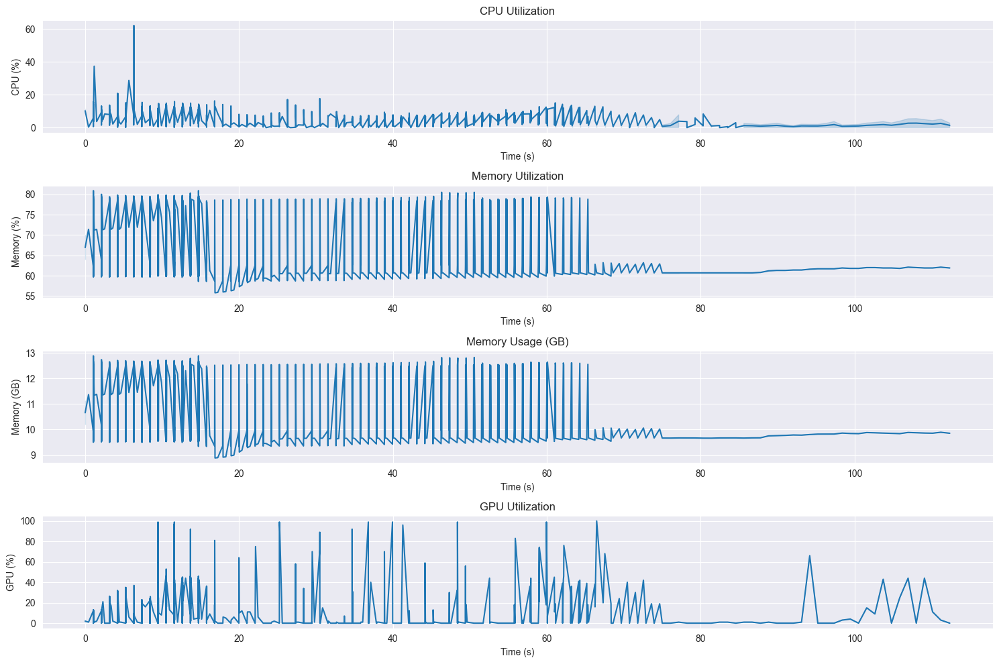



Local epochs:  17%|█▋        | 1/6 [01:10<05:54, 70.94s/it]


Resource Usage Summary:
duration_seconds: 65.34
avg_cpu_percent: 6.31
max_cpu_percent: 62.20
avg_memory_gb: 10.53
max_memory_gb: 12.88
avg_memory_percent: 66.14
max_memory_percent: 80.90
avg_gpu_percent: 14.62
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2336.58
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 1.2610, Val Loss: 1.2106
Accuracy: 0.6325, Val Accuracy: 0.7037

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.1024 - accuracy: 0.7114 - precision: 0.7114 - recall: 0.7114 - per_class_f1: 0.6895
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.0000  0.0000    0.0000
Class 1     0.2946  1.0000    0.4551

Averages:
  Class  Precision  Recall  F1-Score
Average     0.1473  0.5000    0.2276


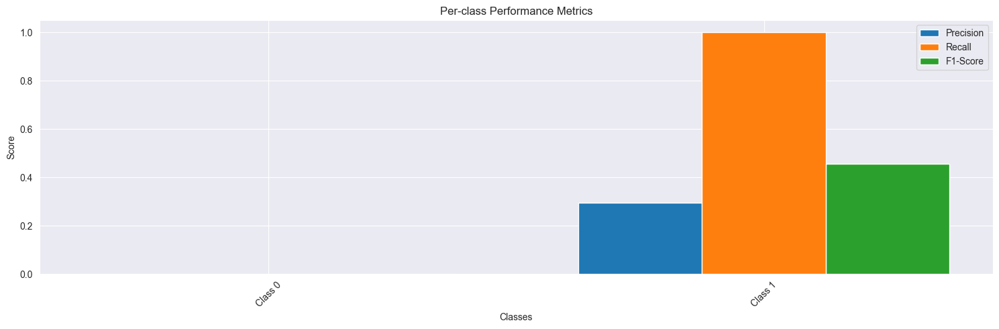


Other metrics:
loss: 1.1024
accuracy: 0.7114
precision: 0.7114
recall: 0.7114
val_loss: 1.5578
val_accuracy: 0.2946
val_precision: 0.2946
val_recall: 0.2946
val_per_class_f1: 0.2276

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 298ms/step - loss: 1.1024 - accuracy: 0.7114 - precision: 0.7114 - recall: 0.7114 - per_class_f1: 0.6895 - val_loss: 1.5578 - val_accuracy: 0.2946 - val_precision: 0.2946 - val_recall: 0.2946 - val_per_class_f1: 0.2276


2024-11-13 14:11:02,792 - INFO - Shuffled data for next epoch


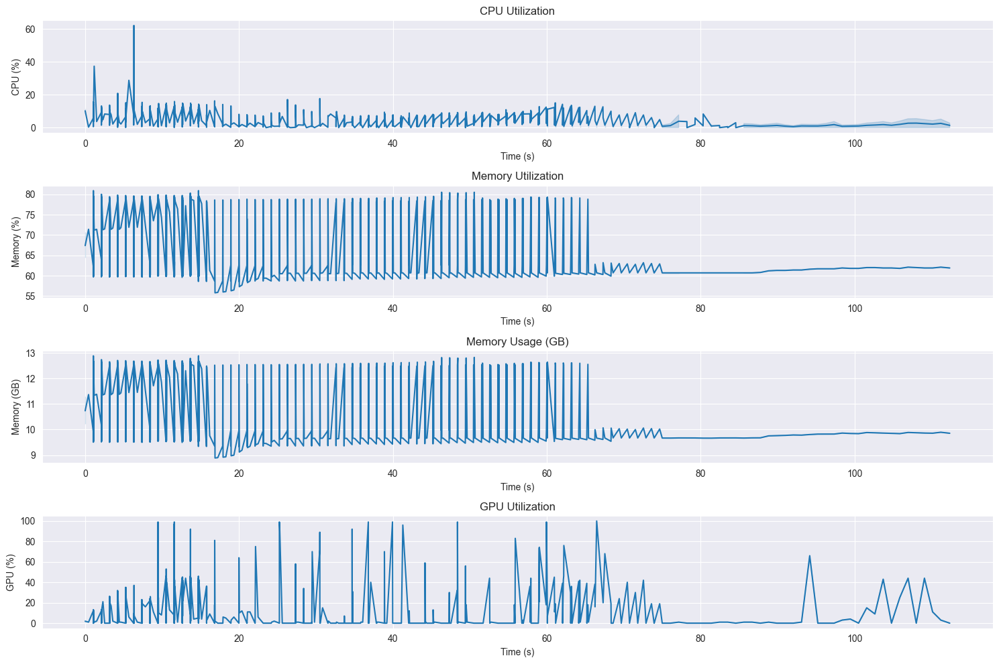



Local epochs:  33%|███▎      | 2/6 [01:30<02:42, 40.62s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 6.40
max_cpu_percent: 62.20
avg_memory_gb: 10.58
max_memory_gb: 12.88
avg_memory_percent: 66.40
max_memory_percent: 80.90
avg_gpu_percent: 14.76
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2338.15
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 1.1024, Val Loss: 1.5578
Accuracy: 0.7114, Val Accuracy: 0.2946

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 1.0375 - accuracy: 0.7422 - precision: 0.7422 - recall: 0.7422 - per_class_f1: 0.7217
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.0000  0.0000    0.0000
Class 1     0.2946  1.0000    0.4551

Averages:
  Class  Precision  Recall  F1-Score
Average     0.1473  0.5000    0.2276


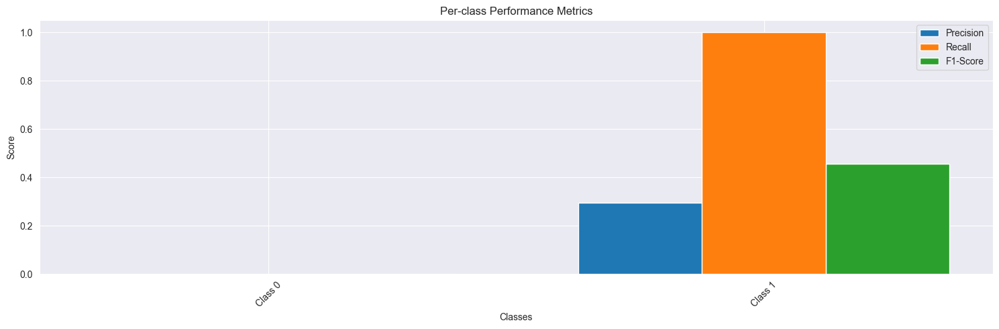


Other metrics:
loss: 1.0375
accuracy: 0.7422
precision: 0.7422
recall: 0.7422
val_loss: 1.3392
val_accuracy: 0.2946
val_precision: 0.2946
val_recall: 0.2946
val_per_class_f1: 0.2276

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 298ms/step - loss: 1.0375 - accuracy: 0.7422 - precision: 0.7422 - recall: 0.7422 - per_class_f1: 0.7217 - val_loss: 1.3392 - val_accuracy: 0.2946 - val_precision: 0.2946 - val_recall: 0.2946 - val_per_class_f1: 0.2276


2024-11-13 14:11:22,165 - INFO - Shuffled data for next epoch


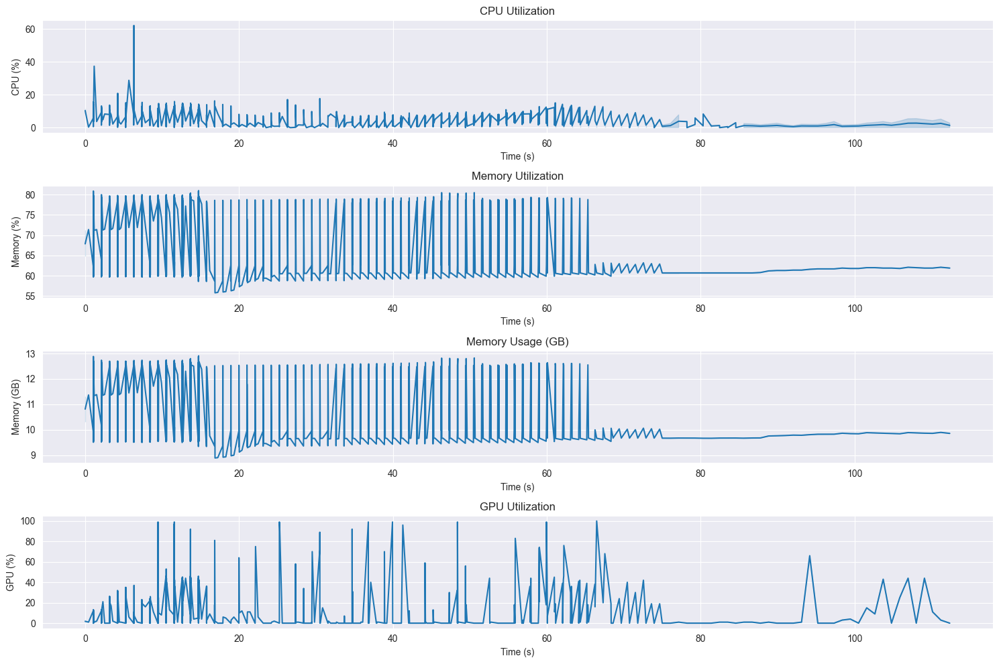



Local epochs:  50%|█████     | 3/6 [01:49<01:32, 30.95s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 6.50
max_cpu_percent: 62.20
avg_memory_gb: 10.62
max_memory_gb: 12.91
avg_memory_percent: 66.66
max_memory_percent: 81.00
avg_gpu_percent: 14.92
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2339.66
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 1.0375, Val Loss: 1.3392
Accuracy: 0.7422, Val Accuracy: 0.2946

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9911 - accuracy: 0.7440 - precision: 0.7440 - recall: 0.7440 - per_class_f1: 0.7267
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.0000  0.0000    0.0000
Class 1     0.2946  1.0000    0.4551

Averages:
  Class  Precision  Recall  F1-Score
Average     0.1473  0.5000    0.2276


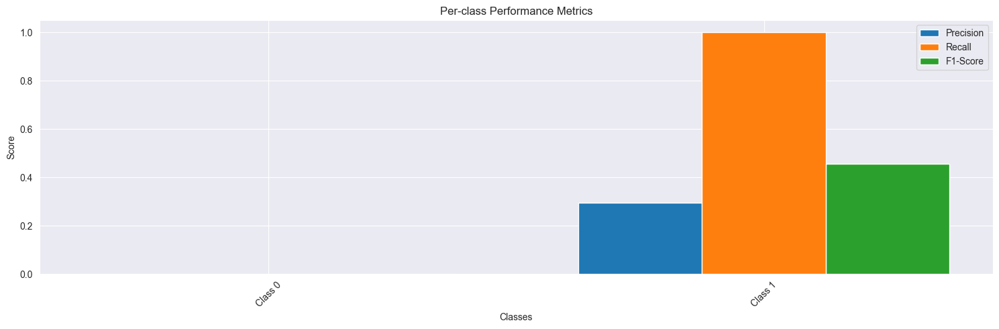


Other metrics:
loss: 0.9911
accuracy: 0.7440
precision: 0.7440
recall: 0.7440
val_loss: 1.5419
val_accuracy: 0.2946
val_precision: 0.2946
val_recall: 0.2946
val_per_class_f1: 0.2276

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 298ms/step - loss: 0.9911 - accuracy: 0.7440 - precision: 0.7440 - recall: 0.7440 - per_class_f1: 0.7267 - val_loss: 1.5419 - val_accuracy: 0.2946 - val_precision: 0.2946 - val_recall: 0.2946 - val_per_class_f1: 0.2276


2024-11-13 14:11:41,699 - INFO - Shuffled data for next epoch


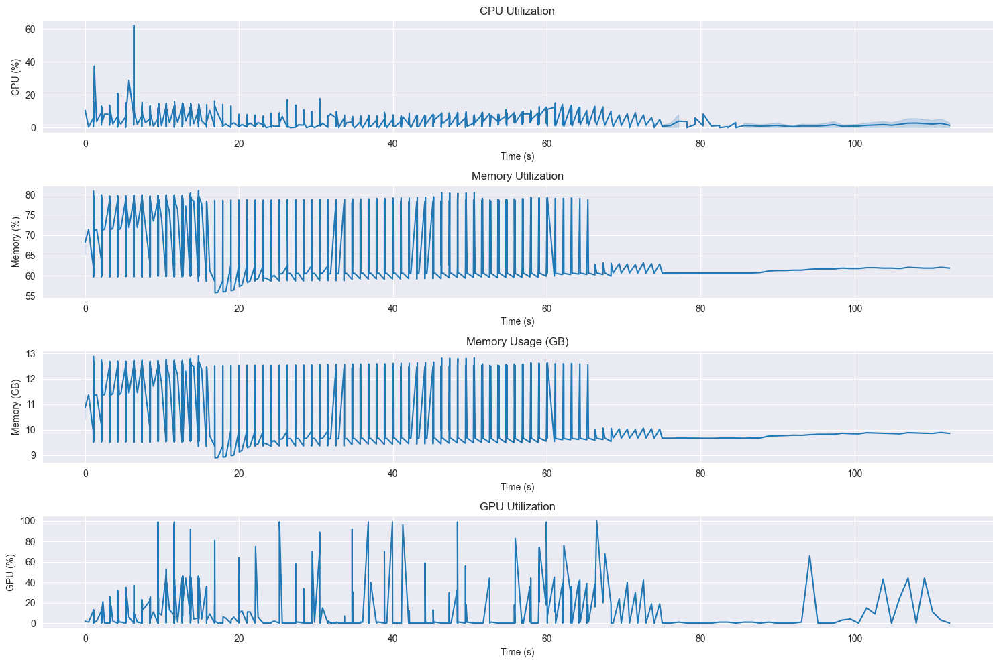

Local epochs:  50%|█████     | 3/6 [02:09<02:09, 43.06s/it]

Training Clients: 100%|██████████| 5/5 [13:13<00:00, 158.64s/it]


Resource Usage Summary:
duration_seconds: 14.79
avg_cpu_percent: 6.57
max_cpu_percent: 62.20
avg_memory_gb: 10.65
max_memory_gb: 12.91
avg_memory_percent: 66.89
max_memory_percent: 81.00
avg_gpu_percent: 15.02
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2341.11
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.9911, Val Loss: 1.5419
Accuracy: 0.7440, Val Accuracy: 0.2946
Early stopping triggered for client 4



Federated Learning Rounds:  20%|██        | 1/5 [13:23<53:33, 803.37s/it]


Test metrics:
loss: 1.2061
accuracy: 0.2946
precision: 0.2946
recall: 0.2946
f1_metric: 0.1933

Round Summary:
val_loss: 1.5306
loss: 0.9398

Per-class F1 scores:
Class 0: 0.8063
Class 1: 0.6747
accuracy: 0.7572
precision: 0.7572
recall: 0.7572
val_accuracy: 0.3506
val_precision: 0.3506
val_recall: 0.3506
val_per_class_f1: 0.3091

Federated Learning Round 2/5



Training Clients:   0%|          | 0/5 [00:00<?, ?it/s]


==================== Training Client 1 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9796 - accuracy: 0.7308 - precision: 0.7308 - recall: 0.7308 - per_class_f1: 0.7089
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8691  0.2382    0.3740
Class 1     0.3338  0.9141    0.4891

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6015  0.5762    0.4315


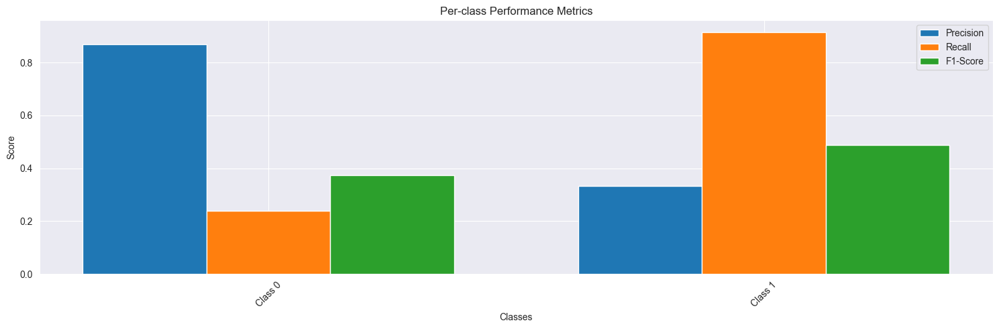


Other metrics:
loss: 0.9796
accuracy: 0.7308
precision: 0.7308
recall: 0.7308
val_loss: 1.1170
val_accuracy: 0.4373
val_precision: 0.4373
val_recall: 0.4373
val_per_class_f1: 0.4315

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 298ms/step - loss: 0.9796 - accuracy: 0.7308 - precision: 0.7308 - recall: 0.7308 - per_class_f1: 0.7089 - val_loss: 1.1170 - val_accuracy: 0.4373 - val_precision: 0.4373 - val_recall: 0.4373 - val_per_class_f1: 0.4315


2024-11-13 14:12:11,189 - INFO - Shuffled data for next epoch


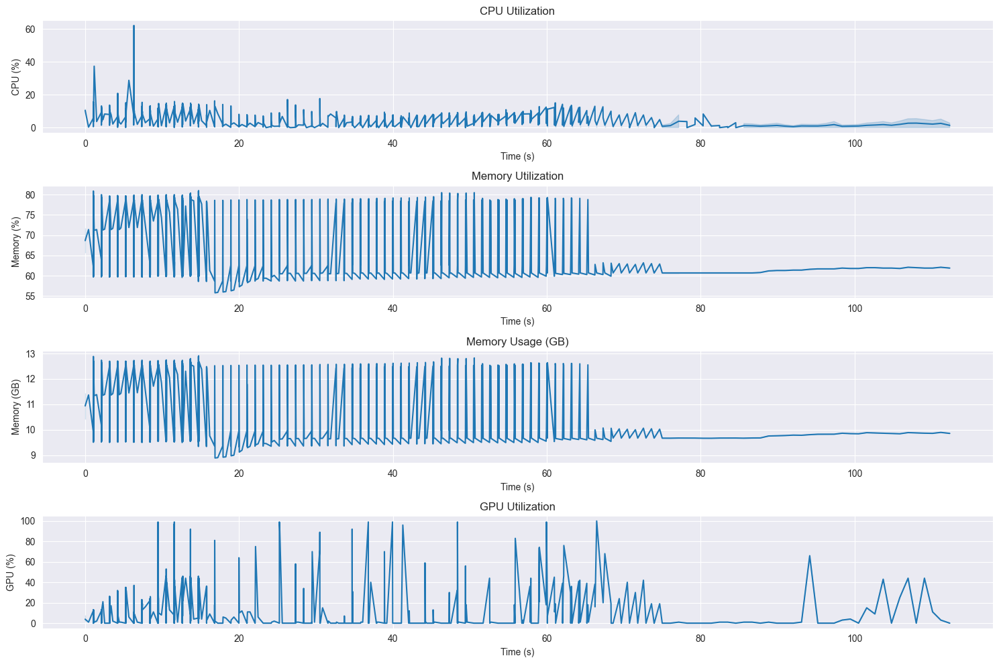



Local epochs:  17%|█▋        | 1/6 [00:19<01:38, 19.69s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 6.65
max_cpu_percent: 62.20
avg_memory_gb: 10.69
max_memory_gb: 12.91
avg_memory_percent: 67.11
max_memory_percent: 81.00
avg_gpu_percent: 15.22
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2342.50
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.9796, Val Loss: 1.1170
Accuracy: 0.7308, Val Accuracy: 0.4373

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9298 - accuracy: 0.7477 - precision: 0.7477 - recall: 0.7477 - per_class_f1: 0.7272
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7582  0.7341    0.7460
Class 1     0.4084  0.4394    0.4233

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5833  0.5868    0.5847


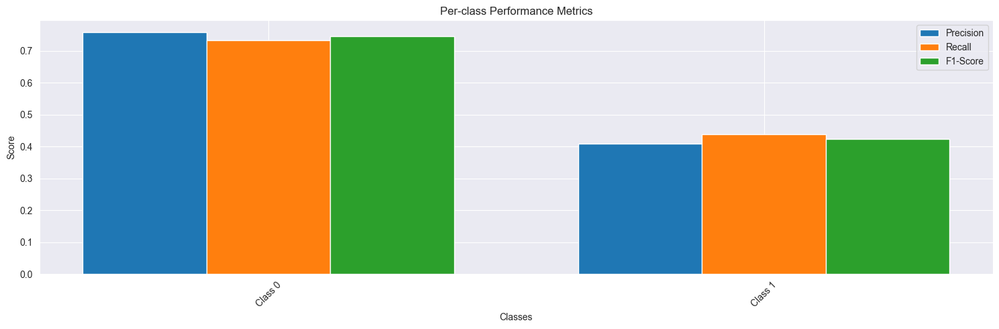


Other metrics:
loss: 0.9298
accuracy: 0.7477
precision: 0.7477
recall: 0.7477
val_loss: 1.0482
val_accuracy: 0.6473
val_precision: 0.6473
val_recall: 0.6473
val_per_class_f1: 0.5847

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 297ms/step - loss: 0.9298 - accuracy: 0.7477 - precision: 0.7477 - recall: 0.7477 - per_class_f1: 0.7272 - val_loss: 1.0482 - val_accuracy: 0.6473 - val_precision: 0.6473 - val_recall: 0.6473 - val_per_class_f1: 0.5847


2024-11-13 14:12:30,911 - INFO - Shuffled data for next epoch


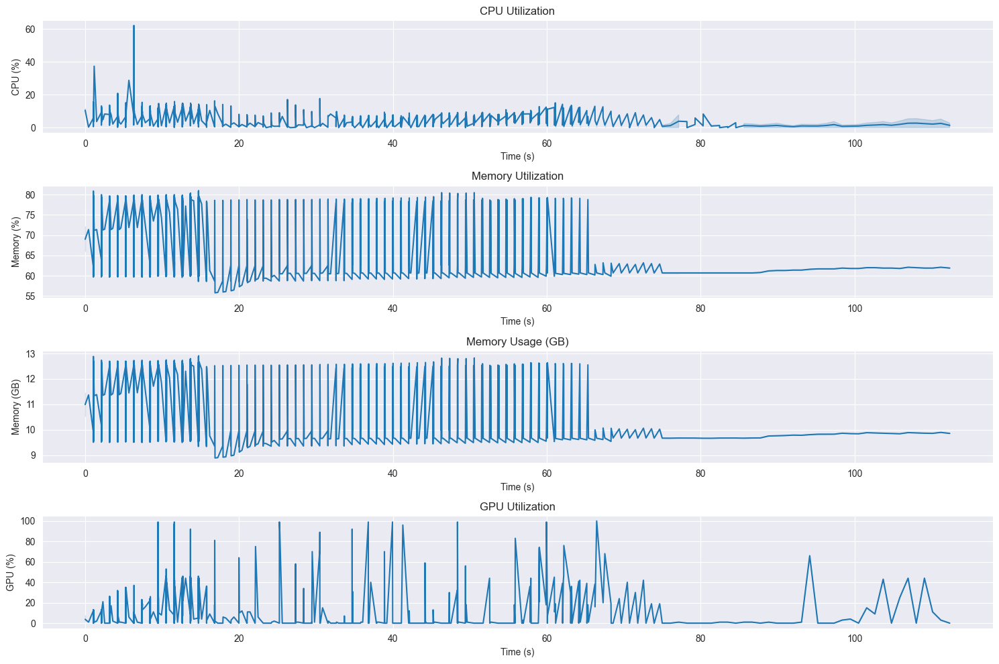



Local epochs:  33%|███▎      | 2/6 [00:39<01:18, 19.62s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 6.73
max_cpu_percent: 62.20
avg_memory_gb: 10.72
max_memory_gb: 12.91
avg_memory_percent: 67.32
max_memory_percent: 81.00
avg_gpu_percent: 15.33
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2343.84
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.9298, Val Loss: 1.0482
Accuracy: 0.7477, Val Accuracy: 0.6473

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8618 - accuracy: 0.7664 - precision: 0.7664 - recall: 0.7664 - per_class_f1: 0.7507
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7391  0.8665    0.7977
Class 1     0.4556  0.2676    0.3372

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5974  0.5670    0.5675


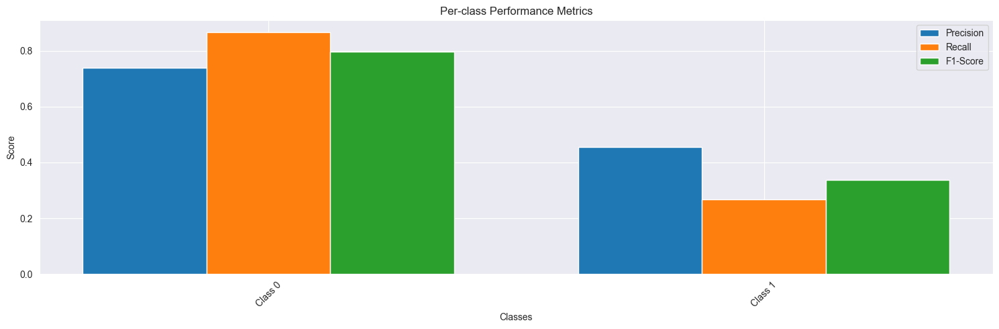


Other metrics:
loss: 0.8618
accuracy: 0.7664
precision: 0.7664
recall: 0.7664
val_loss: 0.9971
val_accuracy: 0.6900
val_precision: 0.6900
val_recall: 0.6900
val_per_class_f1: 0.5675

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 297ms/step - loss: 0.8618 - accuracy: 0.7664 - precision: 0.7664 - recall: 0.7664 - per_class_f1: 0.7507 - val_loss: 0.9971 - val_accuracy: 0.6900 - val_precision: 0.6900 - val_recall: 0.6900 - val_per_class_f1: 0.5675


2024-11-13 14:12:50,448 - INFO - Shuffled data for next epoch


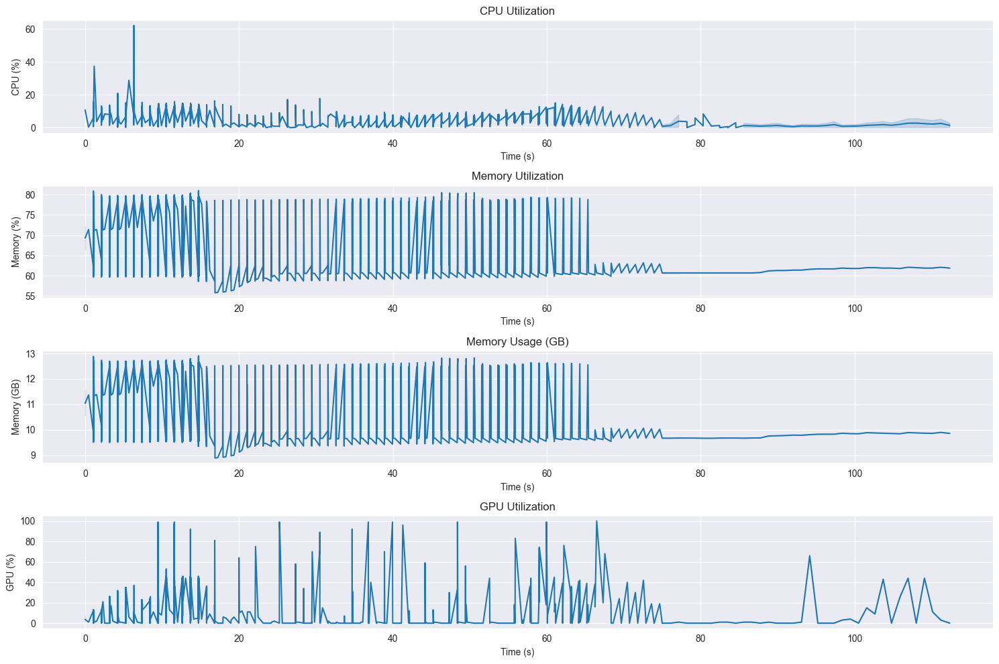



Local epochs:  50%|█████     | 3/6 [00:58<00:58, 19.53s/it]


Resource Usage Summary:
duration_seconds: 14.79
avg_cpu_percent: 6.81
max_cpu_percent: 62.20
avg_memory_gb: 10.76
max_memory_gb: 12.91
avg_memory_percent: 67.52
max_memory_percent: 81.00
avg_gpu_percent: 15.41
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2345.14
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.8618, Val Loss: 0.9971
Accuracy: 0.7664, Val Accuracy: 0.6900

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8265 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7527
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7775  0.6206    0.6902
Class 1     0.3875  0.5746    0.4628

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5825  0.5976    0.5765


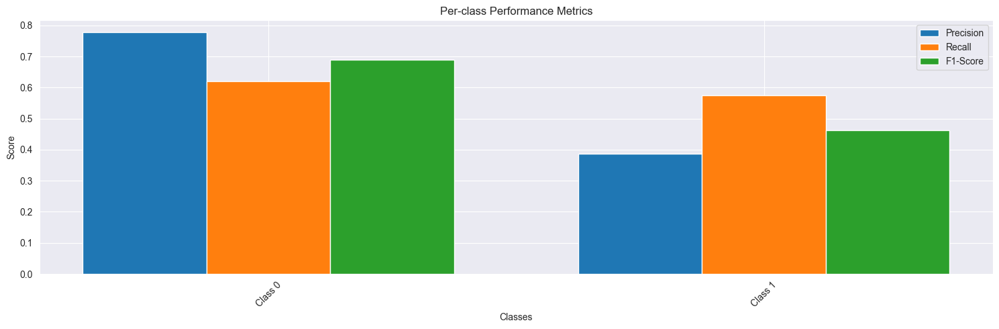


Other metrics:
loss: 0.8265
accuracy: 0.7683
precision: 0.7683
recall: 0.7683
val_loss: 1.0058
val_accuracy: 0.6071
val_precision: 0.6071
val_recall: 0.6071
val_per_class_f1: 0.5765

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 298ms/step - loss: 0.8265 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7527 - val_loss: 1.0058 - val_accuracy: 0.6071 - val_precision: 0.6071 - val_recall: 0.6071 - val_per_class_f1: 0.5765


2024-11-13 14:13:09,944 - INFO - Shuffled data for next epoch


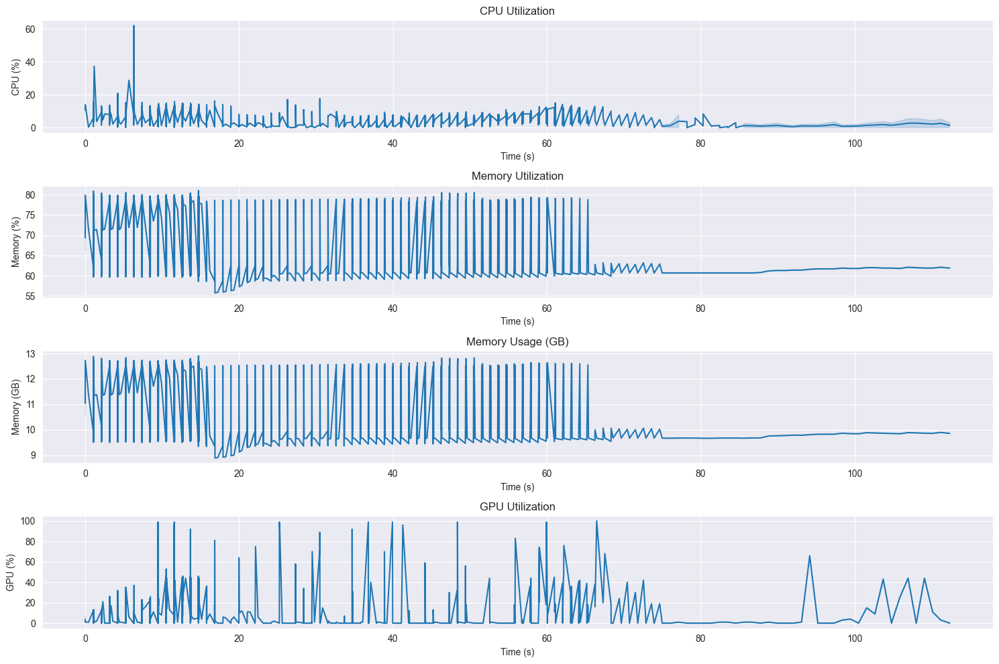



Local epochs:  67%|██████▋   | 4/6 [01:18<00:39, 19.59s/it]


Resource Usage Summary:
duration_seconds: 14.81
avg_cpu_percent: 6.86
max_cpu_percent: 62.20
avg_memory_gb: 10.79
max_memory_gb: 12.91
avg_memory_percent: 67.73
max_memory_percent: 81.00
avg_gpu_percent: 15.46
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2346.38
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.8265, Val Loss: 1.0058
Accuracy: 0.7683, Val Accuracy: 0.6071

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7928 - accuracy: 0.7791 - precision: 0.7791 - recall: 0.7791 - per_class_f1: 0.7655
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7567  0.7941    0.7750
Class 1     0.4409  0.3887    0.4132

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5988  0.5914    0.5941


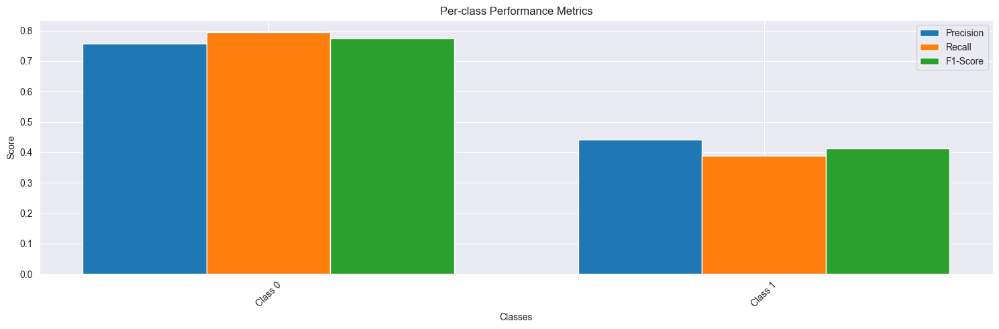


Other metrics:
loss: 0.7928
accuracy: 0.7791
precision: 0.7791
recall: 0.7791
val_loss: 0.9516
val_accuracy: 0.6747
val_precision: 0.6747
val_recall: 0.6747
val_per_class_f1: 0.5941

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 299ms/step - loss: 0.7928 - accuracy: 0.7791 - precision: 0.7791 - recall: 0.7791 - per_class_f1: 0.7655 - val_loss: 0.9516 - val_accuracy: 0.6747 - val_precision: 0.6747 - val_recall: 0.6747 - val_per_class_f1: 0.5941


2024-11-13 14:13:29,588 - INFO - Shuffled data for next epoch


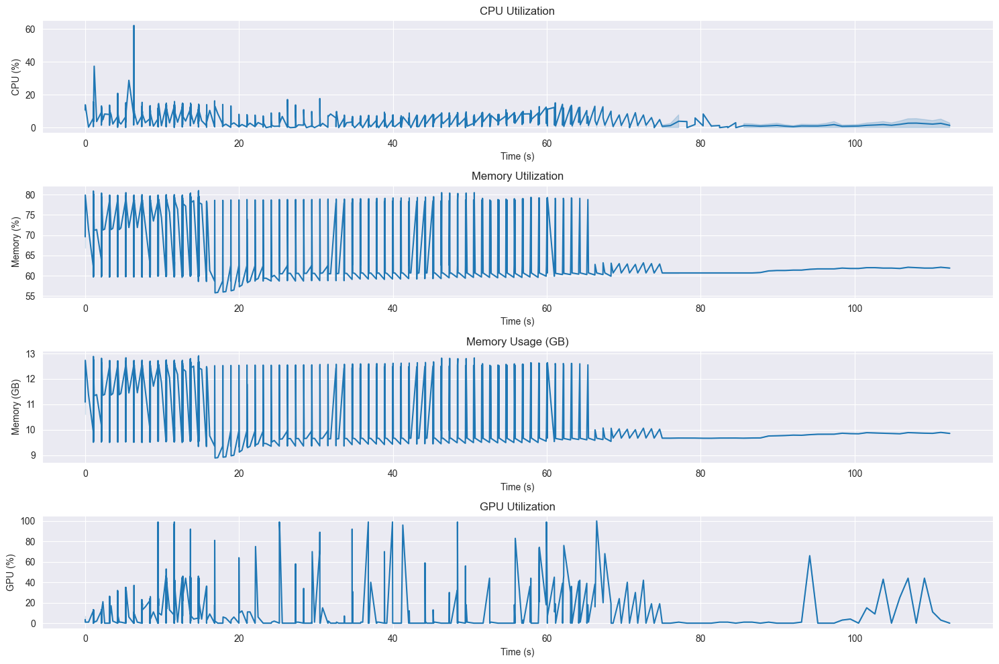



Local epochs:  83%|████████▎ | 5/6 [01:37<00:19, 19.48s/it]


Resource Usage Summary:
duration_seconds: 14.71
avg_cpu_percent: 6.92
max_cpu_percent: 62.20
avg_memory_gb: 10.82
max_memory_gb: 12.91
avg_memory_percent: 67.91
max_memory_percent: 81.00
avg_gpu_percent: 15.52
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2347.59
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.7928, Val Loss: 0.9516
Accuracy: 0.7791, Val Accuracy: 0.6747

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7449 - accuracy: 0.7864 - precision: 0.7864 - recall: 0.7864 - per_class_f1: 0.7746
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7714  0.7206    0.7451
Class 1     0.4221  0.4887    0.4530

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5968  0.6047    0.5991


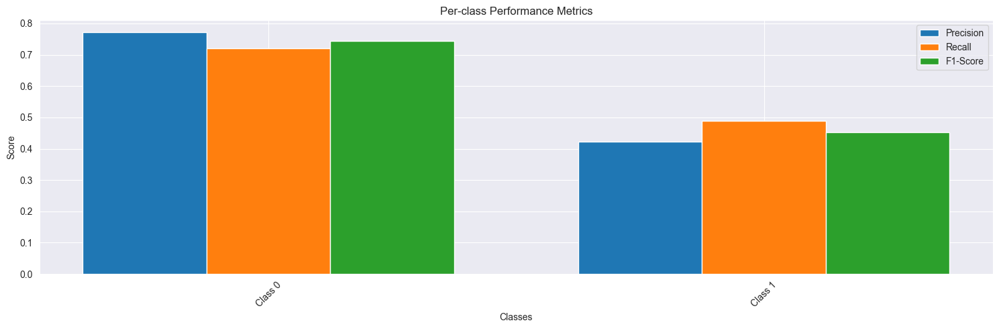


Other metrics:
loss: 0.7449
accuracy: 0.7864
precision: 0.7864
recall: 0.7864
val_loss: 0.9193
val_accuracy: 0.6523
val_precision: 0.6523
val_recall: 0.6523
val_per_class_f1: 0.5991

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 299ms/step - loss: 0.7449 - accuracy: 0.7864 - precision: 0.7864 - recall: 0.7864 - per_class_f1: 0.7746 - val_loss: 0.9193 - val_accuracy: 0.6523 - val_precision: 0.6523 - val_recall: 0.6523 - val_per_class_f1: 0.5991


2024-11-13 14:13:48,965 - INFO - Shuffled data for next epoch


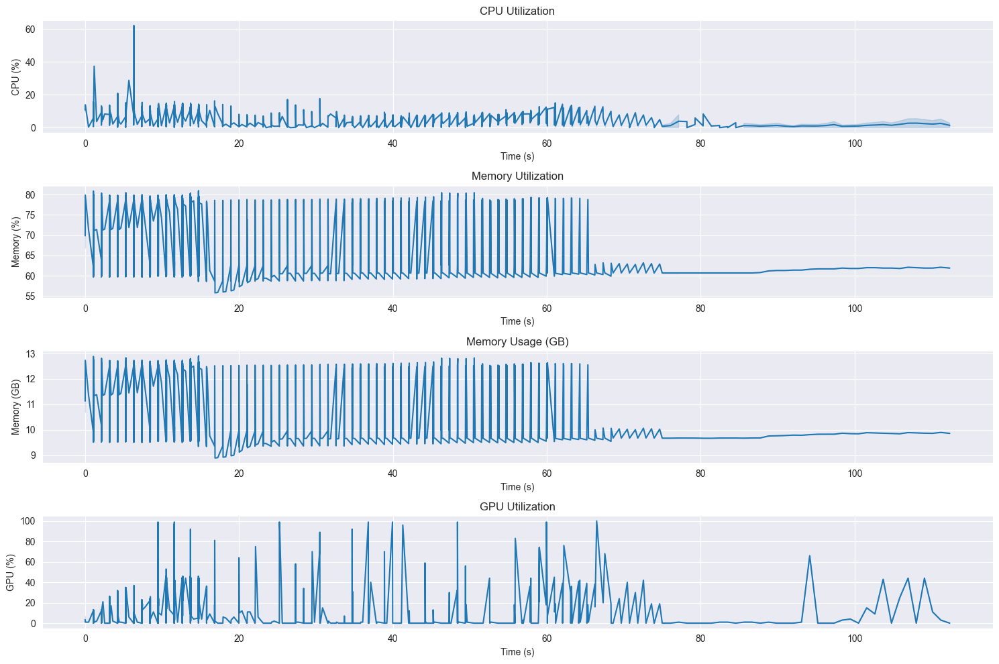



Local epochs: 100%|██████████| 6/6 [01:57<00:00, 19.54s/it]

Training Clients:  20%|██        | 1/5 [01:57<07:49, 117.27s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 6.96
max_cpu_percent: 62.20
avg_memory_gb: 10.84
max_memory_gb: 12.91
avg_memory_percent: 68.07
max_memory_percent: 81.00
avg_gpu_percent: 15.59
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2348.75
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.7449, Val Loss: 0.9193
Accuracy: 0.7864, Val Accuracy: 0.6523

==================== Training Client 2 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9723 - accuracy: 0.7339 - precision: 0.7339 - recall: 0.7339 - per_class_f1: 0.7110
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0112    0.0221
Class 1     0.2969  1.0000    0.4579

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6485  0.5056    0.2400


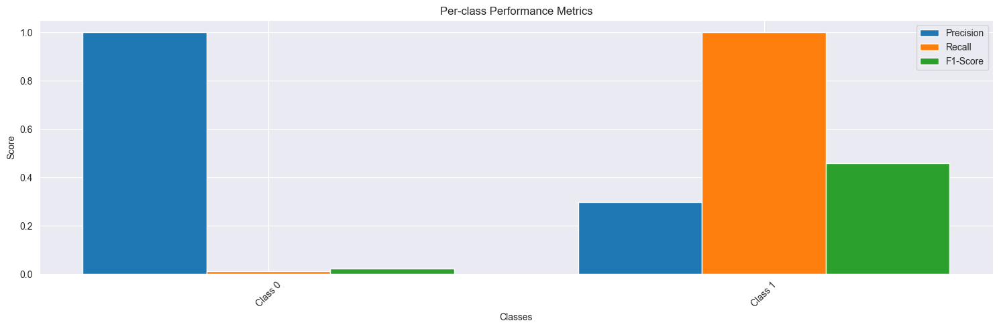


Other metrics:
loss: 0.9723
accuracy: 0.7339
precision: 0.7339
recall: 0.7339
val_loss: 1.2242
val_accuracy: 0.3025
val_precision: 0.3025
val_recall: 0.3025
val_per_class_f1: 0.2400

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 297ms/step - loss: 0.9723 - accuracy: 0.7339 - precision: 0.7339 - recall: 0.7339 - per_class_f1: 0.7110 - val_loss: 1.2242 - val_accuracy: 0.3025 - val_precision: 0.3025 - val_recall: 0.3025 - val_per_class_f1: 0.2400


2024-11-13 14:14:08,506 - INFO - Shuffled data for next epoch


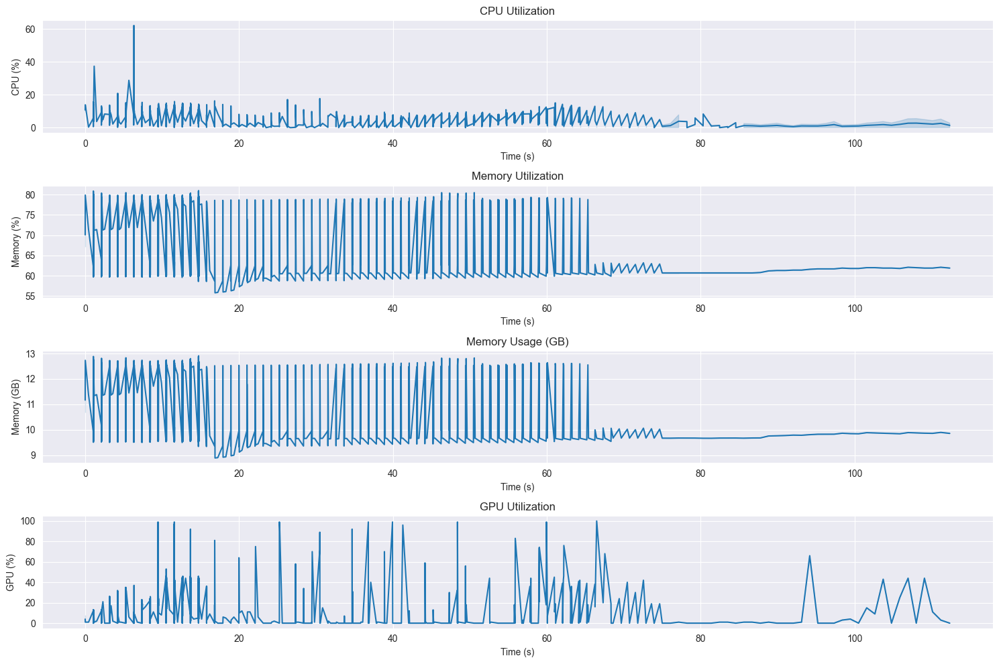



Local epochs:  17%|█▋        | 1/6 [00:19<01:37, 19.55s/it]


Resource Usage Summary:
duration_seconds: 14.82
avg_cpu_percent: 7.02
max_cpu_percent: 62.20
avg_memory_gb: 10.87
max_memory_gb: 12.91
avg_memory_percent: 68.23
max_memory_percent: 81.00
avg_gpu_percent: 15.72
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2349.87
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.9723, Val Loss: 1.2242
Accuracy: 0.7339, Val Accuracy: 0.3025

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9347 - accuracy: 0.7399 - precision: 0.7399 - recall: 0.7399 - per_class_f1: 0.7250
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0229    0.0449
Class 1     0.2995  1.0000    0.4609

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6497  0.5115    0.2529


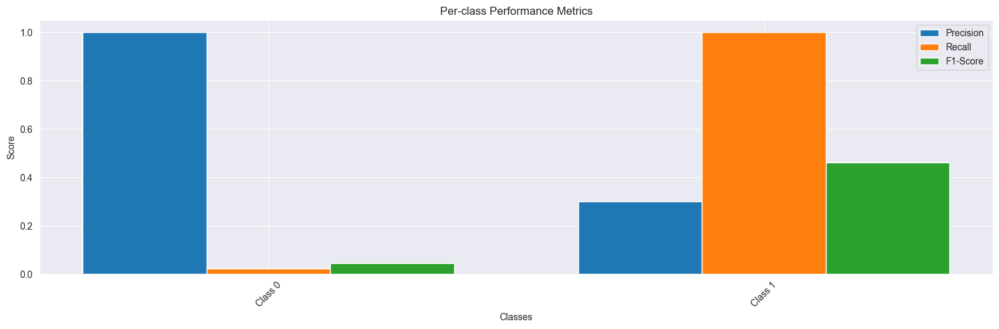


Other metrics:
loss: 0.9347
accuracy: 0.7399
precision: 0.7399
recall: 0.7399
val_loss: 1.2218
val_accuracy: 0.3108
val_precision: 0.3108
val_recall: 0.3108
val_per_class_f1: 0.2529

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 300ms/step - loss: 0.9347 - accuracy: 0.7399 - precision: 0.7399 - recall: 0.7399 - per_class_f1: 0.7250 - val_loss: 1.2218 - val_accuracy: 0.3108 - val_precision: 0.3108 - val_recall: 0.3108 - val_per_class_f1: 0.2529


2024-11-13 14:14:28,198 - INFO - Shuffled data for next epoch


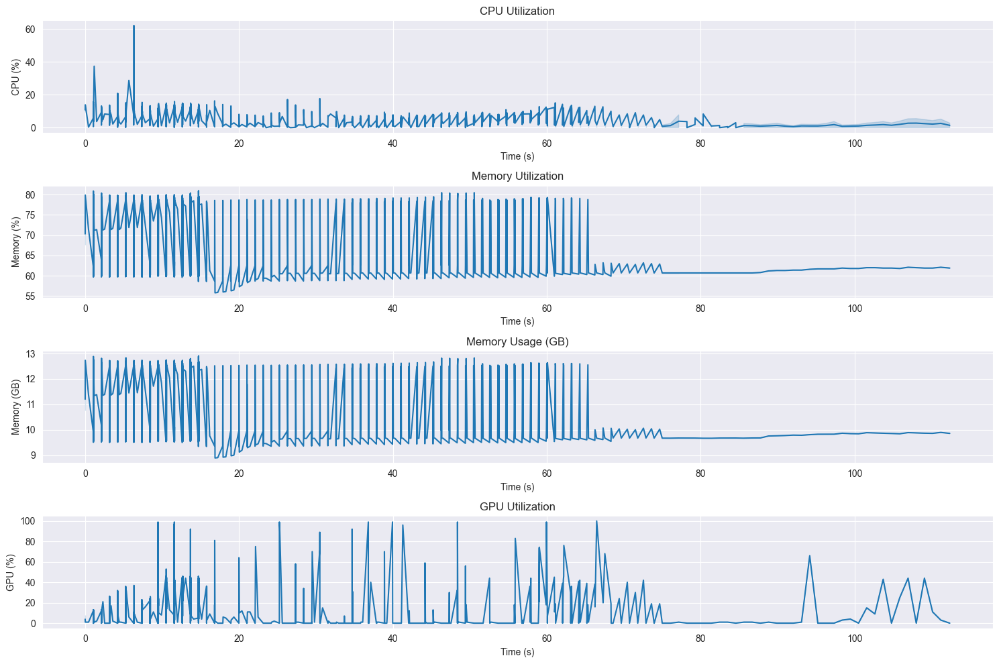



Local epochs:  33%|███▎      | 2/6 [00:39<01:18, 19.63s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.08
max_cpu_percent: 62.20
avg_memory_gb: 10.89
max_memory_gb: 12.91
avg_memory_percent: 68.39
max_memory_percent: 81.00
avg_gpu_percent: 15.79
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2350.96
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.9347, Val Loss: 1.2218
Accuracy: 0.7399, Val Accuracy: 0.3108

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8758 - accuracy: 0.7640 - precision: 0.7640 - recall: 0.7640 - per_class_f1: 0.7482
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9101  0.3394    0.4944
Class 1     0.3677  0.9197    0.5253

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6389  0.6296    0.5099


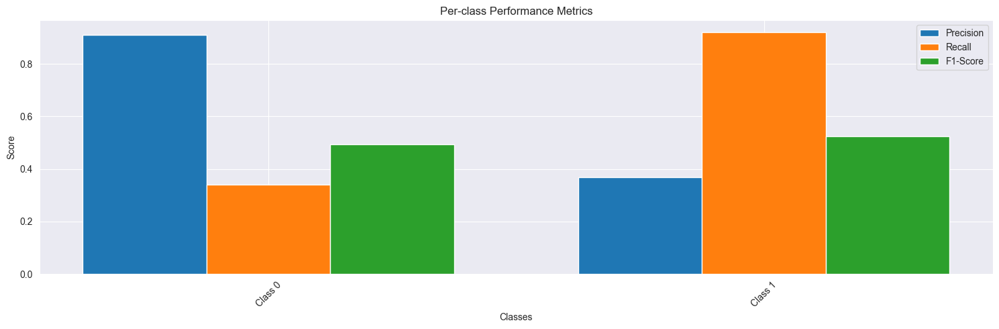


Other metrics:
loss: 0.8758
accuracy: 0.7640
precision: 0.7640
recall: 0.7640
val_loss: 1.0898
val_accuracy: 0.5104
val_precision: 0.5104
val_recall: 0.5104
val_per_class_f1: 0.5099

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 302ms/step - loss: 0.8758 - accuracy: 0.7640 - precision: 0.7640 - recall: 0.7640 - per_class_f1: 0.7482 - val_loss: 1.0898 - val_accuracy: 0.5104 - val_precision: 0.5104 - val_recall: 0.5104 - val_per_class_f1: 0.5099


2024-11-13 14:14:47,986 - INFO - Shuffled data for next epoch


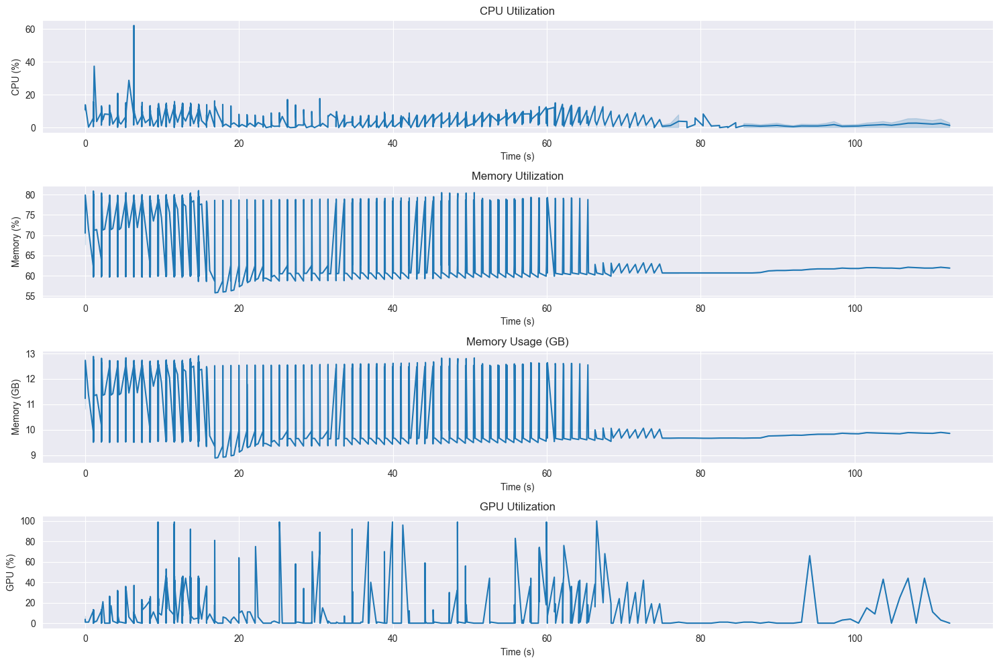



Local epochs:  50%|█████     | 3/6 [00:58<00:58, 19.53s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 7.12
max_cpu_percent: 62.20
avg_memory_gb: 10.92
max_memory_gb: 12.91
avg_memory_percent: 68.53
max_memory_percent: 81.00
avg_gpu_percent: 15.92
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2352.01
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.8758, Val Loss: 1.0898
Accuracy: 0.7640, Val Accuracy: 0.5104

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8436 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7553
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8318  0.5382    0.6536
Class 1     0.4008  0.7394    0.5198

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6163  0.6388    0.5867


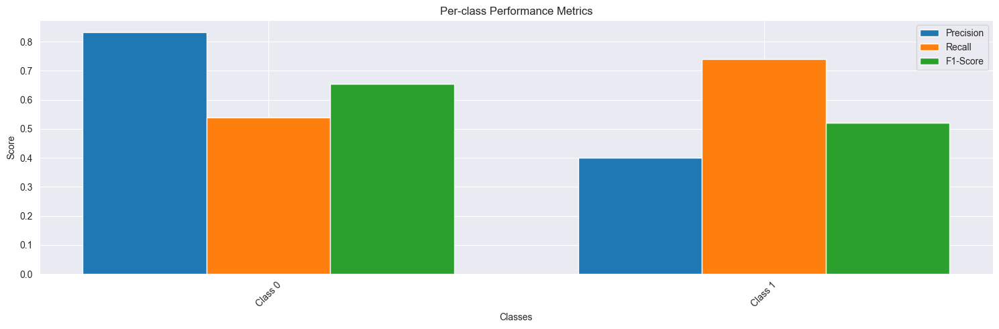


Other metrics:
loss: 0.8436
accuracy: 0.7683
precision: 0.7683
recall: 0.7683
val_loss: 0.9997
val_accuracy: 0.5975
val_precision: 0.5975
val_recall: 0.5975
val_per_class_f1: 0.5867

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 300ms/step - loss: 0.8436 - accuracy: 0.7683 - precision: 0.7683 - recall: 0.7683 - per_class_f1: 0.7553 - val_loss: 0.9997 - val_accuracy: 0.5975 - val_precision: 0.5975 - val_recall: 0.5975 - val_per_class_f1: 0.5867


2024-11-13 14:15:07,317 - INFO - Shuffled data for next epoch


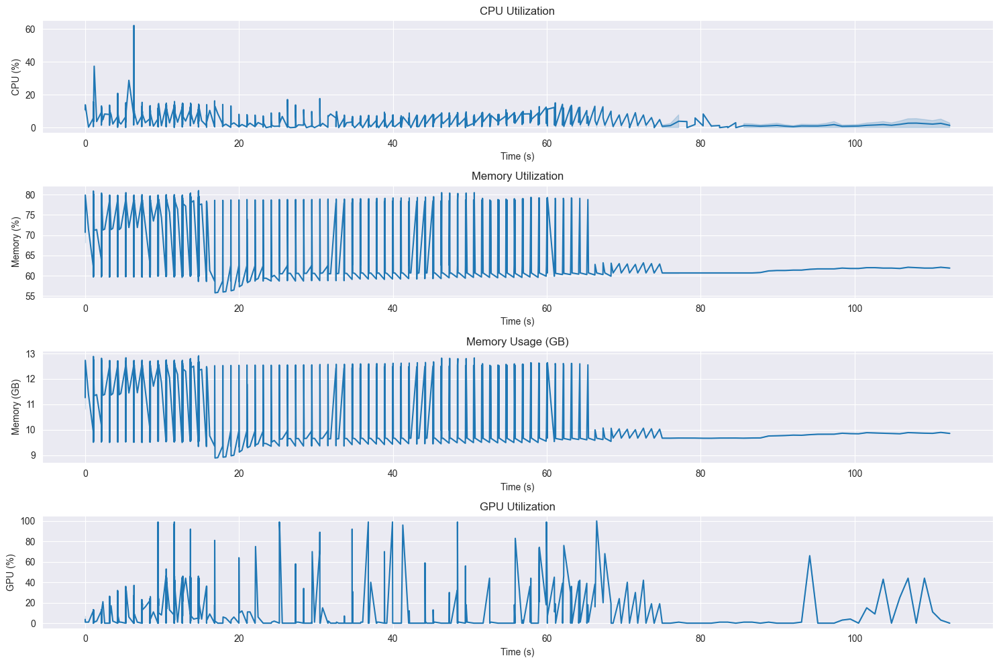



Local epochs:  67%|██████▋   | 4/6 [01:18<00:39, 19.61s/it]


Resource Usage Summary:
duration_seconds: 14.72
avg_cpu_percent: 7.14
max_cpu_percent: 62.20
avg_memory_gb: 10.94
max_memory_gb: 12.91
avg_memory_percent: 68.67
max_memory_percent: 81.00
avg_gpu_percent: 16.02
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2353.02
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.8436, Val Loss: 0.9997
Accuracy: 0.7683, Val Accuracy: 0.5975

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8136 - accuracy: 0.7870 - precision: 0.7870 - recall: 0.7870 - per_class_f1: 0.7739
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7124  0.9253    0.8050
Class 1     0.3713  0.1056    0.1645

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5418  0.5155    0.4847


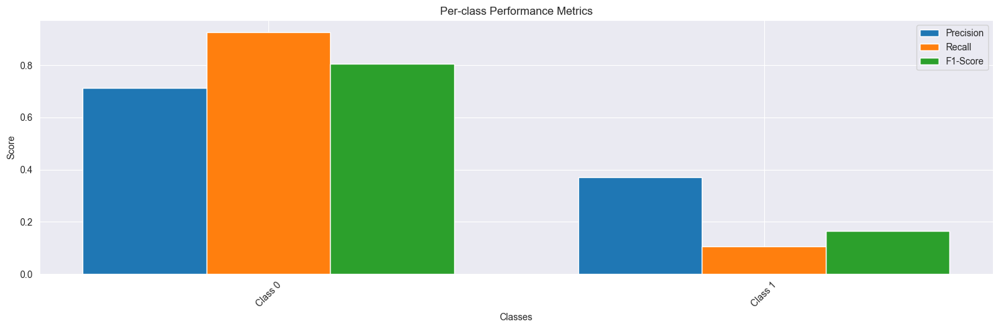


Other metrics:
loss: 0.8136
accuracy: 0.7870
precision: 0.7870
recall: 0.7870
val_loss: 0.8914
val_accuracy: 0.6838
val_precision: 0.6838
val_recall: 0.6838
val_per_class_f1: 0.4847

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 300ms/step - loss: 0.8136 - accuracy: 0.7870 - precision: 0.7870 - recall: 0.7870 - per_class_f1: 0.7739 - val_loss: 0.8914 - val_accuracy: 0.6838 - val_precision: 0.6838 - val_recall: 0.6838 - val_per_class_f1: 0.4847


2024-11-13 14:15:27,014 - INFO - Shuffled data for next epoch


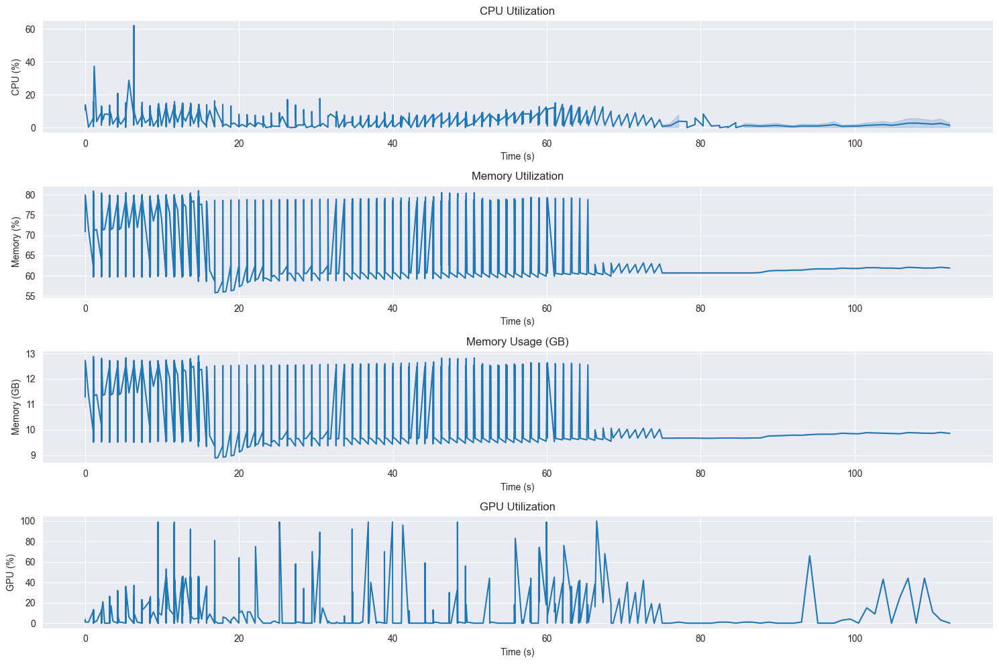



Local epochs:  83%|████████▎ | 5/6 [01:37<00:19, 19.55s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.16
max_cpu_percent: 62.20
avg_memory_gb: 10.96
max_memory_gb: 12.91
avg_memory_percent: 68.81
max_memory_percent: 81.00
avg_gpu_percent: 16.15
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2354.01
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.8136, Val Loss: 0.8914
Accuracy: 0.7870, Val Accuracy: 0.6838

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7806 - accuracy: 0.7791 - precision: 0.7791 - recall: 0.7791 - per_class_f1: 0.7645
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7378  0.8706    0.7987
Class 1     0.4554  0.2592    0.3303

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5966  0.5649    0.5645


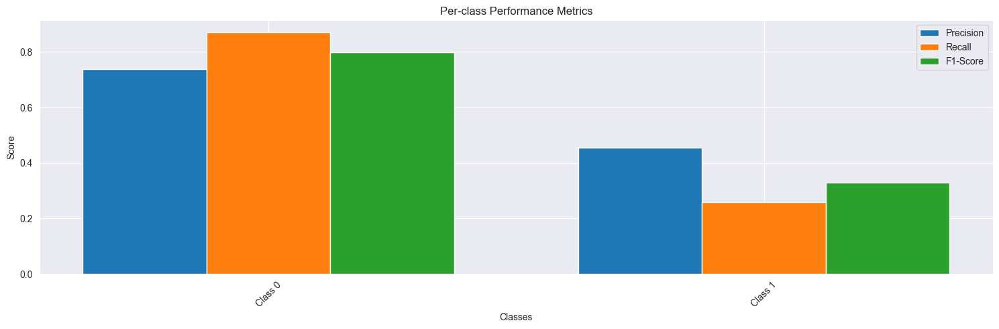


Other metrics:
loss: 0.7806
accuracy: 0.7791
precision: 0.7791
recall: 0.7791
val_loss: 0.8739
val_accuracy: 0.6905
val_precision: 0.6905
val_recall: 0.6905
val_per_class_f1: 0.5645

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 302ms/step - loss: 0.7806 - accuracy: 0.7791 - precision: 0.7791 - recall: 0.7791 - per_class_f1: 0.7645 - val_loss: 0.8739 - val_accuracy: 0.6905 - val_precision: 0.6905 - val_recall: 0.6905 - val_per_class_f1: 0.5645


2024-11-13 14:15:46,638 - INFO - Shuffled data for next epoch


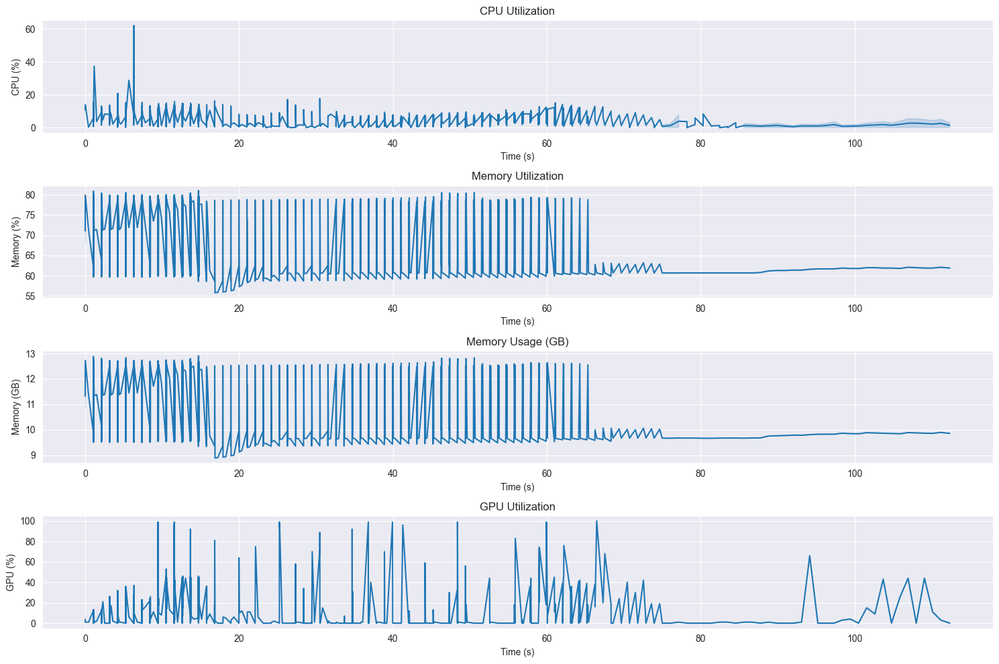



Local epochs: 100%|██████████| 6/6 [01:57<00:00, 19.59s/it]

Training Clients:  40%|████      | 2/5 [03:54<05:52, 117.46s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.19
max_cpu_percent: 62.20
avg_memory_gb: 10.98
max_memory_gb: 12.91
avg_memory_percent: 68.95
max_memory_percent: 81.00
avg_gpu_percent: 16.21
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2354.96
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.7806, Val Loss: 0.8739
Accuracy: 0.7791, Val Accuracy: 0.6905

==================== Training Client 3 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9746 - accuracy: 0.7308 - precision: 0.7308 - recall: 0.7308 - per_class_f1: 0.7113
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7202  0.8235    0.7684
Class 1     0.3562  0.2338    0.2823

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5382  0.5287    0.5253


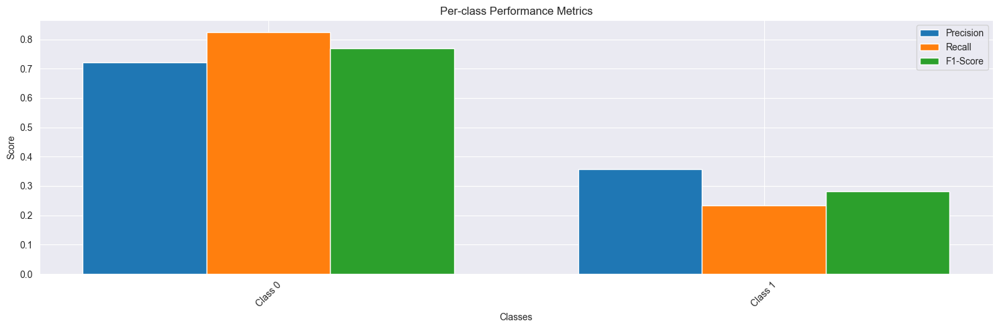


Other metrics:
loss: 0.9746
accuracy: 0.7308
precision: 0.7308
recall: 0.7308
val_loss: 1.0815
val_accuracy: 0.6498
val_precision: 0.6498
val_recall: 0.6498
val_per_class_f1: 0.5253

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 302ms/step - loss: 0.9746 - accuracy: 0.7308 - precision: 0.7308 - recall: 0.7308 - per_class_f1: 0.7113 - val_loss: 1.0815 - val_accuracy: 0.6498 - val_precision: 0.6498 - val_recall: 0.6498 - val_per_class_f1: 0.5253


2024-11-13 14:16:06,329 - INFO - Shuffled data for next epoch


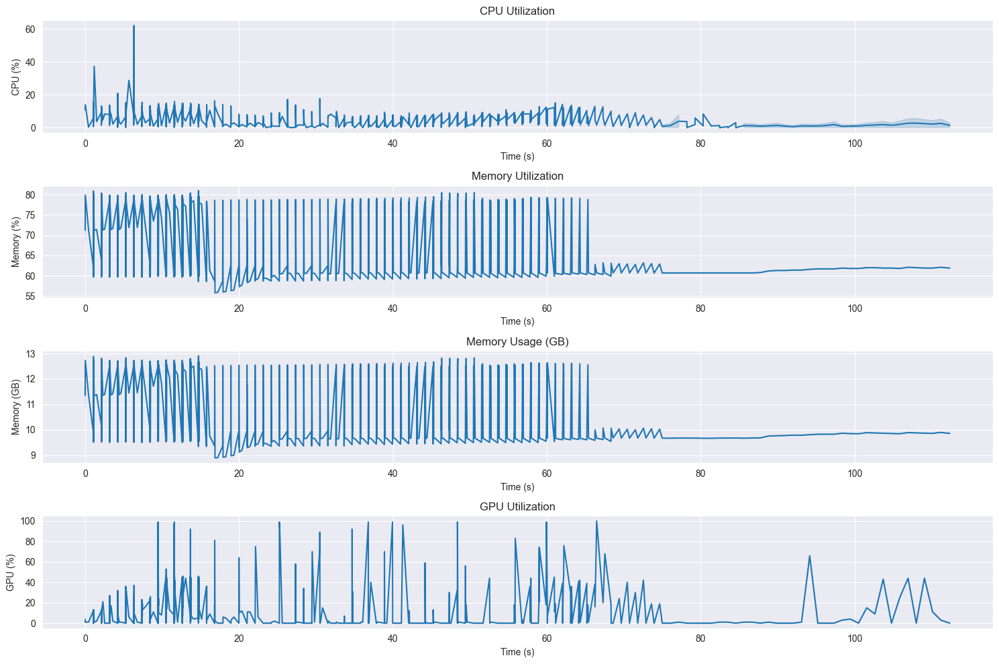



Local epochs:  17%|█▋        | 1/6 [00:19<01:37, 19.54s/it]


Resource Usage Summary:
duration_seconds: 14.82
avg_cpu_percent: 7.23
max_cpu_percent: 62.20
avg_memory_gb: 11.00
max_memory_gb: 12.91
avg_memory_percent: 69.08
max_memory_percent: 81.00
avg_gpu_percent: 16.29
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2355.89
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.9746, Val Loss: 1.0815
Accuracy: 0.7308, Val Accuracy: 0.6498

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9297 - accuracy: 0.7441 - precision: 0.7441 - recall: 0.7441 - per_class_f1: 0.7226
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7047  0.9965    0.8255
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3523  0.4982    0.4128


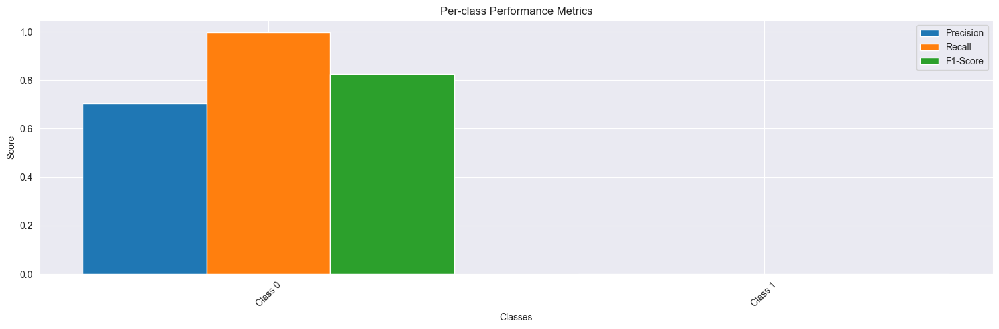


Other metrics:
loss: 0.9297
accuracy: 0.7441
precision: 0.7441
recall: 0.7441
val_loss: 0.9958
val_accuracy: 0.7029
val_precision: 0.7029
val_recall: 0.7029
val_per_class_f1: 0.4128

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 298ms/step - loss: 0.9297 - accuracy: 0.7441 - precision: 0.7441 - recall: 0.7441 - per_class_f1: 0.7226 - val_loss: 0.9958 - val_accuracy: 0.7029 - val_precision: 0.7029 - val_recall: 0.7029 - val_per_class_f1: 0.4128


2024-11-13 14:16:25,665 - INFO - Shuffled data for next epoch


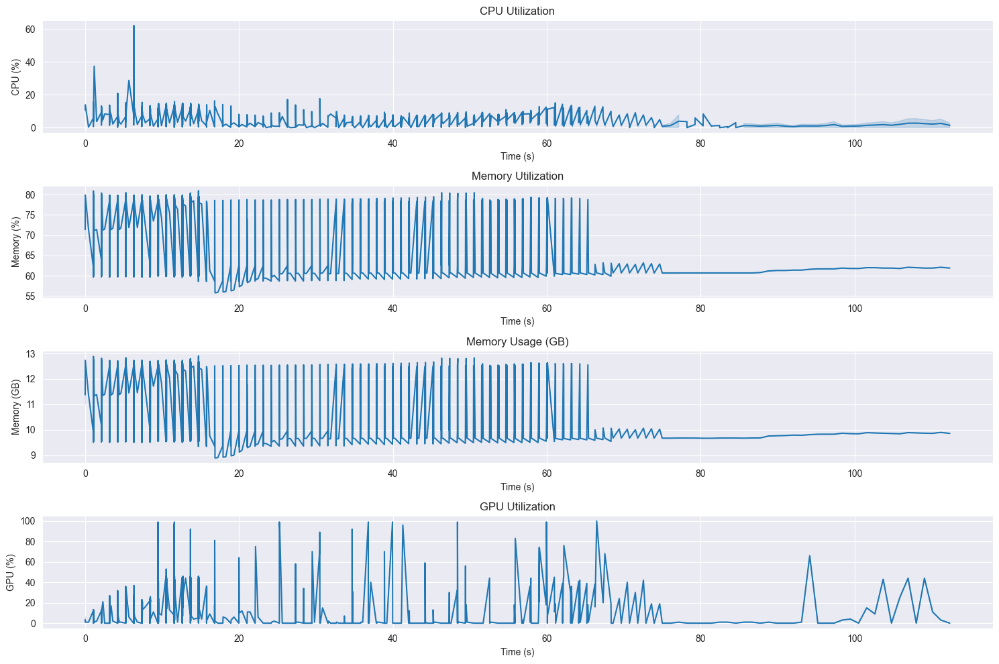



Local epochs:  33%|███▎      | 2/6 [00:39<01:18, 19.67s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 7.29
max_cpu_percent: 62.20
avg_memory_gb: 11.03
max_memory_gb: 12.91
avg_memory_percent: 69.22
max_memory_percent: 81.00
avg_gpu_percent: 16.37
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2356.78
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.9297, Val Loss: 0.9958
Accuracy: 0.7441, Val Accuracy: 0.7029

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8806 - accuracy: 0.7658 - precision: 0.7658 - recall: 0.7658 - per_class_f1: 0.7514
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7051  0.9988    0.8267
Class 1     0.0000  0.0000    0.0000

Averages:
  Class  Precision  Recall  F1-Score
Average     0.3526  0.4994    0.4133


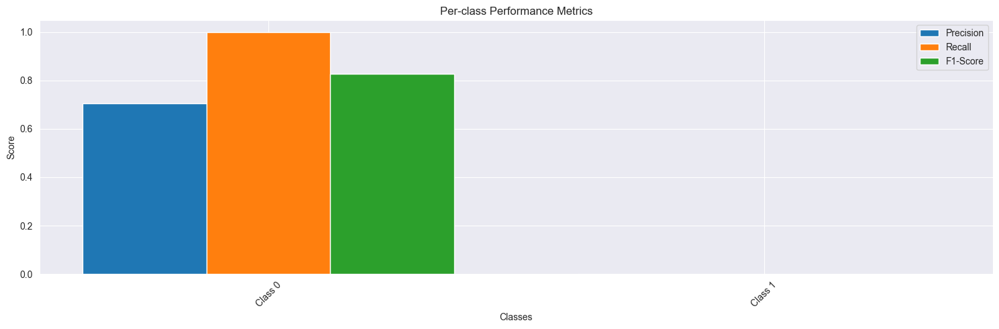


Other metrics:
loss: 0.8806
accuracy: 0.7658
precision: 0.7658
recall: 0.7658
val_loss: 0.9489
val_accuracy: 0.7046
val_precision: 0.7046
val_recall: 0.7046
val_per_class_f1: 0.4133

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 302ms/step - loss: 0.8806 - accuracy: 0.7658 - precision: 0.7658 - recall: 0.7658 - per_class_f1: 0.7514 - val_loss: 0.9489 - val_accuracy: 0.7046 - val_precision: 0.7046 - val_recall: 0.7046 - val_per_class_f1: 0.4133


2024-11-13 14:16:45,591 - INFO - Shuffled data for next epoch


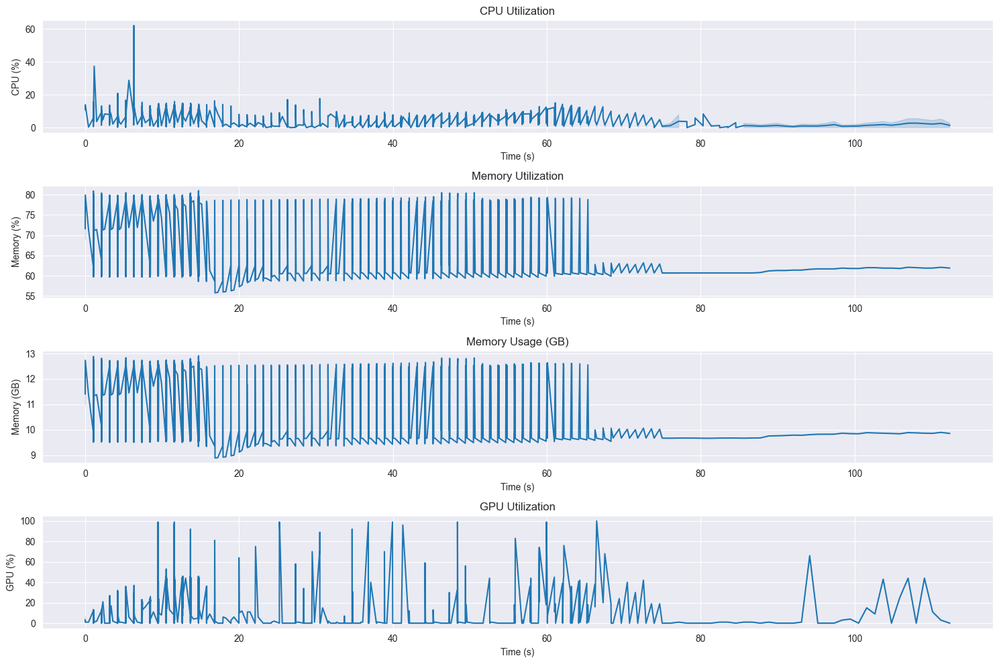



Local epochs:  50%|█████     | 3/6 [00:58<00:58, 19.60s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 7.33
max_cpu_percent: 62.20
avg_memory_gb: 11.05
max_memory_gb: 12.91
avg_memory_percent: 69.35
max_memory_percent: 81.00
avg_gpu_percent: 16.46
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2357.65
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.8806, Val Loss: 0.9489
Accuracy: 0.7658, Val Accuracy: 0.7046

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8339 - accuracy: 0.7670 - precision: 0.7670 - recall: 0.7670 - per_class_f1: 0.7538
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7004  0.9047    0.7895
Class 1     0.2430  0.0732    0.1126

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4717  0.4890    0.4510


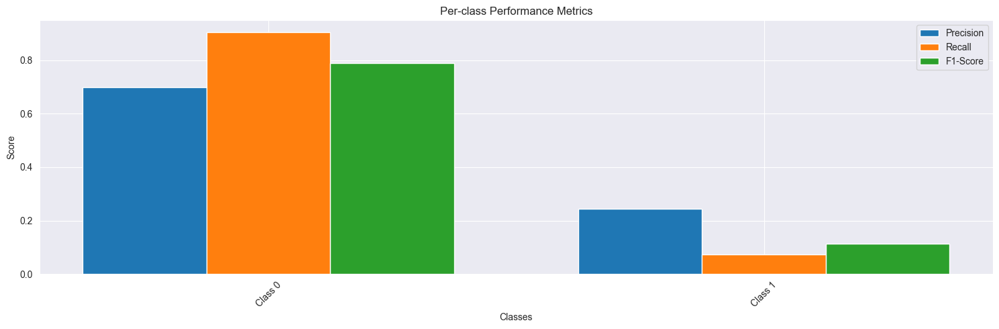


Other metrics:
loss: 0.8339
accuracy: 0.7670
precision: 0.7670
recall: 0.7670
val_loss: 0.9821
val_accuracy: 0.6598
val_precision: 0.6598
val_recall: 0.6598
val_per_class_f1: 0.4510

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 301ms/step - loss: 0.8339 - accuracy: 0.7670 - precision: 0.7670 - recall: 0.7670 - per_class_f1: 0.7538 - val_loss: 0.9821 - val_accuracy: 0.6598 - val_precision: 0.6598 - val_recall: 0.6598 - val_per_class_f1: 0.4510


2024-11-13 14:17:05,089 - INFO - Shuffled data for next epoch


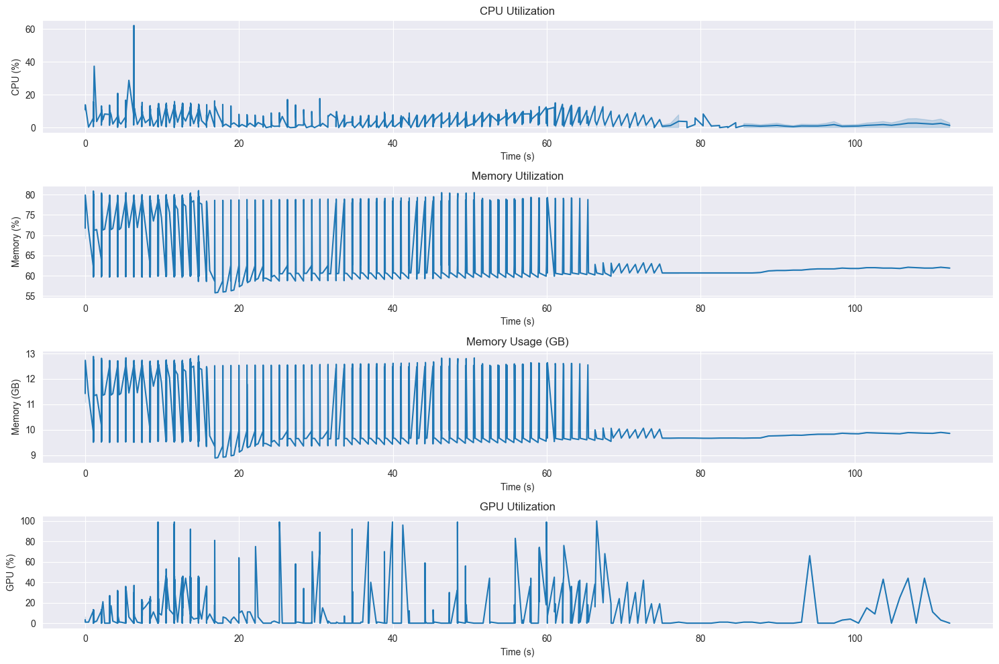



Local epochs:  67%|██████▋   | 4/6 [01:18<00:39, 19.66s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.36
max_cpu_percent: 62.20
avg_memory_gb: 11.07
max_memory_gb: 12.91
avg_memory_percent: 69.48
max_memory_percent: 81.00
avg_gpu_percent: 16.54
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2358.49
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.8339, Val Loss: 0.9821
Accuracy: 0.7670, Val Accuracy: 0.6598

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7936 - accuracy: 0.7773 - precision: 0.7773 - recall: 0.7773 - per_class_f1: 0.7647
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7640  0.4894    0.5966
Class 1     0.3429  0.6380    0.4461

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5535  0.5637    0.5214


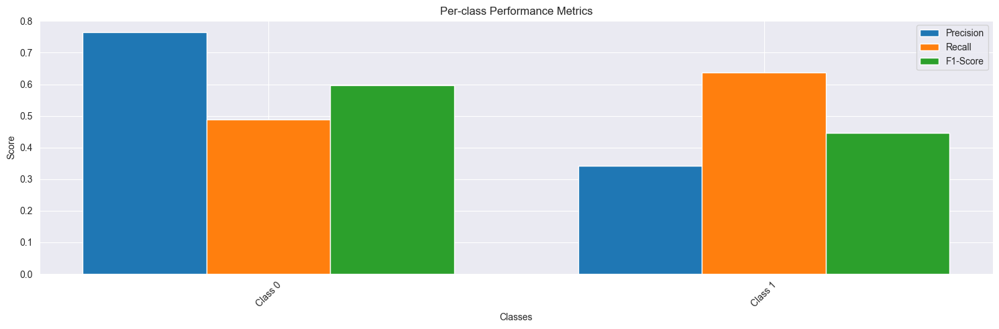


Other metrics:
loss: 0.7936
accuracy: 0.7773
precision: 0.7773
recall: 0.7773
val_loss: 0.9931
val_accuracy: 0.5332
val_precision: 0.5332
val_recall: 0.5332
val_per_class_f1: 0.5214

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 303ms/step - loss: 0.7936 - accuracy: 0.7773 - precision: 0.7773 - recall: 0.7773 - per_class_f1: 0.7647 - val_loss: 0.9931 - val_accuracy: 0.5332 - val_precision: 0.5332 - val_recall: 0.5332 - val_per_class_f1: 0.5214


2024-11-13 14:17:24,966 - INFO - Shuffled data for next epoch


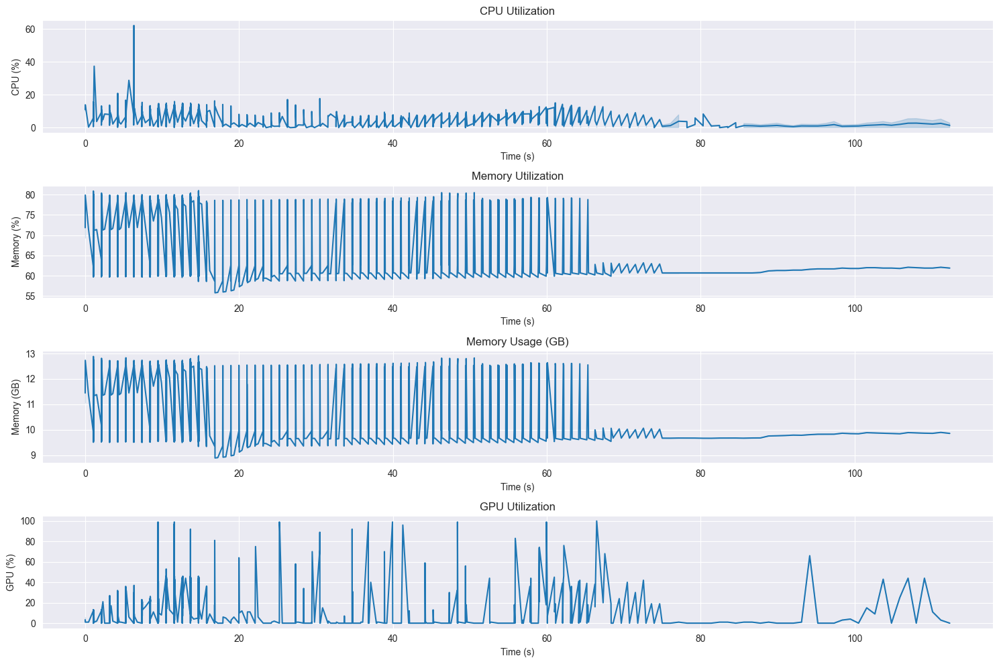



Local epochs:  83%|████████▎ | 5/6 [01:39<00:19, 19.99s/it]


Resource Usage Summary:
duration_seconds: 15.83
avg_cpu_percent: 7.39
max_cpu_percent: 62.20
avg_memory_gb: 11.09
max_memory_gb: 12.91
avg_memory_percent: 69.60
max_memory_percent: 81.00
avg_gpu_percent: 16.54
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2359.37
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.7936, Val Loss: 0.9931
Accuracy: 0.7773, Val Accuracy: 0.5332

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7684 - accuracy: 0.7743 - precision: 0.7743 - recall: 0.7743 - per_class_f1: 0.7604
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9250  0.3194    0.4749
Class 1     0.3653  0.9380    0.5259

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6452  0.6287    0.5004


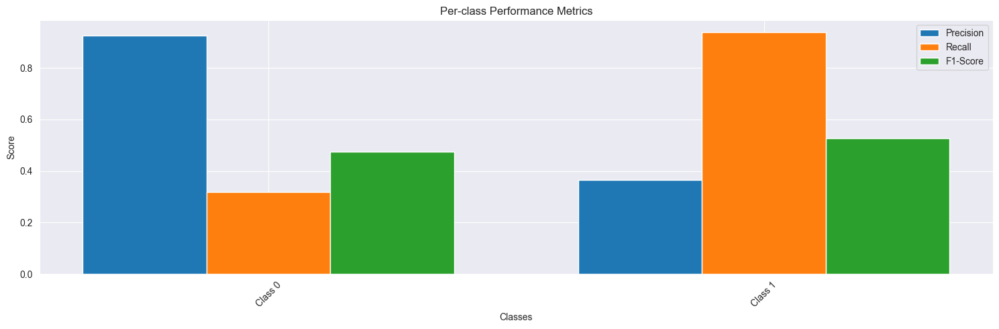


Other metrics:
loss: 0.7684
accuracy: 0.7743
precision: 0.7743
recall: 0.7743
val_loss: 1.0502
val_accuracy: 0.5017
val_precision: 0.5017
val_recall: 0.5017
val_per_class_f1: 0.5004

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 304ms/step - loss: 0.7684 - accuracy: 0.7743 - precision: 0.7743 - recall: 0.7743 - per_class_f1: 0.7604 - val_loss: 1.0502 - val_accuracy: 0.5017 - val_precision: 0.5017 - val_recall: 0.5017 - val_per_class_f1: 0.5004


2024-11-13 14:17:45,569 - INFO - Shuffled data for next epoch


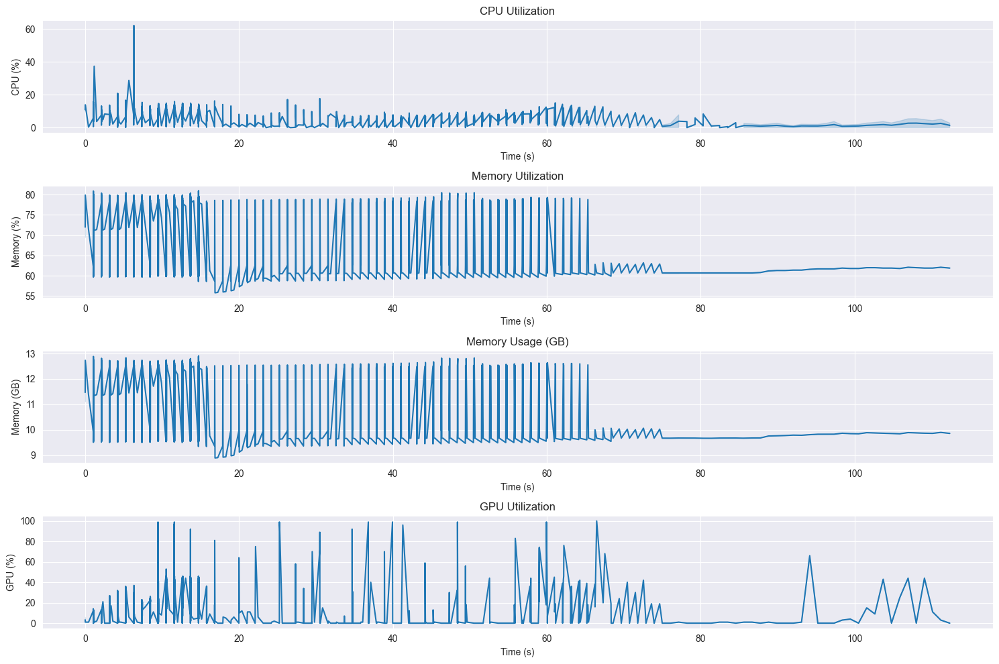

Local epochs:  83%|████████▎ | 5/6 [01:59<00:23, 23.98s/it]

Training Clients:  60%|██████    | 3/5 [05:54<03:57, 118.60s/it]


Resource Usage Summary:
duration_seconds: 15.80
avg_cpu_percent: 7.42
max_cpu_percent: 62.20
avg_memory_gb: 11.11
max_memory_gb: 12.91
avg_memory_percent: 69.72
max_memory_percent: 81.00
avg_gpu_percent: 16.61
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2360.21
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.7684, Val Loss: 1.0502
Accuracy: 0.7743, Val Accuracy: 0.5017
Early stopping triggered for client 2

==================== Training Client 4 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9813 - accuracy: 0.7345 - precision: 0.7345 - recall: 0.7345 - per_class_f1: 0.7165
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0029    0.0059
Class 1     0.2952  1.0000    0.4559

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6476  0.5015    0.2309


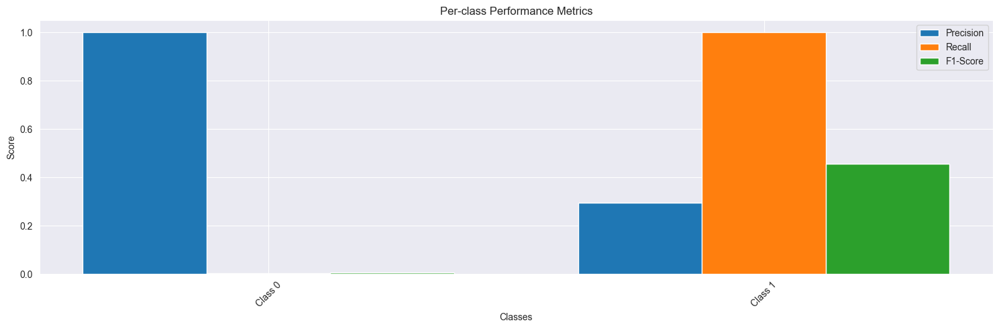


Other metrics:
loss: 0.9813
accuracy: 0.7345
precision: 0.7345
recall: 0.7345
val_loss: 1.2470
val_accuracy: 0.2967
val_precision: 0.2967
val_recall: 0.2967
val_per_class_f1: 0.2309

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 304ms/step - loss: 0.9813 - accuracy: 0.7345 - precision: 0.7345 - recall: 0.7345 - per_class_f1: 0.7165 - val_loss: 1.2470 - val_accuracy: 0.2967 - val_precision: 0.2967 - val_recall: 0.2967 - val_per_class_f1: 0.2309


2024-11-13 14:18:06,358 - INFO - Shuffled data for next epoch


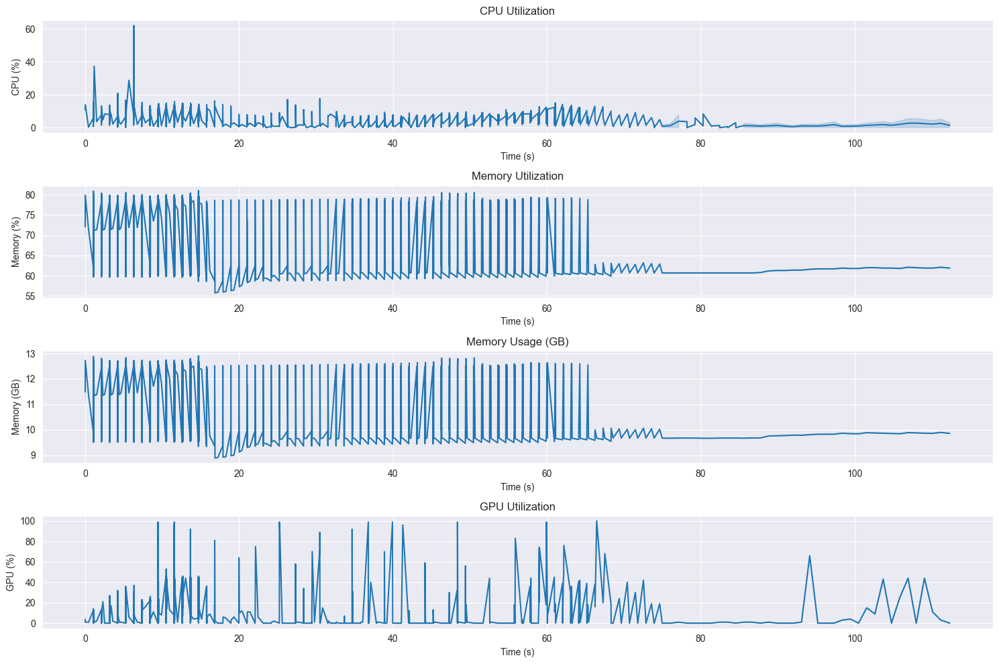



Local epochs:  17%|█▋        | 1/6 [00:20<01:44, 20.80s/it]


Resource Usage Summary:
duration_seconds: 15.83
avg_cpu_percent: 7.45
max_cpu_percent: 62.20
avg_memory_gb: 11.12
max_memory_gb: 12.91
avg_memory_percent: 69.84
max_memory_percent: 81.00
avg_gpu_percent: 16.69
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2361.03
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.9813, Val Loss: 1.2470
Accuracy: 0.7345, Val Accuracy: 0.2967

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9153 - accuracy: 0.7604 - precision: 0.7604 - recall: 0.7604 - per_class_f1: 0.7459
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0047    0.0094
Class 1     0.2956  1.0000    0.4563

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6478  0.5024    0.2328


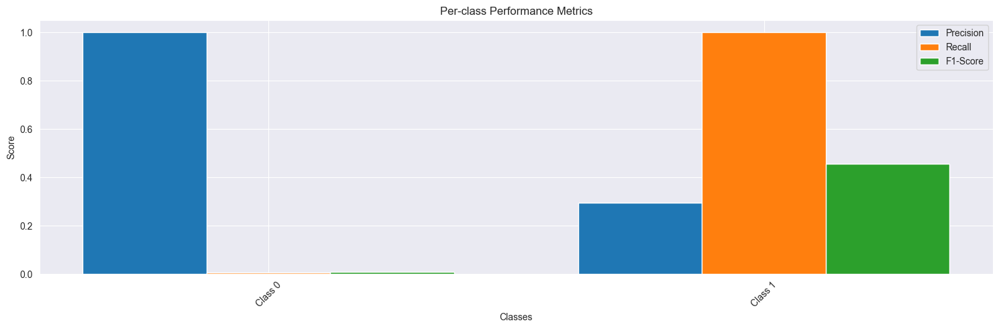


Other metrics:
loss: 0.9153
accuracy: 0.7604
precision: 0.7604
recall: 0.7604
val_loss: 1.6087
val_accuracy: 0.2979
val_precision: 0.2979
val_recall: 0.2979
val_per_class_f1: 0.2328

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 302ms/step - loss: 0.9153 - accuracy: 0.7604 - precision: 0.7604 - recall: 0.7604 - per_class_f1: 0.7459 - val_loss: 1.6087 - val_accuracy: 0.2979 - val_precision: 0.2979 - val_recall: 0.2979 - val_per_class_f1: 0.2328


2024-11-13 14:18:27,116 - INFO - Shuffled data for next epoch


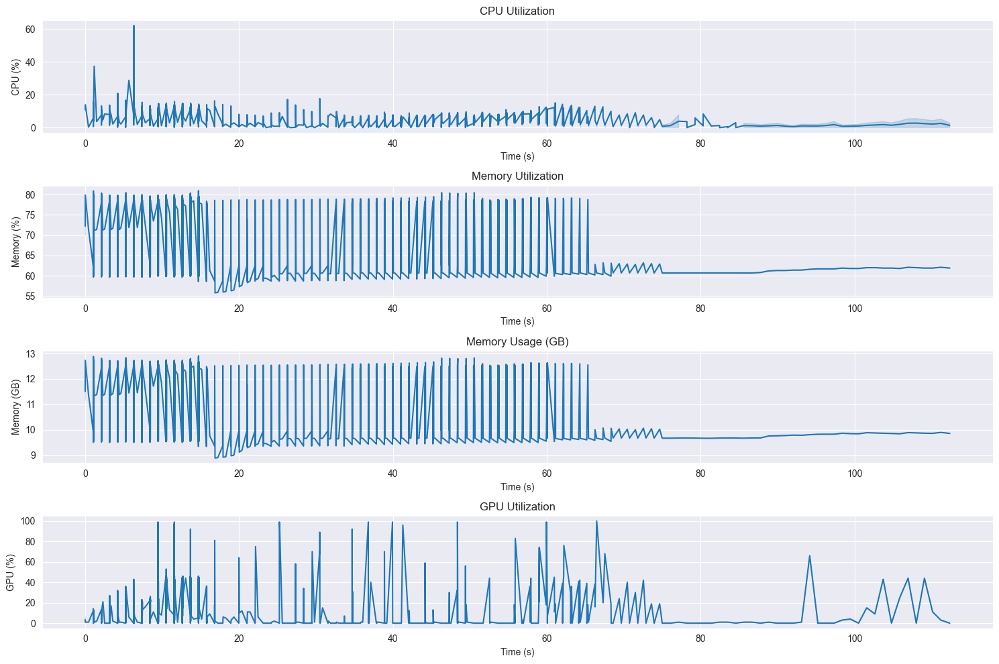



Local epochs:  33%|███▎      | 2/6 [00:40<01:20, 20.14s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.49
max_cpu_percent: 62.20
avg_memory_gb: 11.14
max_memory_gb: 12.91
avg_memory_percent: 69.95
max_memory_percent: 81.00
avg_gpu_percent: 16.71
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2361.78
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.9153, Val Loss: 1.6087
Accuracy: 0.7604, Val Accuracy: 0.2979

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8432 - accuracy: 0.7912 - precision: 0.7912 - recall: 0.7912 - per_class_f1: 0.7811
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0188    0.0370
Class 1     0.2986  1.0000    0.4598

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6493  0.5094    0.2484


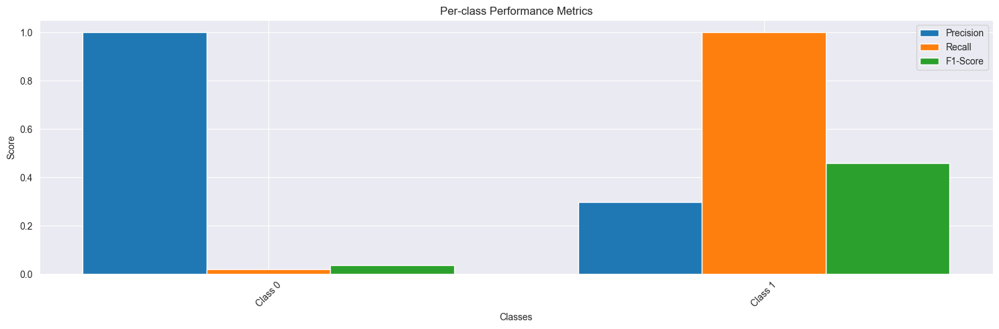


Other metrics:
loss: 0.8432
accuracy: 0.7912
precision: 0.7912
recall: 0.7912
val_loss: 1.4299
val_accuracy: 0.3079
val_precision: 0.3079
val_recall: 0.3079
val_per_class_f1: 0.2484

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 300ms/step - loss: 0.8432 - accuracy: 0.7912 - precision: 0.7912 - recall: 0.7912 - per_class_f1: 0.7811 - val_loss: 1.4299 - val_accuracy: 0.3079 - val_precision: 0.3079 - val_recall: 0.3079 - val_per_class_f1: 0.2484


2024-11-13 14:18:46,672 - INFO - Shuffled data for next epoch


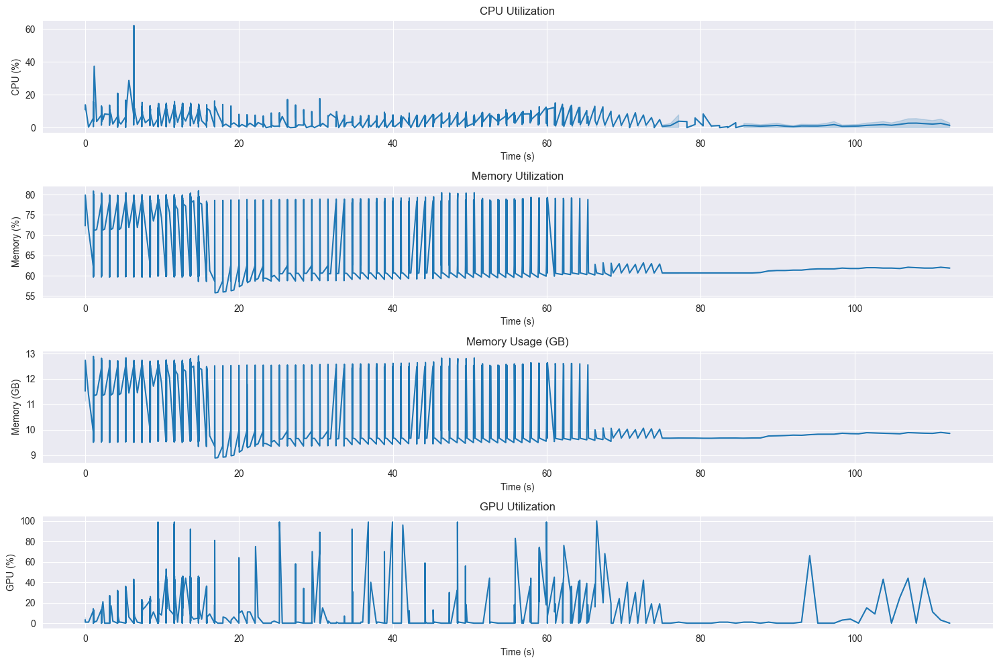



Local epochs:  50%|█████     | 3/6 [01:00<00:59, 19.98s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.54
max_cpu_percent: 62.20
avg_memory_gb: 11.16
max_memory_gb: 12.91
avg_memory_percent: 70.06
max_memory_percent: 81.00
avg_gpu_percent: 16.75
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2362.51
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.8432, Val Loss: 1.4299
Accuracy: 0.7912, Val Accuracy: 0.3079

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8254 - accuracy: 0.7785 - precision: 0.7785 - recall: 0.7785 - per_class_f1: 0.7661
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0006    0.0012
Class 1     0.2947  1.0000    0.4553

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6474  0.5003    0.2282


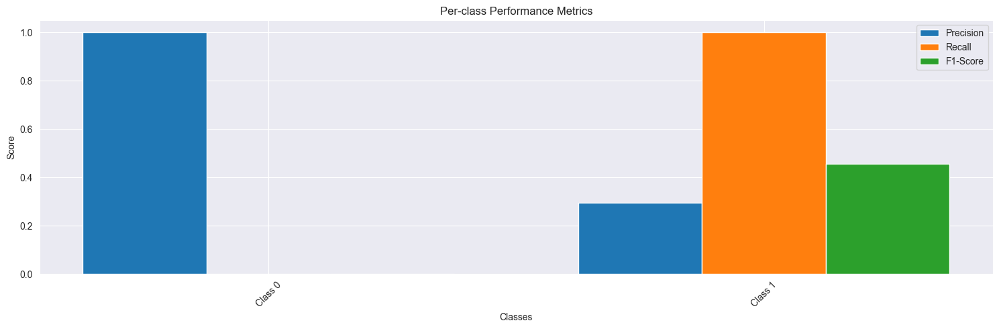


Other metrics:
loss: 0.8254
accuracy: 0.7785
precision: 0.7785
recall: 0.7785
val_loss: 1.6574
val_accuracy: 0.2950
val_precision: 0.2950
val_recall: 0.2950
val_per_class_f1: 0.2282

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 303ms/step - loss: 0.8254 - accuracy: 0.7785 - precision: 0.7785 - recall: 0.7785 - per_class_f1: 0.7661 - val_loss: 1.6574 - val_accuracy: 0.2950 - val_precision: 0.2950 - val_recall: 0.2950 - val_per_class_f1: 0.2282


2024-11-13 14:19:06,581 - INFO - Shuffled data for next epoch


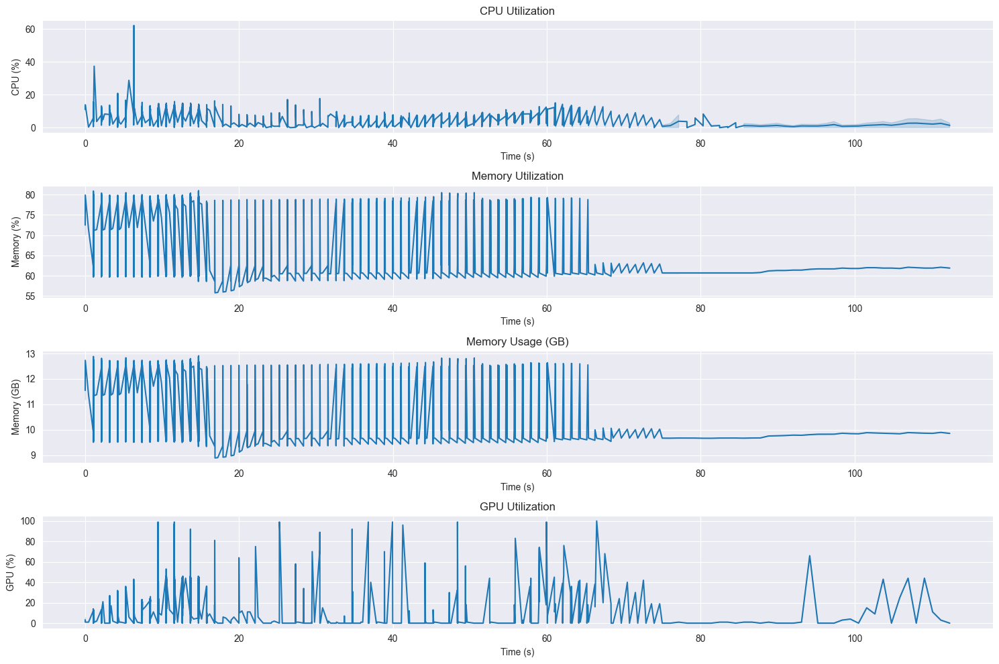

Local epochs:  50%|█████     | 3/6 [01:20<01:20, 26.96s/it]

Training Clients:  80%|████████  | 4/5 [07:15<01:43, 103.72s/it]


Resource Usage Summary:
duration_seconds: 15.81
avg_cpu_percent: 7.57
max_cpu_percent: 62.20
avg_memory_gb: 11.18
max_memory_gb: 12.91
avg_memory_percent: 70.18
max_memory_percent: 81.00
avg_gpu_percent: 16.79
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2363.26
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.8254, Val Loss: 1.6574
Accuracy: 0.7785, Val Accuracy: 0.2950
Early stopping triggered for client 3

==================== Training Client 5 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9777 - accuracy: 0.7325 - precision: 0.7325 - recall: 0.7325 - per_class_f1: 0.7090
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0012    0.0024
Class 1     0.2949  1.0000    0.4554

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6474  0.5006    0.2289


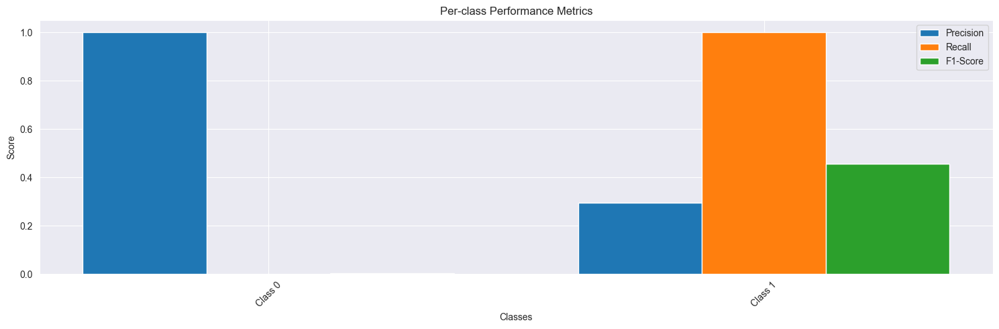


Other metrics:
loss: 0.9777
accuracy: 0.7325
precision: 0.7325
recall: 0.7325
val_loss: 1.2889
val_accuracy: 0.2954
val_precision: 0.2954
val_recall: 0.2954
val_per_class_f1: 0.2289

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 307ms/step - loss: 0.9777 - accuracy: 0.7325 - precision: 0.7325 - recall: 0.7325 - per_class_f1: 0.7090 - val_loss: 1.2889 - val_accuracy: 0.2954 - val_precision: 0.2954 - val_recall: 0.2954 - val_per_class_f1: 0.2289


2024-11-13 14:19:27,477 - INFO - Shuffled data for next epoch


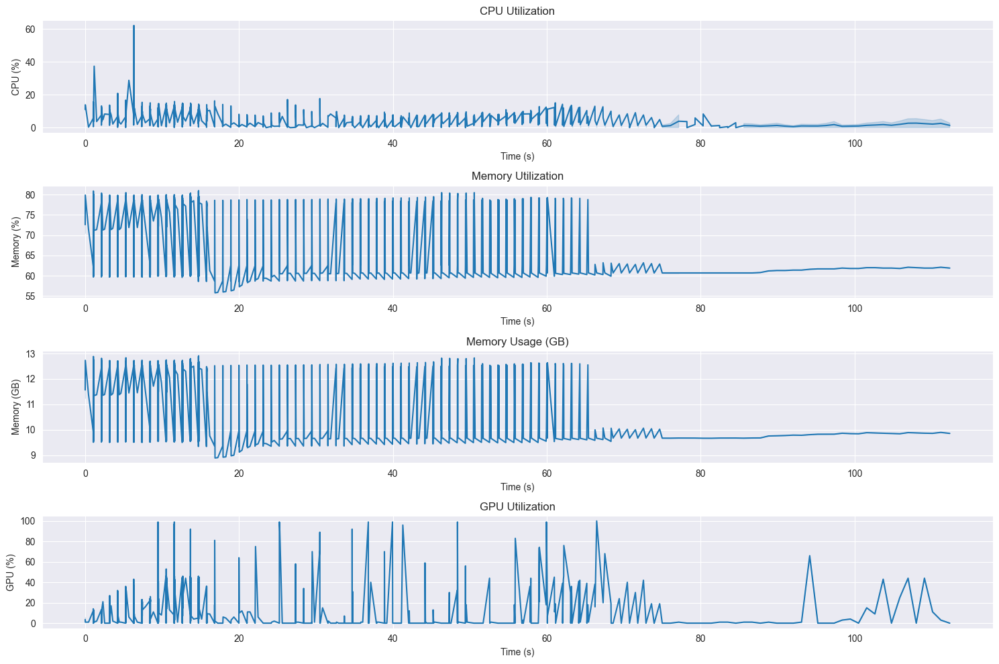



Local epochs:  17%|█▋        | 1/6 [00:20<01:44, 20.93s/it]


Resource Usage Summary:
duration_seconds: 15.84
avg_cpu_percent: 7.63
max_cpu_percent: 62.20
avg_memory_gb: 11.19
max_memory_gb: 12.91
avg_memory_percent: 70.25
max_memory_percent: 81.00
avg_gpu_percent: 16.89
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2363.99
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.9777, Val Loss: 1.2889
Accuracy: 0.7325, Val Accuracy: 0.2954

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.9154 - accuracy: 0.7578 - precision: 0.7578 - recall: 0.7578 - per_class_f1: 0.7435
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0129    0.0256
Class 1     0.2973  1.0000    0.4584

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6487  0.5065    0.2420


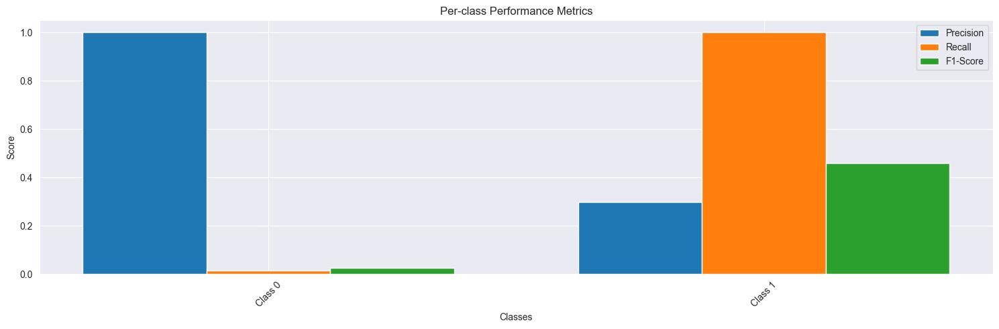


Other metrics:
loss: 0.9154
accuracy: 0.7578
precision: 0.7578
recall: 0.7578
val_loss: 1.3058
val_accuracy: 0.3037
val_precision: 0.3037
val_recall: 0.3037
val_per_class_f1: 0.2420

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 300ms/step - loss: 0.9154 - accuracy: 0.7578 - precision: 0.7578 - recall: 0.7578 - per_class_f1: 0.7435 - val_loss: 1.3058 - val_accuracy: 0.3037 - val_precision: 0.3037 - val_recall: 0.3037 - val_per_class_f1: 0.2420


2024-11-13 14:19:48,135 - INFO - Shuffled data for next epoch


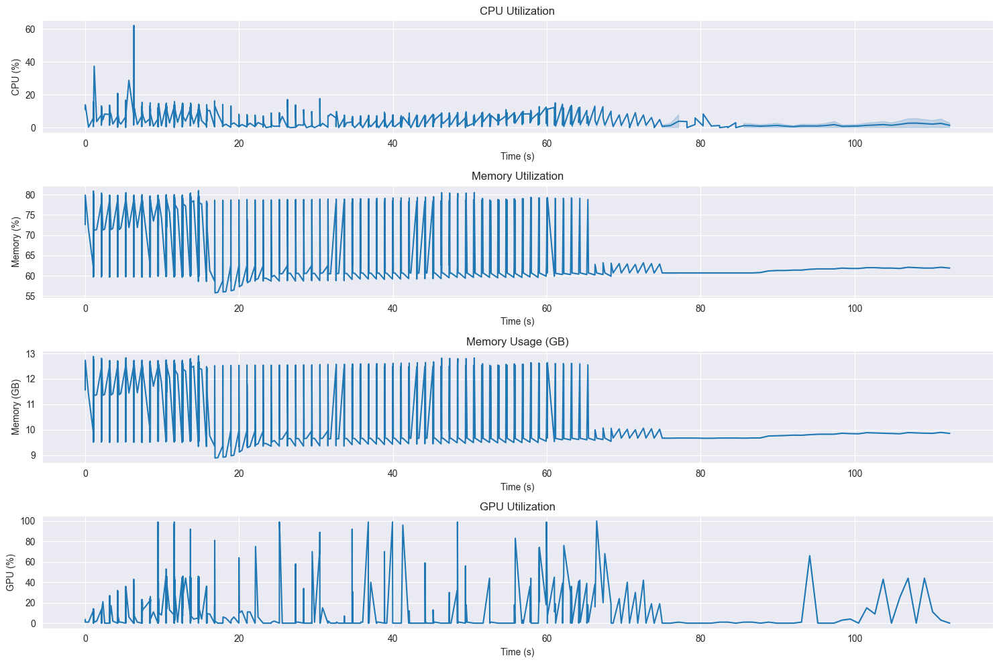



Local epochs:  33%|███▎      | 2/6 [00:40<01:21, 20.32s/it]


Resource Usage Summary:
duration_seconds: 14.79
avg_cpu_percent: 7.67
max_cpu_percent: 62.20
avg_memory_gb: 11.20
max_memory_gb: 12.91
avg_memory_percent: 70.34
max_memory_percent: 81.00
avg_gpu_percent: 16.92
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2364.66
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.9154, Val Loss: 1.3058
Accuracy: 0.7578, Val Accuracy: 0.3037

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8614 - accuracy: 0.7717 - precision: 0.7717 - recall: 0.7717 - per_class_f1: 0.7560
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9661  0.1006    0.1822
Class 1     0.3153  0.9915    0.4784

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6407  0.5461    0.3303


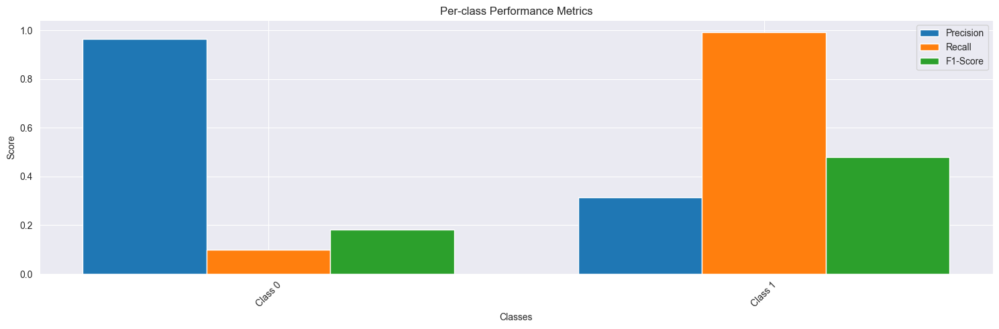


Other metrics:
loss: 0.8614
accuracy: 0.7717
precision: 0.7717
recall: 0.7717
val_loss: 1.2378
val_accuracy: 0.3631
val_precision: 0.3631
val_recall: 0.3631
val_per_class_f1: 0.3303

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 16s 315ms/step - loss: 0.8614 - accuracy: 0.7717 - precision: 0.7717 - recall: 0.7717 - per_class_f1: 0.7560 - val_loss: 1.2378 - val_accuracy: 0.3631 - val_precision: 0.3631 - val_recall: 0.3631 - val_per_class_f1: 0.3303


2024-11-13 14:20:08,785 - INFO - Shuffled data for next epoch


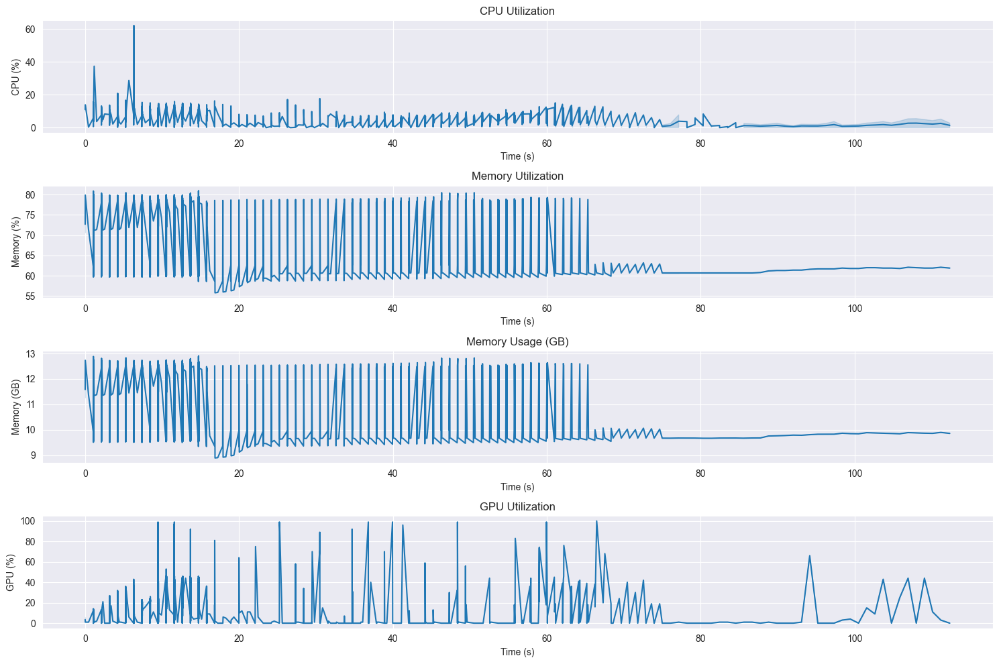



Local epochs:  50%|█████     | 3/6 [01:01<01:01, 20.44s/it]


Resource Usage Summary:
duration_seconds: 15.80
avg_cpu_percent: 7.66
max_cpu_percent: 62.20
avg_memory_gb: 11.22
max_memory_gb: 12.91
avg_memory_percent: 70.44
max_memory_percent: 81.00
avg_gpu_percent: 17.02
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2365.36
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.8614, Val Loss: 1.2378
Accuracy: 0.7717, Val Accuracy: 0.3631

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8318 - accuracy: 0.7789 - precision: 0.7789 - recall: 0.7789 - per_class_f1: 0.7661
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9108  0.1741    0.2923
Class 1     0.3266  0.9592    0.4873

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6187  0.5666    0.3898


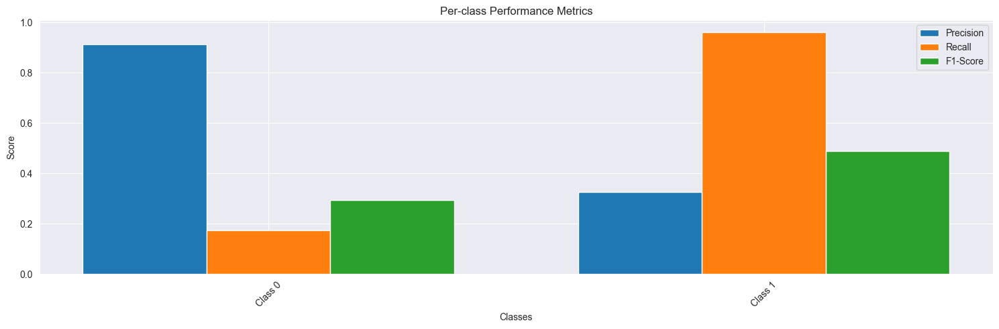


Other metrics:
loss: 0.8318
accuracy: 0.7789
precision: 0.7789
recall: 0.7789
val_loss: 1.1440
val_accuracy: 0.4054
val_precision: 0.4054
val_recall: 0.4054
val_per_class_f1: 0.3898

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 290ms/step - loss: 0.8318 - accuracy: 0.7789 - precision: 0.7789 - recall: 0.7789 - per_class_f1: 0.7661 - val_loss: 1.1440 - val_accuracy: 0.4054 - val_precision: 0.4054 - val_recall: 0.4054 - val_per_class_f1: 0.3898


2024-11-13 14:20:28,075 - INFO - Shuffled data for next epoch


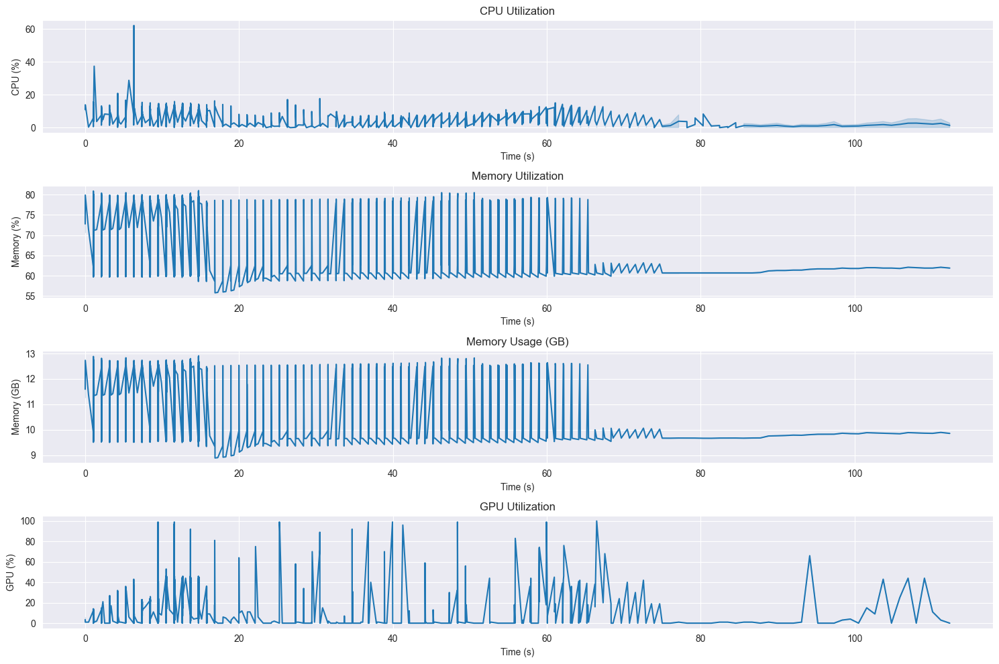



Local epochs:  67%|██████▋   | 4/6 [01:21<00:40, 20.14s/it]


Resource Usage Summary:
duration_seconds: 14.72
avg_cpu_percent: 7.64
max_cpu_percent: 62.20
avg_memory_gb: 11.23
max_memory_gb: 12.91
avg_memory_percent: 70.53
max_memory_percent: 81.00
avg_gpu_percent: 17.10
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2365.99
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.8318, Val Loss: 1.1440
Accuracy: 0.7789, Val Accuracy: 0.4054

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.8025 - accuracy: 0.7717 - precision: 0.7717 - recall: 0.7717 - per_class_f1: 0.7565
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9513  0.1265    0.2233
Class 1     0.3201  0.9845    0.4831

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6357  0.5555    0.3532


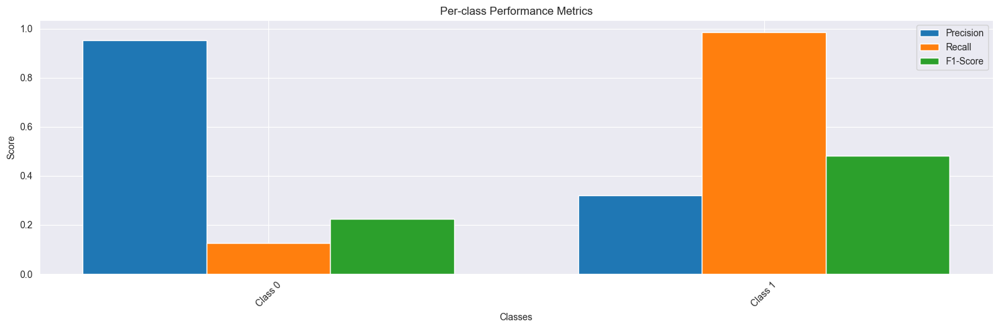


Other metrics:
loss: 0.8025
accuracy: 0.7717
precision: 0.7717
recall: 0.7717
val_loss: 1.1275
val_accuracy: 0.3793
val_precision: 0.3793
val_recall: 0.3793
val_per_class_f1: 0.3532

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 290ms/step - loss: 0.8025 - accuracy: 0.7717 - precision: 0.7717 - recall: 0.7717 - per_class_f1: 0.7565 - val_loss: 1.1275 - val_accuracy: 0.3793 - val_precision: 0.3793 - val_recall: 0.3793 - val_per_class_f1: 0.3532


2024-11-13 14:20:47,694 - INFO - Shuffled data for next epoch


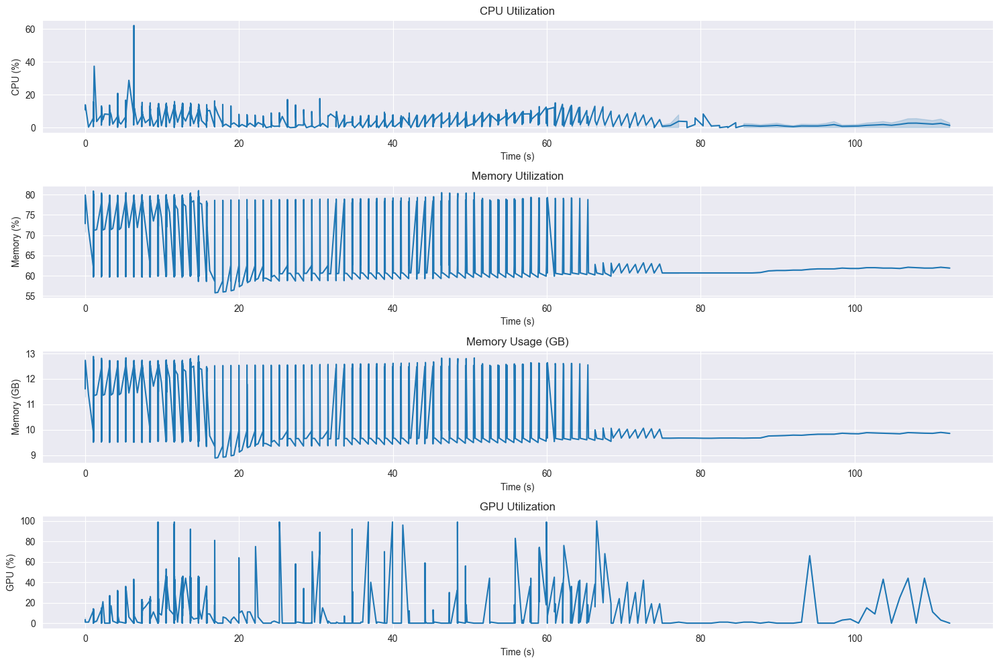



Local epochs:  83%|████████▎ | 5/6 [01:40<00:19, 19.99s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.62
max_cpu_percent: 62.20
avg_memory_gb: 11.25
max_memory_gb: 12.91
avg_memory_percent: 70.62
max_memory_percent: 81.00
avg_gpu_percent: 17.18
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2366.61
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.8025, Val Loss: 1.1275
Accuracy: 0.7717, Val Accuracy: 0.3793

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7481 - accuracy: 0.7970 - precision: 0.7970 - recall: 0.7970 - per_class_f1: 0.7862
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7842  0.7800    0.7821
Class 1     0.4798  0.4859    0.4829

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6320  0.6330    0.6325


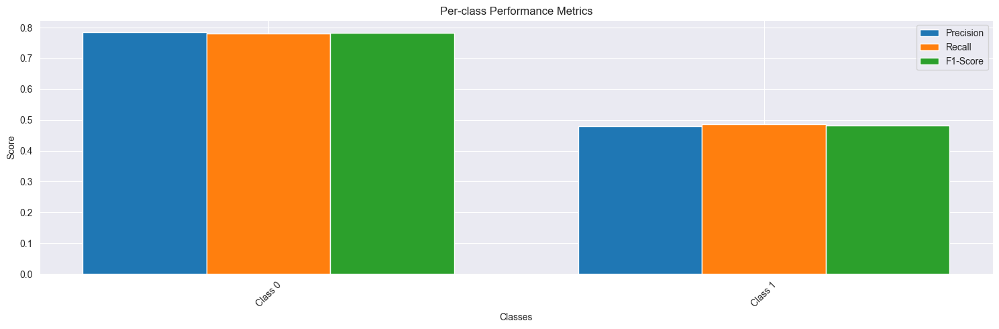


Other metrics:
loss: 0.7481
accuracy: 0.7970
precision: 0.7970
recall: 0.7970
val_loss: 0.8504
val_accuracy: 0.6934
val_precision: 0.6934
val_recall: 0.6934
val_per_class_f1: 0.6325

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 289ms/step - loss: 0.7481 - accuracy: 0.7970 - precision: 0.7970 - recall: 0.7970 - per_class_f1: 0.7862 - val_loss: 0.8504 - val_accuracy: 0.6934 - val_precision: 0.6934 - val_recall: 0.6934 - val_per_class_f1: 0.6325


2024-11-13 14:21:07,345 - INFO - Shuffled data for next epoch


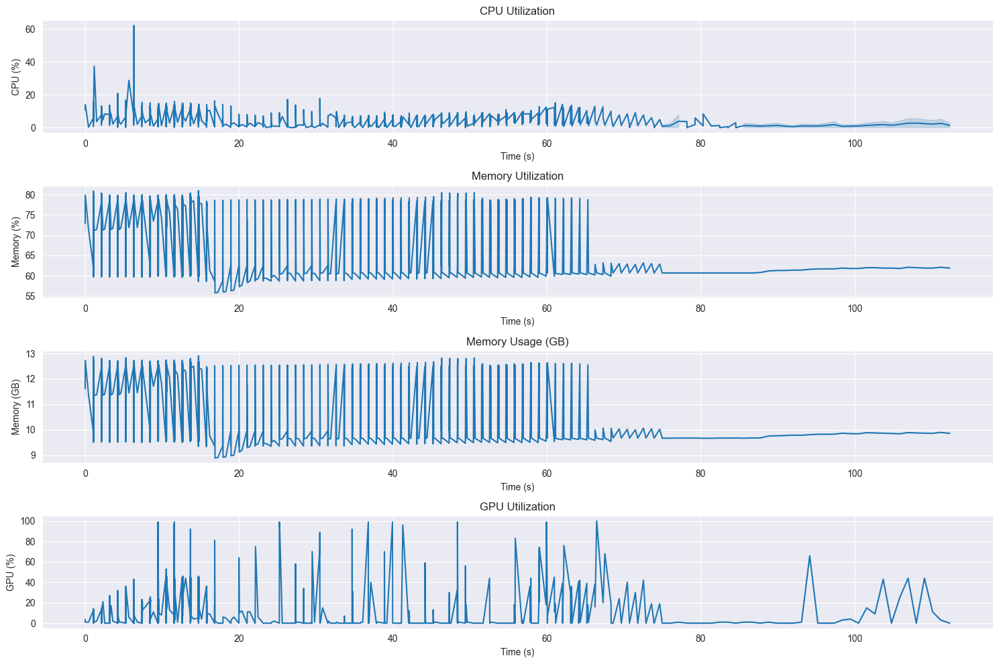



Local epochs: 100%|██████████| 6/6 [02:00<00:00, 20.05s/it]

Training Clients: 100%|██████████| 5/5 [09:16<00:00, 111.22s/it]


Resource Usage Summary:
duration_seconds: 14.72
avg_cpu_percent: 7.59
max_cpu_percent: 62.20
avg_memory_gb: 11.26
max_memory_gb: 12.91
avg_memory_percent: 70.70
max_memory_percent: 81.00
avg_gpu_percent: 17.22
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2367.21
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.7481, Val Loss: 0.8504
Accuracy: 0.7970, Val Accuracy: 0.6934



Federated Learning Rounds:  40%|████      | 2/5 [22:48<33:09, 663.33s/it]


Test metrics:
loss: 0.9401
accuracy: 0.6680
precision: 0.6680
recall: 0.6680
f1_metric: 0.5328

Round Summary:
val_loss: 1.0703
loss: 0.7735

Per-class F1 scores:
Class 0: 0.8243
Class 1: 0.7164
accuracy: 0.7831
precision: 0.7831
recall: 0.7831
val_accuracy: 0.5666
val_precision: 0.5666
val_recall: 0.5666
val_per_class_f1: 0.5049

Federated Learning Round 3/5



Training Clients:   0%|          | 0/5 [00:00<?, ?it/s]


==================== Training Client 1 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7504 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7699
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     1.0000  0.0006    0.0012
Class 1     0.2947  1.0000    0.4553

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6474  0.5003    0.2282


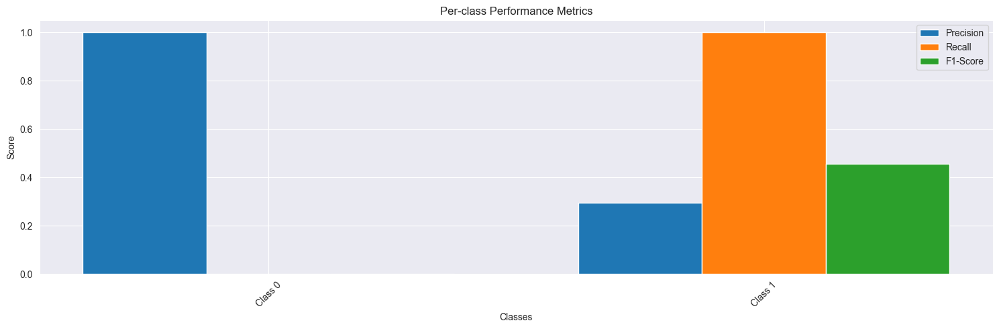


Other metrics:
loss: 0.7504
accuracy: 0.7839
precision: 0.7839
recall: 0.7839
val_loss: 1.2494
val_accuracy: 0.2950
val_precision: 0.2950
val_recall: 0.2950
val_per_class_f1: 0.2282

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 288ms/step - loss: 0.7504 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7699 - val_loss: 1.2494 - val_accuracy: 0.2950 - val_precision: 0.2950 - val_recall: 0.2950 - val_per_class_f1: 0.2282


2024-11-13 14:21:36,009 - INFO - Shuffled data for next epoch


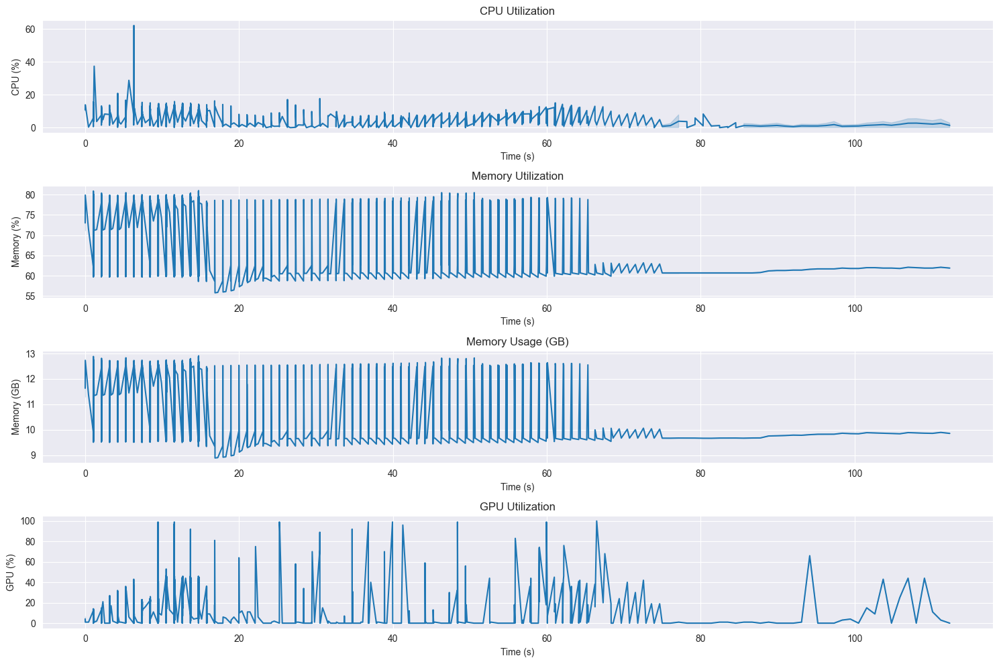



Local epochs:  17%|█▋        | 1/6 [00:19<01:38, 19.75s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.57
max_cpu_percent: 62.20
avg_memory_gb: 11.27
max_memory_gb: 12.91
avg_memory_percent: 70.78
max_memory_percent: 81.00
avg_gpu_percent: 17.31
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2367.80
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.7504, Val Loss: 1.2494
Accuracy: 0.7839, Val Accuracy: 0.2950

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7238 - accuracy: 0.7731 - precision: 0.7731 - recall: 0.7731 - per_class_f1: 0.7593
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7360  0.7118    0.7237
Class 1     0.3603  0.3887    0.3740

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5482  0.5502    0.5488


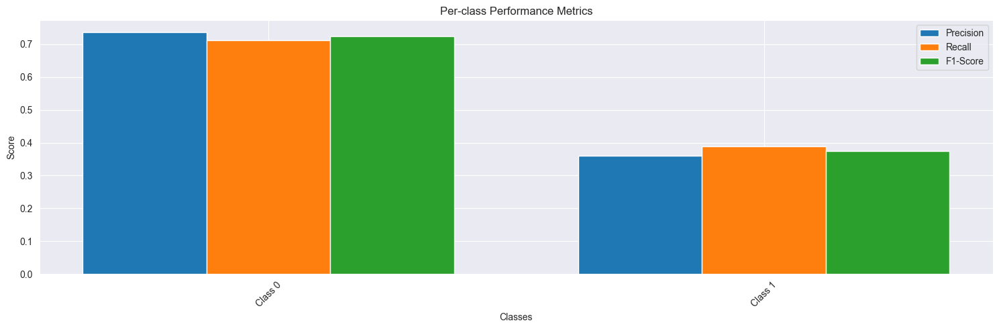


Other metrics:
loss: 0.7238
accuracy: 0.7731
precision: 0.7731
recall: 0.7731
val_loss: 0.9013
val_accuracy: 0.6166
val_precision: 0.6166
val_recall: 0.6166
val_per_class_f1: 0.5488

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 289ms/step - loss: 0.7238 - accuracy: 0.7731 - precision: 0.7731 - recall: 0.7731 - per_class_f1: 0.7593 - val_loss: 0.9013 - val_accuracy: 0.6166 - val_precision: 0.6166 - val_recall: 0.6166 - val_per_class_f1: 0.5488


2024-11-13 14:21:55,827 - INFO - Shuffled data for next epoch


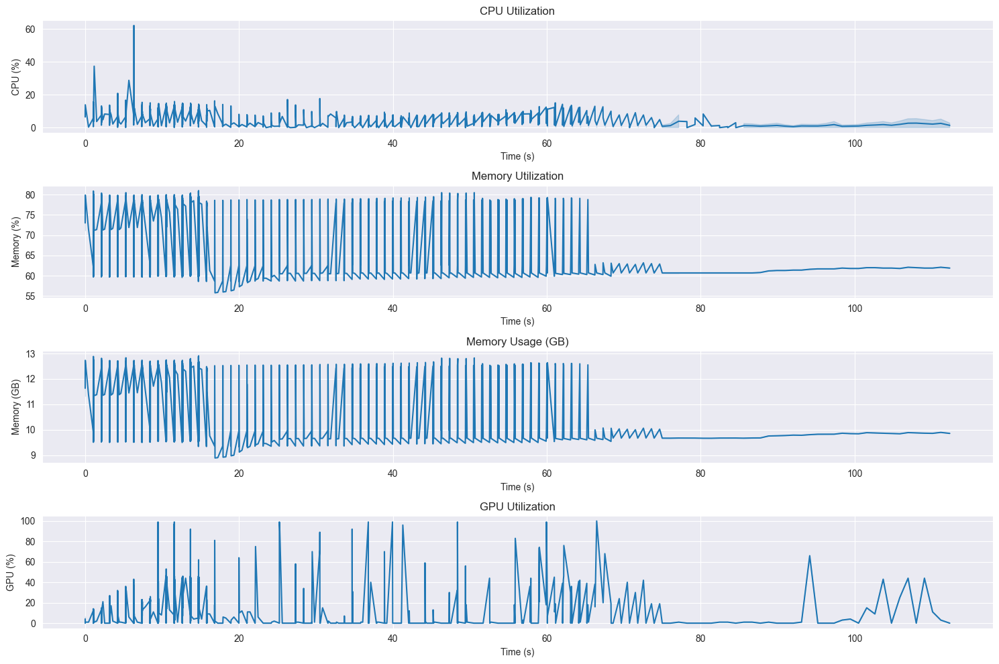



Local epochs:  33%|███▎      | 2/6 [00:39<01:18, 19.64s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.55
max_cpu_percent: 62.20
avg_memory_gb: 11.29
max_memory_gb: 12.91
avg_memory_percent: 70.86
max_memory_percent: 81.00
avg_gpu_percent: 17.34
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2368.37
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.7238, Val Loss: 0.9013
Accuracy: 0.7731, Val Accuracy: 0.6166

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6938 - accuracy: 0.7882 - precision: 0.7882 - recall: 0.7882 - per_class_f1: 0.7742
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8043  0.4229    0.5544
Class 1     0.3529  0.7535    0.4807

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5786  0.5882    0.5175


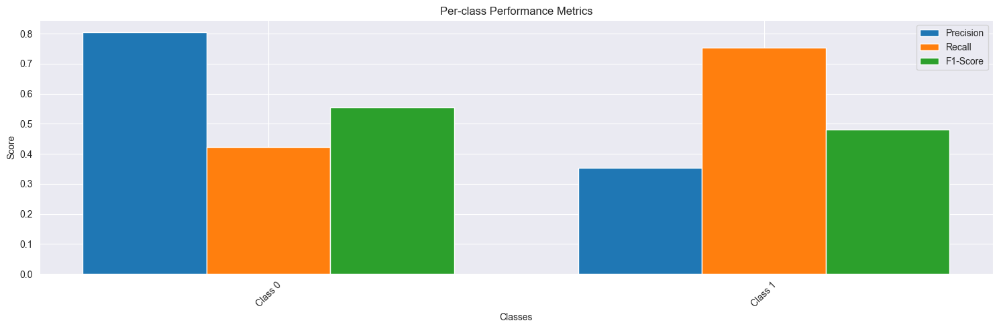


Other metrics:
loss: 0.6938
accuracy: 0.7882
precision: 0.7882
recall: 0.7882
val_loss: 0.9287
val_accuracy: 0.5203
val_precision: 0.5203
val_recall: 0.5203
val_per_class_f1: 0.5175

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 295ms/step - loss: 0.6938 - accuracy: 0.7882 - precision: 0.7882 - recall: 0.7882 - per_class_f1: 0.7742 - val_loss: 0.9287 - val_accuracy: 0.5203 - val_precision: 0.5203 - val_recall: 0.5203 - val_per_class_f1: 0.5175


2024-11-13 14:22:15,622 - INFO - Shuffled data for next epoch


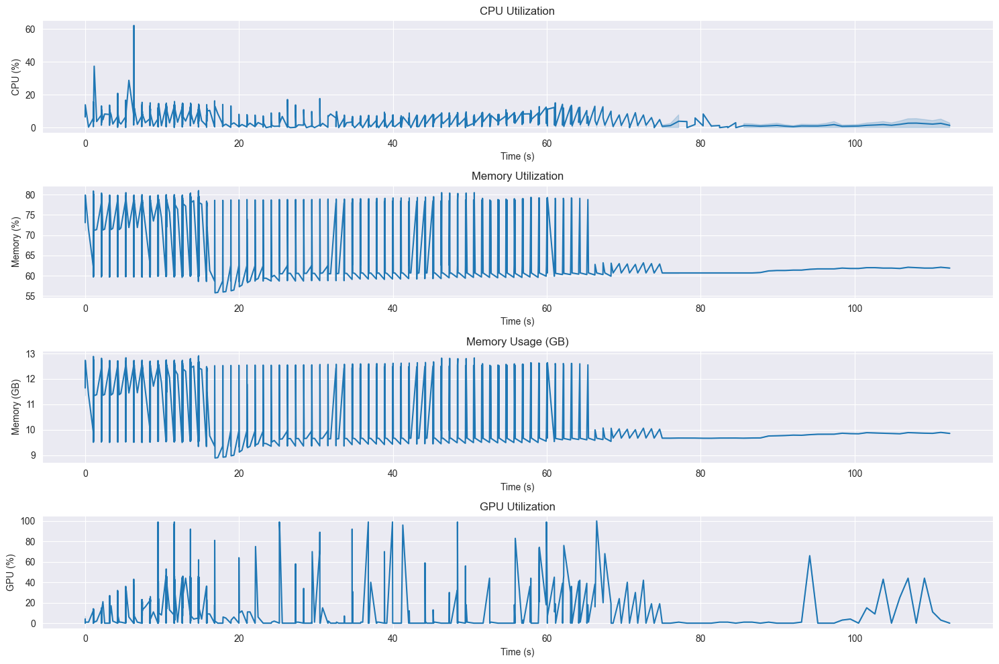



Local epochs:  50%|█████     | 3/6 [00:58<00:58, 19.58s/it]


Resource Usage Summary:
duration_seconds: 14.71
avg_cpu_percent: 7.54
max_cpu_percent: 62.20
avg_memory_gb: 11.30
max_memory_gb: 12.91
avg_memory_percent: 70.94
max_memory_percent: 81.00
avg_gpu_percent: 17.35
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2368.93
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6938, Val Loss: 0.9287
Accuracy: 0.7882, Val Accuracy: 0.5203

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6636 - accuracy: 0.7924 - precision: 0.7924 - recall: 0.7924 - per_class_f1: 0.7802
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8177  0.5965    0.6898
Class 1     0.4137  0.6817    0.5149

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6157  0.6391    0.6023


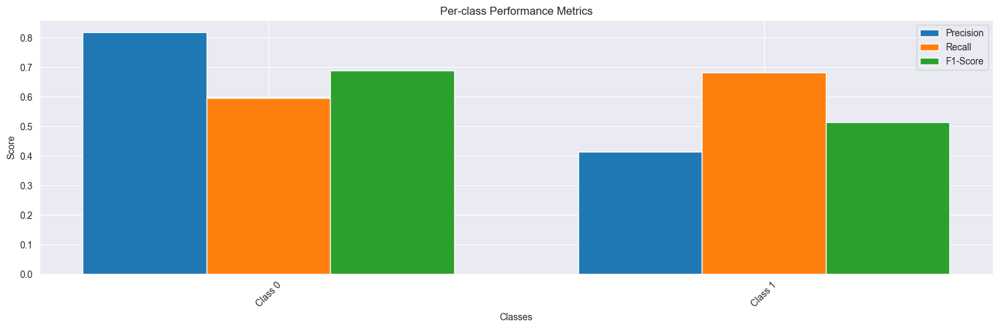


Other metrics:
loss: 0.6636
accuracy: 0.7924
precision: 0.7924
recall: 0.7924
val_loss: 0.8465
val_accuracy: 0.6216
val_precision: 0.6216
val_recall: 0.6216
val_per_class_f1: 0.6023

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 289ms/step - loss: 0.6636 - accuracy: 0.7924 - precision: 0.7924 - recall: 0.7924 - per_class_f1: 0.7802 - val_loss: 0.8465 - val_accuracy: 0.6216 - val_precision: 0.6216 - val_recall: 0.6216 - val_per_class_f1: 0.6023


2024-11-13 14:22:34,905 - INFO - Shuffled data for next epoch


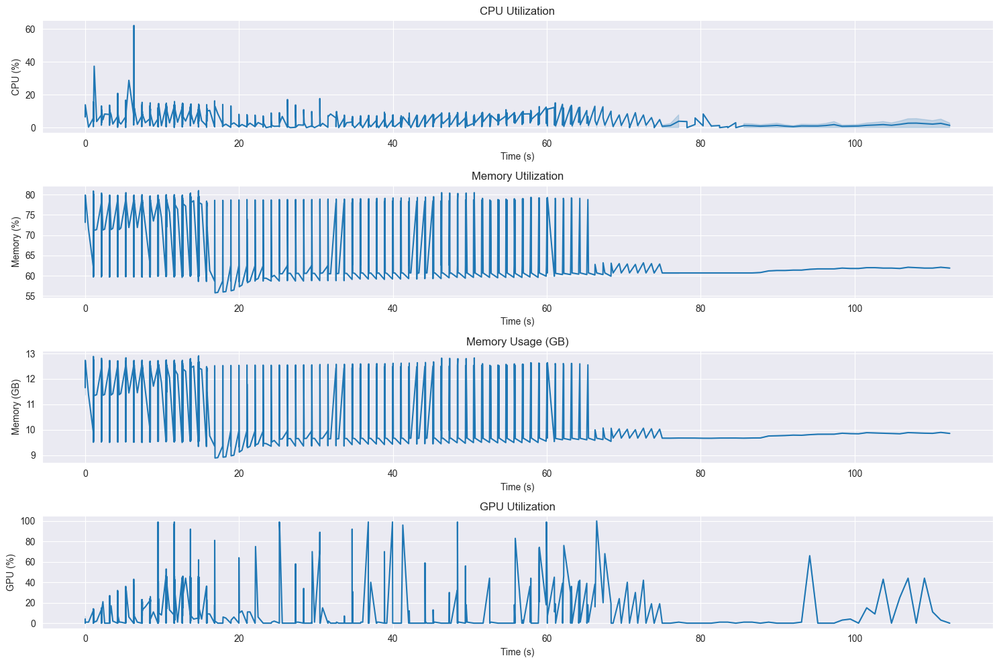



Local epochs:  67%|██████▋   | 4/6 [01:18<00:39, 19.68s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.51
max_cpu_percent: 62.20
avg_memory_gb: 11.31
max_memory_gb: 12.91
avg_memory_percent: 71.01
max_memory_percent: 81.00
avg_gpu_percent: 17.38
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2369.47
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.6636, Val Loss: 0.8465
Accuracy: 0.7924, Val Accuracy: 0.6216

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6511 - accuracy: 0.7942 - precision: 0.7942 - recall: 0.7942 - per_class_f1: 0.7805
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7952  0.5118    0.6228
Class 1     0.3693  0.6845    0.4798

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5823  0.5981    0.5513


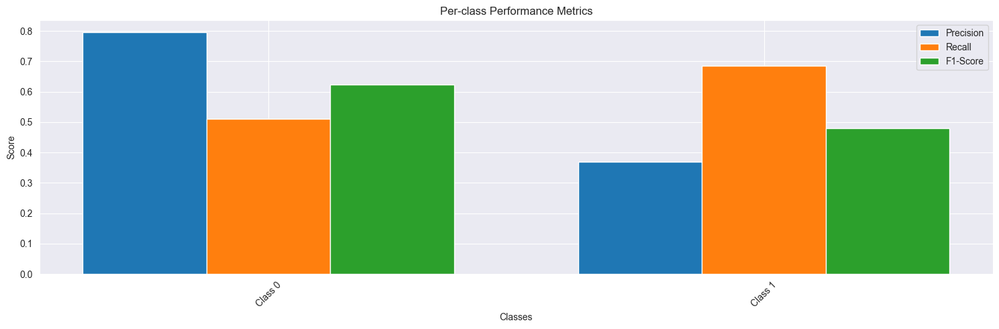


Other metrics:
loss: 0.6511
accuracy: 0.7942
precision: 0.7942
recall: 0.7942
val_loss: 0.8403
val_accuracy: 0.5627
val_precision: 0.5627
val_recall: 0.5627
val_per_class_f1: 0.5513

Epoch 1: val_accuracy did not improve from 0.70539
52/52 [==============================] - 15s 290ms/step - loss: 0.6511 - accuracy: 0.7942 - precision: 0.7942 - recall: 0.7942 - per_class_f1: 0.7805 - val_loss: 0.8403 - val_accuracy: 0.5627 - val_precision: 0.5627 - val_recall: 0.5627 - val_per_class_f1: 0.5513


2024-11-13 14:22:54,805 - INFO - Shuffled data for next epoch


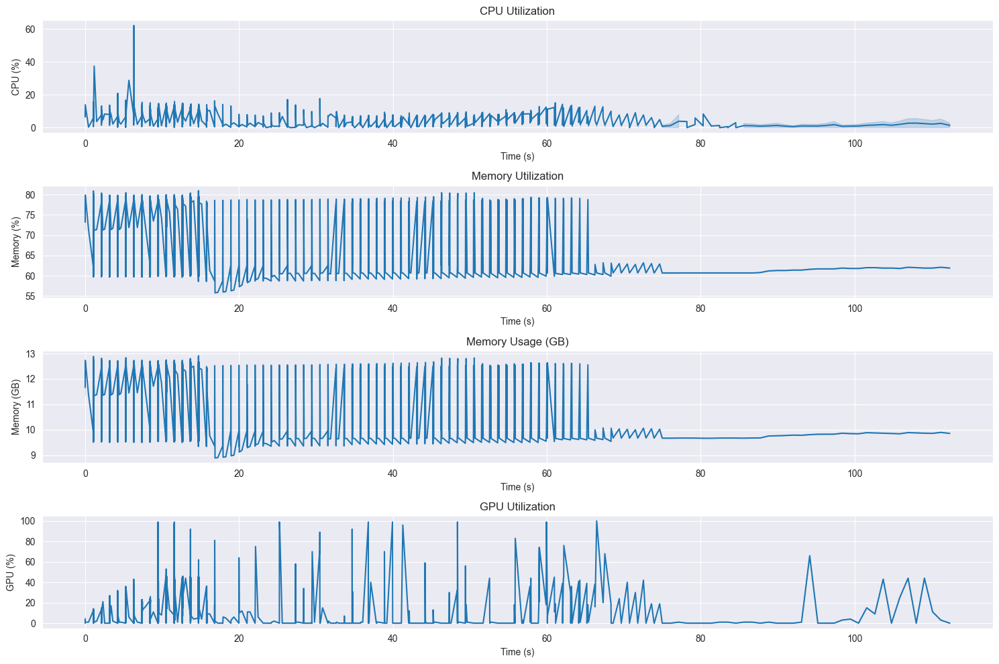



Local epochs:  83%|████████▎ | 5/6 [01:38<00:19, 19.69s/it]


Resource Usage Summary:
duration_seconds: 14.81
avg_cpu_percent: 7.49
max_cpu_percent: 62.20
avg_memory_gb: 11.32
max_memory_gb: 12.91
avg_memory_percent: 71.09
max_memory_percent: 81.00
avg_gpu_percent: 17.40
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2370.01
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.6511, Val Loss: 0.8403
Accuracy: 0.7942, Val Accuracy: 0.5627

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6264 - accuracy: 0.7948 - precision: 0.7948 - recall: 0.7948 - per_class_f1: 0.7827
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7749  0.8241    0.7987
Class 1     0.5033  0.4268    0.4619

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6391  0.6254    0.6303


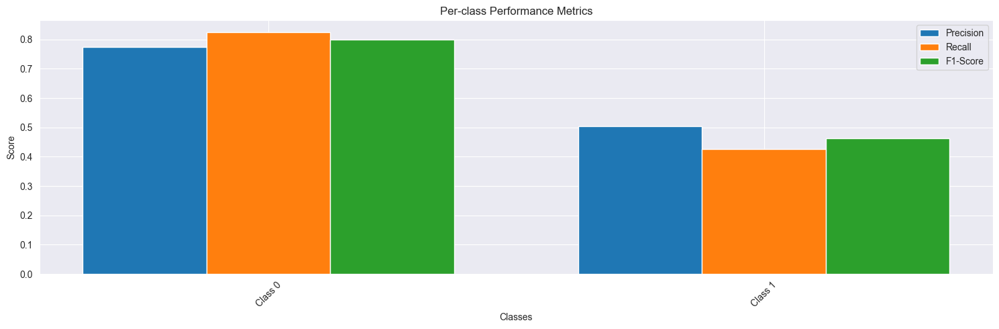


Other metrics:
loss: 0.6264
accuracy: 0.7948
precision: 0.7948
recall: 0.7948
val_loss: 0.7442
val_accuracy: 0.7071
val_precision: 0.7071
val_recall: 0.7071
val_per_class_f1: 0.6303

Epoch 1: val_accuracy improved from 0.70539 to 0.70705, saving model to best_model.h5
52/52 [==============================] - 15s 293ms/step - loss: 0.6264 - accuracy: 0.7948 - precision: 0.7948 - recall: 0.7948 - per_class_f1: 0.7827 - val_loss: 0.7442 - val_accuracy: 0.7071 - val_precision: 0.7071 - val_recall: 0.7071 - val_per_class_f1: 0.6303


2024-11-13 14:23:14,665 - INFO - Shuffled data for next epoch


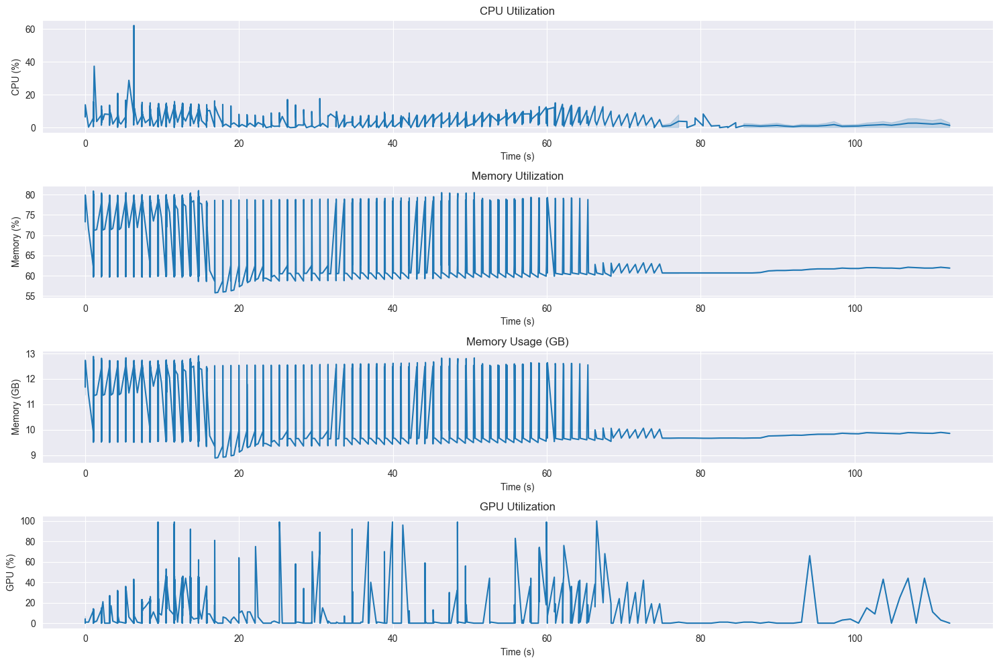



Local epochs: 100%|██████████| 6/6 [01:58<00:00, 19.67s/it]

Training Clients:  20%|██        | 1/5 [01:58<07:52, 118.03s/it]


Resource Usage Summary:
duration_seconds: 14.79
avg_cpu_percent: 7.47
max_cpu_percent: 62.20
avg_memory_gb: 11.33
max_memory_gb: 12.91
avg_memory_percent: 71.16
max_memory_percent: 81.00
avg_gpu_percent: 17.49
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2370.53
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.6264, Val Loss: 0.7442
Accuracy: 0.7948, Val Accuracy: 0.7071

==================== Training Client 2 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7701 - accuracy: 0.7894 - precision: 0.7894 - recall: 0.7894 - per_class_f1: 0.7770
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7059  0.9641    0.8150
Class 1     0.3068  0.0380    0.0677

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5063  0.5011    0.4413


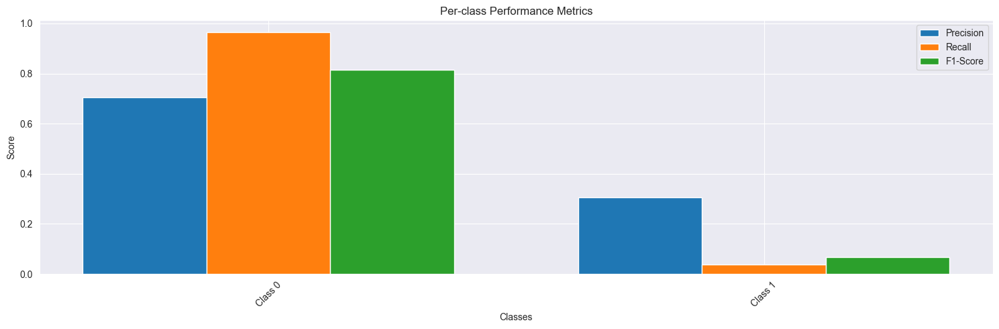


Other metrics:
loss: 0.7701
accuracy: 0.7894
precision: 0.7894
recall: 0.7894
val_loss: 0.8607
val_accuracy: 0.6913
val_precision: 0.6913
val_recall: 0.6913
val_per_class_f1: 0.4413

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.7701 - accuracy: 0.7894 - precision: 0.7894 - recall: 0.7894 - per_class_f1: 0.7770 - val_loss: 0.8607 - val_accuracy: 0.6913 - val_precision: 0.6913 - val_recall: 0.6913 - val_per_class_f1: 0.4413


2024-11-13 14:23:34,207 - INFO - Shuffled data for next epoch


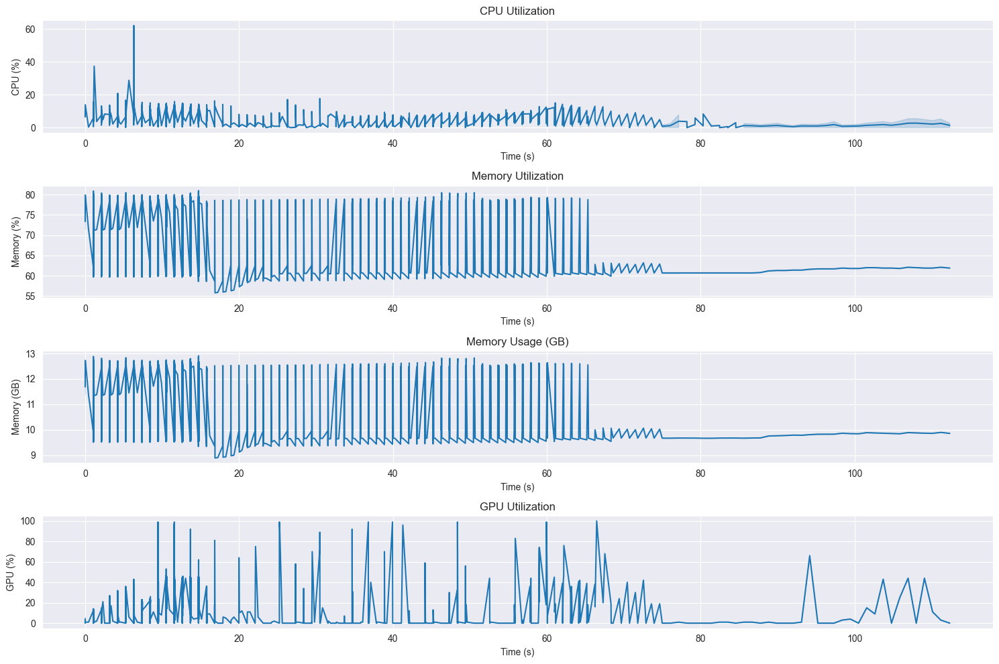



Local epochs:  17%|█▋        | 1/6 [00:19<01:39, 19.87s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.45
max_cpu_percent: 62.20
avg_memory_gb: 11.35
max_memory_gb: 12.91
avg_memory_percent: 71.23
max_memory_percent: 81.00
avg_gpu_percent: 17.48
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2371.04
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.7701, Val Loss: 0.8607
Accuracy: 0.7894, Val Accuracy: 0.6913

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7510 - accuracy: 0.7767 - precision: 0.7767 - recall: 0.7767 - per_class_f1: 0.7652
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8856  0.5418    0.6723
Class 1     0.4314  0.8324    0.5683

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6585  0.6871    0.6203


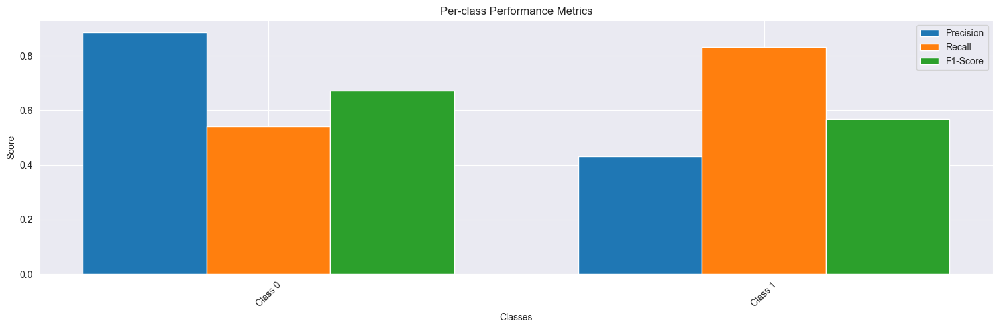


Other metrics:
loss: 0.7510
accuracy: 0.7767
precision: 0.7767
recall: 0.7767
val_loss: 0.9056
val_accuracy: 0.6274
val_precision: 0.6274
val_recall: 0.6274
val_per_class_f1: 0.6203

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 289ms/step - loss: 0.7510 - accuracy: 0.7767 - precision: 0.7767 - recall: 0.7767 - per_class_f1: 0.7652 - val_loss: 0.9056 - val_accuracy: 0.6274 - val_precision: 0.6274 - val_recall: 0.6274 - val_per_class_f1: 0.6203


2024-11-13 14:23:54,012 - INFO - Shuffled data for next epoch


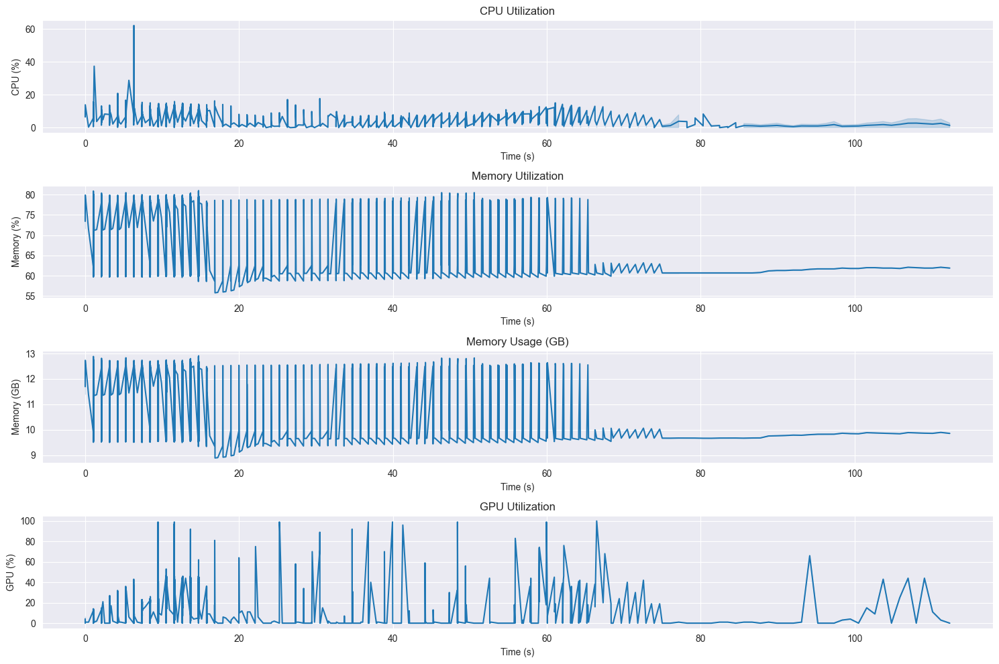



Local epochs:  33%|███▎      | 2/6 [00:39<01:19, 19.85s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.43
max_cpu_percent: 62.20
avg_memory_gb: 11.36
max_memory_gb: 12.91
avg_memory_percent: 71.29
max_memory_percent: 81.00
avg_gpu_percent: 17.56
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2371.53
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.7510, Val Loss: 0.9056
Accuracy: 0.7767, Val Accuracy: 0.6274

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6995 - accuracy: 0.7996 - precision: 0.7996 - recall: 0.7996 - per_class_f1: 0.7893
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8756  0.4306    0.5773
Class 1     0.3850  0.8535    0.5306

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6303  0.6421    0.5540


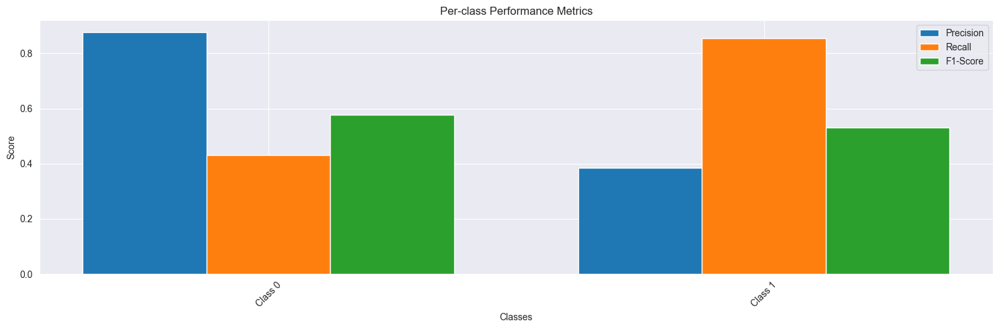


Other metrics:
loss: 0.6995
accuracy: 0.7996
precision: 0.7996
recall: 0.7996
val_loss: 0.8953
val_accuracy: 0.5552
val_precision: 0.5552
val_recall: 0.5552
val_per_class_f1: 0.5540

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 288ms/step - loss: 0.6995 - accuracy: 0.7996 - precision: 0.7996 - recall: 0.7996 - per_class_f1: 0.7893 - val_loss: 0.8953 - val_accuracy: 0.5552 - val_precision: 0.5552 - val_recall: 0.5552 - val_per_class_f1: 0.5540


2024-11-13 14:24:13,825 - INFO - Shuffled data for next epoch


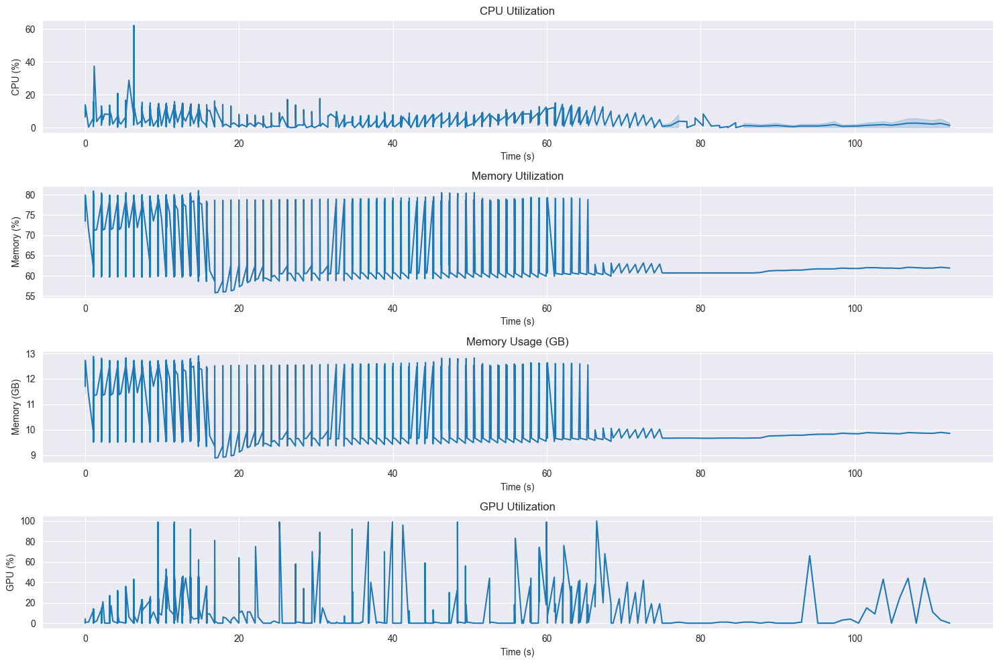



Local epochs:  50%|█████     | 3/6 [00:59<00:59, 19.76s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 7.41
max_cpu_percent: 62.20
avg_memory_gb: 11.37
max_memory_gb: 12.91
avg_memory_percent: 71.36
max_memory_percent: 81.00
avg_gpu_percent: 17.60
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2372.02
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6995, Val Loss: 0.8953
Accuracy: 0.7996, Val Accuracy: 0.5552

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6799 - accuracy: 0.7870 - precision: 0.7870 - recall: 0.7870 - per_class_f1: 0.7728
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9619  0.2076    0.3416
Class 1     0.3407  0.9803    0.5056

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6513  0.5940    0.4236


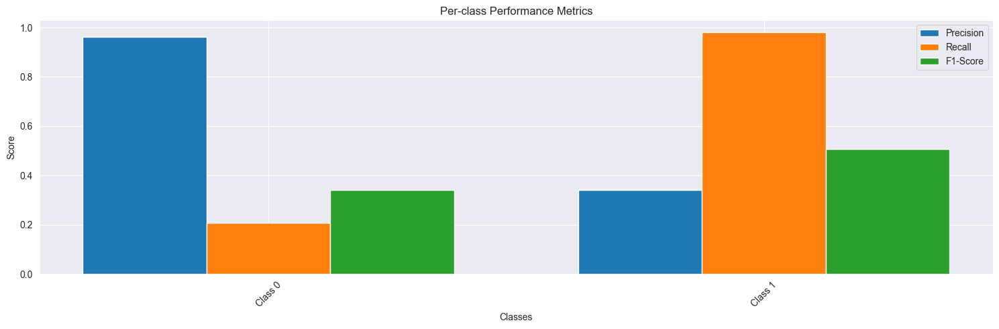


Other metrics:
loss: 0.6799
accuracy: 0.7870
precision: 0.7870
recall: 0.7870
val_loss: 1.1725
val_accuracy: 0.4353
val_precision: 0.4353
val_recall: 0.4353
val_per_class_f1: 0.4236

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6799 - accuracy: 0.7870 - precision: 0.7870 - recall: 0.7870 - per_class_f1: 0.7728 - val_loss: 1.1725 - val_accuracy: 0.4353 - val_precision: 0.4353 - val_recall: 0.4353 - val_per_class_f1: 0.4236


2024-11-13 14:24:33,507 - INFO - Shuffled data for next epoch


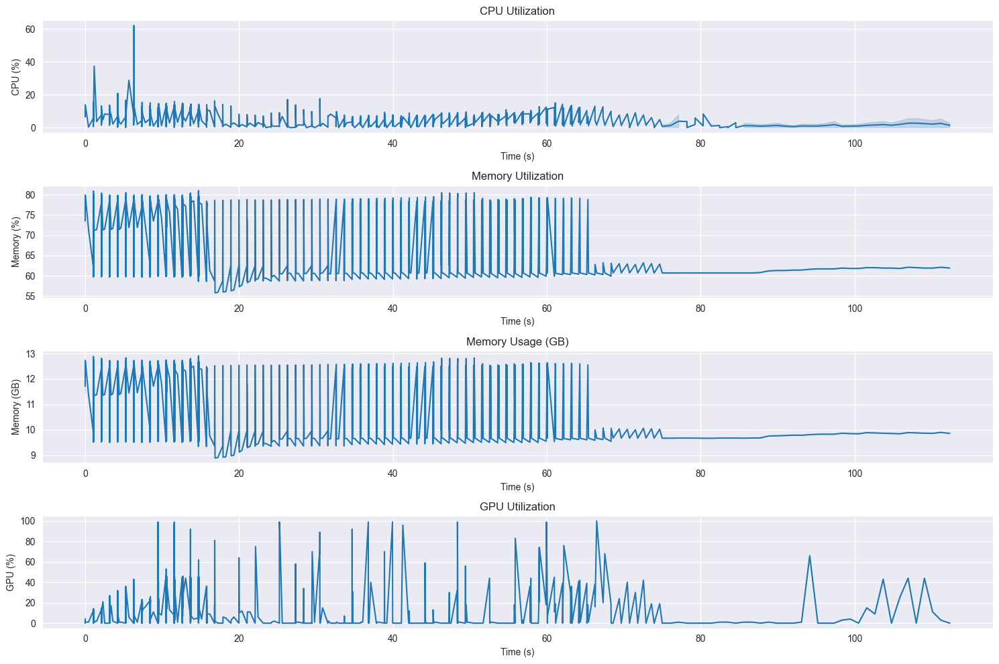

Local epochs:  50%|█████     | 3/6 [01:19<01:19, 26.41s/it]

Training Clients:  40%|████      | 2/5 [03:17<04:45, 95.23s/it] 


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.39
max_cpu_percent: 62.20
avg_memory_gb: 11.38
max_memory_gb: 12.91
avg_memory_percent: 71.42
max_memory_percent: 81.00
avg_gpu_percent: 17.62
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2372.49
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.6799, Val Loss: 1.1725
Accuracy: 0.7870, Val Accuracy: 0.4353
Early stopping triggered for client 1

==================== Training Client 3 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7587 - accuracy: 0.7827 - precision: 0.7827 - recall: 0.7827 - per_class_f1: 0.7717
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7916  0.6659    0.7233
Class 1     0.4204  0.5803    0.4876

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6060  0.6231    0.6054


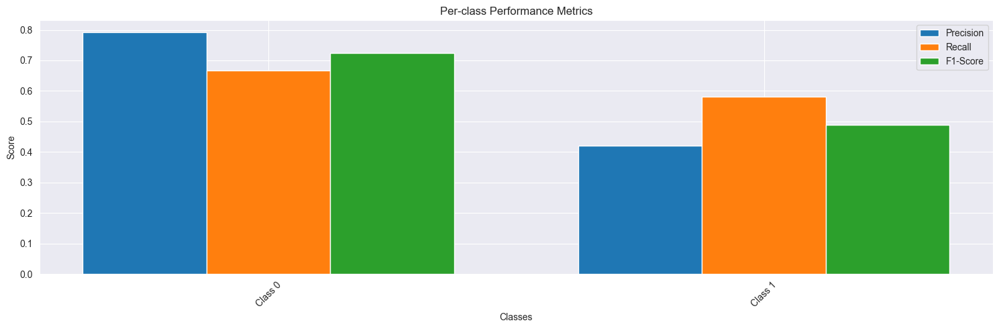


Other metrics:
loss: 0.7587
accuracy: 0.7827
precision: 0.7827
recall: 0.7827
val_loss: 0.9141
val_accuracy: 0.6407
val_precision: 0.6407
val_recall: 0.6407
val_per_class_f1: 0.6054

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 289ms/step - loss: 0.7587 - accuracy: 0.7827 - precision: 0.7827 - recall: 0.7827 - per_class_f1: 0.7717 - val_loss: 0.9141 - val_accuracy: 0.6407 - val_precision: 0.6407 - val_recall: 0.6407 - val_per_class_f1: 0.6054


2024-11-13 14:24:53,470 - INFO - Shuffled data for next epoch


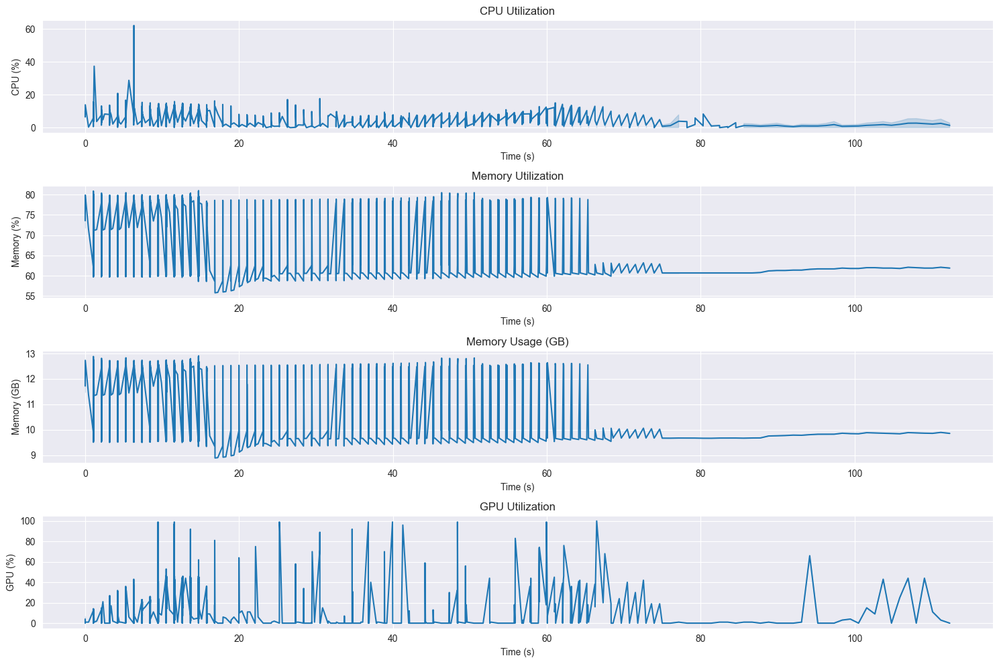



Local epochs:  17%|█▋        | 1/6 [00:19<01:38, 19.68s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.38
max_cpu_percent: 62.20
avg_memory_gb: 11.39
max_memory_gb: 12.91
avg_memory_percent: 71.48
max_memory_percent: 81.00
avg_gpu_percent: 17.67
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2372.96
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.7587, Val Loss: 0.9141
Accuracy: 0.7827, Val Accuracy: 0.6407

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7476 - accuracy: 0.7833 - precision: 0.7833 - recall: 0.7833 - per_class_f1: 0.7712
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7057  0.9971    0.8264
Class 1     0.3750  0.0042    0.0084

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5403  0.5006    0.4174


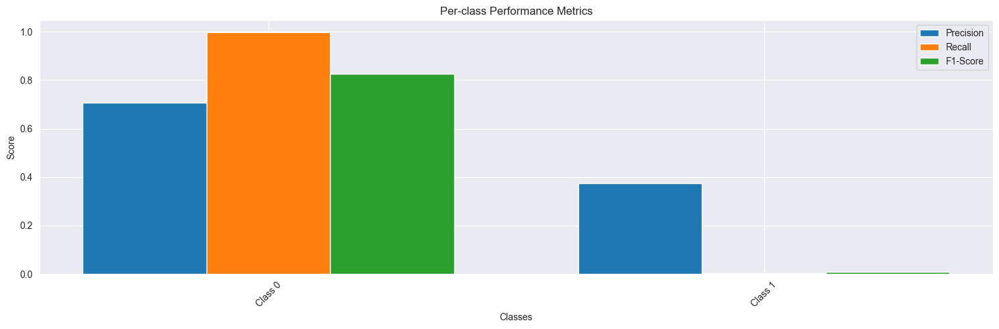


Other metrics:
loss: 0.7476
accuracy: 0.7833
precision: 0.7833
recall: 0.7833
val_loss: 0.8172
val_accuracy: 0.7046
val_precision: 0.7046
val_recall: 0.7046
val_per_class_f1: 0.4174

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 289ms/step - loss: 0.7476 - accuracy: 0.7833 - precision: 0.7833 - recall: 0.7833 - per_class_f1: 0.7712 - val_loss: 0.8172 - val_accuracy: 0.7046 - val_precision: 0.7046 - val_recall: 0.7046 - val_per_class_f1: 0.4174


2024-11-13 14:25:13,135 - INFO - Shuffled data for next epoch


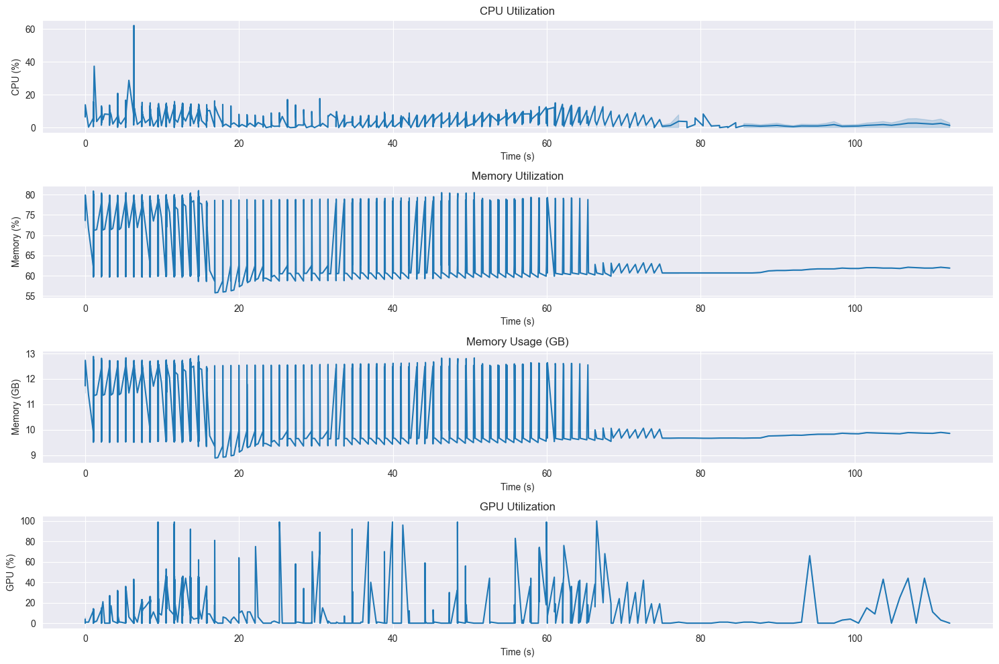



Local epochs:  33%|███▎      | 2/6 [00:39<01:19, 19.85s/it]


Resource Usage Summary:
duration_seconds: 14.79
avg_cpu_percent: 7.36
max_cpu_percent: 62.20
avg_memory_gb: 11.40
max_memory_gb: 12.91
avg_memory_percent: 71.54
max_memory_percent: 81.00
avg_gpu_percent: 17.72
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2373.41
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.7476, Val Loss: 0.8172
Accuracy: 0.7833, Val Accuracy: 0.7046

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7214 - accuracy: 0.7677 - precision: 0.7677 - recall: 0.7677 - per_class_f1: 0.7542
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9810  0.0606    0.1141
Class 1     0.3072  0.9972    0.4697

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6441  0.5289    0.2919


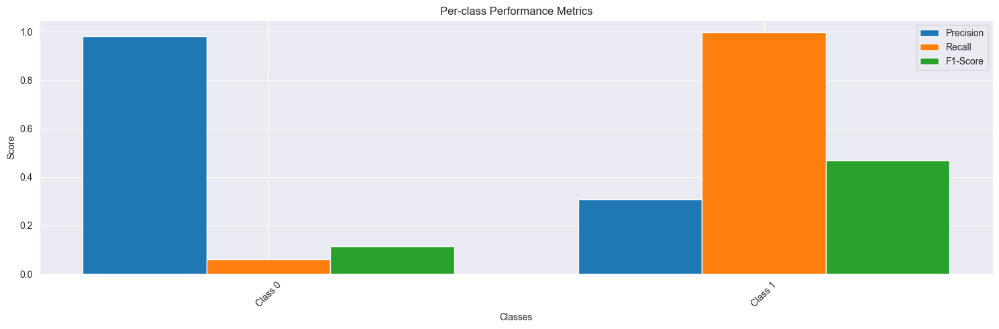


Other metrics:
loss: 0.7214
accuracy: 0.7677
precision: 0.7677
recall: 0.7677
val_loss: 1.0893
val_accuracy: 0.3365
val_precision: 0.3365
val_recall: 0.3365
val_per_class_f1: 0.2919

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 287ms/step - loss: 0.7214 - accuracy: 0.7677 - precision: 0.7677 - recall: 0.7677 - per_class_f1: 0.7542 - val_loss: 1.0893 - val_accuracy: 0.3365 - val_precision: 0.3365 - val_recall: 0.3365 - val_per_class_f1: 0.2919


2024-11-13 14:25:32,967 - INFO - Shuffled data for next epoch


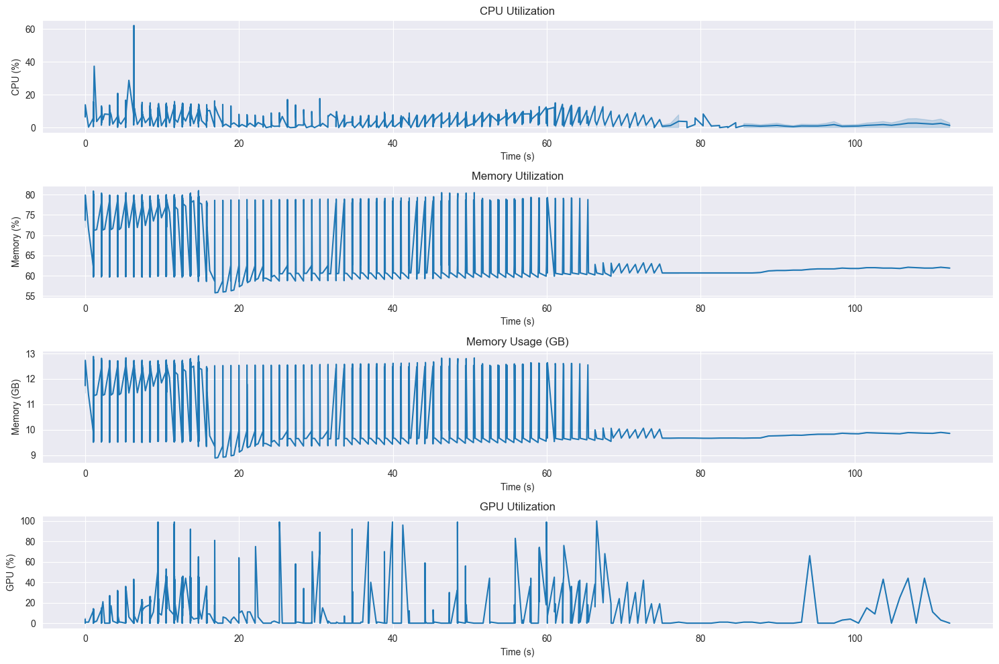



Local epochs:  50%|█████     | 3/6 [00:59<00:59, 19.86s/it]


Resource Usage Summary:
duration_seconds: 14.72
avg_cpu_percent: 7.34
max_cpu_percent: 62.20
avg_memory_gb: 11.40
max_memory_gb: 12.91
avg_memory_percent: 71.60
max_memory_percent: 81.00
avg_gpu_percent: 17.81
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2373.86
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.7214, Val Loss: 1.0893
Accuracy: 0.7677, Val Accuracy: 0.3365

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6804 - accuracy: 0.7876 - precision: 0.7876 - recall: 0.7876 - per_class_f1: 0.7772
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8636  0.2012    0.3263
Class 1     0.3257  0.9239    0.4816

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5947  0.5626    0.4040


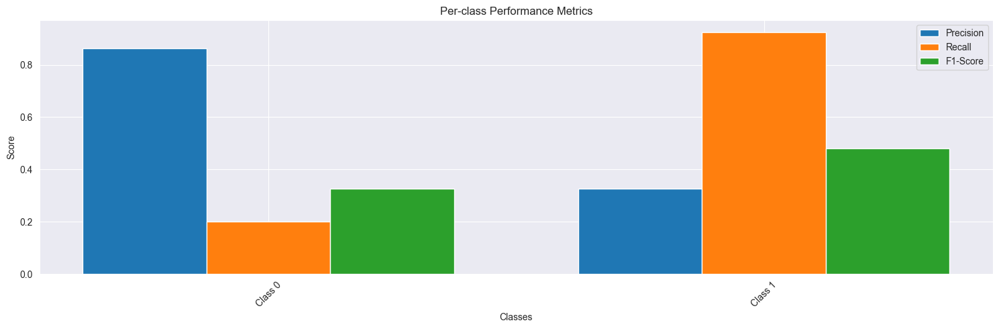


Other metrics:
loss: 0.6804
accuracy: 0.7876
precision: 0.7876
recall: 0.7876
val_loss: 1.0783
val_accuracy: 0.4141
val_precision: 0.4141
val_recall: 0.4141
val_per_class_f1: 0.4040

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 289ms/step - loss: 0.6804 - accuracy: 0.7876 - precision: 0.7876 - recall: 0.7876 - per_class_f1: 0.7772 - val_loss: 1.0783 - val_accuracy: 0.4141 - val_precision: 0.4141 - val_recall: 0.4141 - val_per_class_f1: 0.4040


2024-11-13 14:25:52,957 - INFO - Shuffled data for next epoch


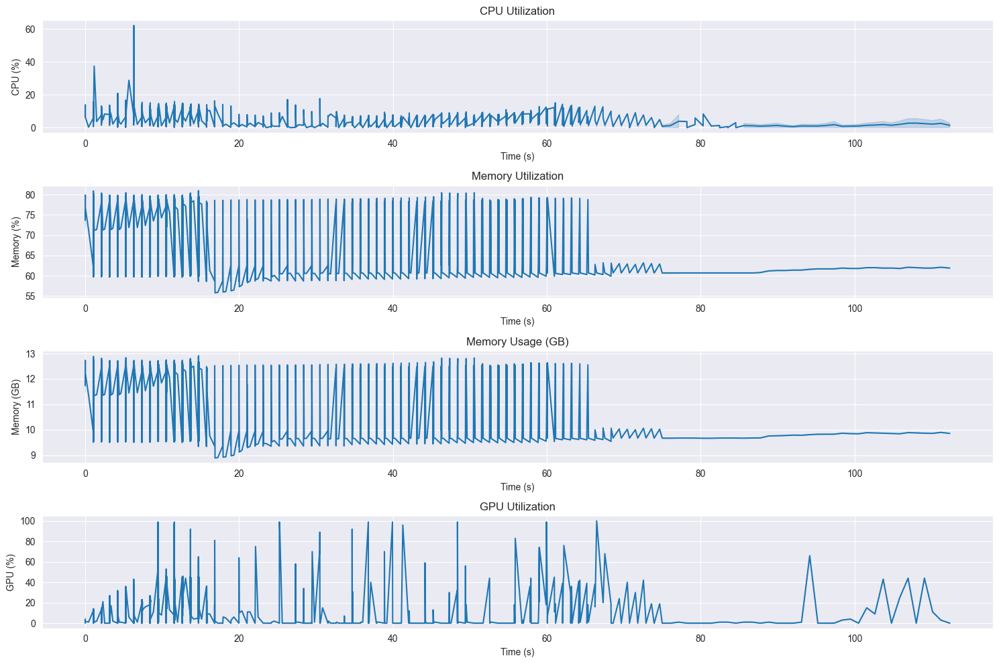



Local epochs:  67%|██████▋   | 4/6 [01:19<00:39, 19.88s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 7.32
max_cpu_percent: 62.20
avg_memory_gb: 11.41
max_memory_gb: 12.91
avg_memory_percent: 71.66
max_memory_percent: 81.00
avg_gpu_percent: 17.84
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2374.30
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.6804, Val Loss: 1.0783
Accuracy: 0.7876, Val Accuracy: 0.4141

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6671 - accuracy: 0.7852 - precision: 0.7852 - recall: 0.7852 - per_class_f1: 0.7732
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9007  0.2882    0.4367
Class 1     0.3516  0.9239    0.5093

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6261  0.6061    0.4730


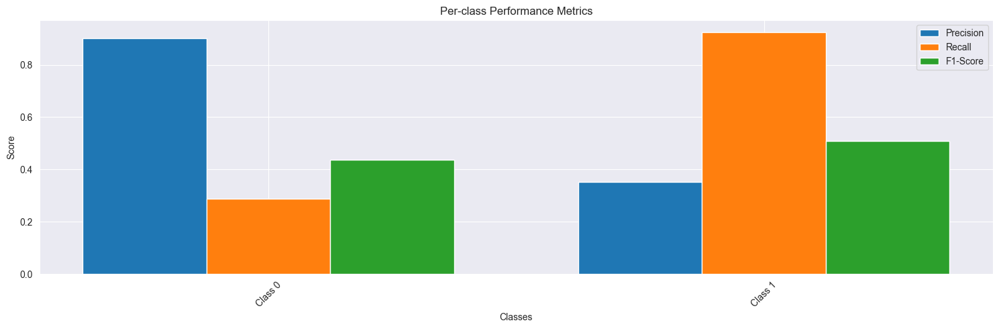


Other metrics:
loss: 0.6671
accuracy: 0.7852
precision: 0.7852
recall: 0.7852
val_loss: 1.2176
val_accuracy: 0.4755
val_precision: 0.4755
val_recall: 0.4755
val_per_class_f1: 0.4730

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 289ms/step - loss: 0.6671 - accuracy: 0.7852 - precision: 0.7852 - recall: 0.7852 - per_class_f1: 0.7732 - val_loss: 1.2176 - val_accuracy: 0.4755 - val_precision: 0.4755 - val_recall: 0.4755 - val_per_class_f1: 0.4730


2024-11-13 14:26:12,820 - INFO - Shuffled data for next epoch


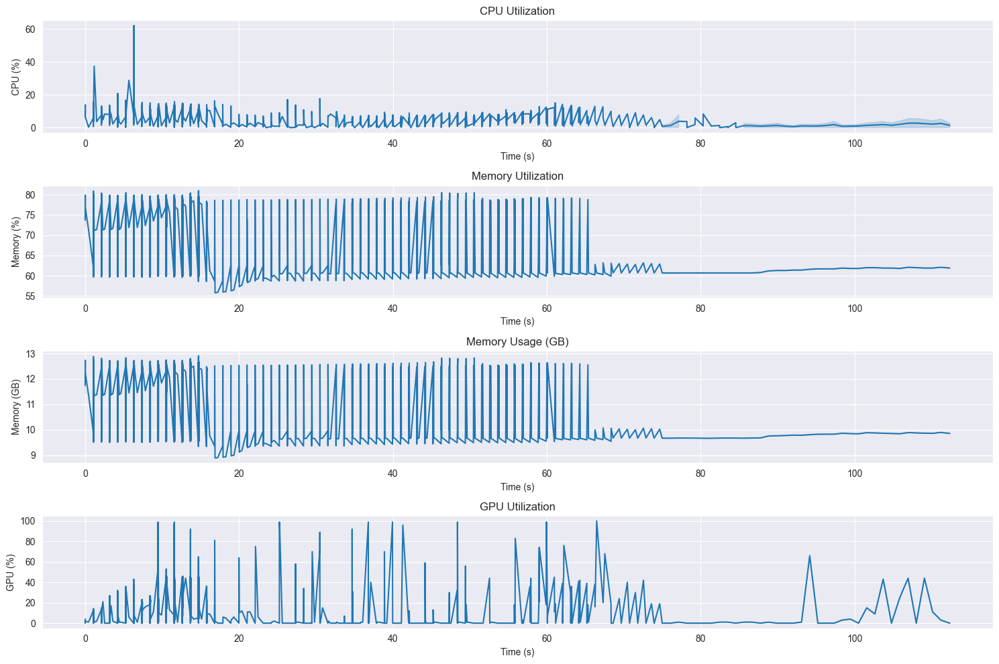

Local epochs:  67%|██████▋   | 4/6 [01:39<00:49, 24.80s/it]

Training Clients:  60%|██████    | 3/5 [04:56<03:14, 97.05s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.31
max_cpu_percent: 62.20
avg_memory_gb: 11.42
max_memory_gb: 12.91
avg_memory_percent: 71.72
max_memory_percent: 81.00
avg_gpu_percent: 17.88
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2374.72
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.6671, Val Loss: 1.2176
Accuracy: 0.7852, Val Accuracy: 0.4755
Early stopping triggered for client 2

==================== Training Client 4 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7453 - accuracy: 0.7924 - precision: 0.7924 - recall: 0.7924 - per_class_f1: 0.7823
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7990  0.6806    0.7351
Class 1     0.4356  0.5901    0.5012

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6173  0.6354    0.6181


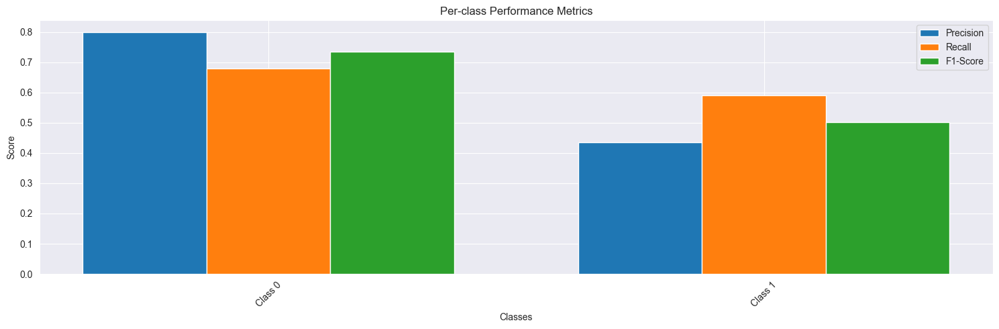


Other metrics:
loss: 0.7453
accuracy: 0.7924
precision: 0.7924
recall: 0.7924
val_loss: 0.9158
val_accuracy: 0.6539
val_precision: 0.6539
val_recall: 0.6539
val_per_class_f1: 0.6181

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.7453 - accuracy: 0.7924 - precision: 0.7924 - recall: 0.7924 - per_class_f1: 0.7823 - val_loss: 0.9158 - val_accuracy: 0.6539 - val_precision: 0.6539 - val_recall: 0.6539 - val_per_class_f1: 0.6181


2024-11-13 14:26:32,668 - INFO - Shuffled data for next epoch


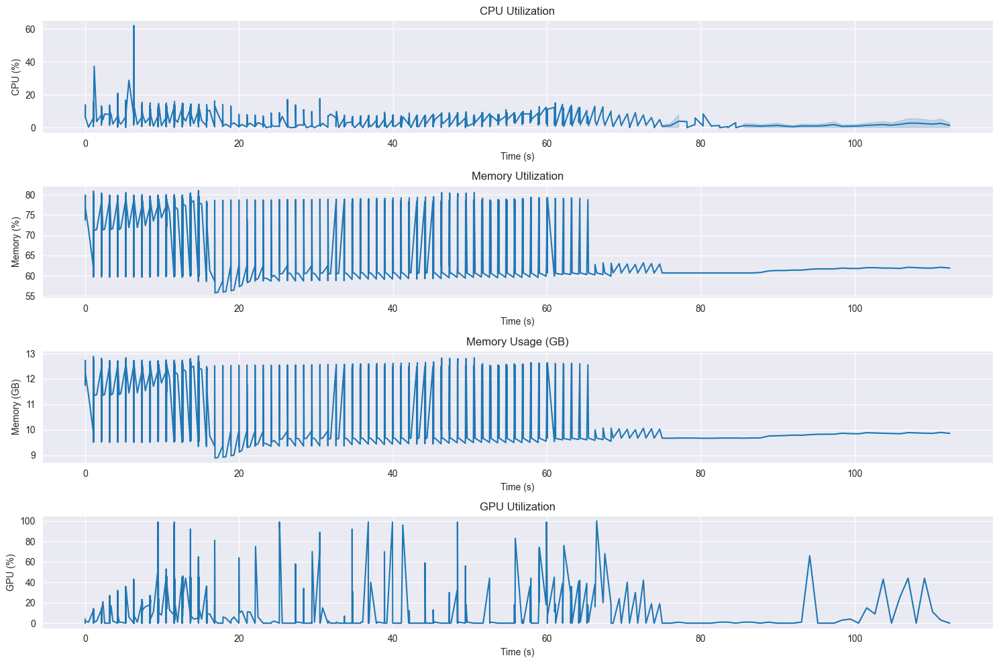



Local epochs:  17%|█▋        | 1/6 [00:19<01:39, 19.97s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.29
max_cpu_percent: 62.20
avg_memory_gb: 11.43
max_memory_gb: 12.91
avg_memory_percent: 71.77
max_memory_percent: 81.00
avg_gpu_percent: 17.95
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2375.14
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.7453, Val Loss: 0.9158
Accuracy: 0.7924, Val Accuracy: 0.6539

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7232 - accuracy: 0.7918 - precision: 0.7918 - recall: 0.7918 - per_class_f1: 0.7811
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9586  0.1771    0.2989
Class 1     0.3325  0.9817    0.4968

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6456  0.5794    0.3979


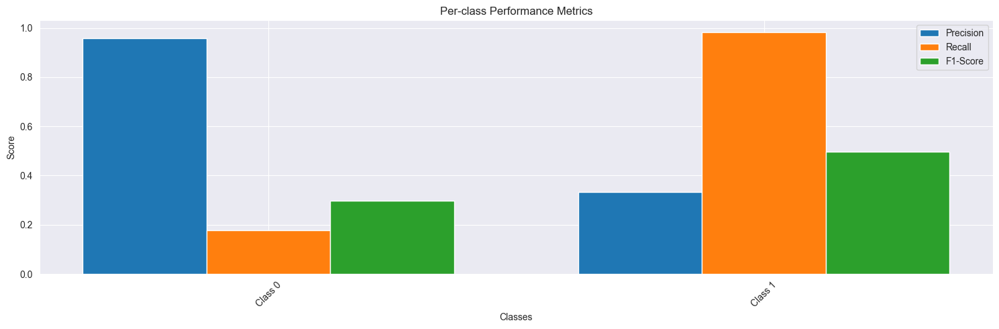


Other metrics:
loss: 0.7232
accuracy: 0.7918
precision: 0.7918
recall: 0.7918
val_loss: 1.1909
val_accuracy: 0.4141
val_precision: 0.4141
val_recall: 0.4141
val_per_class_f1: 0.3979

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.7232 - accuracy: 0.7918 - precision: 0.7918 - recall: 0.7918 - per_class_f1: 0.7811 - val_loss: 1.1909 - val_accuracy: 0.4141 - val_precision: 0.4141 - val_recall: 0.4141 - val_per_class_f1: 0.3979


2024-11-13 14:26:52,612 - INFO - Shuffled data for next epoch


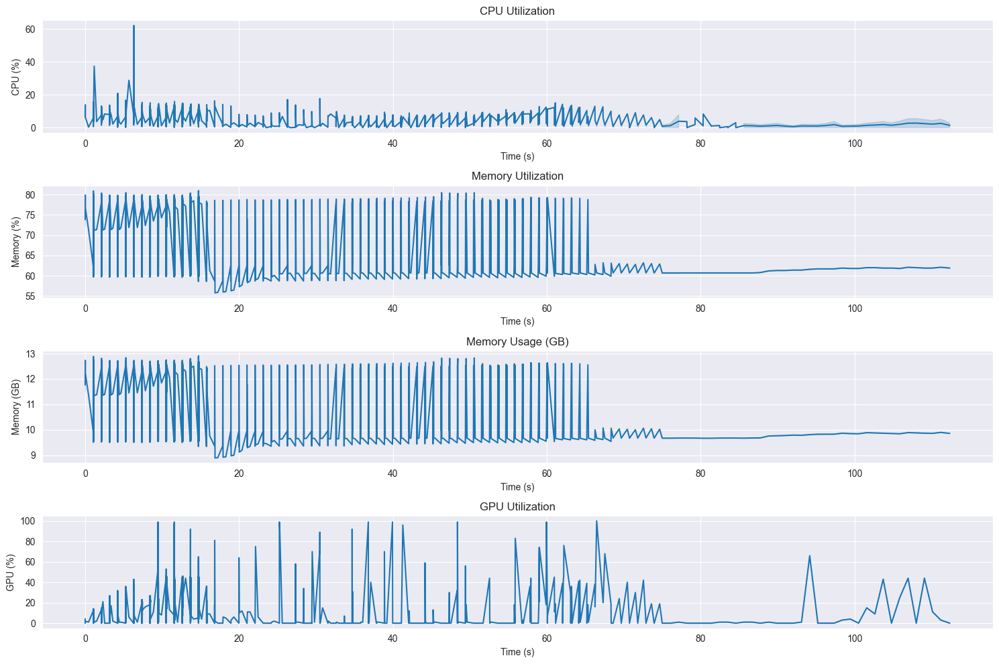



Local epochs:  33%|███▎      | 2/6 [00:39<01:19, 19.97s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.27
max_cpu_percent: 62.20
avg_memory_gb: 11.44
max_memory_gb: 12.91
avg_memory_percent: 71.83
max_memory_percent: 81.00
avg_gpu_percent: 18.02
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2375.55
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.7232, Val Loss: 1.1909
Accuracy: 0.7918, Val Accuracy: 0.4141

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6828 - accuracy: 0.8008 - precision: 0.8008 - recall: 0.8008 - per_class_f1: 0.7932
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7027  0.9288    0.8001
Class 1     0.2577  0.0592    0.0962

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4802  0.4940    0.4482


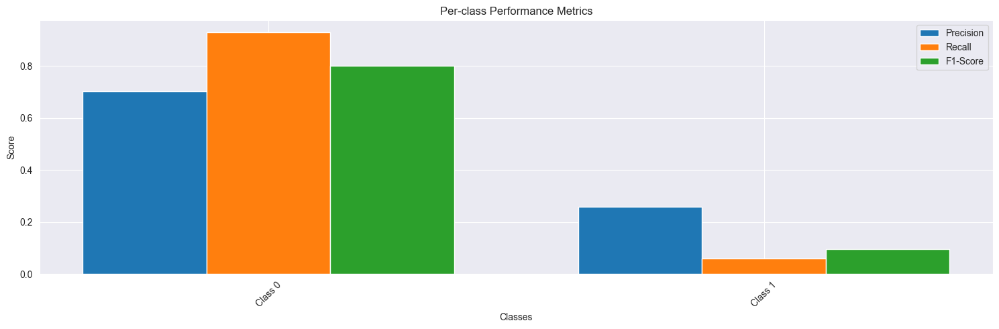


Other metrics:
loss: 0.6828
accuracy: 0.8008
precision: 0.8008
recall: 0.8008
val_loss: 0.8396
val_accuracy: 0.6726
val_precision: 0.6726
val_recall: 0.6726
val_per_class_f1: 0.4482

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6828 - accuracy: 0.8008 - precision: 0.8008 - recall: 0.8008 - per_class_f1: 0.7932 - val_loss: 0.8396 - val_accuracy: 0.6726 - val_precision: 0.6726 - val_recall: 0.6726 - val_per_class_f1: 0.4482


2024-11-13 14:27:12,599 - INFO - Shuffled data for next epoch


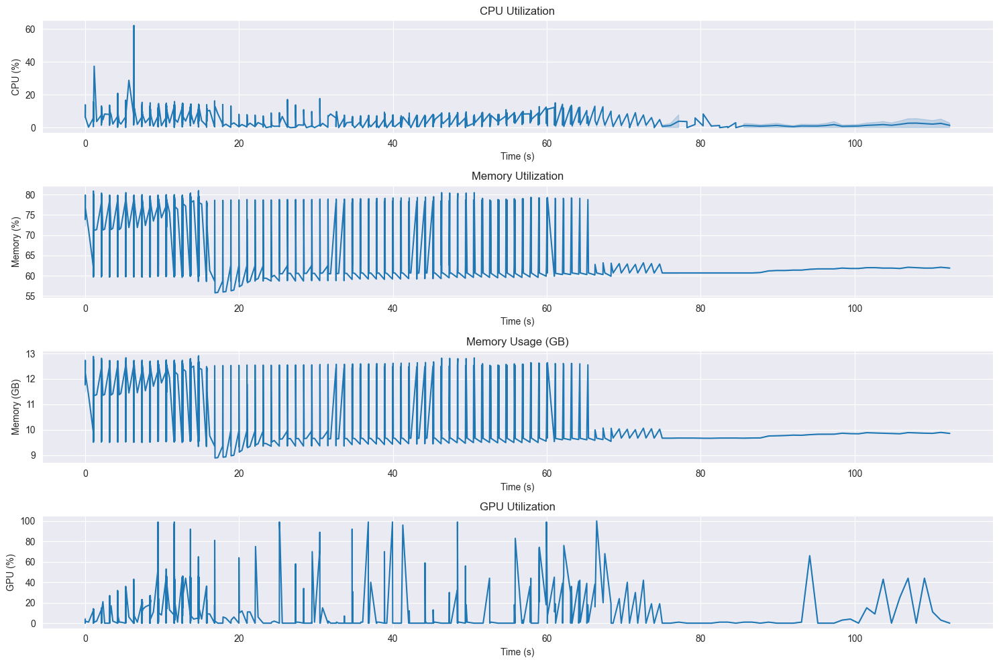



Local epochs:  50%|█████     | 3/6 [00:59<00:59, 19.97s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.26
max_cpu_percent: 62.20
avg_memory_gb: 11.45
max_memory_gb: 12.91
avg_memory_percent: 71.88
max_memory_percent: 81.00
avg_gpu_percent: 18.03
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2375.95
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6828, Val Loss: 0.8396
Accuracy: 0.8008, Val Accuracy: 0.6726

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6851 - accuracy: 0.7960 - precision: 0.7960 - recall: 0.7960 - per_class_f1: 0.7872
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8354  0.5641    0.6735
Class 1     0.4128  0.7338    0.5284

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6241  0.6490    0.6009


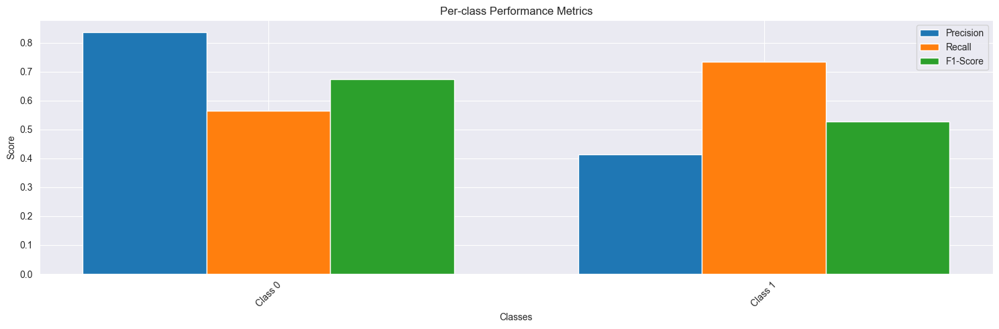


Other metrics:
loss: 0.6851
accuracy: 0.7960
precision: 0.7960
recall: 0.7960
val_loss: 0.8785
val_accuracy: 0.6141
val_precision: 0.6141
val_recall: 0.6141
val_per_class_f1: 0.6009

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6851 - accuracy: 0.7960 - precision: 0.7960 - recall: 0.7960 - per_class_f1: 0.7872 - val_loss: 0.8785 - val_accuracy: 0.6141 - val_precision: 0.6141 - val_recall: 0.6141 - val_per_class_f1: 0.6009


2024-11-13 14:27:32,595 - INFO - Shuffled data for next epoch


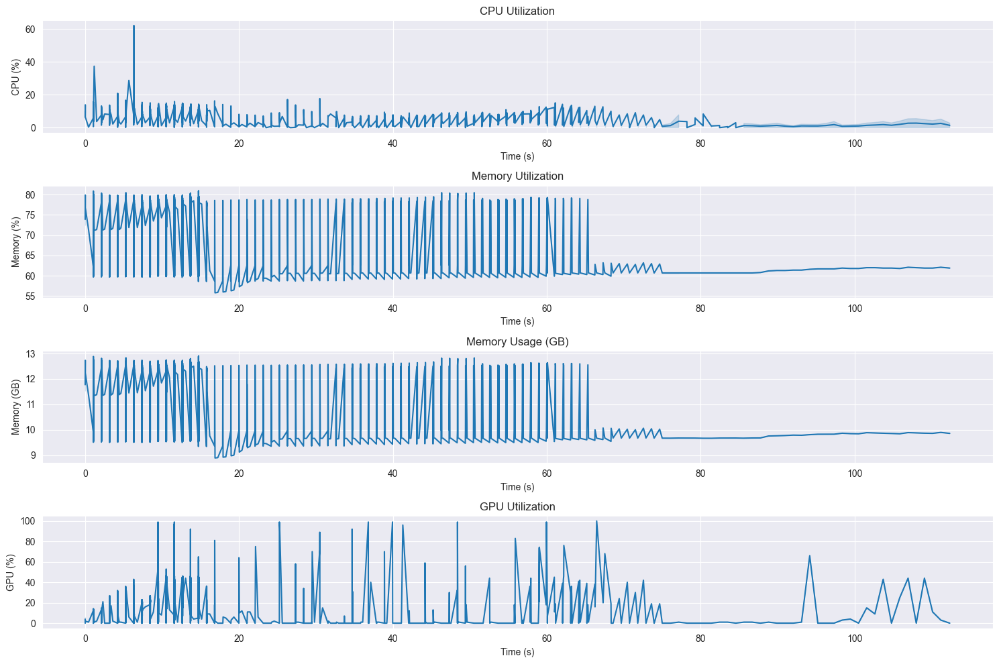



Local epochs:  67%|██████▋   | 4/6 [01:19<00:39, 19.90s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.24
max_cpu_percent: 62.20
avg_memory_gb: 11.46
max_memory_gb: 12.91
avg_memory_percent: 71.93
max_memory_percent: 81.00
avg_gpu_percent: 18.09
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2376.34
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.6851, Val Loss: 0.8785
Accuracy: 0.7960, Val Accuracy: 0.6141

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6453 - accuracy: 0.8087 - precision: 0.8087 - recall: 0.8087 - per_class_f1: 0.7994
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7185  0.9265    0.8094
Class 1     0.4266  0.1310    0.2004

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5726  0.5287    0.5049


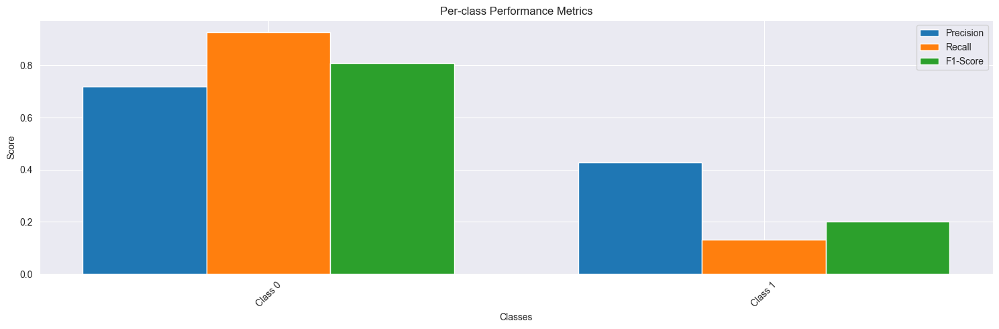


Other metrics:
loss: 0.6453
accuracy: 0.8087
precision: 0.8087
recall: 0.8087
val_loss: 0.7807
val_accuracy: 0.6921
val_precision: 0.6921
val_recall: 0.6921
val_per_class_f1: 0.5049

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6453 - accuracy: 0.8087 - precision: 0.8087 - recall: 0.8087 - per_class_f1: 0.7994 - val_loss: 0.7807 - val_accuracy: 0.6921 - val_precision: 0.6921 - val_recall: 0.6921 - val_per_class_f1: 0.5049


2024-11-13 14:27:52,371 - INFO - Shuffled data for next epoch


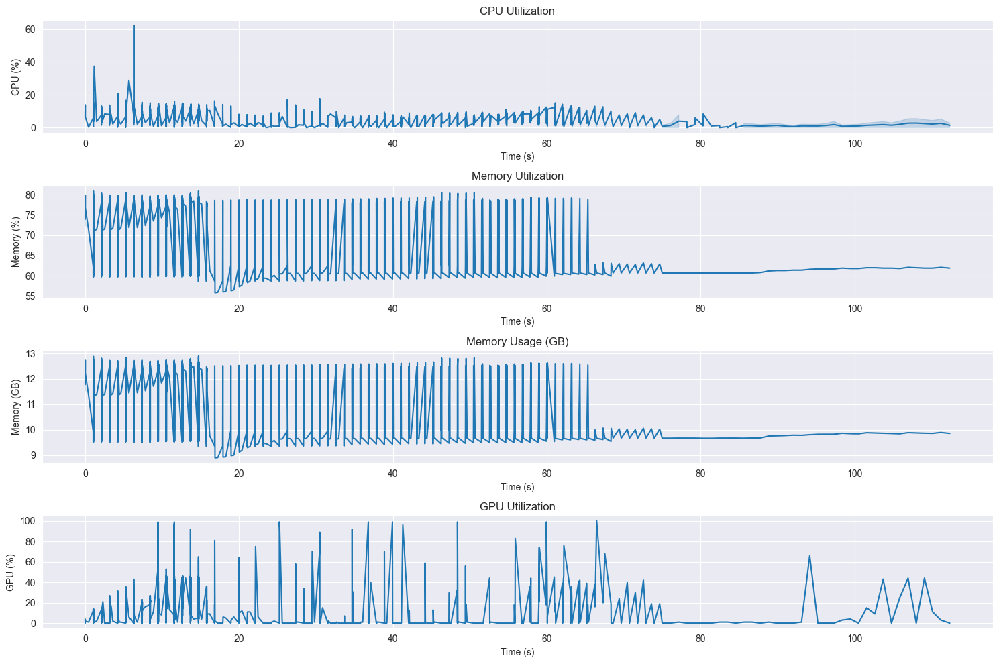



Local epochs:  83%|████████▎ | 5/6 [01:39<00:19, 19.93s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.23
max_cpu_percent: 62.20
avg_memory_gb: 11.47
max_memory_gb: 12.91
avg_memory_percent: 71.99
max_memory_percent: 81.00
avg_gpu_percent: 18.08
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2376.73
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.6453, Val Loss: 0.7807
Accuracy: 0.8087, Val Accuracy: 0.6921

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6245 - accuracy: 0.7954 - precision: 0.7954 - recall: 0.7954 - per_class_f1: 0.7861
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7855  0.7324    0.7580
Class 1     0.4485  0.5211    0.4821

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6170  0.6267    0.6200


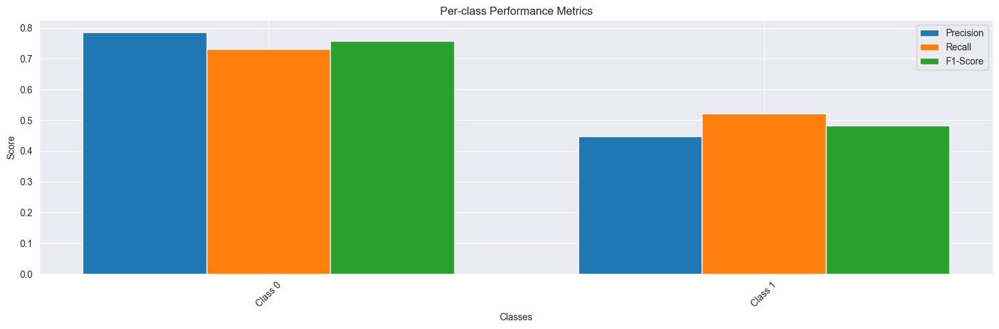


Other metrics:
loss: 0.6245
accuracy: 0.7954
precision: 0.7954
recall: 0.7954
val_loss: 0.7979
val_accuracy: 0.6701
val_precision: 0.6701
val_recall: 0.6701
val_per_class_f1: 0.6200

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6245 - accuracy: 0.7954 - precision: 0.7954 - recall: 0.7954 - per_class_f1: 0.7861 - val_loss: 0.7979 - val_accuracy: 0.6701 - val_precision: 0.6701 - val_recall: 0.6701 - val_per_class_f1: 0.6200


2024-11-13 14:28:12,324 - INFO - Shuffled data for next epoch


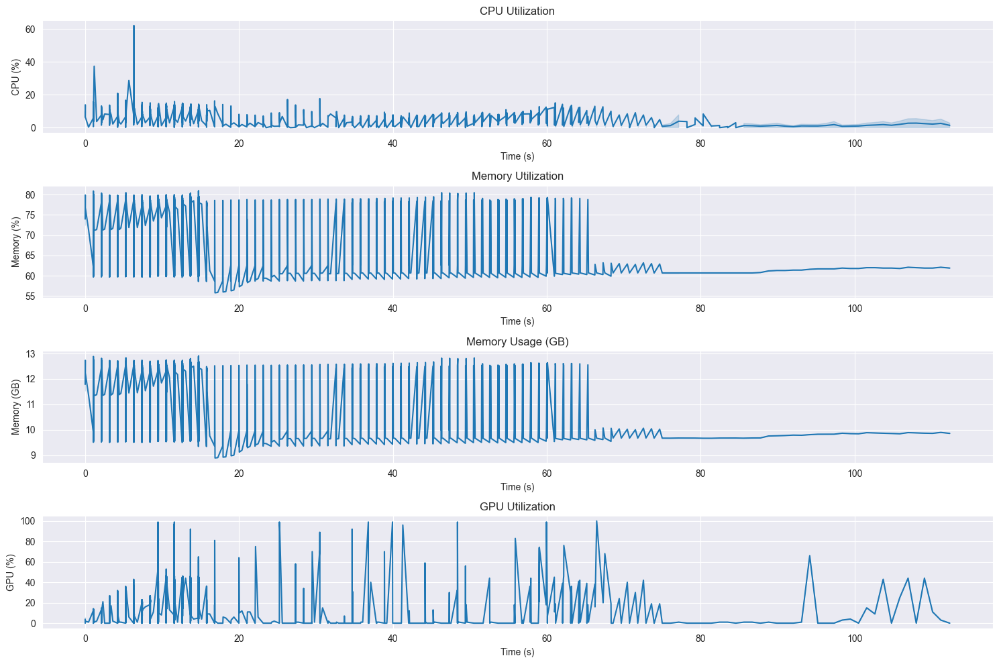



Local epochs: 100%|██████████| 6/6 [01:59<00:00, 19.95s/it]

Training Clients:  80%|████████  | 4/5 [06:56<01:46, 106.00s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.21
max_cpu_percent: 62.20
avg_memory_gb: 11.47
max_memory_gb: 12.91
avg_memory_percent: 72.04
max_memory_percent: 81.00
avg_gpu_percent: 18.11
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2377.11
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.6245, Val Loss: 0.7979
Accuracy: 0.7954, Val Accuracy: 0.6701

==================== Training Client 5 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7599 - accuracy: 0.7819 - precision: 0.7819 - recall: 0.7819 - per_class_f1: 0.7678
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9851  0.0776    0.1439
Class 1     0.3111  0.9972    0.4742

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6481  0.5374    0.3091


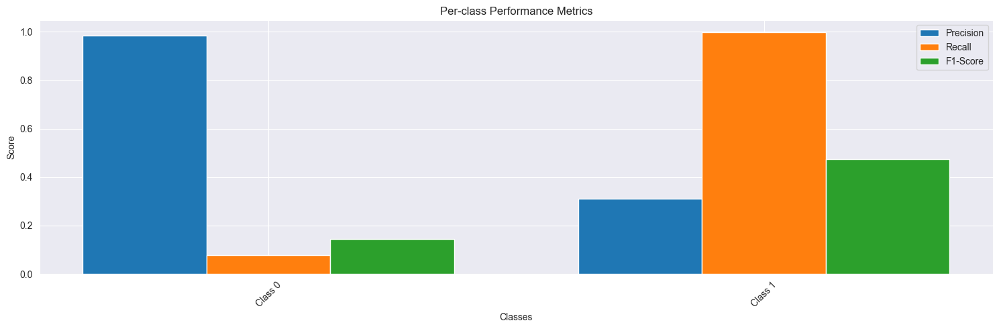


Other metrics:
loss: 0.7599
accuracy: 0.7819
precision: 0.7819
recall: 0.7819
val_loss: 1.1629
val_accuracy: 0.3485
val_precision: 0.3485
val_recall: 0.3485
val_per_class_f1: 0.3091

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.7599 - accuracy: 0.7819 - precision: 0.7819 - recall: 0.7819 - per_class_f1: 0.7678 - val_loss: 1.1629 - val_accuracy: 0.3485 - val_precision: 0.3485 - val_recall: 0.3485 - val_per_class_f1: 0.3091


2024-11-13 14:28:32,346 - INFO - Shuffled data for next epoch


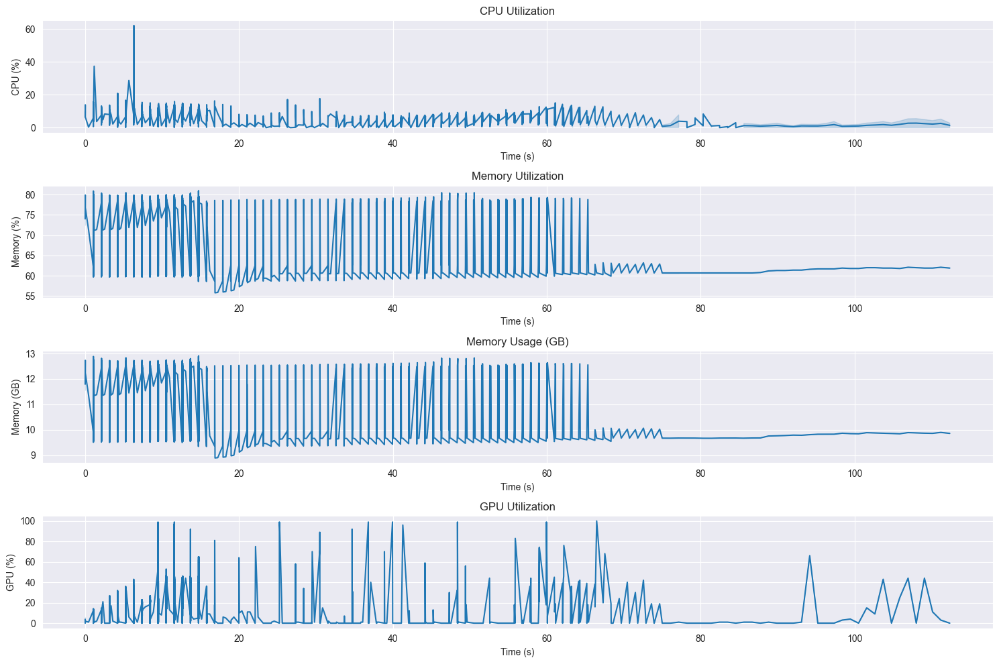



Local epochs:  17%|█▋        | 1/6 [00:20<01:40, 20.04s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.20
max_cpu_percent: 62.20
avg_memory_gb: 11.48
max_memory_gb: 12.91
avg_memory_percent: 72.09
max_memory_percent: 81.00
avg_gpu_percent: 18.17
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2377.48
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.7599, Val Loss: 1.1629
Accuracy: 0.7819, Val Accuracy: 0.3485

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.7251 - accuracy: 0.7849 - precision: 0.7849 - recall: 0.7849 - per_class_f1: 0.7736
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7037  0.9641    0.8136
Class 1     0.2469  0.0282    0.0506

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4753  0.4961    0.4321


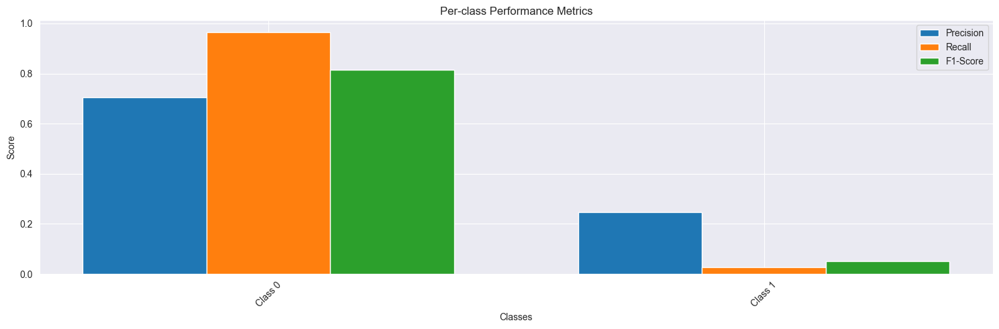


Other metrics:
loss: 0.7251
accuracy: 0.7849
precision: 0.7849
recall: 0.7849
val_loss: 0.8624
val_accuracy: 0.6884
val_precision: 0.6884
val_recall: 0.6884
val_per_class_f1: 0.4321

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.7251 - accuracy: 0.7849 - precision: 0.7849 - recall: 0.7849 - per_class_f1: 0.7736 - val_loss: 0.8624 - val_accuracy: 0.6884 - val_precision: 0.6884 - val_recall: 0.6884 - val_per_class_f1: 0.4321


2024-11-13 14:28:52,487 - INFO - Shuffled data for next epoch


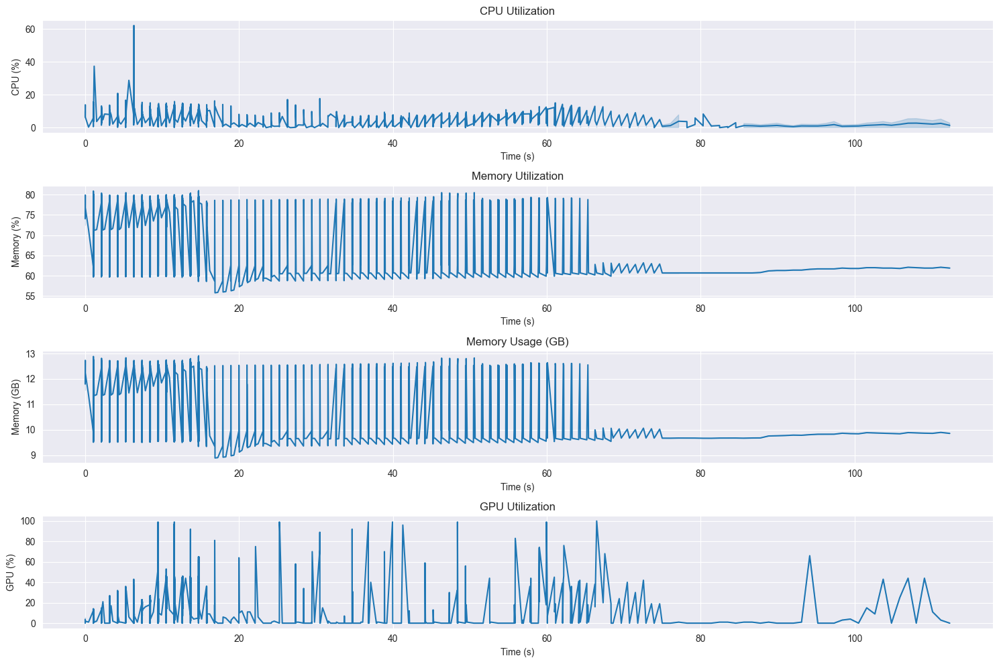



Local epochs:  33%|███▎      | 2/6 [00:39<01:19, 19.93s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.18
max_cpu_percent: 62.20
avg_memory_gb: 11.49
max_memory_gb: 12.91
avg_memory_percent: 72.14
max_memory_percent: 81.00
avg_gpu_percent: 18.20
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2377.84
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.7251, Val Loss: 0.8624
Accuracy: 0.7849, Val Accuracy: 0.6884

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6984 - accuracy: 0.7928 - precision: 0.7928 - recall: 0.7928 - per_class_f1: 0.7805
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7592  0.7547    0.7569
Class 1     0.4208  0.4268    0.4238

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5900  0.5907    0.5904


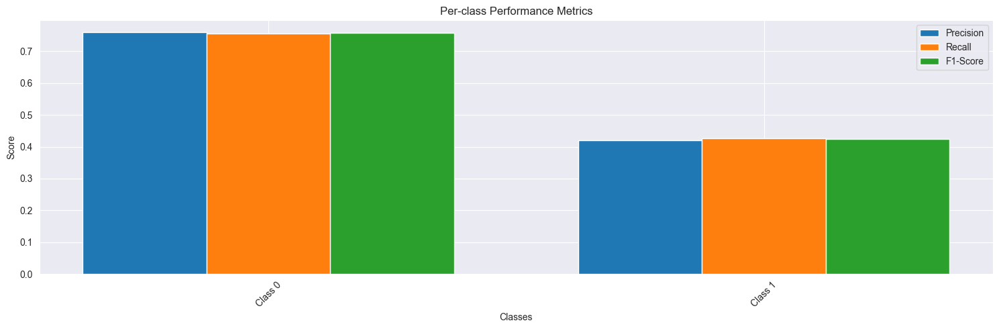


Other metrics:
loss: 0.6984
accuracy: 0.7928
precision: 0.7928
recall: 0.7928
val_loss: 0.8418
val_accuracy: 0.6581
val_precision: 0.6581
val_recall: 0.6581
val_per_class_f1: 0.5904

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6984 - accuracy: 0.7928 - precision: 0.7928 - recall: 0.7928 - per_class_f1: 0.7805 - val_loss: 0.8418 - val_accuracy: 0.6581 - val_precision: 0.6581 - val_recall: 0.6581 - val_per_class_f1: 0.5904


2024-11-13 14:29:12,251 - INFO - Shuffled data for next epoch


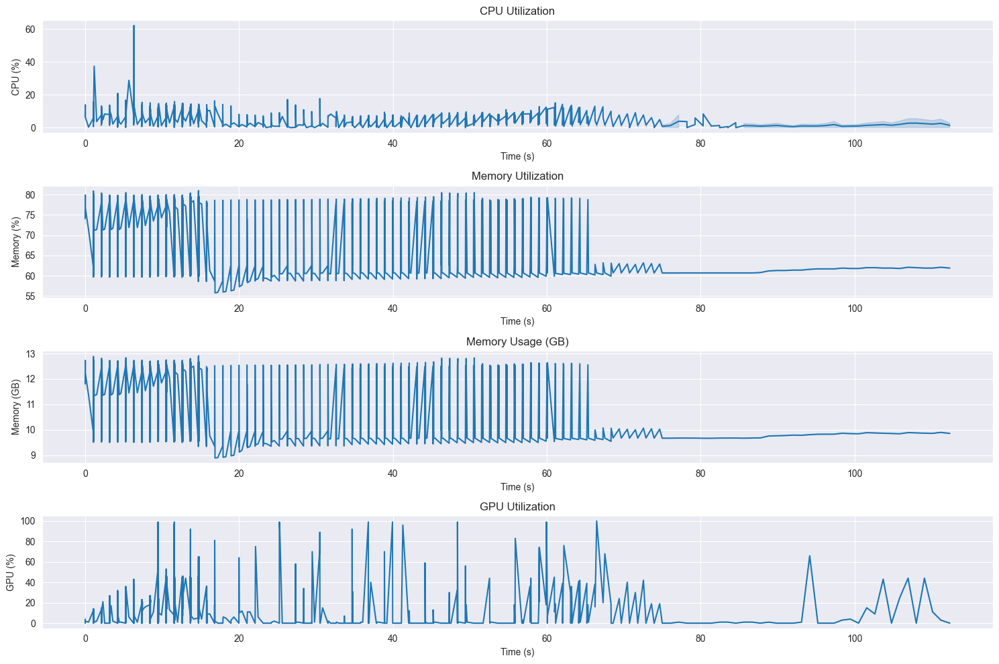



Local epochs:  50%|█████     | 3/6 [00:59<00:59, 19.99s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.16
max_cpu_percent: 62.20
avg_memory_gb: 11.50
max_memory_gb: 12.91
avg_memory_percent: 72.18
max_memory_percent: 81.00
avg_gpu_percent: 18.23
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2378.19
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6984, Val Loss: 0.8418
Accuracy: 0.7928, Val Accuracy: 0.6581

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6870 - accuracy: 0.7711 - precision: 0.7711 - recall: 0.7711 - per_class_f1: 0.7607
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7479  0.8047    0.7753
Class 1     0.4286  0.3507    0.3857

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5883  0.5777    0.5805


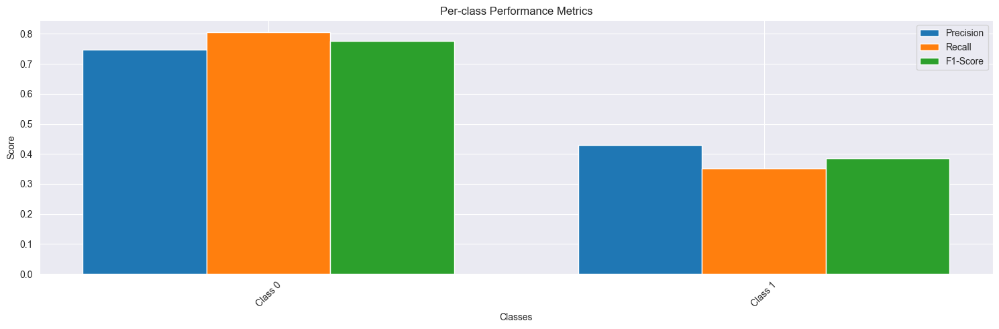


Other metrics:
loss: 0.6870
accuracy: 0.7711
precision: 0.7711
recall: 0.7711
val_loss: 0.8184
val_accuracy: 0.6710
val_precision: 0.6710
val_recall: 0.6710
val_per_class_f1: 0.5805

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.6870 - accuracy: 0.7711 - precision: 0.7711 - recall: 0.7711 - per_class_f1: 0.7607 - val_loss: 0.8184 - val_accuracy: 0.6710 - val_precision: 0.6710 - val_recall: 0.6710 - val_per_class_f1: 0.5805


2024-11-13 14:29:32,376 - INFO - Shuffled data for next epoch


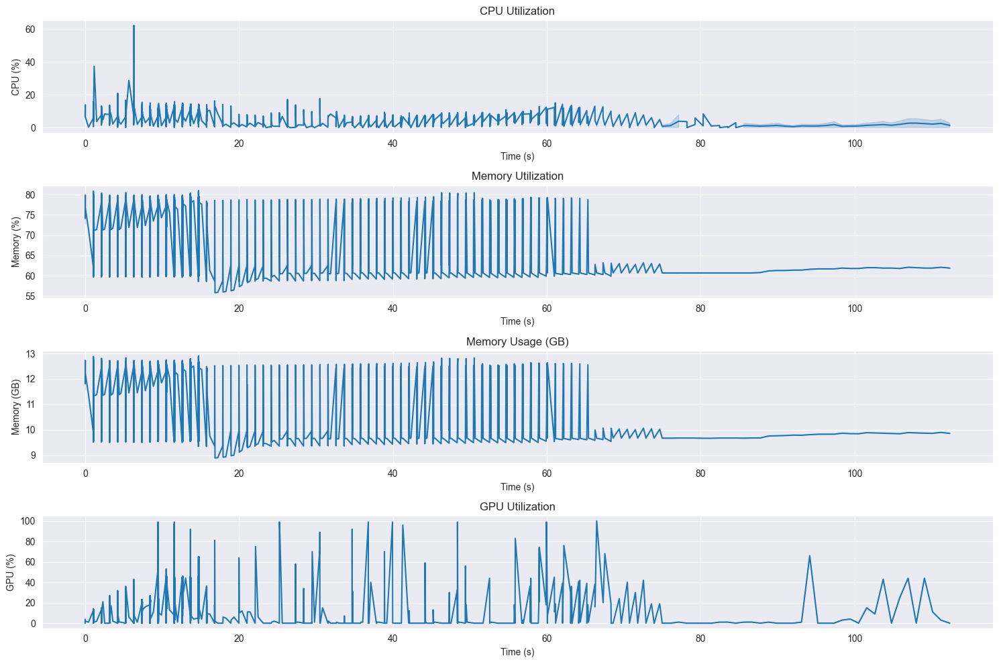



Local epochs:  67%|██████▋   | 4/6 [01:19<00:40, 20.01s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.15
max_cpu_percent: 62.20
avg_memory_gb: 11.51
max_memory_gb: 12.91
avg_memory_percent: 72.23
max_memory_percent: 81.00
avg_gpu_percent: 18.25
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2378.54
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.6870, Val Loss: 0.8184
Accuracy: 0.7711, Val Accuracy: 0.6710

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6618 - accuracy: 0.7813 - precision: 0.7813 - recall: 0.7813 - per_class_f1: 0.7715
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7977  0.7006    0.7460
Class 1     0.4449  0.5746    0.5015

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6213  0.6376    0.6238


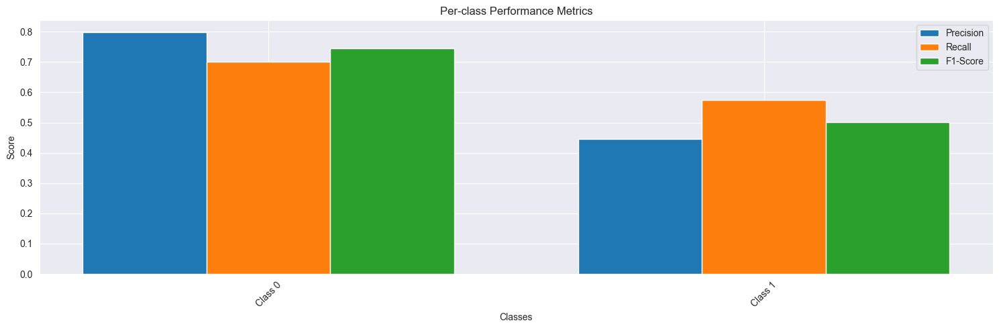


Other metrics:
loss: 0.6618
accuracy: 0.7813
precision: 0.7813
recall: 0.7813
val_loss: 0.8026
val_accuracy: 0.6635
val_precision: 0.6635
val_recall: 0.6635
val_per_class_f1: 0.6238

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6618 - accuracy: 0.7813 - precision: 0.7813 - recall: 0.7813 - per_class_f1: 0.7715 - val_loss: 0.8026 - val_accuracy: 0.6635 - val_precision: 0.6635 - val_recall: 0.6635 - val_per_class_f1: 0.6238


2024-11-13 14:29:52,372 - INFO - Shuffled data for next epoch


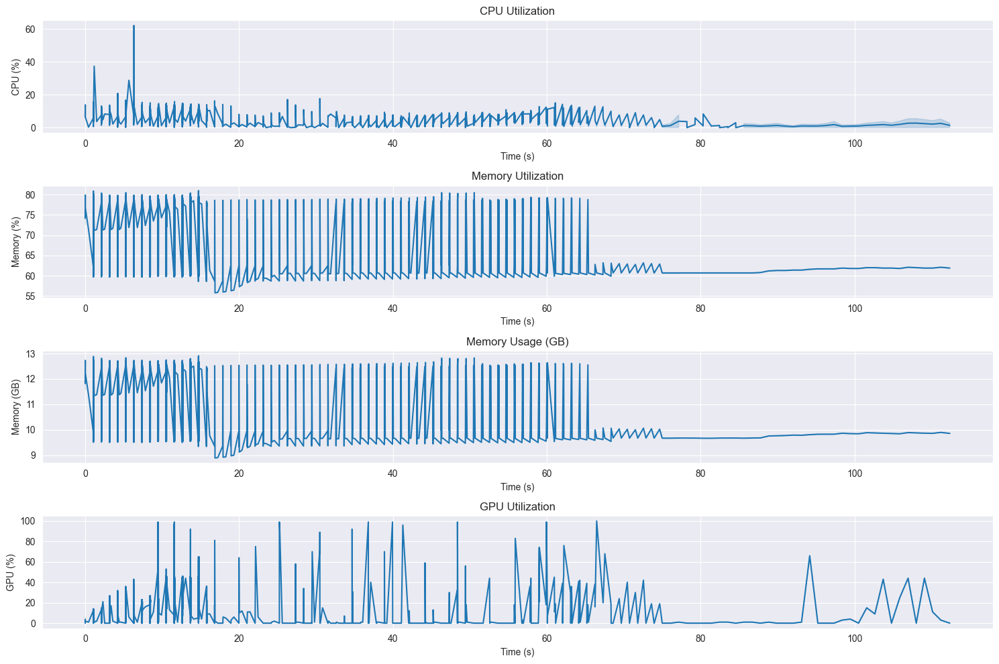



Local epochs:  83%|████████▎ | 5/6 [01:40<00:20, 20.03s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 7.14
max_cpu_percent: 62.20
avg_memory_gb: 11.51
max_memory_gb: 12.91
avg_memory_percent: 72.28
max_memory_percent: 81.00
avg_gpu_percent: 18.31
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2378.89
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.6618, Val Loss: 0.8026
Accuracy: 0.7813, Val Accuracy: 0.6635

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6469 - accuracy: 0.7940 - precision: 0.7940 - recall: 0.7940 - per_class_f1: 0.7833
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9202  0.2171    0.3513
Class 1     0.3375  0.9549    0.4987

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6288  0.5860    0.4250


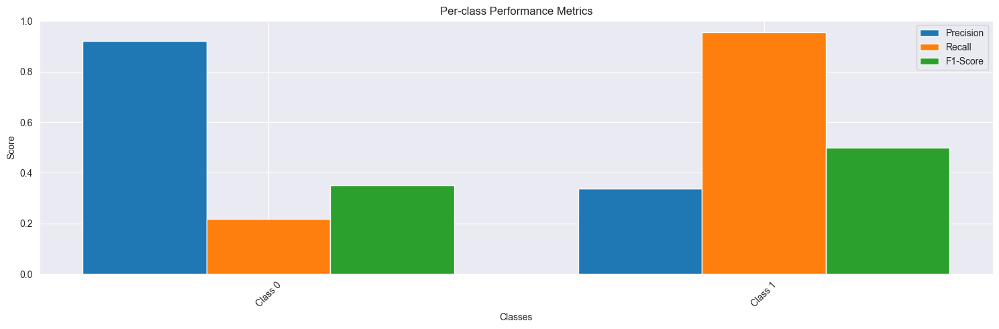


Other metrics:
loss: 0.6469
accuracy: 0.7940
precision: 0.7940
recall: 0.7940
val_loss: 1.2896
val_accuracy: 0.4344
val_precision: 0.4344
val_recall: 0.4344
val_per_class_f1: 0.4250

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6469 - accuracy: 0.7940 - precision: 0.7940 - recall: 0.7940 - per_class_f1: 0.7833 - val_loss: 1.2896 - val_accuracy: 0.4344 - val_precision: 0.4344 - val_recall: 0.4344 - val_per_class_f1: 0.4250


2024-11-13 14:30:12,441 - INFO - Shuffled data for next epoch


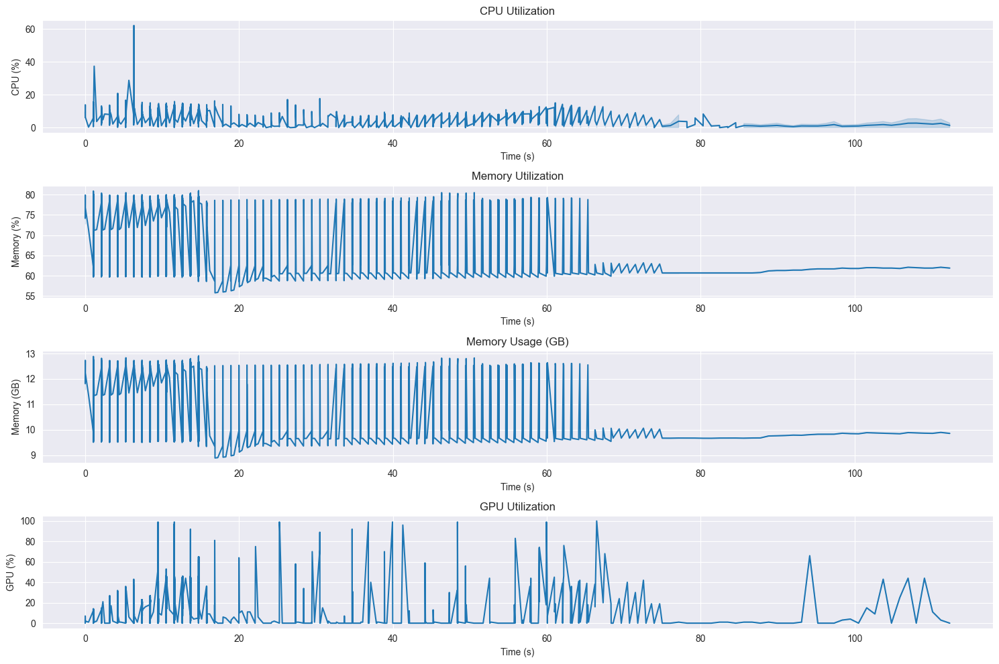



Local epochs: 100%|██████████| 6/6 [02:00<00:00, 20.02s/it]

Training Clients: 100%|██████████| 5/5 [08:56<00:00, 107.28s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 7.12
max_cpu_percent: 62.20
avg_memory_gb: 11.52
max_memory_gb: 12.91
avg_memory_percent: 72.32
max_memory_percent: 81.00
avg_gpu_percent: 18.37
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2379.22
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.6469, Val Loss: 1.2896
Accuracy: 0.7940, Val Accuracy: 0.4344



Federated Learning Rounds:  60%|██████    | 3/5 [31:54<20:19, 609.55s/it]


Test metrics:
loss: 0.7699
accuracy: 0.6967
precision: 0.6967
recall: 0.6967
f1_metric: 0.4939

Round Summary:
val_loss: 1.0444
loss: 0.6490

Per-class F1 scores:
Class 0: 0.8302
Class 1: 0.7290
accuracy: 0.7913
precision: 0.7913
recall: 0.7913
val_accuracy: 0.5445
val_precision: 0.5445
val_recall: 0.5445
val_per_class_f1: 0.5144

Federated Learning Round 4/5



Training Clients:   0%|          | 0/5 [00:00<?, ?it/s]


==================== Training Client 1 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6426 - accuracy: 0.8039 - precision: 0.8039 - recall: 0.8039 - per_class_f1: 0.7930
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7393  0.8541    0.7926
Class 1     0.4439  0.2789    0.3426

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5916  0.5665    0.5676


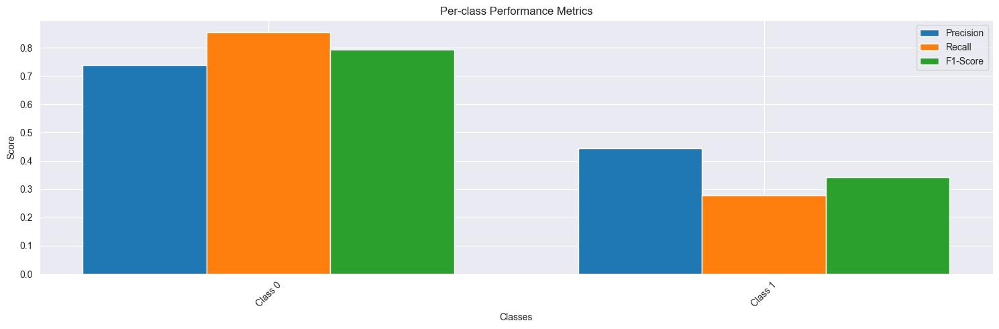


Other metrics:
loss: 0.6426
accuracy: 0.8039
precision: 0.8039
recall: 0.8039
val_loss: 0.7406
val_accuracy: 0.6846
val_precision: 0.6846
val_recall: 0.6846
val_per_class_f1: 0.5676

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.6426 - accuracy: 0.8039 - precision: 0.8039 - recall: 0.8039 - per_class_f1: 0.7930 - val_loss: 0.7406 - val_accuracy: 0.6846 - val_precision: 0.6846 - val_recall: 0.6846 - val_per_class_f1: 0.5676


2024-11-13 14:30:41,606 - INFO - Shuffled data for next epoch


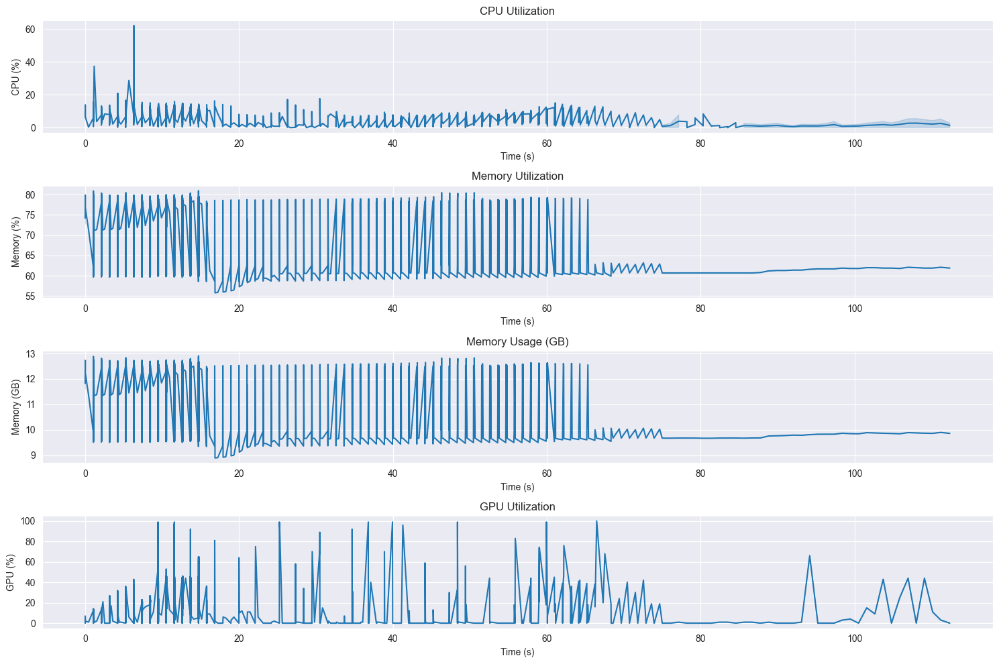



Local epochs:  17%|█▋        | 1/6 [00:19<01:39, 19.88s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.11
max_cpu_percent: 62.20
avg_memory_gb: 11.53
max_memory_gb: 12.91
avg_memory_percent: 72.37
max_memory_percent: 81.00
avg_gpu_percent: 18.40
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2379.55
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.6426, Val Loss: 0.7406
Accuracy: 0.8039, Val Accuracy: 0.6846

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6349 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7711
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7492  0.8788    0.8089
Class 1     0.5048  0.2958    0.3730

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6270  0.5873    0.5909


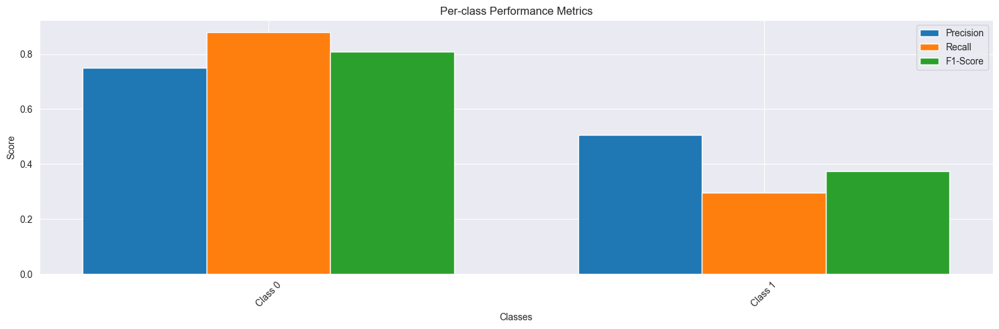


Other metrics:
loss: 0.6349
accuracy: 0.7839
precision: 0.7839
recall: 0.7839
val_loss: 0.7591
val_accuracy: 0.7071
val_precision: 0.7071
val_recall: 0.7071
val_per_class_f1: 0.5909

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.6349 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7711 - val_loss: 0.7591 - val_accuracy: 0.7071 - val_precision: 0.7071 - val_recall: 0.7071 - val_per_class_f1: 0.5909


2024-11-13 14:31:01,581 - INFO - Shuffled data for next epoch


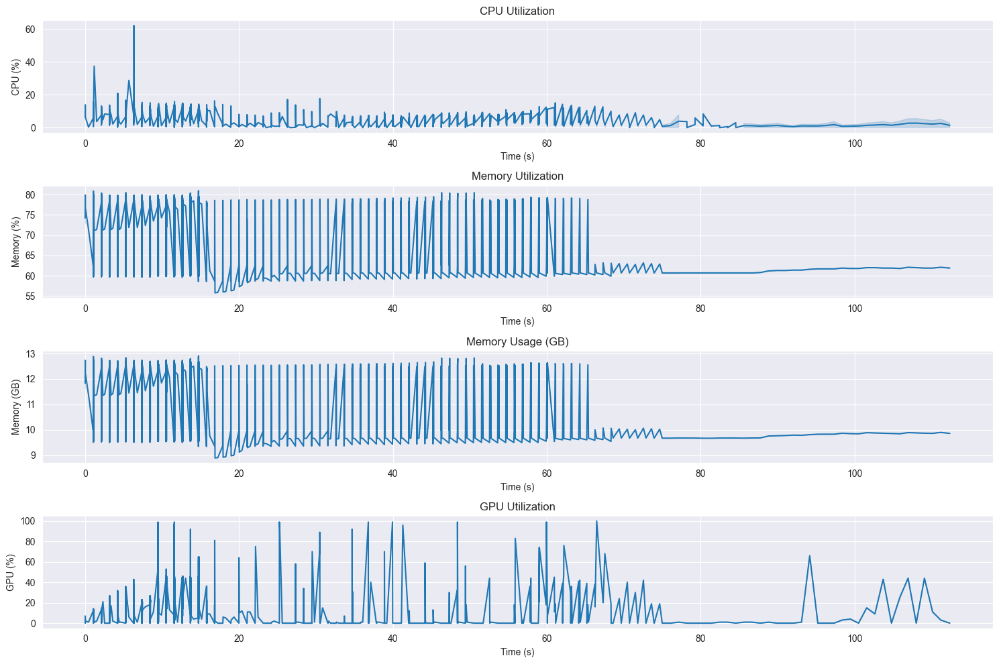



Local epochs:  33%|███▎      | 2/6 [00:39<01:19, 19.99s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.09
max_cpu_percent: 62.20
avg_memory_gb: 11.53
max_memory_gb: 12.91
avg_memory_percent: 72.42
max_memory_percent: 81.00
avg_gpu_percent: 18.43
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2379.88
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.6349, Val Loss: 0.7591
Accuracy: 0.7839, Val Accuracy: 0.7071

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5954 - accuracy: 0.7984 - precision: 0.7984 - recall: 0.7984 - per_class_f1: 0.7867
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8229  0.1394    0.2384
Class 1     0.3106  0.9282    0.4654

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5667  0.5338    0.3519


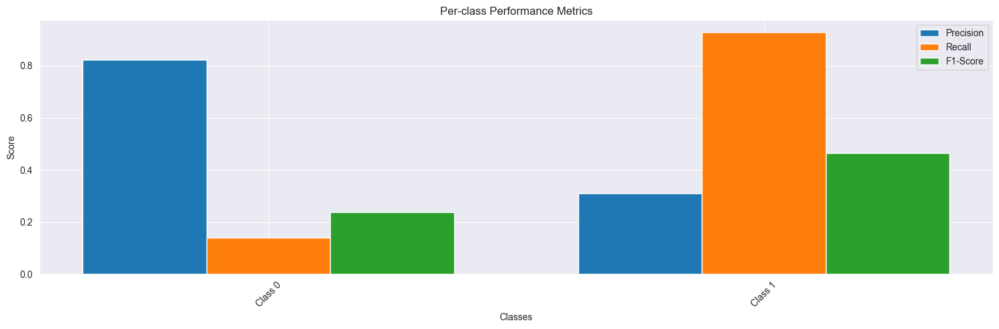


Other metrics:
loss: 0.5954
accuracy: 0.7984
precision: 0.7984
recall: 0.7984
val_loss: 1.1329
val_accuracy: 0.3718
val_precision: 0.3718
val_recall: 0.3718
val_per_class_f1: 0.3519

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.5954 - accuracy: 0.7984 - precision: 0.7984 - recall: 0.7984 - per_class_f1: 0.7867 - val_loss: 1.1329 - val_accuracy: 0.3718 - val_precision: 0.3718 - val_recall: 0.3718 - val_per_class_f1: 0.3519


2024-11-13 14:31:21,669 - INFO - Shuffled data for next epoch


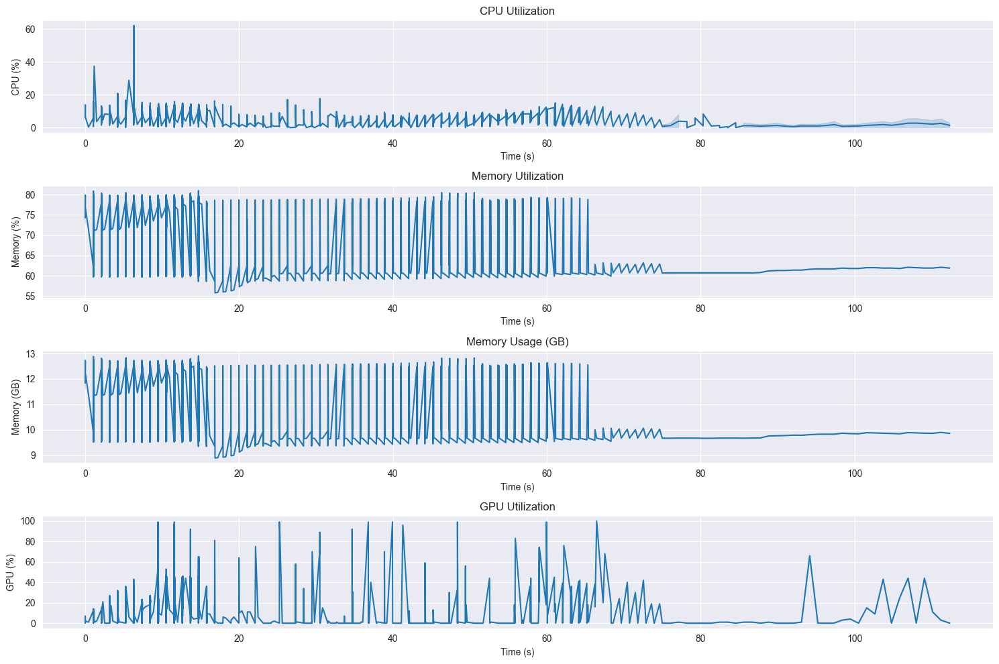



Local epochs:  50%|█████     | 3/6 [01:00<01:00, 20.04s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 7.08
max_cpu_percent: 62.20
avg_memory_gb: 11.54
max_memory_gb: 12.91
avg_memory_percent: 72.47
max_memory_percent: 81.00
avg_gpu_percent: 18.48
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2380.20
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.5954, Val Loss: 1.1329
Accuracy: 0.7984, Val Accuracy: 0.3718

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5906 - accuracy: 0.7960 - precision: 0.7960 - recall: 0.7960 - per_class_f1: 0.7836
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7796  0.7447    0.7617
Class 1     0.4478  0.4958    0.4706

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6137  0.6202    0.6162


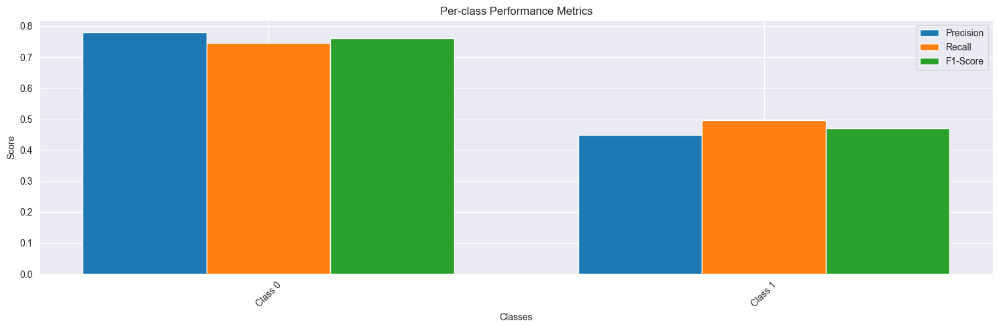


Other metrics:
loss: 0.5906
accuracy: 0.7960
precision: 0.7960
recall: 0.7960
val_loss: 0.8814
val_accuracy: 0.6714
val_precision: 0.6714
val_recall: 0.6714
val_per_class_f1: 0.6162

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.5906 - accuracy: 0.7960 - precision: 0.7960 - recall: 0.7960 - per_class_f1: 0.7836 - val_loss: 0.8814 - val_accuracy: 0.6714 - val_precision: 0.6714 - val_recall: 0.6714 - val_per_class_f1: 0.6162


2024-11-13 14:31:41,741 - INFO - Shuffled data for next epoch


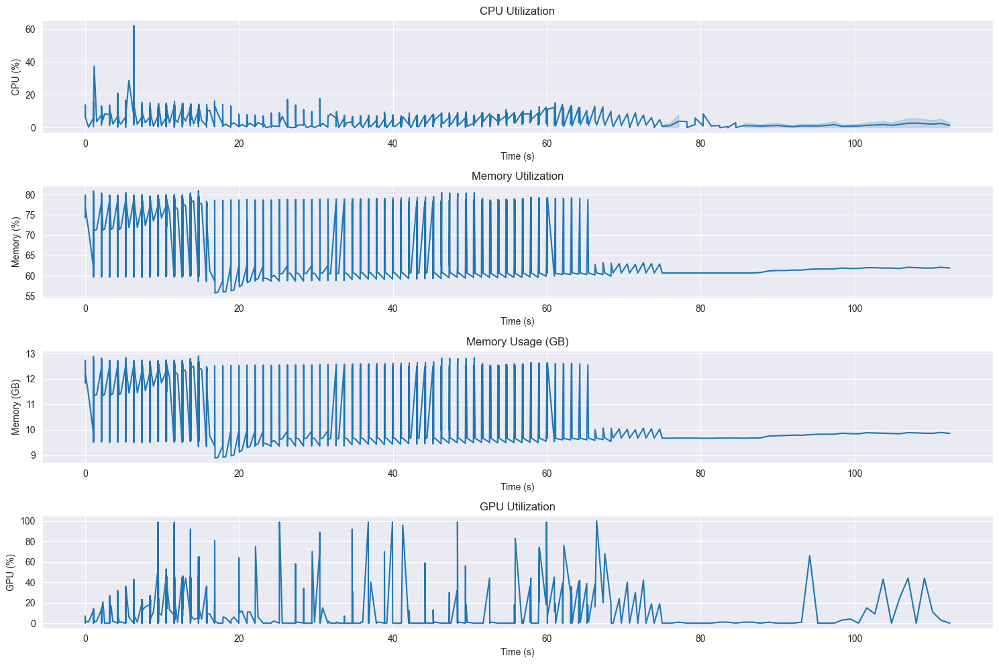

Local epochs:  50%|█████     | 3/6 [01:20<01:20, 26.72s/it]

Training Clients:  20%|██        | 1/5 [01:20<05:20, 80.18s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 7.07
max_cpu_percent: 62.20
avg_memory_gb: 11.55
max_memory_gb: 12.91
avg_memory_percent: 72.51
max_memory_percent: 81.00
avg_gpu_percent: 18.48
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2380.51
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5906, Val Loss: 0.8814
Accuracy: 0.7960, Val Accuracy: 0.6714
Early stopping triggered for client 0

==================== Training Client 2 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6672 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7803
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9326  0.2441    0.3869
Class 1     0.3461  0.9577    0.5084

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6393  0.6009    0.4477


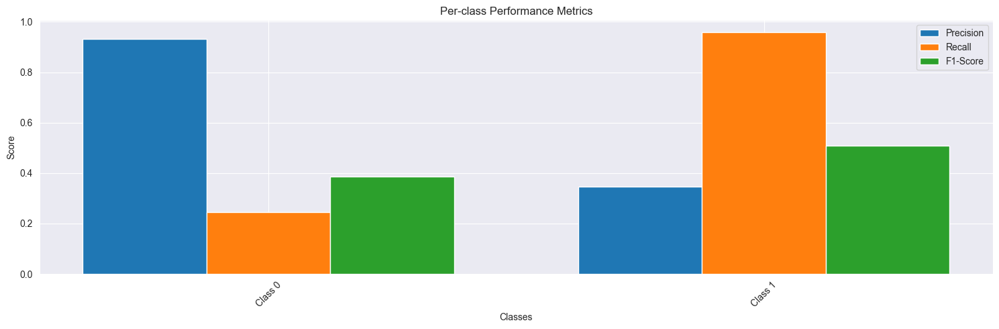


Other metrics:
loss: 0.6672
accuracy: 0.7900
precision: 0.7900
recall: 0.7900
val_loss: 0.9309
val_accuracy: 0.4544
val_precision: 0.4544
val_recall: 0.4544
val_per_class_f1: 0.4477

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6672 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7803 - val_loss: 0.9309 - val_accuracy: 0.4544 - val_precision: 0.4544 - val_recall: 0.4544 - val_per_class_f1: 0.4477


2024-11-13 14:32:01,877 - INFO - Shuffled data for next epoch


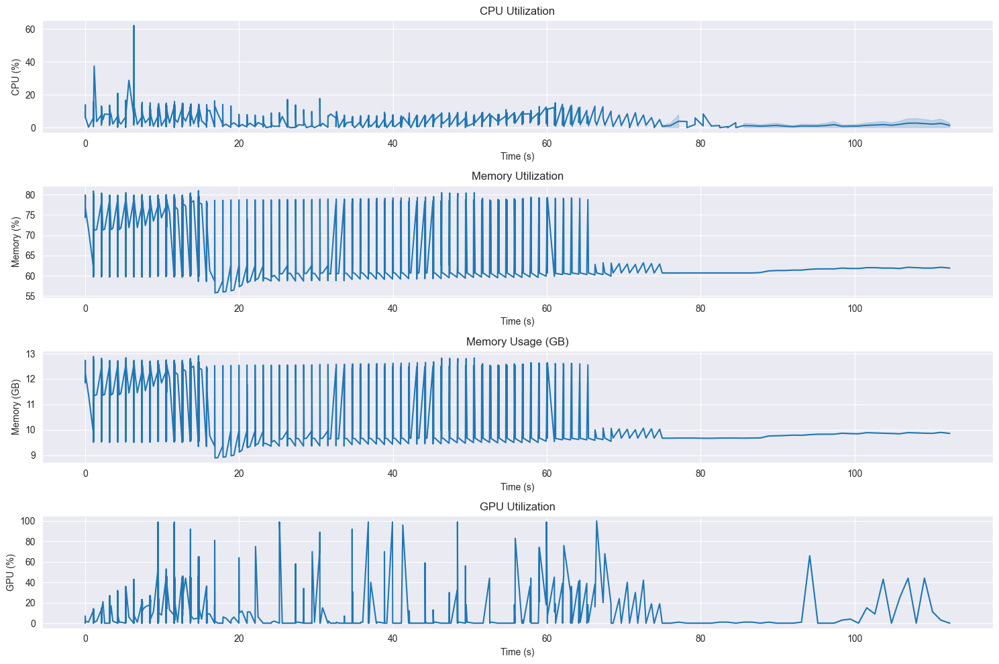



Local epochs:  17%|█▋        | 1/6 [00:20<01:40, 20.10s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 7.06
max_cpu_percent: 62.20
avg_memory_gb: 11.56
max_memory_gb: 12.91
avg_memory_percent: 72.56
max_memory_percent: 81.00
avg_gpu_percent: 18.52
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2380.81
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.6672, Val Loss: 0.9309
Accuracy: 0.7900, Val Accuracy: 0.4544

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6468 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7712
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8705  0.1424    0.2447
Class 1     0.3161  0.9493    0.4743

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5933  0.5458    0.3595


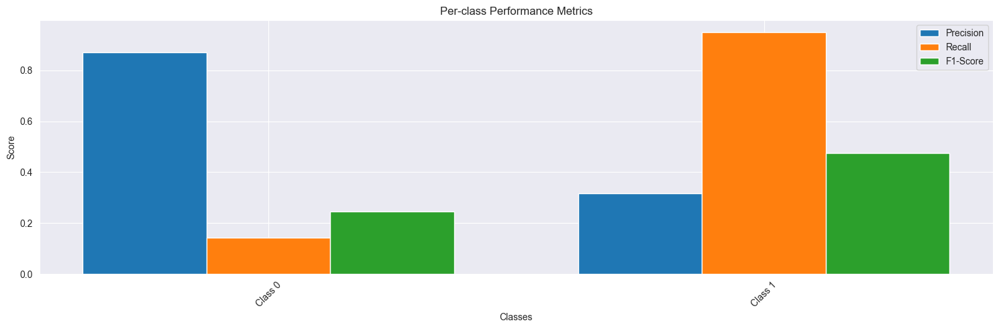


Other metrics:
loss: 0.6468
accuracy: 0.7839
precision: 0.7839
recall: 0.7839
val_loss: 1.0996
val_accuracy: 0.3801
val_precision: 0.3801
val_recall: 0.3801
val_per_class_f1: 0.3595

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6468 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7712 - val_loss: 1.0996 - val_accuracy: 0.3801 - val_precision: 0.3801 - val_recall: 0.3801 - val_per_class_f1: 0.3595


2024-11-13 14:32:21,942 - INFO - Shuffled data for next epoch


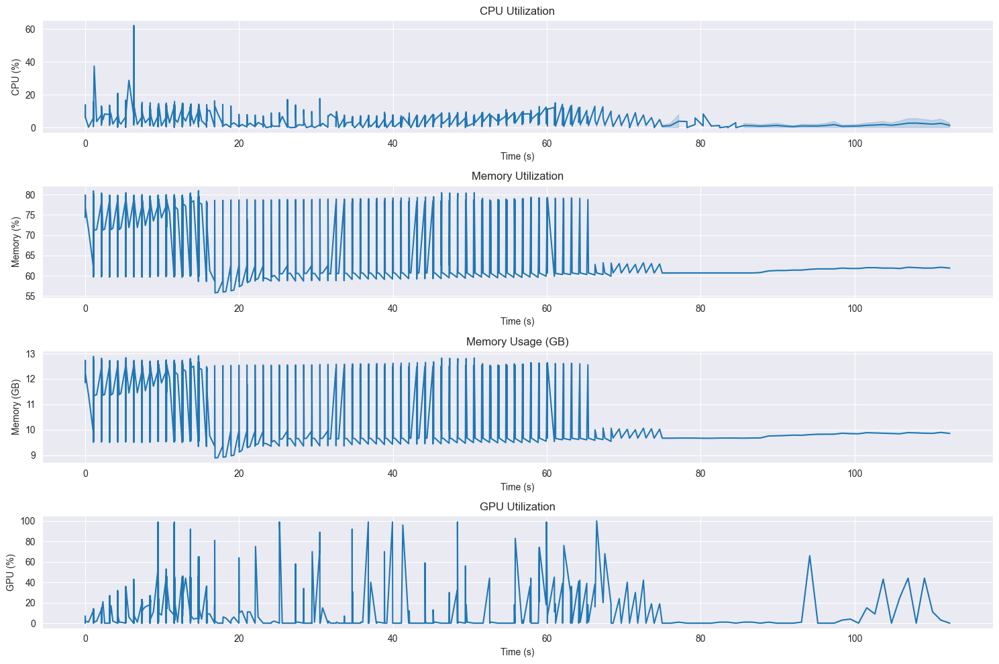



Local epochs:  33%|███▎      | 2/6 [00:40<01:20, 20.12s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 7.05
max_cpu_percent: 62.20
avg_memory_gb: 11.56
max_memory_gb: 12.91
avg_memory_percent: 72.60
max_memory_percent: 81.00
avg_gpu_percent: 18.54
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2381.12
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.6468, Val Loss: 1.0996
Accuracy: 0.7839, Val Accuracy: 0.3801

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6254 - accuracy: 0.7954 - precision: 0.7954 - recall: 0.7954 - per_class_f1: 0.7830
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7813  0.7753    0.7783
Class 1     0.4716  0.4803    0.4759

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6265  0.6278    0.6271


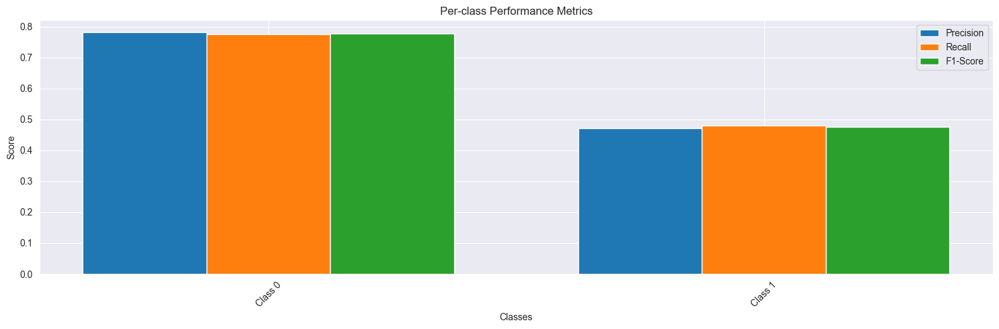


Other metrics:
loss: 0.6254
accuracy: 0.7954
precision: 0.7954
recall: 0.7954
val_loss: 0.7472
val_accuracy: 0.6884
val_precision: 0.6884
val_recall: 0.6884
val_per_class_f1: 0.6271

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.6254 - accuracy: 0.7954 - precision: 0.7954 - recall: 0.7954 - per_class_f1: 0.7830 - val_loss: 0.7472 - val_accuracy: 0.6884 - val_precision: 0.6884 - val_recall: 0.6884 - val_per_class_f1: 0.6271


2024-11-13 14:32:42,130 - INFO - Shuffled data for next epoch


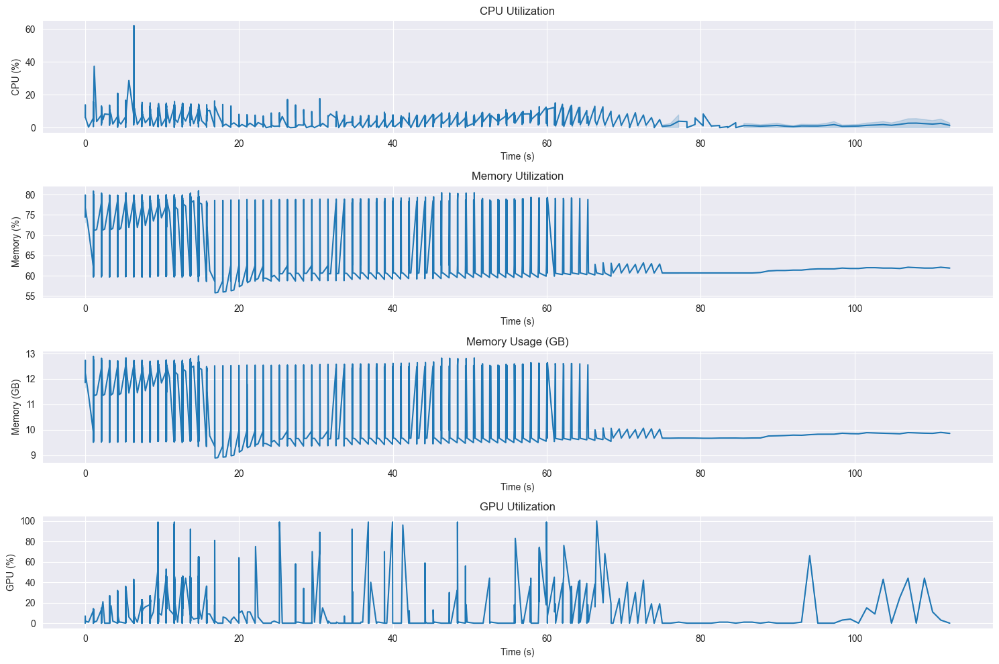



Local epochs:  50%|█████     | 3/6 [01:00<01:00, 20.04s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 7.04
max_cpu_percent: 62.20
avg_memory_gb: 11.57
max_memory_gb: 12.91
avg_memory_percent: 72.64
max_memory_percent: 81.00
avg_gpu_percent: 18.53
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2381.41
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6254, Val Loss: 0.7472
Accuracy: 0.7954, Val Accuracy: 0.6884

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5986 - accuracy: 0.7996 - precision: 0.7996 - recall: 0.7996 - per_class_f1: 0.7887
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8285  0.6988    0.7581
Class 1     0.4754  0.6535    0.5504

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6519  0.6762    0.6543


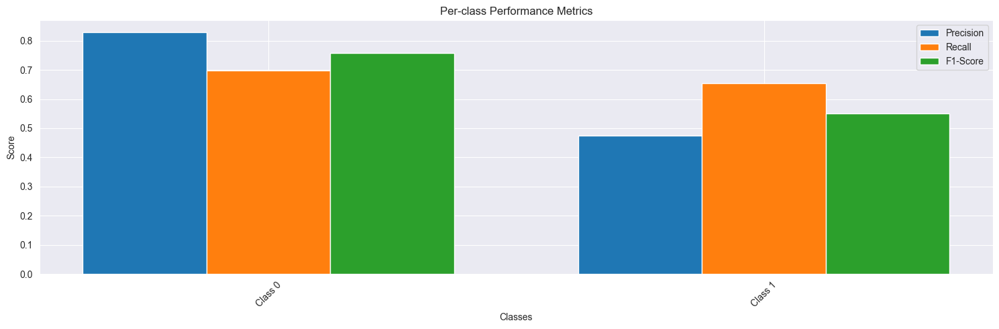


Other metrics:
loss: 0.5986
accuracy: 0.7996
precision: 0.7996
recall: 0.7996
val_loss: 0.7245
val_accuracy: 0.6855
val_precision: 0.6855
val_recall: 0.6855
val_per_class_f1: 0.6543

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.5986 - accuracy: 0.7996 - precision: 0.7996 - recall: 0.7996 - per_class_f1: 0.7887 - val_loss: 0.7245 - val_accuracy: 0.6855 - val_precision: 0.6855 - val_recall: 0.6855 - val_per_class_f1: 0.6543


2024-11-13 14:33:02,101 - INFO - Shuffled data for next epoch


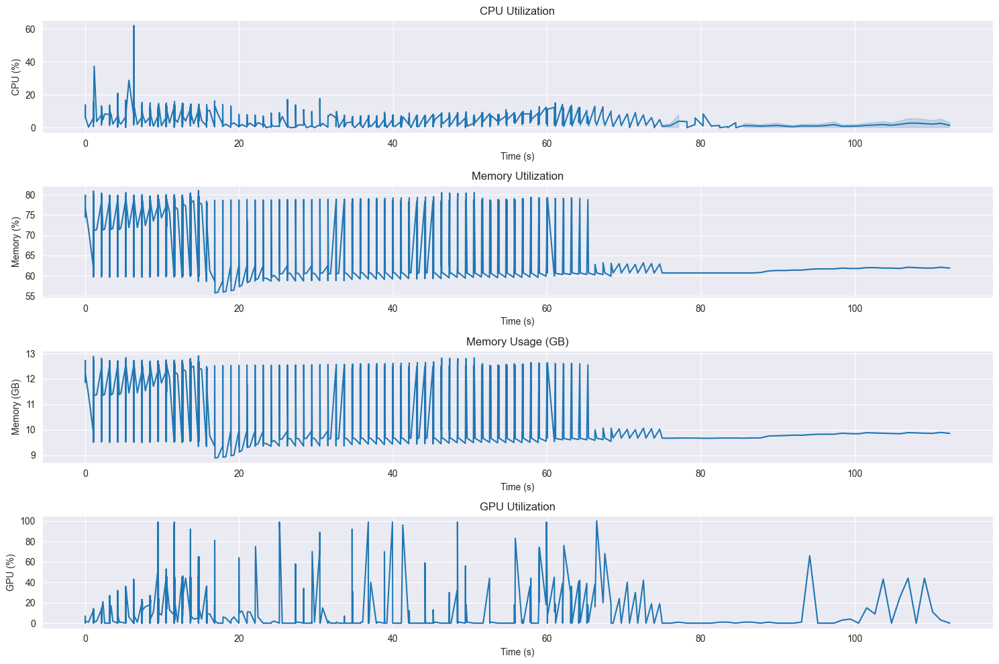



Local epochs:  67%|██████▋   | 4/6 [01:20<00:40, 20.10s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 7.03
max_cpu_percent: 62.20
avg_memory_gb: 11.58
max_memory_gb: 12.91
avg_memory_percent: 72.68
max_memory_percent: 81.00
avg_gpu_percent: 18.53
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2381.70
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5986, Val Loss: 0.7245
Accuracy: 0.7996, Val Accuracy: 0.6855

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5926 - accuracy: 0.8069 - precision: 0.8069 - recall: 0.8069 - per_class_f1: 0.7951
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7751  0.8047    0.7896
Class 1     0.4853  0.4408    0.4620

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6302  0.6228    0.6258


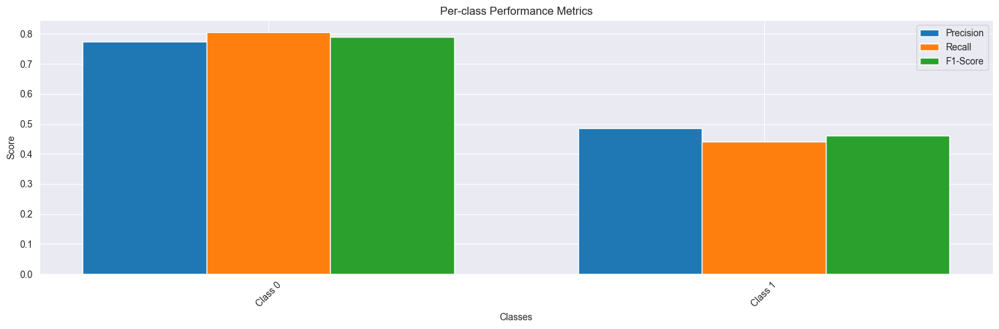


Other metrics:
loss: 0.5926
accuracy: 0.8069
precision: 0.8069
recall: 0.8069
val_loss: 0.6933
val_accuracy: 0.6975
val_precision: 0.6975
val_recall: 0.6975
val_per_class_f1: 0.6258

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.5926 - accuracy: 0.8069 - precision: 0.8069 - recall: 0.8069 - per_class_f1: 0.7951 - val_loss: 0.6933 - val_accuracy: 0.6975 - val_precision: 0.6975 - val_recall: 0.6975 - val_per_class_f1: 0.6258


2024-11-13 14:33:22,236 - INFO - Shuffled data for next epoch


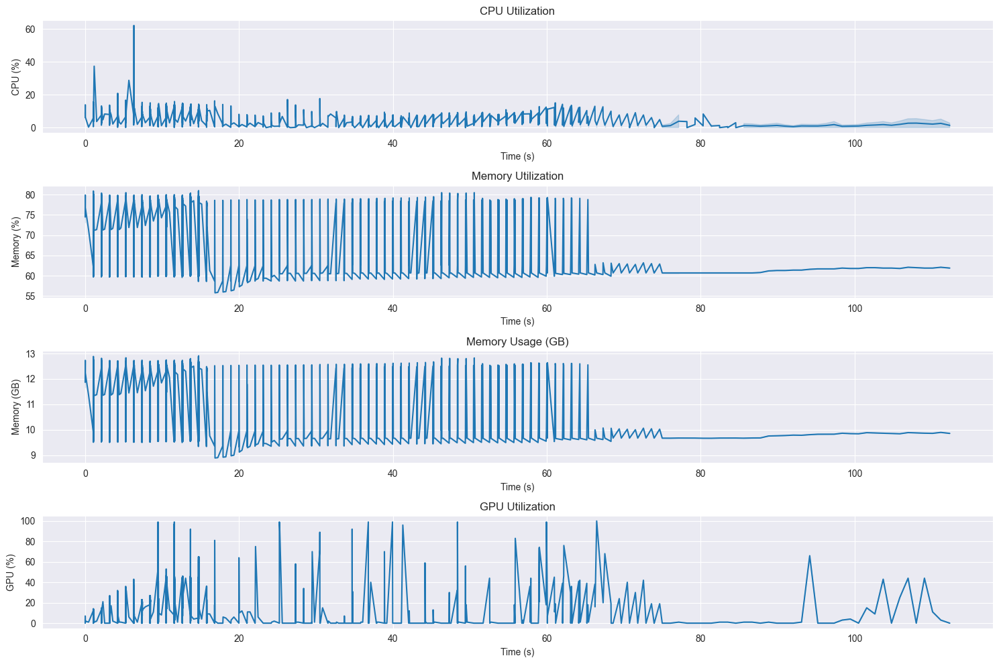



Local epochs:  83%|████████▎ | 5/6 [01:40<00:20, 20.12s/it]


Resource Usage Summary:
duration_seconds: 14.70
avg_cpu_percent: 7.02
max_cpu_percent: 62.20
avg_memory_gb: 11.58
max_memory_gb: 12.91
avg_memory_percent: 72.72
max_memory_percent: 81.00
avg_gpu_percent: 18.58
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2381.99
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.5926, Val Loss: 0.6933
Accuracy: 0.8069, Val Accuracy: 0.6975

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5669 - accuracy: 0.8069 - precision: 0.8069 - recall: 0.8069 - per_class_f1: 0.7957
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8345  0.6912    0.7561
Class 1     0.4760  0.6718    0.5572

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6553  0.6815    0.6567


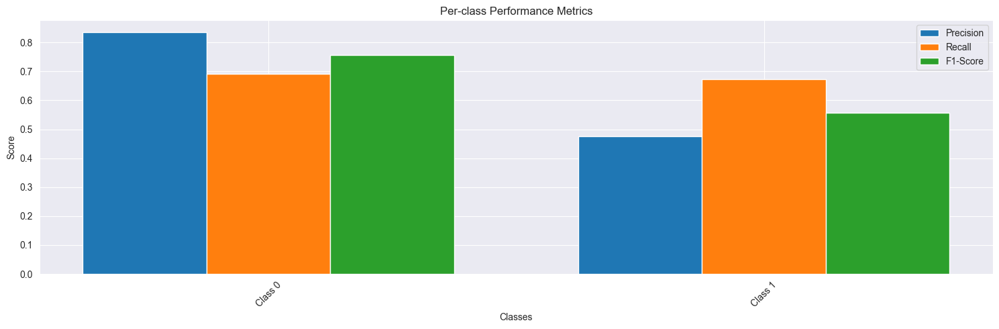


Other metrics:
loss: 0.5669
accuracy: 0.8069
precision: 0.8069
recall: 0.8069
val_loss: 0.6909
val_accuracy: 0.6855
val_precision: 0.6855
val_recall: 0.6855
val_per_class_f1: 0.6567

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 289ms/step - loss: 0.5669 - accuracy: 0.8069 - precision: 0.8069 - recall: 0.8069 - per_class_f1: 0.7957 - val_loss: 0.6909 - val_accuracy: 0.6855 - val_precision: 0.6855 - val_recall: 0.6855 - val_per_class_f1: 0.6567


2024-11-13 14:33:42,294 - INFO - Shuffled data for next epoch


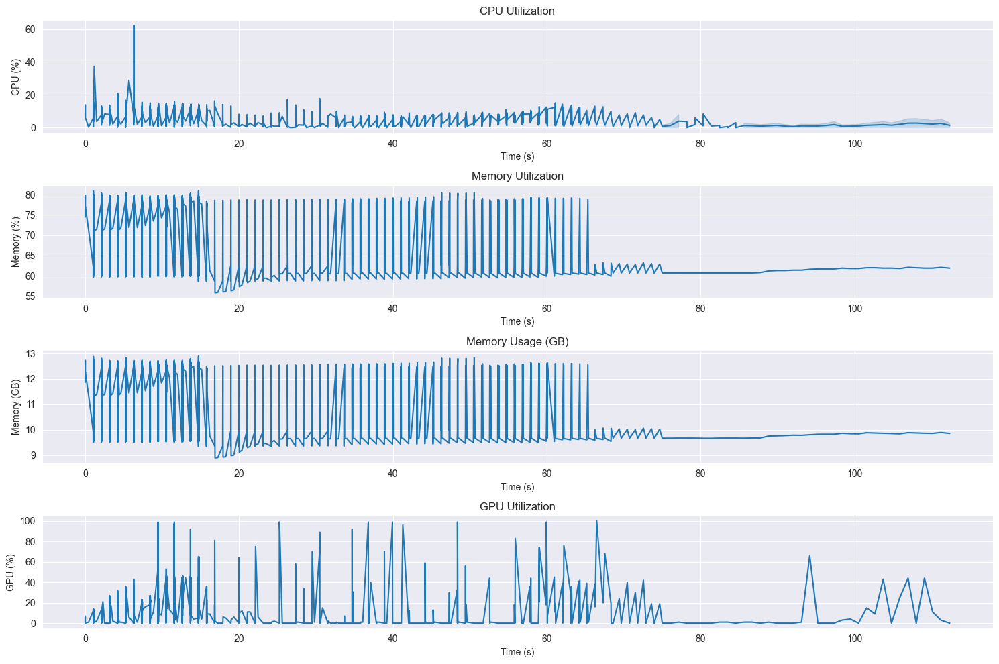



Local epochs: 100%|██████████| 6/6 [02:00<00:00, 20.11s/it]

Training Clients:  40%|████      | 2/5 [03:20<05:12, 104.02s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 7.01
max_cpu_percent: 62.20
avg_memory_gb: 11.59
max_memory_gb: 12.91
avg_memory_percent: 72.76
max_memory_percent: 81.00
avg_gpu_percent: 18.60
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2382.27
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.5669, Val Loss: 0.6909
Accuracy: 0.8069, Val Accuracy: 0.6855

==================== Training Client 3 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6691 - accuracy: 0.7852 - precision: 0.7852 - recall: 0.7852 - per_class_f1: 0.7738
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7048  0.9941    0.8248
Class 1     0.1667  0.0028    0.0055

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4357  0.4985    0.4152


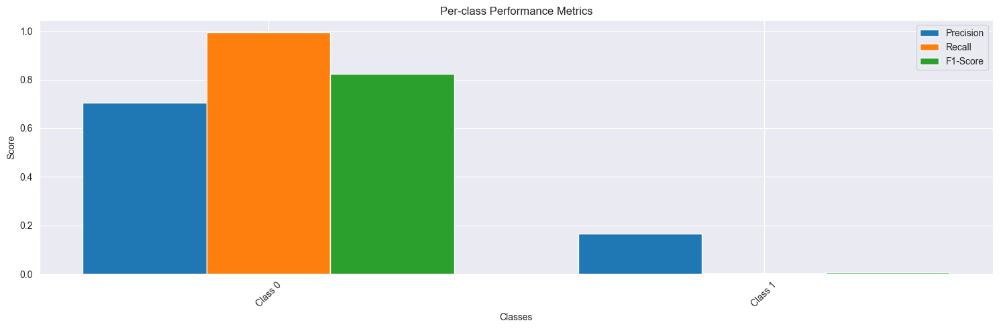


Other metrics:
loss: 0.6691
accuracy: 0.7852
precision: 0.7852
recall: 0.7852
val_loss: 0.7547
val_accuracy: 0.7021
val_precision: 0.7021
val_recall: 0.7021
val_per_class_f1: 0.4152

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 290ms/step - loss: 0.6691 - accuracy: 0.7852 - precision: 0.7852 - recall: 0.7852 - per_class_f1: 0.7738 - val_loss: 0.7547 - val_accuracy: 0.7021 - val_precision: 0.7021 - val_recall: 0.7021 - val_per_class_f1: 0.4152


2024-11-13 14:34:02,515 - INFO - Shuffled data for next epoch


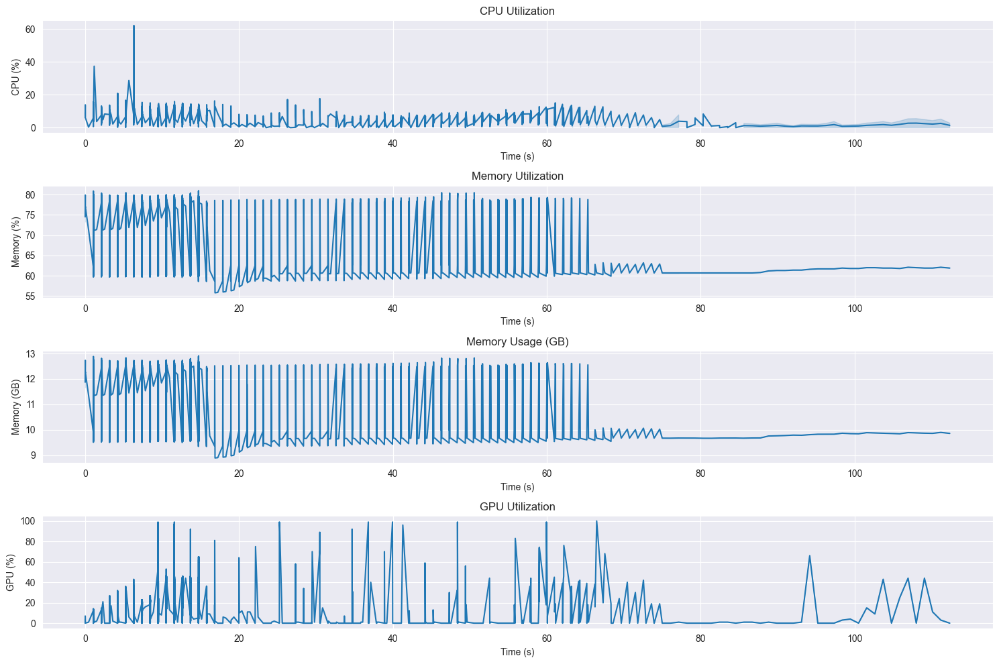



Local epochs:  17%|█▋        | 1/6 [00:20<01:41, 20.21s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 7.00
max_cpu_percent: 62.20
avg_memory_gb: 11.60
max_memory_gb: 12.91
avg_memory_percent: 72.80
max_memory_percent: 81.00
avg_gpu_percent: 18.66
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2382.55
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.6691, Val Loss: 0.7547
Accuracy: 0.7852, Val Accuracy: 0.7021

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6407 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7711
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7057  0.9959    0.8261
Class 1     0.3636  0.0056    0.0111

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5347  0.5008    0.4186


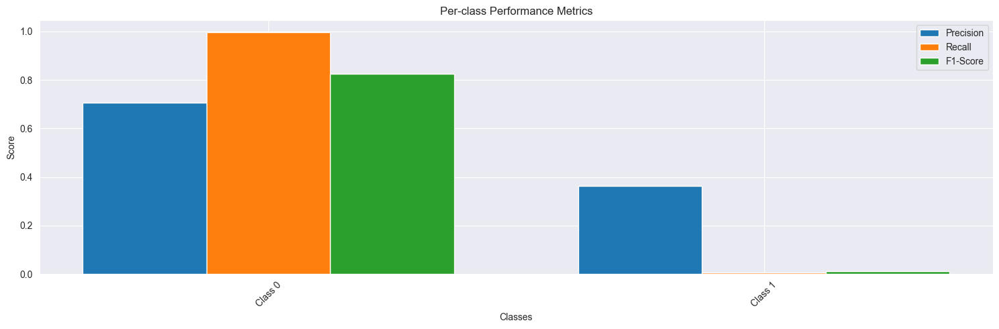


Other metrics:
loss: 0.6407
accuracy: 0.7839
precision: 0.7839
recall: 0.7839
val_loss: 0.7308
val_accuracy: 0.7041
val_precision: 0.7041
val_recall: 0.7041
val_per_class_f1: 0.4186

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.6407 - accuracy: 0.7839 - precision: 0.7839 - recall: 0.7839 - per_class_f1: 0.7711 - val_loss: 0.7308 - val_accuracy: 0.7041 - val_precision: 0.7041 - val_recall: 0.7041 - val_per_class_f1: 0.4186


2024-11-13 14:34:22,804 - INFO - Shuffled data for next epoch


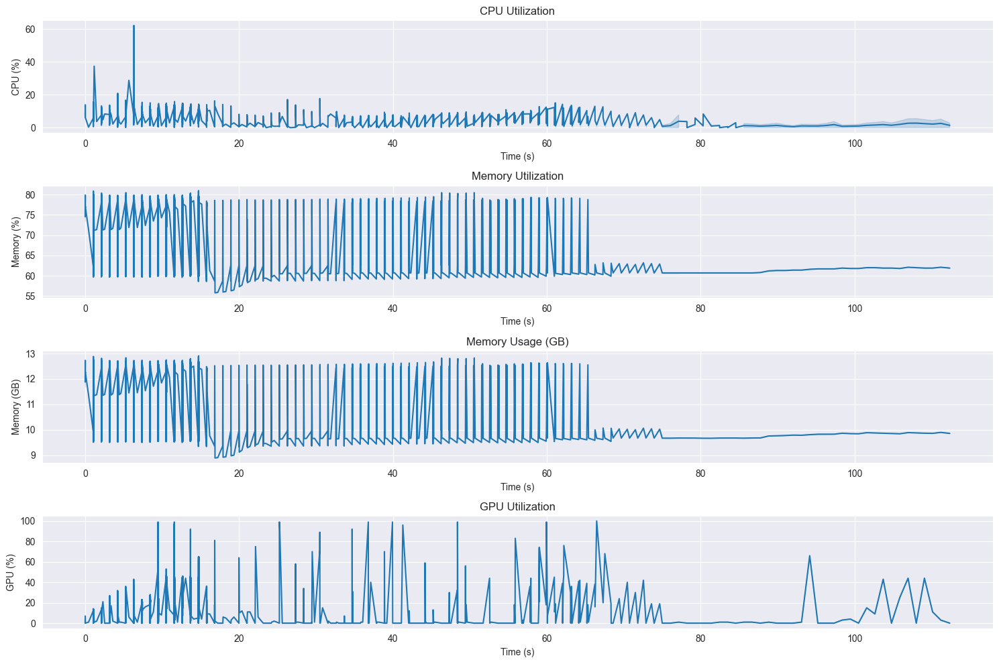



Local epochs:  33%|███▎      | 2/6 [00:40<01:21, 20.25s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 7.00
max_cpu_percent: 62.20
avg_memory_gb: 11.60
max_memory_gb: 12.91
avg_memory_percent: 72.84
max_memory_percent: 81.00
avg_gpu_percent: 18.69
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2382.82
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.6407, Val Loss: 0.7308
Accuracy: 0.7839, Val Accuracy: 0.7041

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6407 - accuracy: 0.7779 - precision: 0.7779 - recall: 0.7779 - per_class_f1: 0.7658
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7433  0.8841    0.8076
Class 1     0.4923  0.2690    0.3479

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6178  0.5766    0.5778


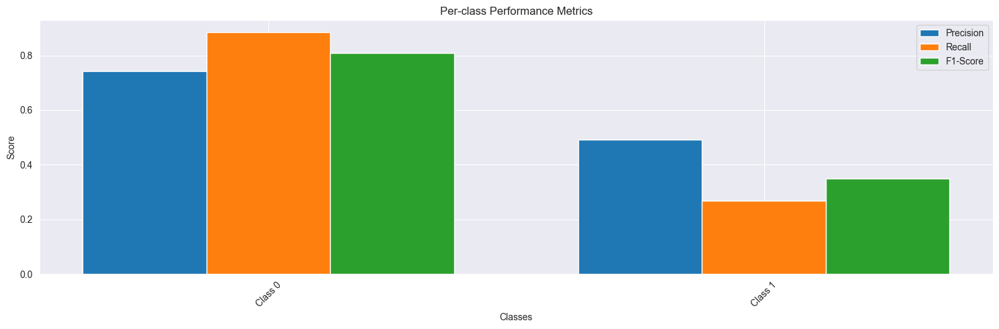


Other metrics:
loss: 0.6407
accuracy: 0.7779
precision: 0.7779
recall: 0.7779
val_loss: 0.7236
val_accuracy: 0.7029
val_precision: 0.7029
val_recall: 0.7029
val_per_class_f1: 0.5778

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.6407 - accuracy: 0.7779 - precision: 0.7779 - recall: 0.7779 - per_class_f1: 0.7658 - val_loss: 0.7236 - val_accuracy: 0.7029 - val_precision: 0.7029 - val_recall: 0.7029 - val_per_class_f1: 0.5778


2024-11-13 14:34:43,176 - INFO - Shuffled data for next epoch


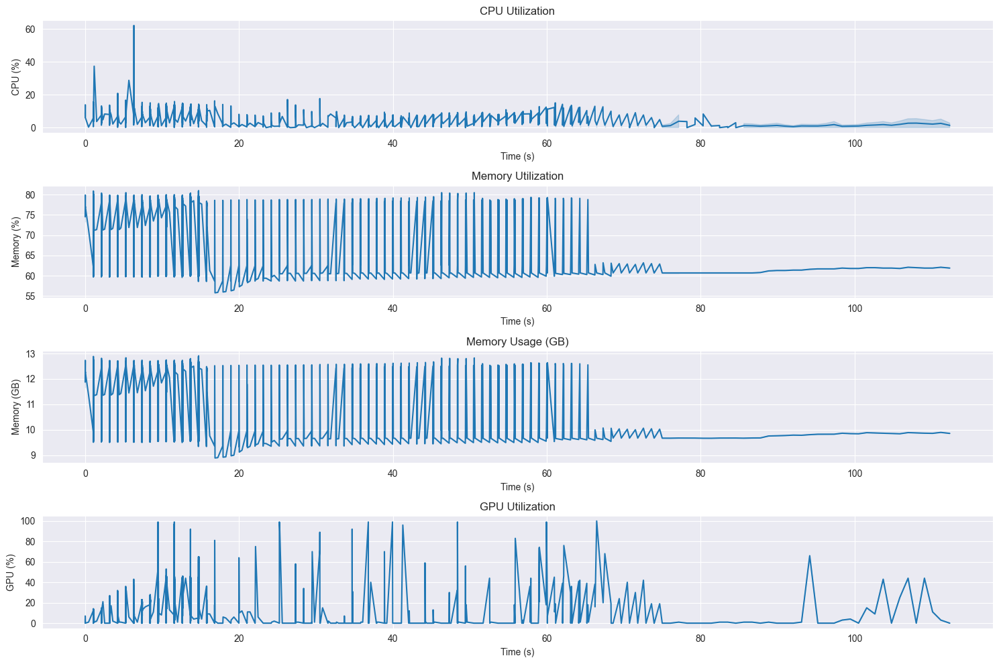



Local epochs:  50%|█████     | 3/6 [01:00<01:00, 20.25s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.99
max_cpu_percent: 62.20
avg_memory_gb: 11.61
max_memory_gb: 12.91
avg_memory_percent: 72.87
max_memory_percent: 81.00
avg_gpu_percent: 18.70
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2383.09
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6407, Val Loss: 0.7236
Accuracy: 0.7779, Val Accuracy: 0.7029

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6071 - accuracy: 0.7960 - precision: 0.7960 - recall: 0.7960 - per_class_f1: 0.7846
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8901  0.2812    0.4274
Class 1     0.3476  0.9169    0.5041

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6189  0.5990    0.4657


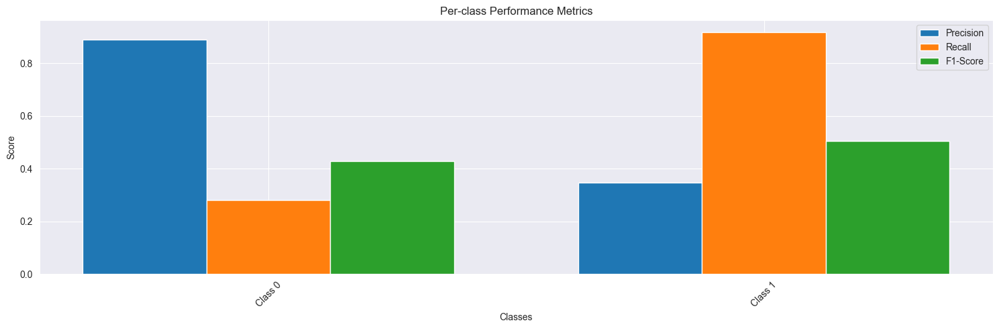


Other metrics:
loss: 0.6071
accuracy: 0.7960
precision: 0.7960
recall: 0.7960
val_loss: 0.9380
val_accuracy: 0.4685
val_precision: 0.4685
val_recall: 0.4685
val_per_class_f1: 0.4657

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.6071 - accuracy: 0.7960 - precision: 0.7960 - recall: 0.7960 - per_class_f1: 0.7846 - val_loss: 0.9380 - val_accuracy: 0.4685 - val_precision: 0.4685 - val_recall: 0.4685 - val_per_class_f1: 0.4657


2024-11-13 14:35:03,341 - INFO - Shuffled data for next epoch


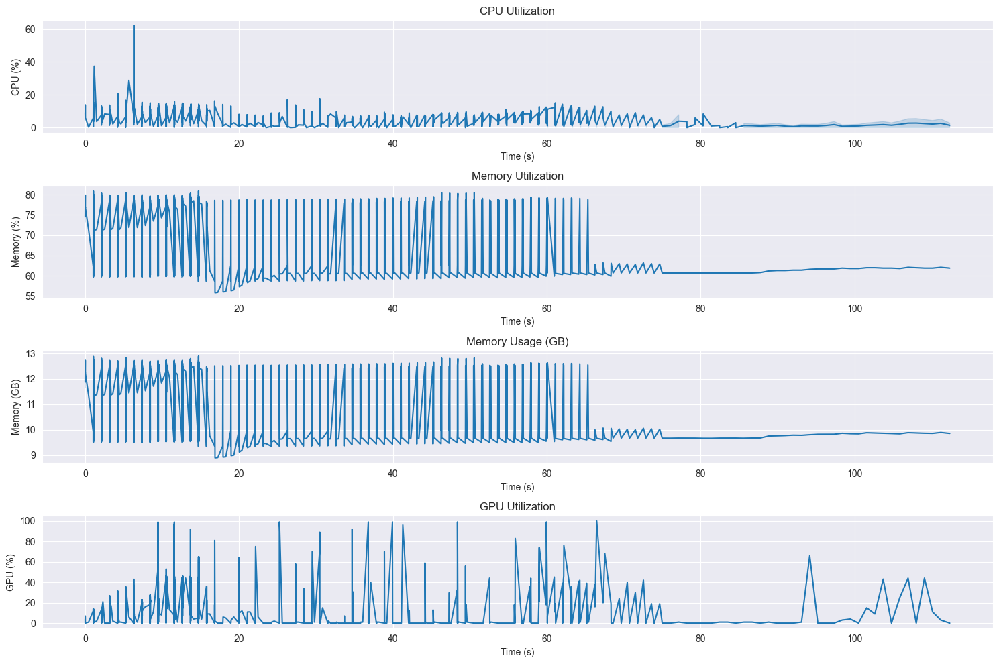



Local epochs:  67%|██████▋   | 4/6 [01:20<00:40, 20.15s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.98
max_cpu_percent: 62.20
avg_memory_gb: 11.61
max_memory_gb: 12.91
avg_memory_percent: 72.91
max_memory_percent: 81.00
avg_gpu_percent: 18.73
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2383.35
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.6071, Val Loss: 0.9380
Accuracy: 0.7960, Val Accuracy: 0.4685

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5946 - accuracy: 0.8033 - precision: 0.8033 - recall: 0.8033 - per_class_f1: 0.7947
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7041  0.9629    0.8134
Class 1     0.2588  0.0310    0.0553

Averages:
  Class  Precision  Recall  F1-Score
Average     0.4815  0.4970    0.4344


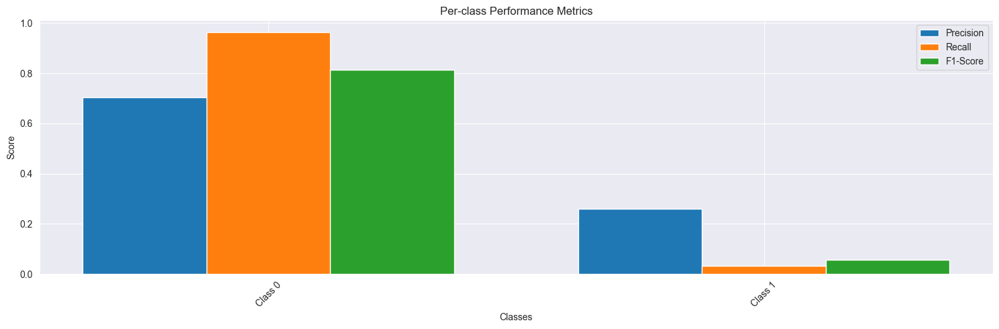


Other metrics:
loss: 0.5946
accuracy: 0.8033
precision: 0.8033
recall: 0.8033
val_loss: 0.7099
val_accuracy: 0.6884
val_precision: 0.6884
val_recall: 0.6884
val_per_class_f1: 0.4344

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.5946 - accuracy: 0.8033 - precision: 0.8033 - recall: 0.8033 - per_class_f1: 0.7947 - val_loss: 0.7099 - val_accuracy: 0.6884 - val_precision: 0.6884 - val_recall: 0.6884 - val_per_class_f1: 0.4344


2024-11-13 14:35:23,351 - INFO - Shuffled data for next epoch


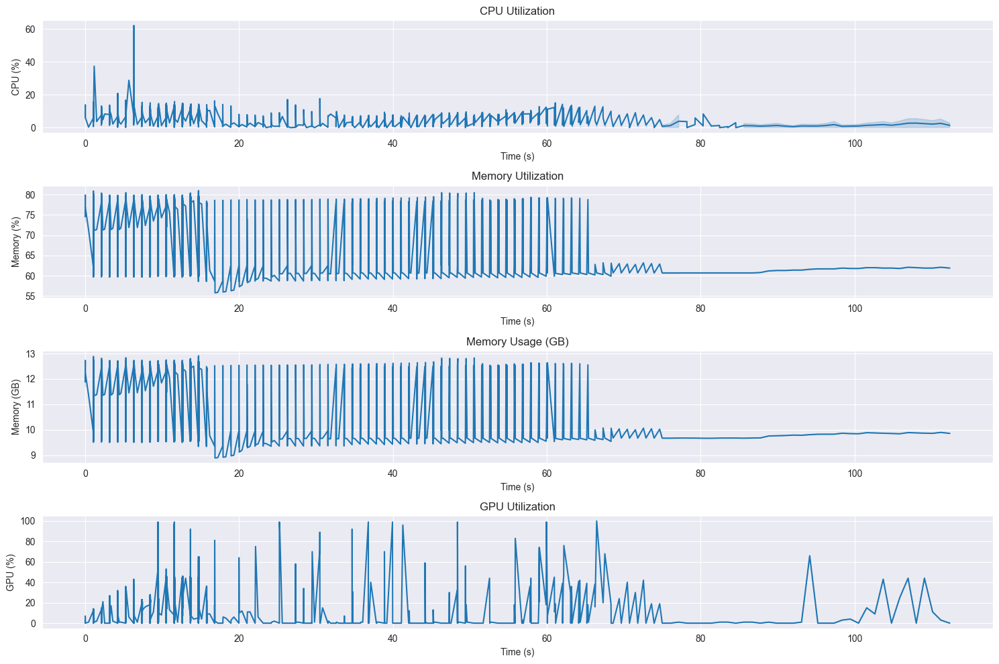



Local epochs:  83%|████████▎ | 5/6 [01:40<00:20, 20.19s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.97
max_cpu_percent: 62.20
avg_memory_gb: 11.62
max_memory_gb: 12.91
avg_memory_percent: 72.94
max_memory_percent: 81.00
avg_gpu_percent: 18.77
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2383.61
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.5946, Val Loss: 0.7099
Accuracy: 0.8033, Val Accuracy: 0.6884

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5720 - accuracy: 0.7966 - precision: 0.7966 - recall: 0.7966 - per_class_f1: 0.7865
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7683  0.7841    0.7761
Class 1     0.4563  0.4338    0.4448

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6123  0.6090    0.6104


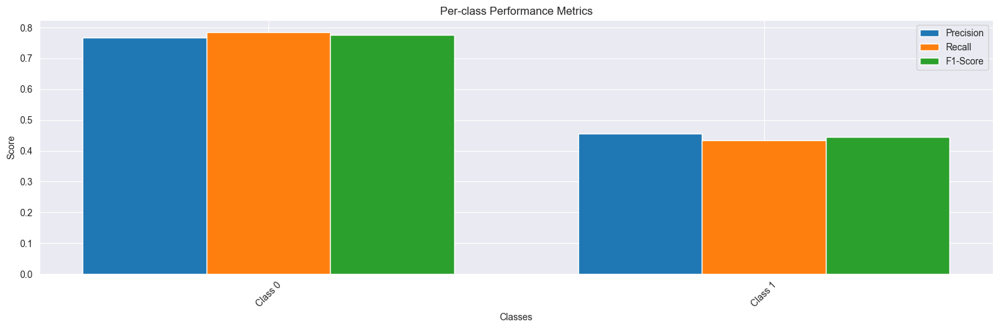


Other metrics:
loss: 0.5720
accuracy: 0.7966
precision: 0.7966
recall: 0.7966
val_loss: 0.7084
val_accuracy: 0.6809
val_precision: 0.6809
val_recall: 0.6809
val_per_class_f1: 0.6104

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.5720 - accuracy: 0.7966 - precision: 0.7966 - recall: 0.7966 - per_class_f1: 0.7865 - val_loss: 0.7084 - val_accuracy: 0.6809 - val_precision: 0.6809 - val_recall: 0.6809 - val_per_class_f1: 0.6104


2024-11-13 14:35:43,608 - INFO - Shuffled data for next epoch


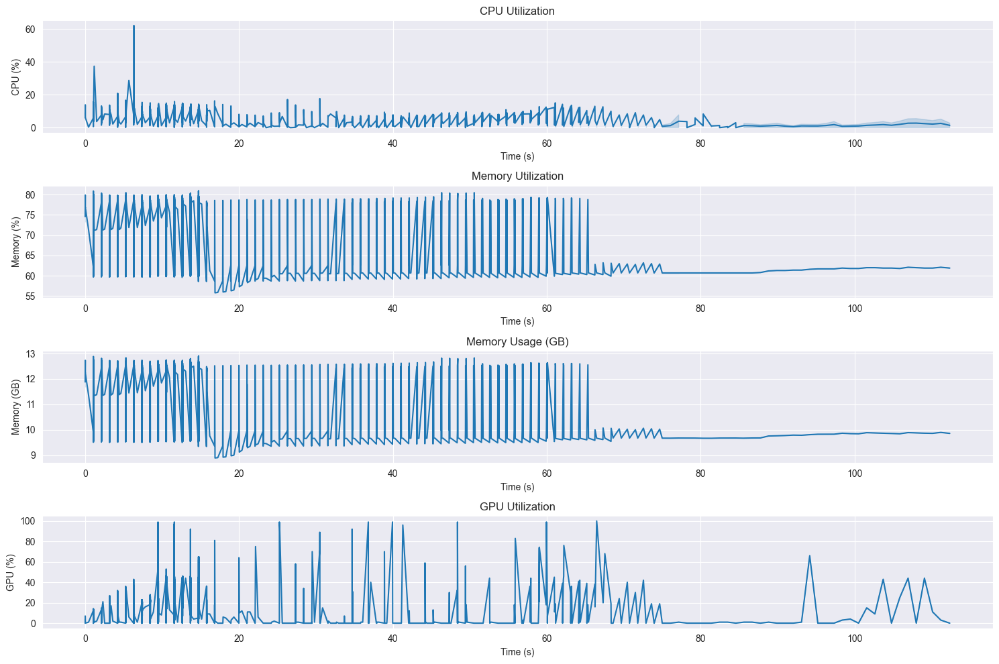



Local epochs: 100%|██████████| 6/6 [02:01<00:00, 20.21s/it]

Training Clients:  60%|██████    | 3/5 [05:22<03:43, 111.90s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.96
max_cpu_percent: 62.20
avg_memory_gb: 11.62
max_memory_gb: 12.91
avg_memory_percent: 72.98
max_memory_percent: 81.00
avg_gpu_percent: 18.82
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2383.86
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.5720, Val Loss: 0.7084
Accuracy: 0.7966, Val Accuracy: 0.6809

==================== Training Client 4 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6435 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7806
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8242  0.5847    0.6841
Class 1     0.4136  0.7014    0.5204

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6189  0.6431    0.6022


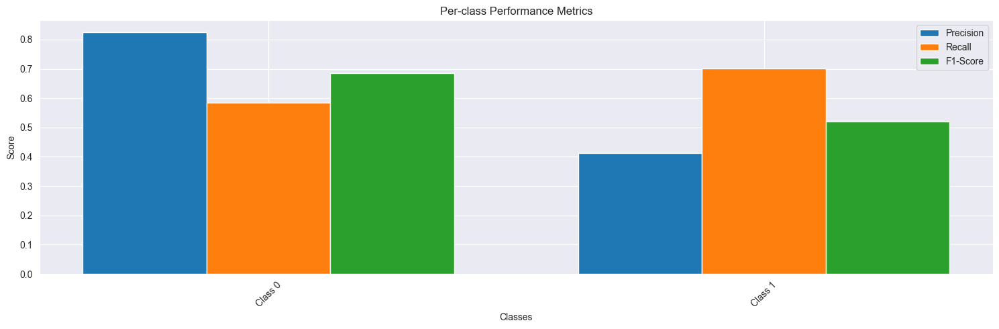


Other metrics:
loss: 0.6435
accuracy: 0.7900
precision: 0.7900
recall: 0.7900
val_loss: 0.8229
val_accuracy: 0.6191
val_precision: 0.6191
val_recall: 0.6191
val_per_class_f1: 0.6022

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.6435 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7806 - val_loss: 0.8229 - val_accuracy: 0.6191 - val_precision: 0.6191 - val_recall: 0.6191 - val_per_class_f1: 0.6022


2024-11-13 14:36:03,954 - INFO - Shuffled data for next epoch


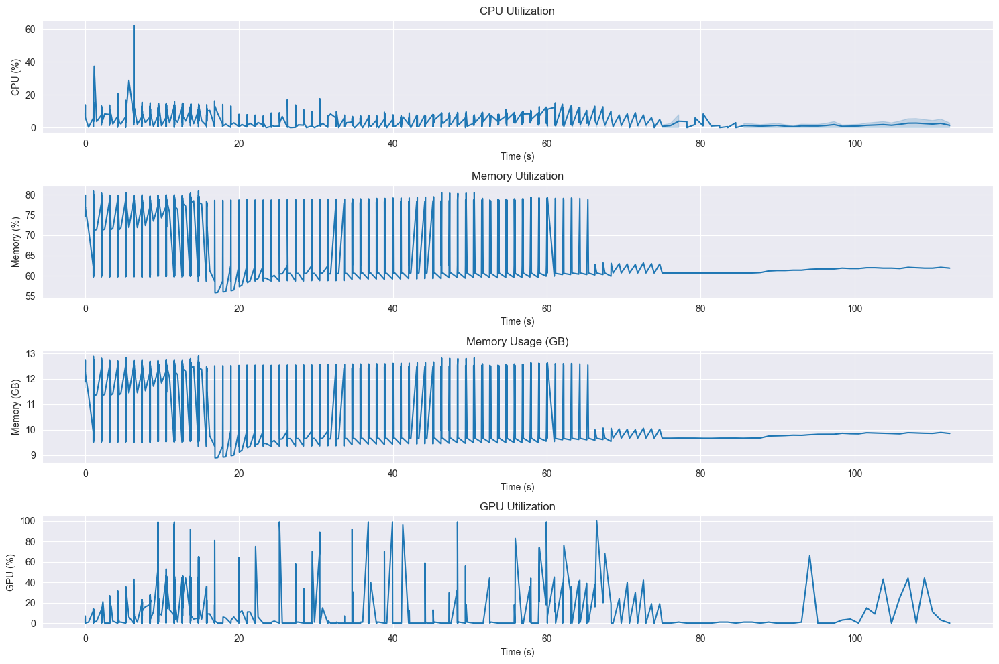



Local epochs:  17%|█▋        | 1/6 [00:20<01:41, 20.28s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.95
max_cpu_percent: 62.20
avg_memory_gb: 11.63
max_memory_gb: 12.91
avg_memory_percent: 73.01
max_memory_percent: 81.00
avg_gpu_percent: 18.87
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2384.11
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.6435, Val Loss: 0.8229
Accuracy: 0.7900, Val Accuracy: 0.6191

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6260 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7801
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8346  0.6024    0.6997
Class 1     0.4286  0.7141    0.5357

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6316  0.6582    0.6177


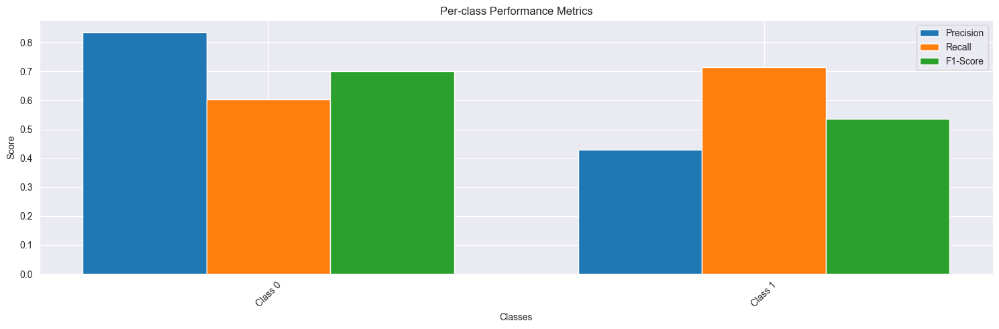


Other metrics:
loss: 0.6260
accuracy: 0.7900
precision: 0.7900
recall: 0.7900
val_loss: 0.7840
val_accuracy: 0.6353
val_precision: 0.6353
val_recall: 0.6353
val_per_class_f1: 0.6177

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 294ms/step - loss: 0.6260 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7801 - val_loss: 0.7840 - val_accuracy: 0.6353 - val_precision: 0.6353 - val_recall: 0.6353 - val_per_class_f1: 0.6177


2024-11-13 14:36:24,286 - INFO - Shuffled data for next epoch


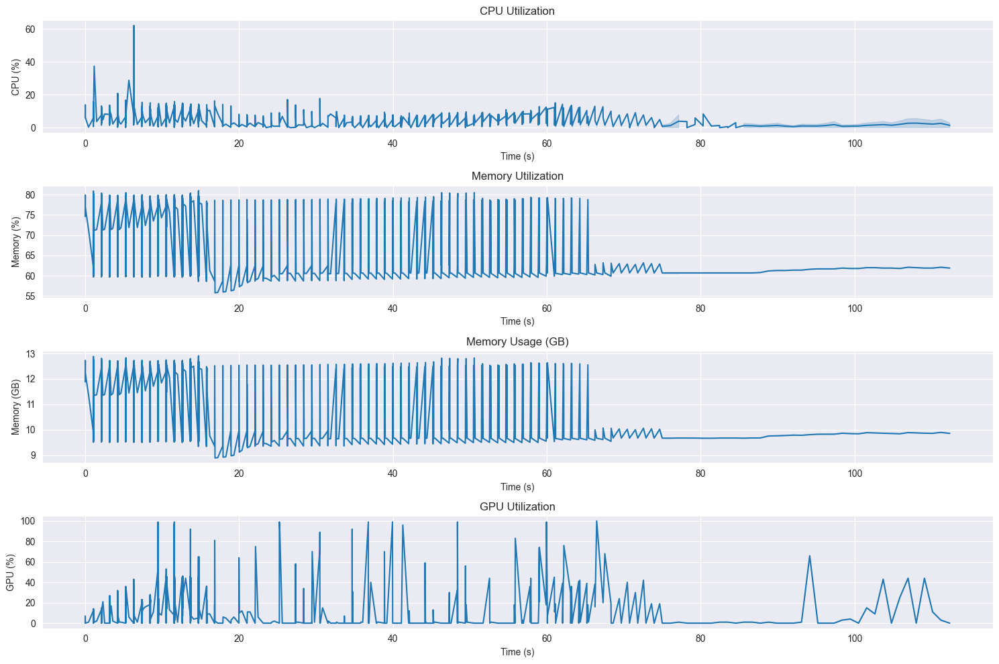



Local epochs:  33%|███▎      | 2/6 [00:40<01:21, 20.27s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 6.94
max_cpu_percent: 62.20
avg_memory_gb: 11.63
max_memory_gb: 12.91
avg_memory_percent: 73.04
max_memory_percent: 81.00
avg_gpu_percent: 18.91
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2384.36
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.6260, Val Loss: 0.7840
Accuracy: 0.7900, Val Accuracy: 0.6353

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6132 - accuracy: 0.7924 - precision: 0.7924 - recall: 0.7924 - per_class_f1: 0.7846
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7064  0.9665    0.8162
Class 1     0.3214  0.0380    0.0680

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5139  0.5022    0.4421


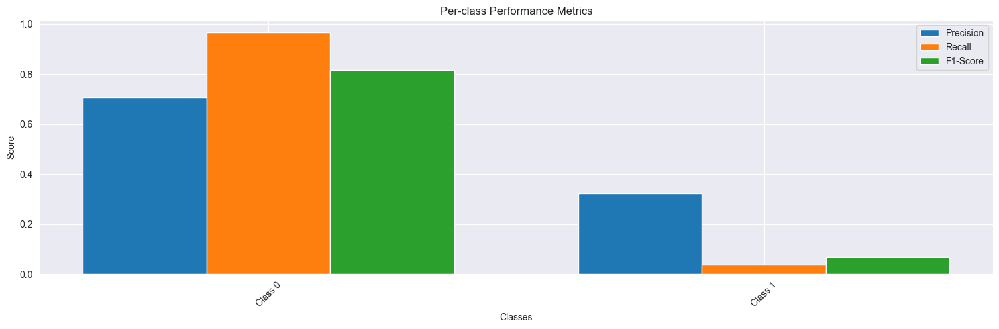


Other metrics:
loss: 0.6132
accuracy: 0.7924
precision: 0.7924
recall: 0.7924
val_loss: 0.8050
val_accuracy: 0.6929
val_precision: 0.6929
val_recall: 0.6929
val_per_class_f1: 0.4421

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.6132 - accuracy: 0.7924 - precision: 0.7924 - recall: 0.7924 - per_class_f1: 0.7846 - val_loss: 0.8050 - val_accuracy: 0.6929 - val_precision: 0.6929 - val_recall: 0.6929 - val_per_class_f1: 0.4421


2024-11-13 14:36:44,490 - INFO - Shuffled data for next epoch


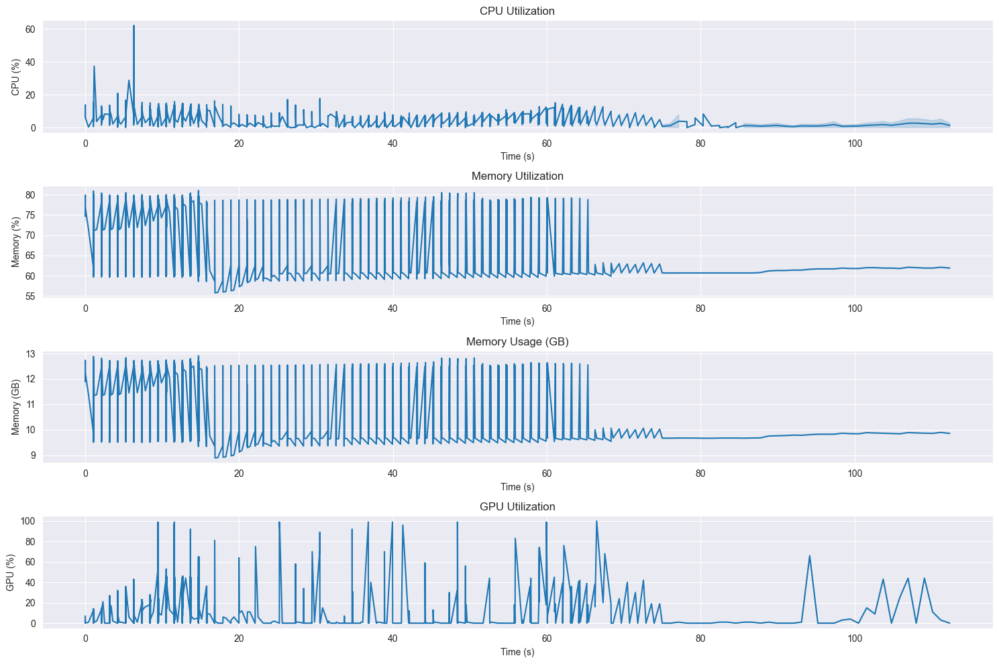



Local epochs:  50%|█████     | 3/6 [01:00<01:00, 20.29s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.94
max_cpu_percent: 62.20
avg_memory_gb: 11.64
max_memory_gb: 12.91
avg_memory_percent: 73.08
max_memory_percent: 81.00
avg_gpu_percent: 18.89
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2384.60
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6132, Val Loss: 0.8050
Accuracy: 0.7924, Val Accuracy: 0.6929

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5872 - accuracy: 0.7984 - precision: 0.7984 - recall: 0.7984 - per_class_f1: 0.7899
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7471  0.8582    0.7988
Class 1     0.4726  0.3042    0.3702

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6099  0.5812    0.5845


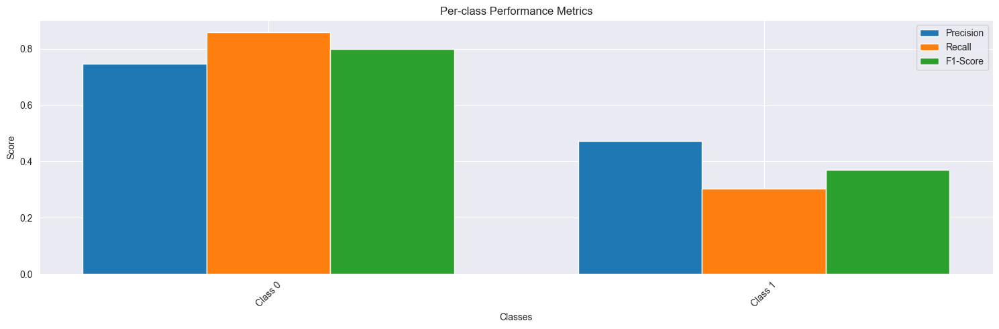


Other metrics:
loss: 0.5872
accuracy: 0.7984
precision: 0.7984
recall: 0.7984
val_loss: 0.7673
val_accuracy: 0.6950
val_precision: 0.6950
val_recall: 0.6950
val_per_class_f1: 0.5845

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 291ms/step - loss: 0.5872 - accuracy: 0.7984 - precision: 0.7984 - recall: 0.7984 - per_class_f1: 0.7899 - val_loss: 0.7673 - val_accuracy: 0.6950 - val_precision: 0.6950 - val_recall: 0.6950 - val_per_class_f1: 0.5845


2024-11-13 14:37:04,751 - INFO - Shuffled data for next epoch


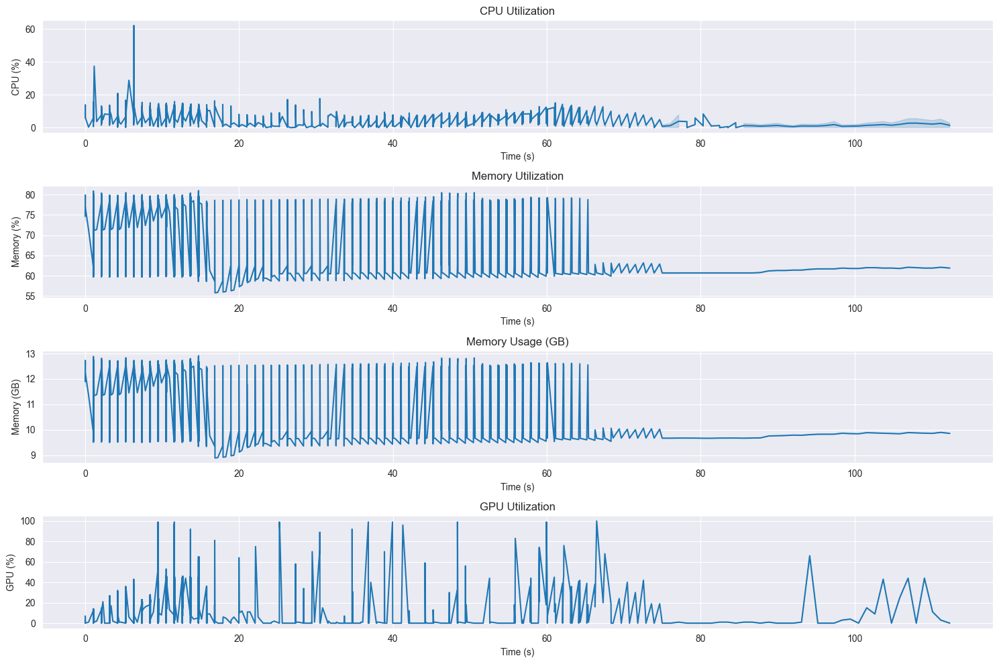



Local epochs:  67%|██████▋   | 4/6 [01:21<00:40, 20.30s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.93
max_cpu_percent: 62.20
avg_memory_gb: 11.64
max_memory_gb: 12.91
avg_memory_percent: 73.11
max_memory_percent: 81.00
avg_gpu_percent: 18.91
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2384.84
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5872, Val Loss: 0.7673
Accuracy: 0.7984, Val Accuracy: 0.6950

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5637 - accuracy: 0.8105 - precision: 0.8105 - recall: 0.8105 - per_class_f1: 0.8004
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8288  0.5241    0.6422
Class 1     0.3940  0.7408    0.5144

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6114  0.6325    0.5783


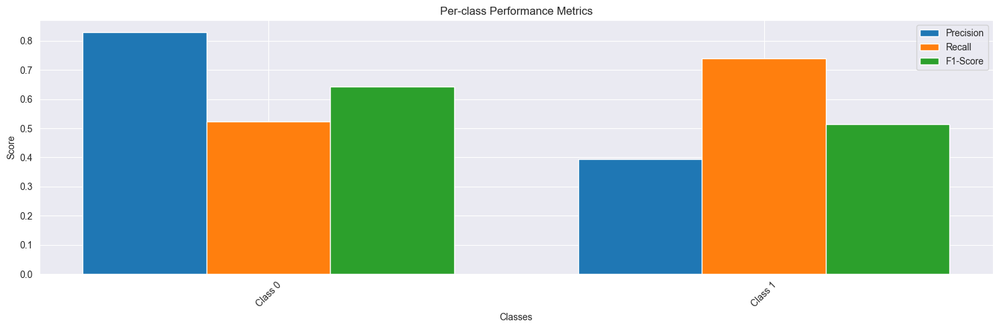


Other metrics:
loss: 0.5637
accuracy: 0.8105
precision: 0.8105
recall: 0.8105
val_loss: 0.8072
val_accuracy: 0.5880
val_precision: 0.5880
val_recall: 0.5880
val_per_class_f1: 0.5783

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 293ms/step - loss: 0.5637 - accuracy: 0.8105 - precision: 0.8105 - recall: 0.8105 - per_class_f1: 0.8004 - val_loss: 0.8072 - val_accuracy: 0.5880 - val_precision: 0.5880 - val_recall: 0.5880 - val_per_class_f1: 0.5783


2024-11-13 14:37:25,145 - INFO - Shuffled data for next epoch


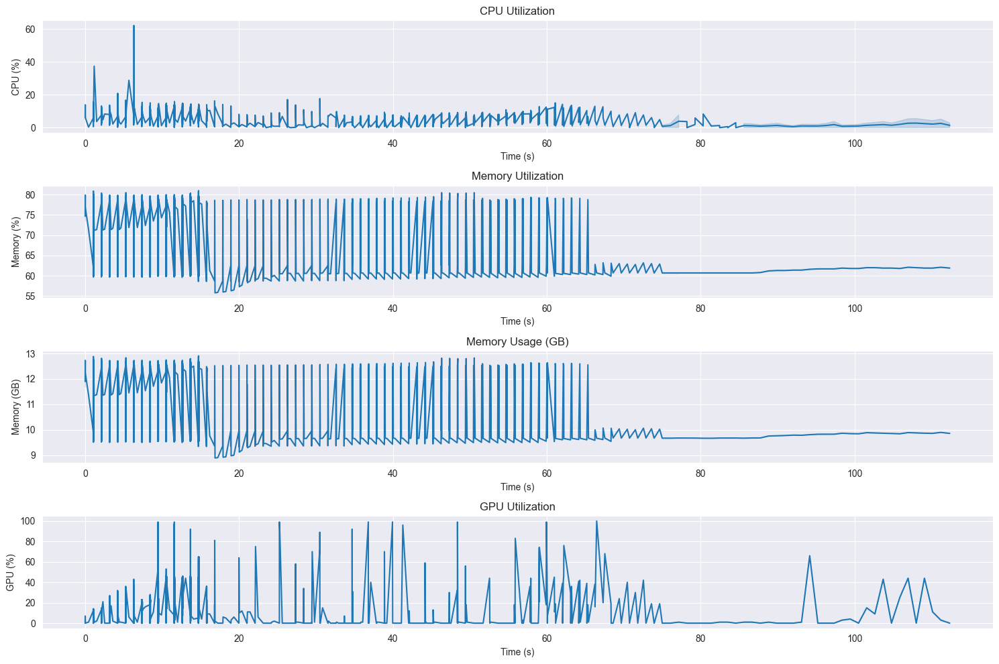



Local epochs:  83%|████████▎ | 5/6 [01:41<00:20, 20.29s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.92
max_cpu_percent: 62.20
avg_memory_gb: 11.65
max_memory_gb: 12.91
avg_memory_percent: 73.14
max_memory_percent: 81.00
avg_gpu_percent: 18.94
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2385.07
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.5637, Val Loss: 0.8072
Accuracy: 0.8105, Val Accuracy: 0.5880

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5344 - accuracy: 0.8262 - precision: 0.8262 - recall: 0.8262 - per_class_f1: 0.8187
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7869  0.7712    0.7790
Class 1     0.4772  0.5000    0.4883

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6320  0.6356    0.6336


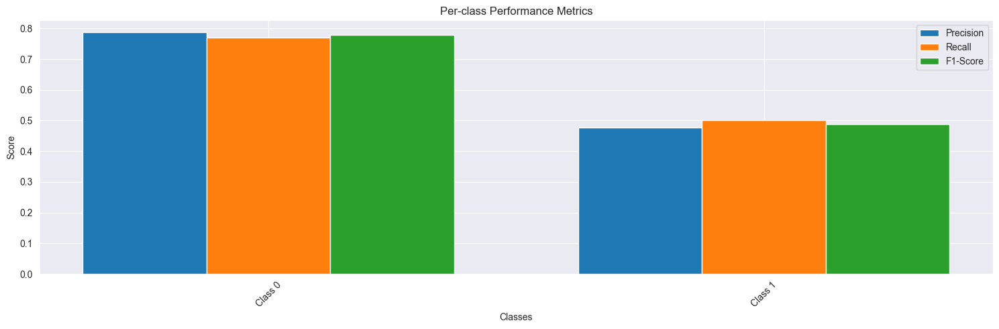


Other metrics:
loss: 0.5344
accuracy: 0.8262
precision: 0.8262
recall: 0.8262
val_loss: 0.7097
val_accuracy: 0.6913
val_precision: 0.6913
val_recall: 0.6913
val_per_class_f1: 0.6336

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.5344 - accuracy: 0.8262 - precision: 0.8262 - recall: 0.8262 - per_class_f1: 0.8187 - val_loss: 0.7097 - val_accuracy: 0.6913 - val_precision: 0.6913 - val_recall: 0.6913 - val_per_class_f1: 0.6336


2024-11-13 14:37:45,349 - INFO - Shuffled data for next epoch


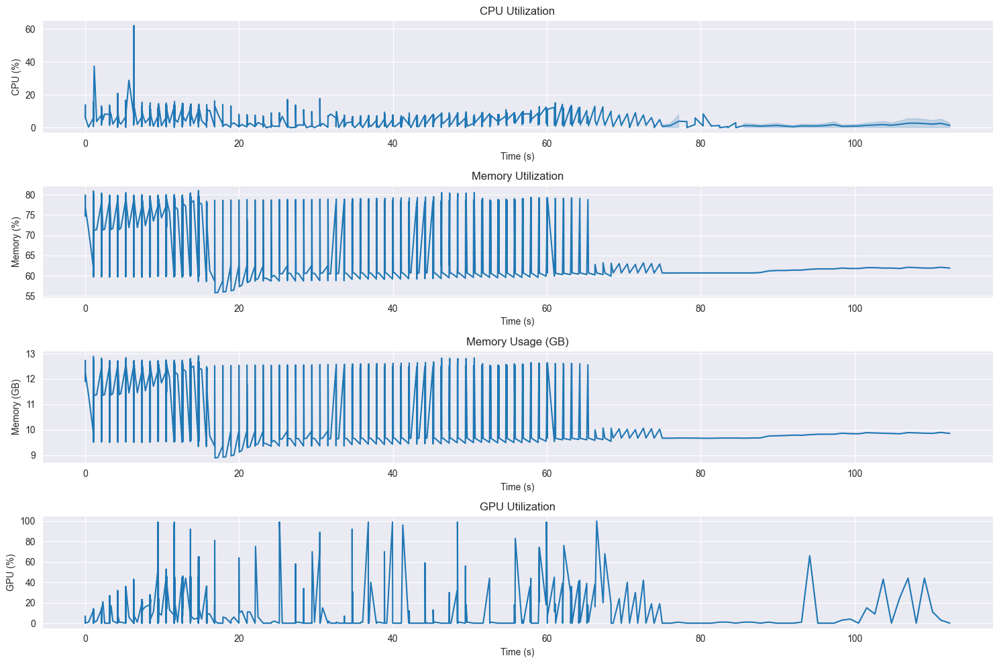



Local epochs: 100%|██████████| 6/6 [02:01<00:00, 20.29s/it]

Training Clients:  80%|████████  | 4/5 [07:23<01:55, 115.80s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 6.91
max_cpu_percent: 62.20
avg_memory_gb: 11.66
max_memory_gb: 12.91
avg_memory_percent: 73.17
max_memory_percent: 81.00
avg_gpu_percent: 18.98
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2385.31
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.5344, Val Loss: 0.7097
Accuracy: 0.8262, Val Accuracy: 0.6913

==================== Training Client 5 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6567 - accuracy: 0.7831 - precision: 0.7831 - recall: 0.7831 - per_class_f1: 0.7714
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8920  0.3594    0.5124
Class 1     0.3687  0.8958    0.5224

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6303  0.6276    0.5174


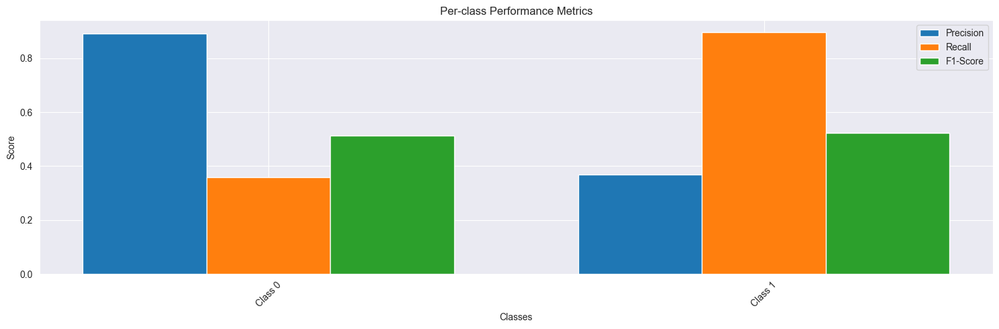


Other metrics:
loss: 0.6567
accuracy: 0.7831
precision: 0.7831
recall: 0.7831
val_loss: 0.8637
val_accuracy: 0.5174
val_precision: 0.5174
val_recall: 0.5174
val_per_class_f1: 0.5174

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 293ms/step - loss: 0.6567 - accuracy: 0.7831 - precision: 0.7831 - recall: 0.7831 - per_class_f1: 0.7714 - val_loss: 0.8637 - val_accuracy: 0.5174 - val_precision: 0.5174 - val_recall: 0.5174 - val_per_class_f1: 0.5174


2024-11-13 14:38:05,741 - INFO - Shuffled data for next epoch


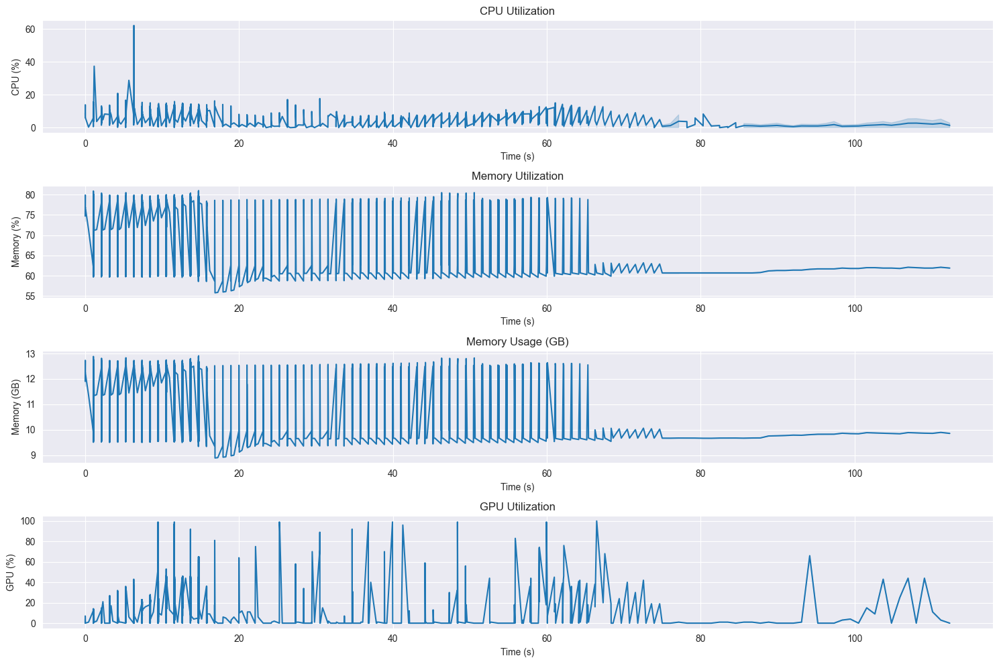



Local epochs:  17%|█▋        | 1/6 [00:20<01:41, 20.34s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.90
max_cpu_percent: 62.20
avg_memory_gb: 11.66
max_memory_gb: 12.91
avg_memory_percent: 73.21
max_memory_percent: 81.00
avg_gpu_percent: 18.99
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2385.53
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.6567, Val Loss: 0.8637
Accuracy: 0.7831, Val Accuracy: 0.5174

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6200 - accuracy: 0.7976 - precision: 0.7976 - recall: 0.7976 - per_class_f1: 0.7866
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9324  0.2353    0.3758
Class 1     0.3438  0.9592    0.5061

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6381  0.5972    0.4409


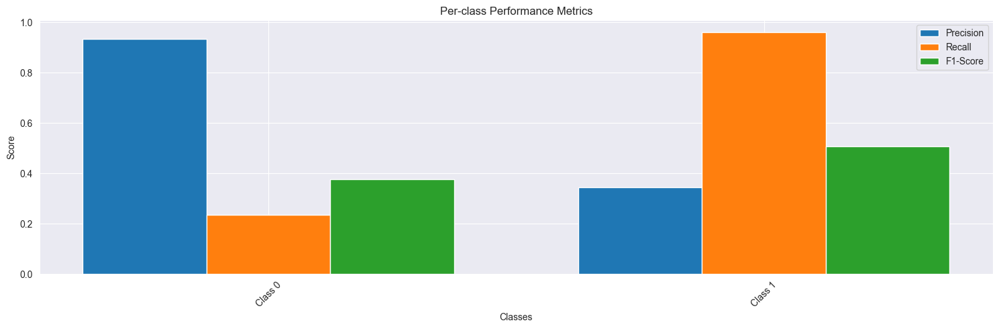


Other metrics:
loss: 0.6200
accuracy: 0.7976
precision: 0.7976
recall: 0.7976
val_loss: 0.9650
val_accuracy: 0.4485
val_precision: 0.4485
val_recall: 0.4485
val_per_class_f1: 0.4409

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 293ms/step - loss: 0.6200 - accuracy: 0.7976 - precision: 0.7976 - recall: 0.7976 - per_class_f1: 0.7866 - val_loss: 0.9650 - val_accuracy: 0.4485 - val_precision: 0.4485 - val_recall: 0.4485 - val_per_class_f1: 0.4409


2024-11-13 14:38:26,097 - INFO - Shuffled data for next epoch


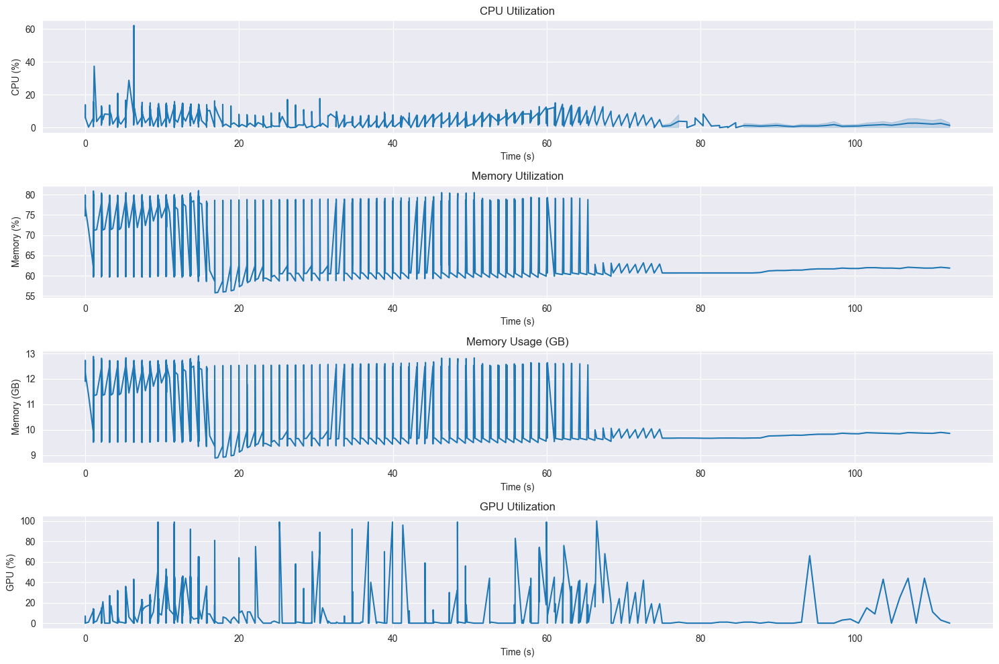



Local epochs:  33%|███▎      | 2/6 [00:40<01:21, 20.35s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 6.89
max_cpu_percent: 62.20
avg_memory_gb: 11.67
max_memory_gb: 12.91
avg_memory_percent: 73.24
max_memory_percent: 81.00
avg_gpu_percent: 18.98
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2385.76
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.6200, Val Loss: 0.9650
Accuracy: 0.7976, Val Accuracy: 0.4485

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.6101 - accuracy: 0.7934 - precision: 0.7934 - recall: 0.7934 - per_class_f1: 0.7818
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.9316  0.2882    0.4403
Class 1     0.3577  0.9493    0.5197

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6447  0.6188    0.4800


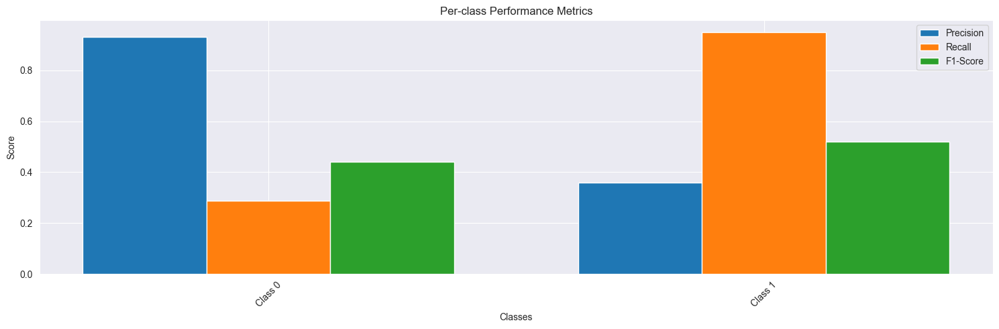


Other metrics:
loss: 0.6101
accuracy: 0.7934
precision: 0.7934
recall: 0.7934
val_loss: 0.9994
val_accuracy: 0.4830
val_precision: 0.4830
val_recall: 0.4830
val_per_class_f1: 0.4800

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 292ms/step - loss: 0.6101 - accuracy: 0.7934 - precision: 0.7934 - recall: 0.7934 - per_class_f1: 0.7818 - val_loss: 0.9994 - val_accuracy: 0.4830 - val_precision: 0.4830 - val_recall: 0.4830 - val_per_class_f1: 0.4800


2024-11-13 14:38:46,462 - INFO - Shuffled data for next epoch


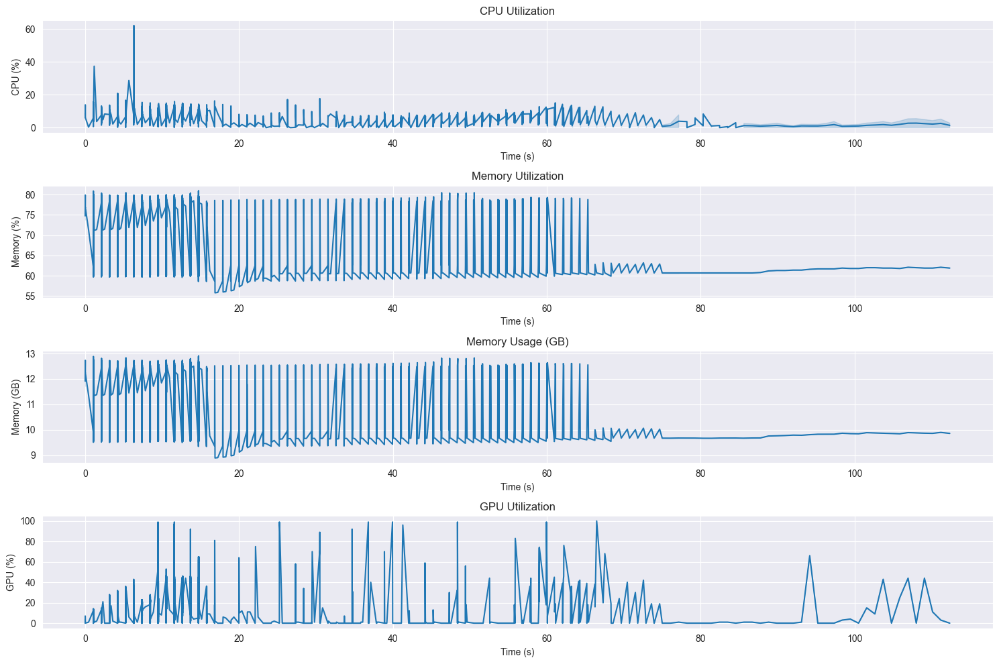



Local epochs:  50%|█████     | 3/6 [01:00<01:00, 20.26s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.88
max_cpu_percent: 62.20
avg_memory_gb: 11.67
max_memory_gb: 12.91
avg_memory_percent: 73.27
max_memory_percent: 81.00
avg_gpu_percent: 19.02
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2385.98
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.6101, Val Loss: 0.9994
Accuracy: 0.7934, Val Accuracy: 0.4830

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5947 - accuracy: 0.8006 - precision: 0.8006 - recall: 0.8006 - per_class_f1: 0.7906
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7484  0.8453    0.7939
Class 1     0.4633  0.3197    0.3783

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6059  0.5825    0.5861


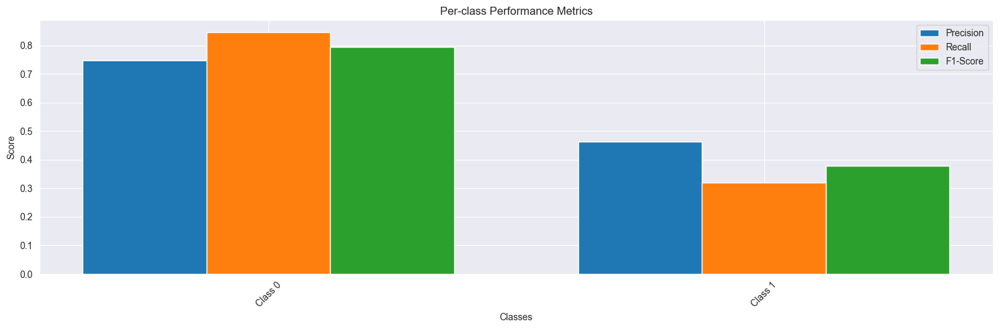


Other metrics:
loss: 0.5947
accuracy: 0.8006
precision: 0.8006
recall: 0.8006
val_loss: 0.7570
val_accuracy: 0.6905
val_precision: 0.6905
val_recall: 0.6905
val_per_class_f1: 0.5861

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 293ms/step - loss: 0.5947 - accuracy: 0.8006 - precision: 0.8006 - recall: 0.8006 - per_class_f1: 0.7906 - val_loss: 0.7570 - val_accuracy: 0.6905 - val_precision: 0.6905 - val_recall: 0.6905 - val_per_class_f1: 0.5861


2024-11-13 14:39:06,601 - INFO - Shuffled data for next epoch


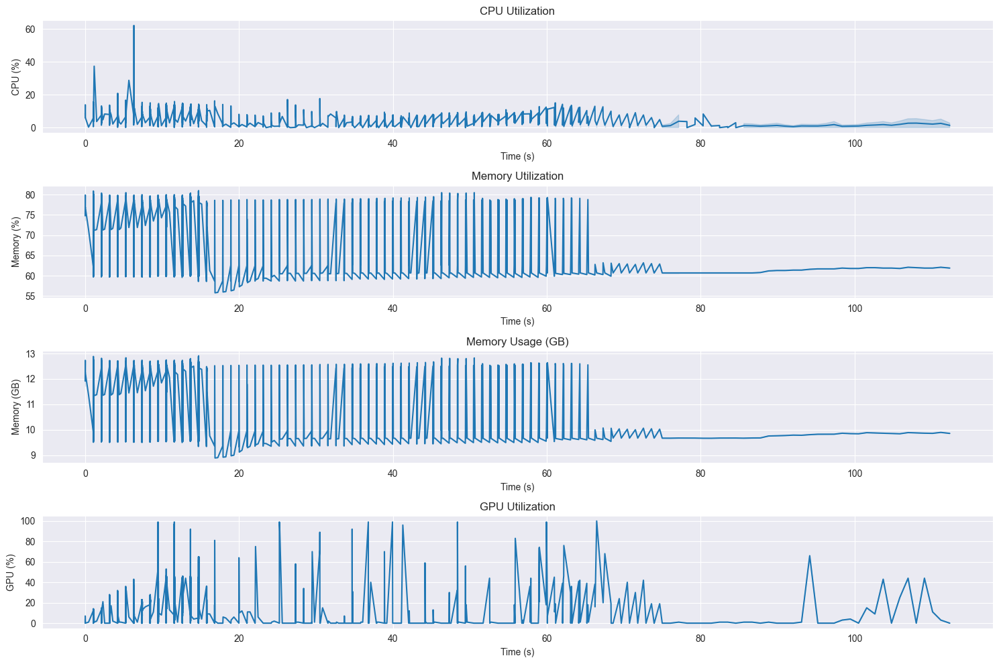



Local epochs:  67%|██████▋   | 4/6 [01:21<00:40, 20.29s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 6.88
max_cpu_percent: 62.20
avg_memory_gb: 11.68
max_memory_gb: 12.91
avg_memory_percent: 73.30
max_memory_percent: 81.00
avg_gpu_percent: 19.09
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2386.20
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5947, Val Loss: 0.7570
Accuracy: 0.8006, Val Accuracy: 0.6905

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5710 - accuracy: 0.8078 - precision: 0.8078 - recall: 0.8078 - per_class_f1: 0.7977
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8308  0.6094    0.7031
Class 1     0.4291  0.7028    0.5328

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6299  0.6561    0.6180


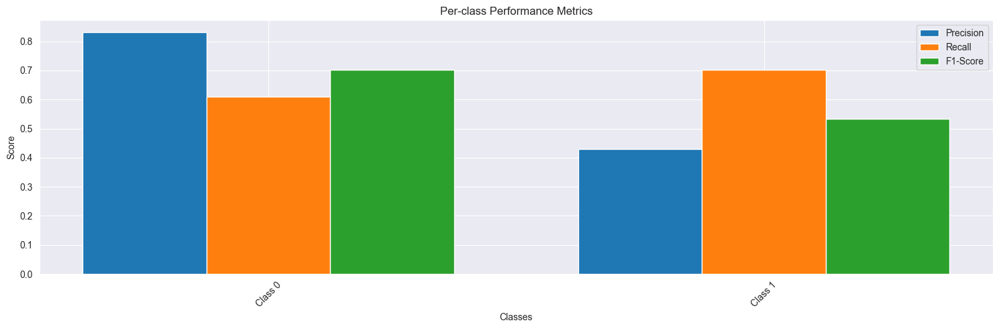


Other metrics:
loss: 0.5710
accuracy: 0.8078
precision: 0.8078
recall: 0.8078
val_loss: 0.9891
val_accuracy: 0.6369
val_precision: 0.6369
val_recall: 0.6369
val_per_class_f1: 0.6180

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 293ms/step - loss: 0.5710 - accuracy: 0.8078 - precision: 0.8078 - recall: 0.8078 - per_class_f1: 0.7977 - val_loss: 0.9891 - val_accuracy: 0.6369 - val_precision: 0.6369 - val_recall: 0.6369 - val_per_class_f1: 0.6180


2024-11-13 14:39:26,929 - INFO - Shuffled data for next epoch


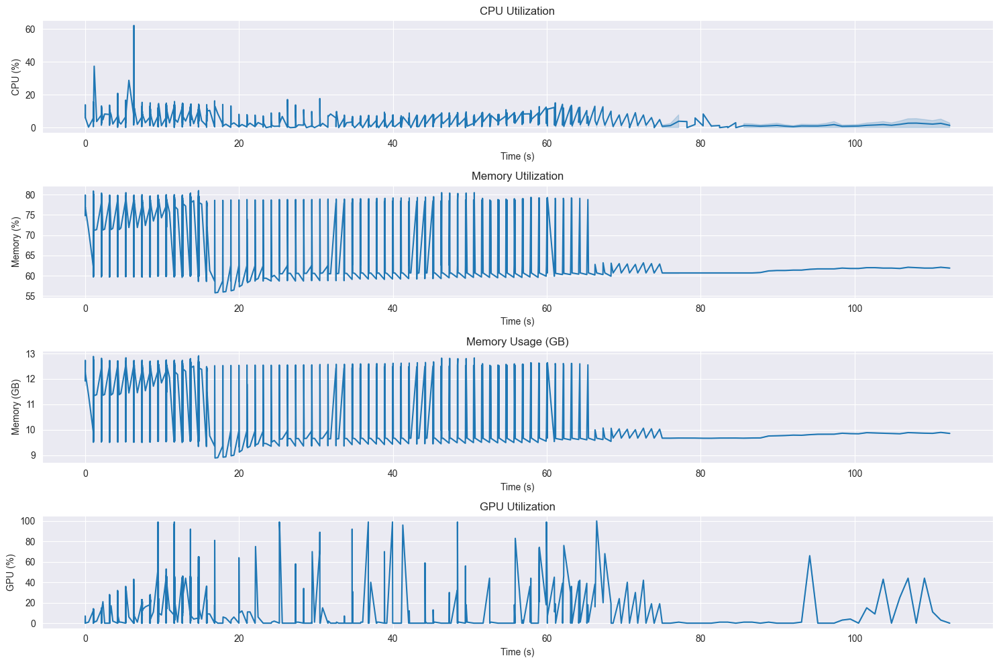



Local epochs:  83%|████████▎ | 5/6 [01:41<00:20, 20.32s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.87
max_cpu_percent: 62.20
avg_memory_gb: 11.68
max_memory_gb: 12.91
avg_memory_percent: 73.33
max_memory_percent: 81.00
avg_gpu_percent: 19.12
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2386.41
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.5710, Val Loss: 0.9891
Accuracy: 0.8078, Val Accuracy: 0.6369

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5495 - accuracy: 0.8042 - precision: 0.8042 - recall: 0.8042 - per_class_f1: 0.7947
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7735  0.8094    0.7910
Class 1     0.4865  0.4324    0.4579

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6300  0.6209    0.6244


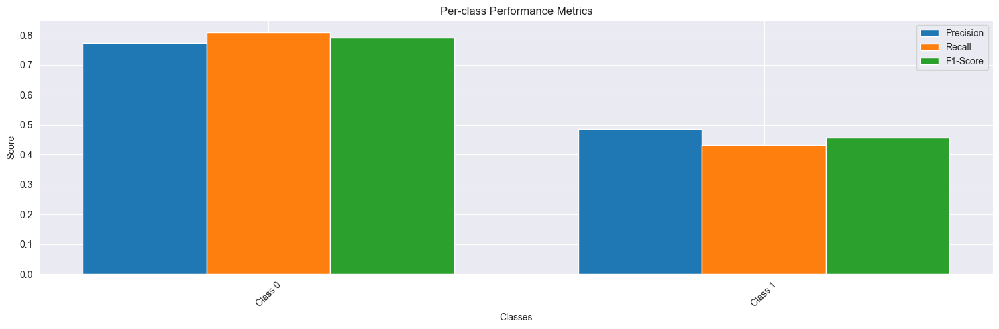


Other metrics:
loss: 0.5495
accuracy: 0.8042
precision: 0.8042
recall: 0.8042
val_loss: 0.6805
val_accuracy: 0.6983
val_precision: 0.6983
val_recall: 0.6983
val_per_class_f1: 0.6244

Epoch 1: val_accuracy did not improve from 0.70705
52/52 [==============================] - 15s 293ms/step - loss: 0.5495 - accuracy: 0.8042 - precision: 0.8042 - recall: 0.8042 - per_class_f1: 0.7947 - val_loss: 0.6805 - val_accuracy: 0.6983 - val_precision: 0.6983 - val_recall: 0.6983 - val_per_class_f1: 0.6244


2024-11-13 14:39:47,313 - INFO - Shuffled data for next epoch


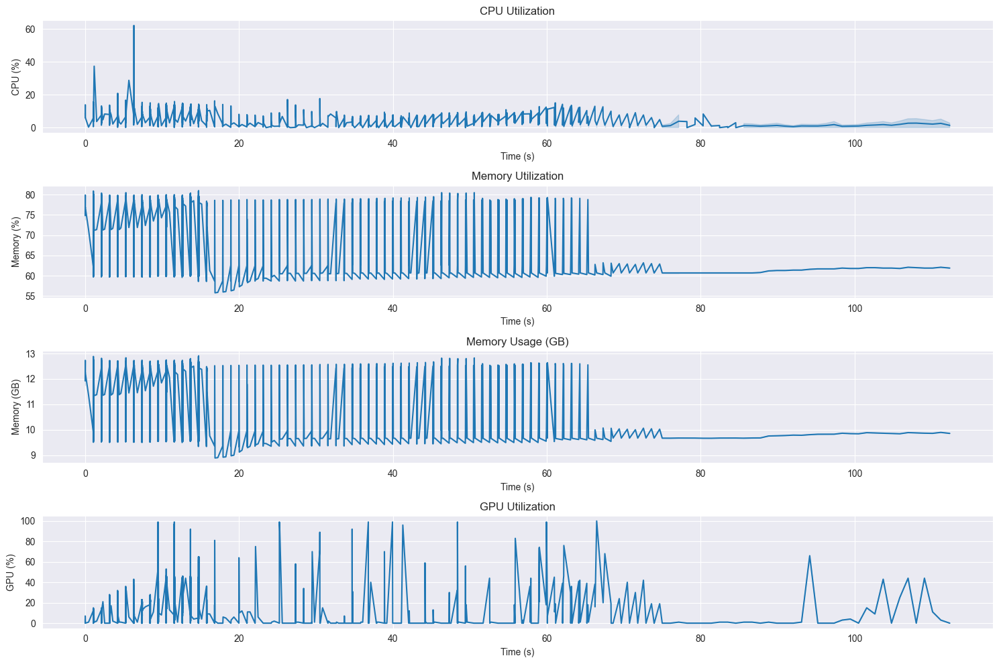



Local epochs: 100%|██████████| 6/6 [02:01<00:00, 20.33s/it]

Training Clients: 100%|██████████| 5/5 [09:25<00:00, 113.19s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.86
max_cpu_percent: 62.20
avg_memory_gb: 11.68
max_memory_gb: 12.91
avg_memory_percent: 73.36
max_memory_percent: 81.00
avg_gpu_percent: 19.13
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2386.62
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.5495, Val Loss: 0.6805
Accuracy: 0.8042, Val Accuracy: 0.6983



Federated Learning Rounds:  80%|████████  | 4/5 [41:29<09:55, 595.95s/it]


Test metrics:
loss: 0.6583
accuracy: 0.6896
precision: 0.6896
recall: 0.6896
f1_metric: 0.4482

Round Summary:
val_loss: 0.7342
loss: 0.5627

Per-class F1 scores:
Class 0: 0.8412
Class 1: 0.7505
accuracy: 0.8060
precision: 0.8060
recall: 0.8060
val_accuracy: 0.6855
val_precision: 0.6855
val_recall: 0.6855
val_per_class_f1: 0.6283

Federated Learning Round 5/5



Training Clients:   0%|          | 0/5 [00:00<?, ?it/s]


==================== Training Client 1 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5583 - accuracy: 0.8002 - precision: 0.8002 - recall: 0.8002 - per_class_f1: 0.7883
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7401  0.9412    0.8286
Class 1     0.5968  0.2085    0.3090

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6684  0.5748    0.5688


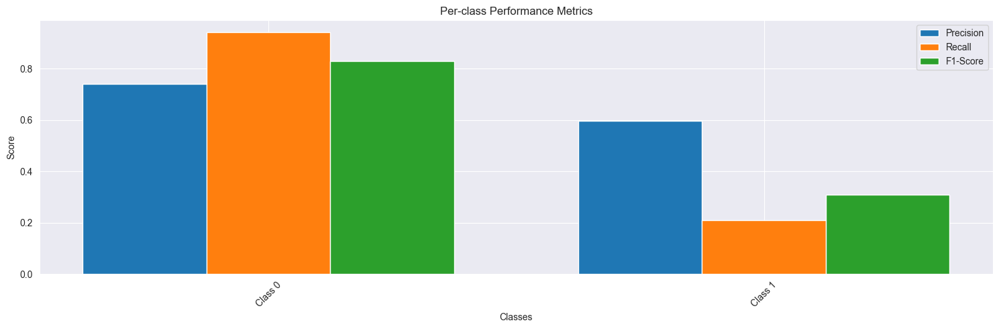


Other metrics:
loss: 0.5583
accuracy: 0.8002
precision: 0.8002
recall: 0.8002
val_loss: 0.6532
val_accuracy: 0.7253
val_precision: 0.7253
val_recall: 0.7253
val_per_class_f1: 0.5688

Epoch 1: val_accuracy improved from 0.70705 to 0.72531, saving model to best_model.h5
52/52 [==============================] - 15s 296ms/step - loss: 0.5583 - accuracy: 0.8002 - precision: 0.8002 - recall: 0.8002 - per_class_f1: 0.7883 - val_loss: 0.6532 - val_accuracy: 0.7253 - val_precision: 0.7253 - val_recall: 0.7253 - val_per_class_f1: 0.5688


2024-11-13 14:40:17,067 - INFO - Shuffled data for next epoch


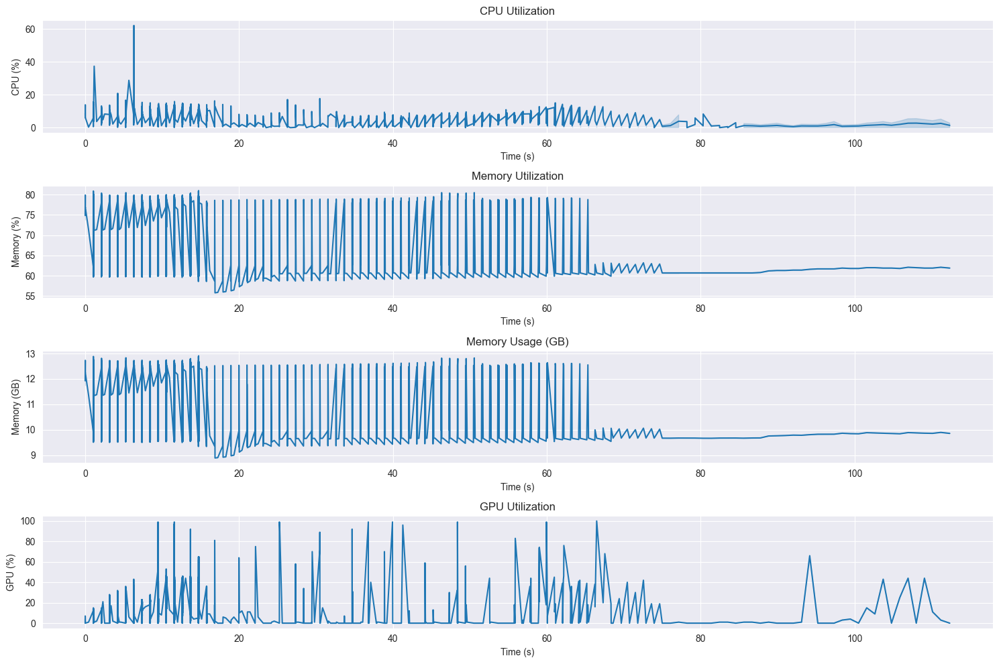



Local epochs:  17%|█▋        | 1/6 [00:20<01:42, 20.41s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 6.85
max_cpu_percent: 62.20
avg_memory_gb: 11.69
max_memory_gb: 12.91
avg_memory_percent: 73.39
max_memory_percent: 81.00
avg_gpu_percent: 19.14
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2386.83
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.5583, Val Loss: 0.6532
Accuracy: 0.8002, Val Accuracy: 0.7253

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5447 - accuracy: 0.8027 - precision: 0.8027 - recall: 0.8027 - per_class_f1: 0.7916
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7790  0.8006    0.7897
Class 1     0.4887  0.4563    0.4720

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6339  0.6285    0.6308


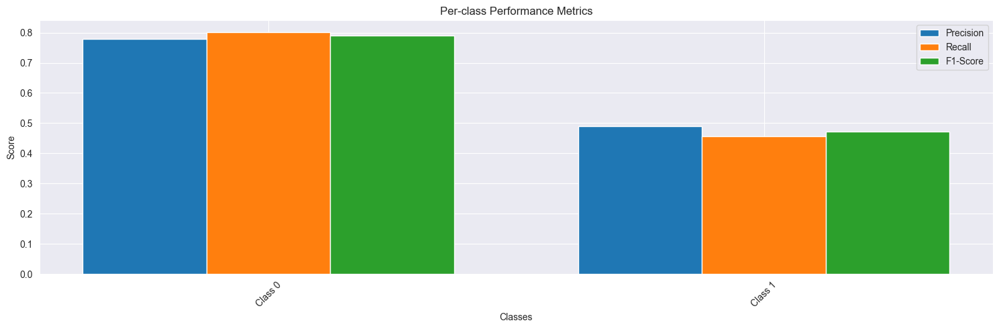


Other metrics:
loss: 0.5447
accuracy: 0.8027
precision: 0.8027
recall: 0.8027
val_loss: 0.6970
val_accuracy: 0.6992
val_precision: 0.6992
val_recall: 0.6992
val_per_class_f1: 0.6308

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 293ms/step - loss: 0.5447 - accuracy: 0.8027 - precision: 0.8027 - recall: 0.8027 - per_class_f1: 0.7916 - val_loss: 0.6970 - val_accuracy: 0.6992 - val_precision: 0.6992 - val_recall: 0.6992 - val_per_class_f1: 0.6308


2024-11-13 14:40:37,330 - INFO - Shuffled data for next epoch


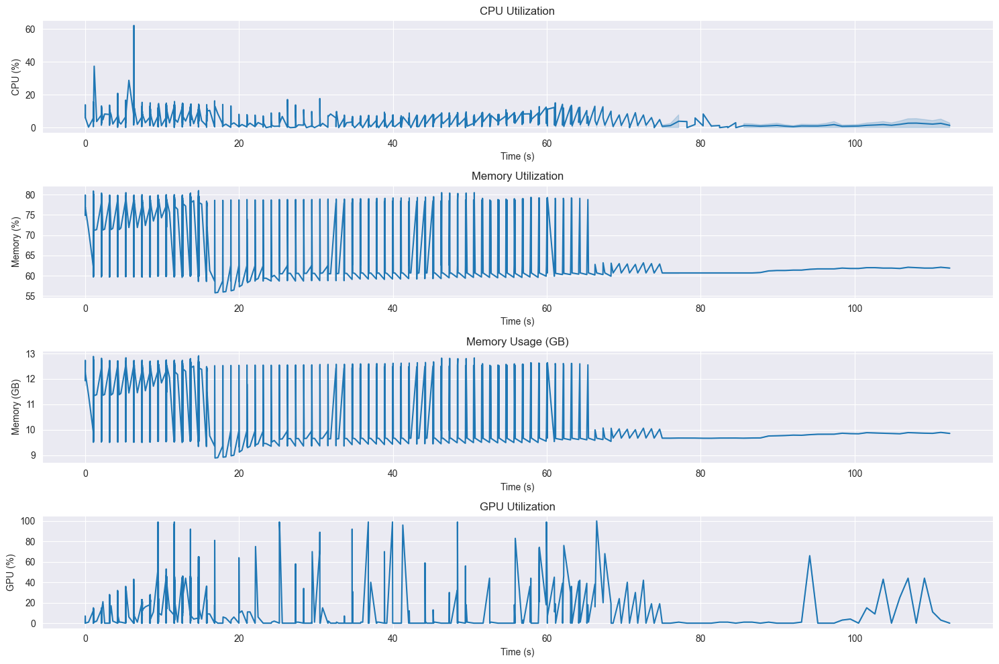



Local epochs:  33%|███▎      | 2/6 [00:40<01:21, 20.37s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 6.85
max_cpu_percent: 62.20
avg_memory_gb: 11.69
max_memory_gb: 12.91
avg_memory_percent: 73.42
max_memory_percent: 81.00
avg_gpu_percent: 19.16
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2387.03
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.5447, Val Loss: 0.6970
Accuracy: 0.8027, Val Accuracy: 0.6992

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5180 - accuracy: 0.8111 - precision: 0.8111 - recall: 0.8111 - per_class_f1: 0.8004
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8032  0.7776    0.7902
Class 1     0.5052  0.5437    0.5237

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6542  0.6607    0.6570


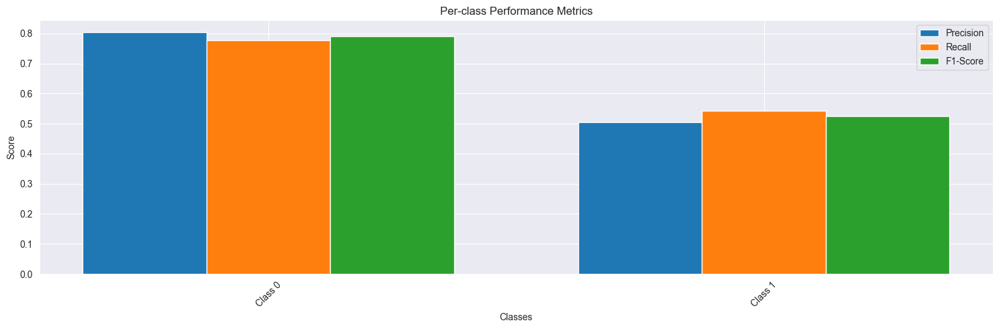


Other metrics:
loss: 0.5180
accuracy: 0.8111
precision: 0.8111
recall: 0.8111
val_loss: 0.7673
val_accuracy: 0.7087
val_precision: 0.7087
val_recall: 0.7087
val_per_class_f1: 0.6570

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 293ms/step - loss: 0.5180 - accuracy: 0.8111 - precision: 0.8111 - recall: 0.8111 - per_class_f1: 0.8004 - val_loss: 0.7673 - val_accuracy: 0.7087 - val_precision: 0.7087 - val_recall: 0.7087 - val_per_class_f1: 0.6570


2024-11-13 14:40:57,693 - INFO - Shuffled data for next epoch


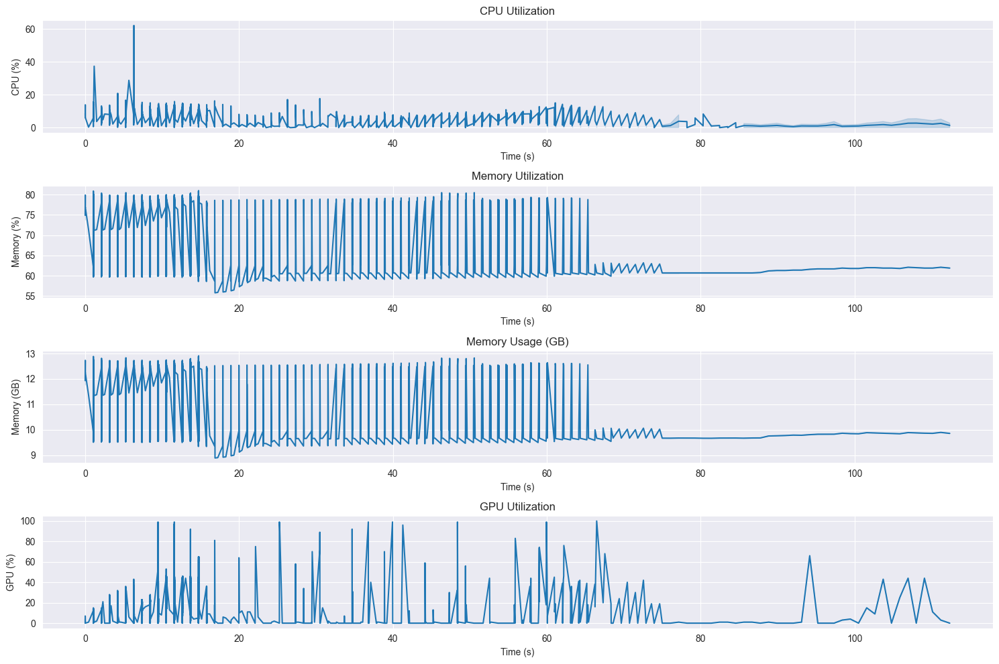



Local epochs:  50%|█████     | 3/6 [01:01<01:01, 20.49s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.84
max_cpu_percent: 62.20
avg_memory_gb: 11.70
max_memory_gb: 12.91
avg_memory_percent: 73.45
max_memory_percent: 81.00
avg_gpu_percent: 19.20
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2387.24
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.5180, Val Loss: 0.7673
Accuracy: 0.8111, Val Accuracy: 0.7087

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5179 - accuracy: 0.8105 - precision: 0.8105 - recall: 0.8105 - per_class_f1: 0.8003
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7927  0.5600    0.6563
Class 1     0.3813  0.6493    0.4805

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5870  0.6046    0.5684


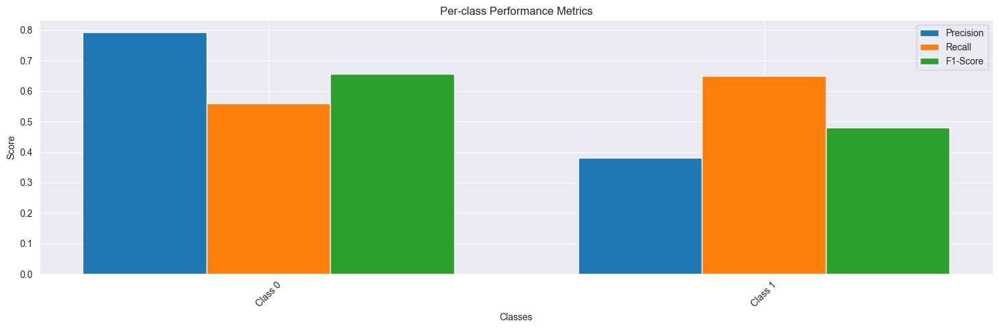


Other metrics:
loss: 0.5179
accuracy: 0.8105
precision: 0.8105
recall: 0.8105
val_loss: 0.7630
val_accuracy: 0.5863
val_precision: 0.5863
val_recall: 0.5863
val_per_class_f1: 0.5684

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5179 - accuracy: 0.8105 - precision: 0.8105 - recall: 0.8105 - per_class_f1: 0.8003 - val_loss: 0.7630 - val_accuracy: 0.5863 - val_precision: 0.5863 - val_recall: 0.5863 - val_per_class_f1: 0.5684


2024-11-13 14:41:18,402 - INFO - Shuffled data for next epoch


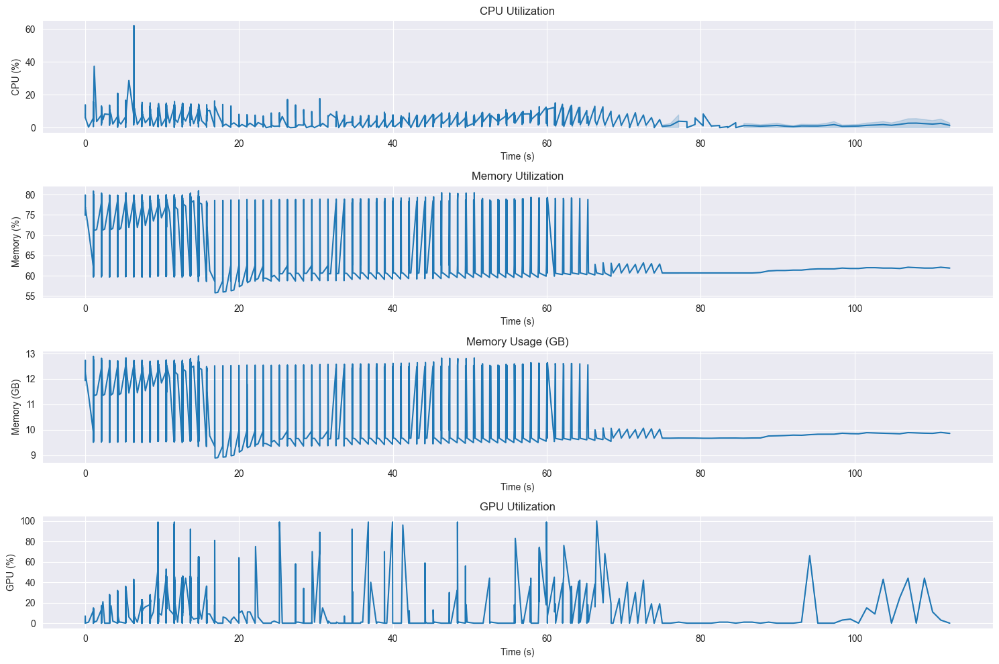

Local epochs:  50%|█████     | 3/6 [01:21<01:21, 27.20s/it]

Training Clients:  20%|██        | 1/5 [01:21<05:26, 81.64s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.83
max_cpu_percent: 62.20
avg_memory_gb: 11.70
max_memory_gb: 12.91
avg_memory_percent: 73.48
max_memory_percent: 81.00
avg_gpu_percent: 19.22
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2387.44
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5179, Val Loss: 0.7630
Accuracy: 0.8105, Val Accuracy: 0.5863
Early stopping triggered for client 0

==================== Training Client 2 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5823 - accuracy: 0.7936 - precision: 0.7936 - recall: 0.7936 - per_class_f1: 0.7822
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7480  0.8435    0.7929
Class 1     0.4604  0.3197    0.3774

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6042  0.5816    0.5852


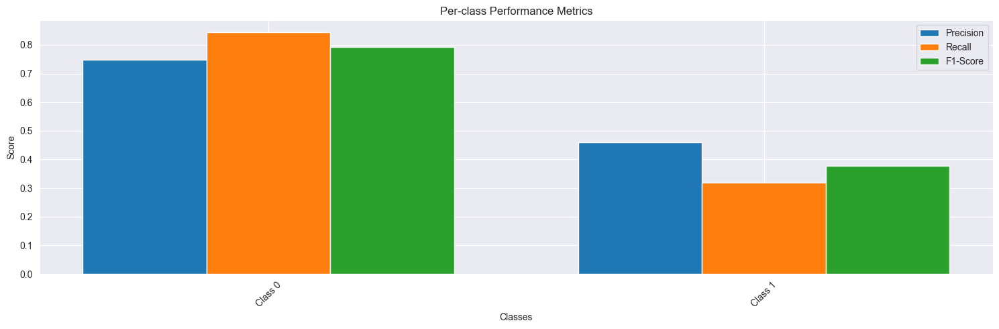


Other metrics:
loss: 0.5823
accuracy: 0.7936
precision: 0.7936
recall: 0.7936
val_loss: 0.6713
val_accuracy: 0.6892
val_precision: 0.6892
val_recall: 0.6892
val_per_class_f1: 0.5852

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 297ms/step - loss: 0.5823 - accuracy: 0.7936 - precision: 0.7936 - recall: 0.7936 - per_class_f1: 0.7822 - val_loss: 0.6713 - val_accuracy: 0.6892 - val_precision: 0.6892 - val_recall: 0.6892 - val_per_class_f1: 0.5852


2024-11-13 14:41:38,766 - INFO - Shuffled data for next epoch


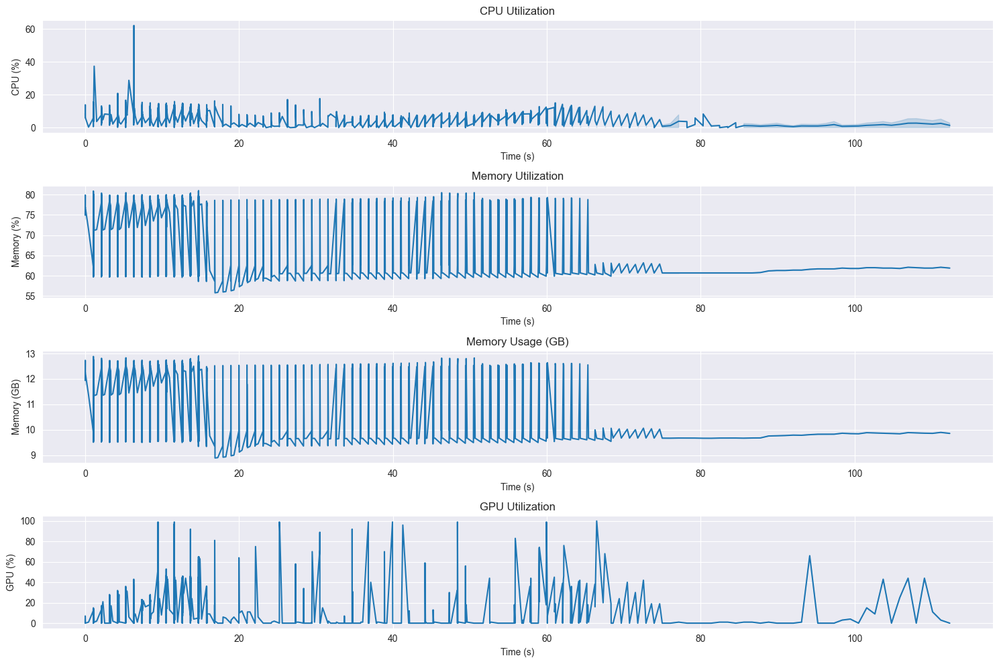



Local epochs:  17%|█▋        | 1/6 [00:20<01:43, 20.60s/it]


Resource Usage Summary:
duration_seconds: 14.92
avg_cpu_percent: 6.83
max_cpu_percent: 62.20
avg_memory_gb: 11.71
max_memory_gb: 12.91
avg_memory_percent: 73.50
max_memory_percent: 81.00
avg_gpu_percent: 19.25
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2387.63
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.5823, Val Loss: 0.6713
Accuracy: 0.7936, Val Accuracy: 0.6892

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5731 - accuracy: 0.7912 - precision: 0.7912 - recall: 0.7912 - per_class_f1: 0.7798
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7462  0.8906    0.8120
Class 1     0.5118  0.2746    0.3575

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6290  0.5826    0.5847


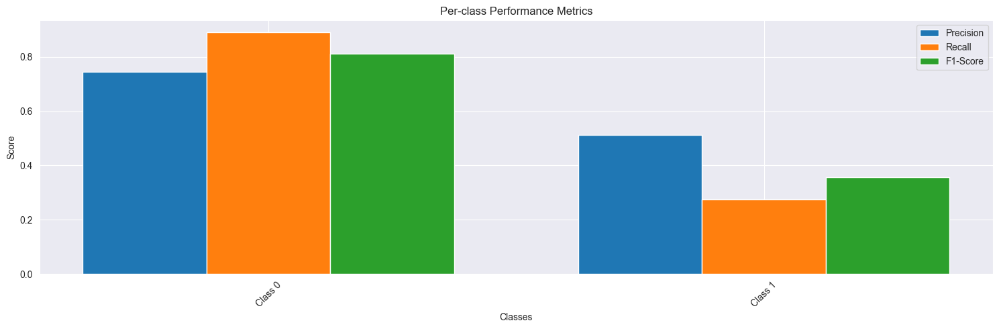


Other metrics:
loss: 0.5731
accuracy: 0.7912
precision: 0.7912
recall: 0.7912
val_loss: 0.7695
val_accuracy: 0.7091
val_precision: 0.7091
val_recall: 0.7091
val_per_class_f1: 0.5847

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5731 - accuracy: 0.7912 - precision: 0.7912 - recall: 0.7912 - per_class_f1: 0.7798 - val_loss: 0.7695 - val_accuracy: 0.7091 - val_precision: 0.7091 - val_recall: 0.7091 - val_per_class_f1: 0.5847


2024-11-13 14:41:59,310 - INFO - Shuffled data for next epoch


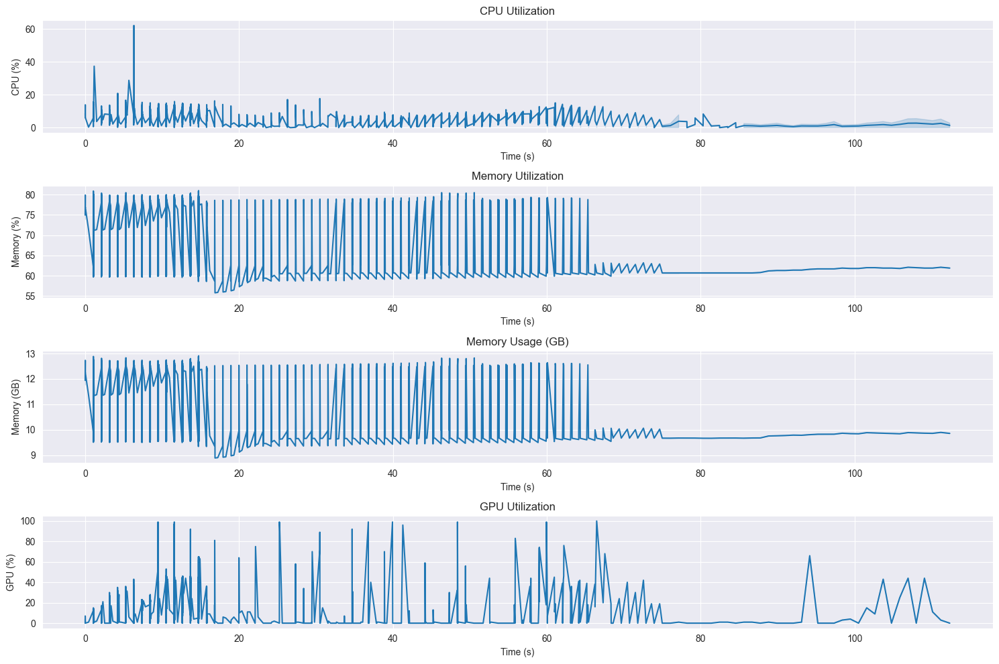



Local epochs:  33%|███▎      | 2/6 [00:40<01:21, 20.43s/it]


Resource Usage Summary:
duration_seconds: 14.79
avg_cpu_percent: 6.82
max_cpu_percent: 62.20
avg_memory_gb: 11.71
max_memory_gb: 12.91
avg_memory_percent: 73.53
max_memory_percent: 81.00
avg_gpu_percent: 19.26
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2387.83
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.5731, Val Loss: 0.7695
Accuracy: 0.7912, Val Accuracy: 0.7091

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5448 - accuracy: 0.8021 - precision: 0.8021 - recall: 0.8021 - per_class_f1: 0.7904
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7540  0.8529    0.8004
Class 1     0.4867  0.3338    0.3960

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6203  0.5934    0.5982


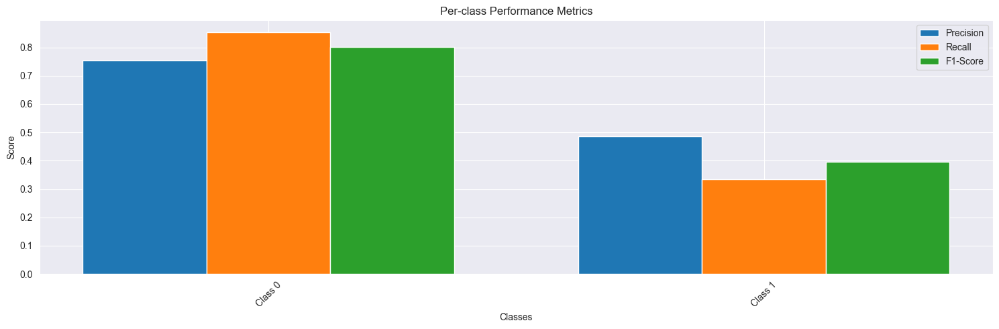


Other metrics:
loss: 0.5448
accuracy: 0.8021
precision: 0.8021
recall: 0.8021
val_loss: 0.6694
val_accuracy: 0.7000
val_precision: 0.7000
val_recall: 0.7000
val_per_class_f1: 0.5982

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 298ms/step - loss: 0.5448 - accuracy: 0.8021 - precision: 0.8021 - recall: 0.8021 - per_class_f1: 0.7904 - val_loss: 0.6694 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000 - val_per_class_f1: 0.5982


2024-11-13 14:42:19,727 - INFO - Shuffled data for next epoch


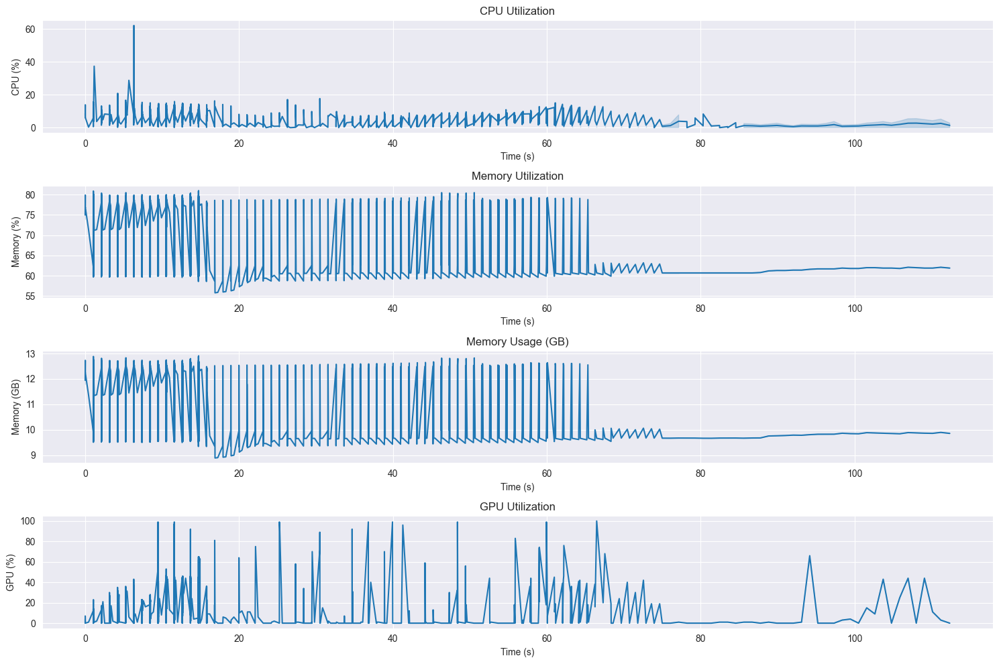



Local epochs:  50%|█████     | 3/6 [01:01<01:01, 20.55s/it]


Resource Usage Summary:
duration_seconds: 14.93
avg_cpu_percent: 6.81
max_cpu_percent: 62.20
avg_memory_gb: 11.72
max_memory_gb: 12.91
avg_memory_percent: 73.56
max_memory_percent: 81.00
avg_gpu_percent: 19.25
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2388.02
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.5448, Val Loss: 0.6694
Accuracy: 0.8021, Val Accuracy: 0.7000

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5419 - accuracy: 0.8002 - precision: 0.8002 - recall: 0.8002 - per_class_f1: 0.7887
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7980  0.7829    0.7904
Class 1     0.5027  0.5254    0.5138

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6503  0.6541    0.6521


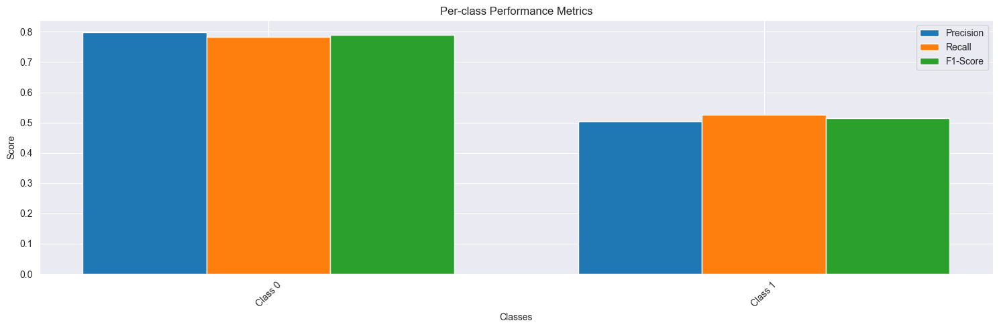


Other metrics:
loss: 0.5419
accuracy: 0.8002
precision: 0.8002
recall: 0.8002
val_loss: 0.7390
val_accuracy: 0.7071
val_precision: 0.7071
val_recall: 0.7071
val_per_class_f1: 0.6521

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 296ms/step - loss: 0.5419 - accuracy: 0.8002 - precision: 0.8002 - recall: 0.8002 - per_class_f1: 0.7887 - val_loss: 0.7390 - val_accuracy: 0.7071 - val_precision: 0.7071 - val_recall: 0.7071 - val_per_class_f1: 0.6521


2024-11-13 14:42:40,301 - INFO - Shuffled data for next epoch


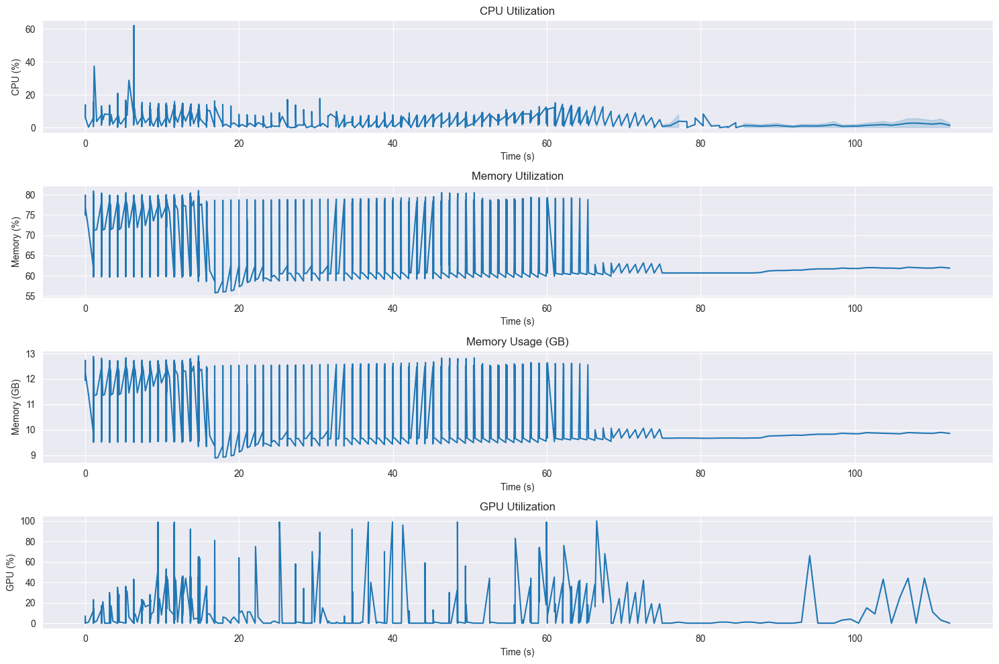



Local epochs:  67%|██████▋   | 4/6 [01:22<00:41, 20.52s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 6.80
max_cpu_percent: 62.20
avg_memory_gb: 11.72
max_memory_gb: 12.91
avg_memory_percent: 73.59
max_memory_percent: 81.00
avg_gpu_percent: 19.25
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2388.20
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5419, Val Loss: 0.7390
Accuracy: 0.8002, Val Accuracy: 0.7071

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5228 - accuracy: 0.8069 - precision: 0.8069 - recall: 0.8069 - per_class_f1: 0.7961
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8406  0.6235    0.7160
Class 1     0.4430  0.7169    0.5476

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6418  0.6702    0.6318


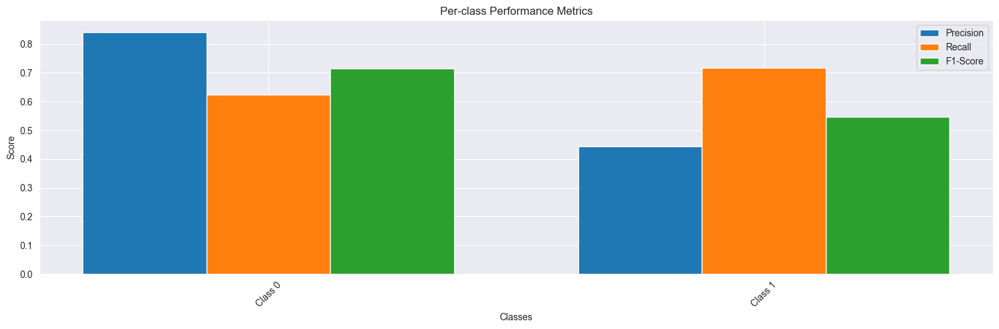


Other metrics:
loss: 0.5228
accuracy: 0.8069
precision: 0.8069
recall: 0.8069
val_loss: 0.7736
val_accuracy: 0.6510
val_precision: 0.6510
val_recall: 0.6510
val_per_class_f1: 0.6318

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 293ms/step - loss: 0.5228 - accuracy: 0.8069 - precision: 0.8069 - recall: 0.8069 - per_class_f1: 0.7961 - val_loss: 0.7736 - val_accuracy: 0.6510 - val_precision: 0.6510 - val_recall: 0.6510 - val_per_class_f1: 0.6318


2024-11-13 14:43:00,641 - INFO - Shuffled data for next epoch


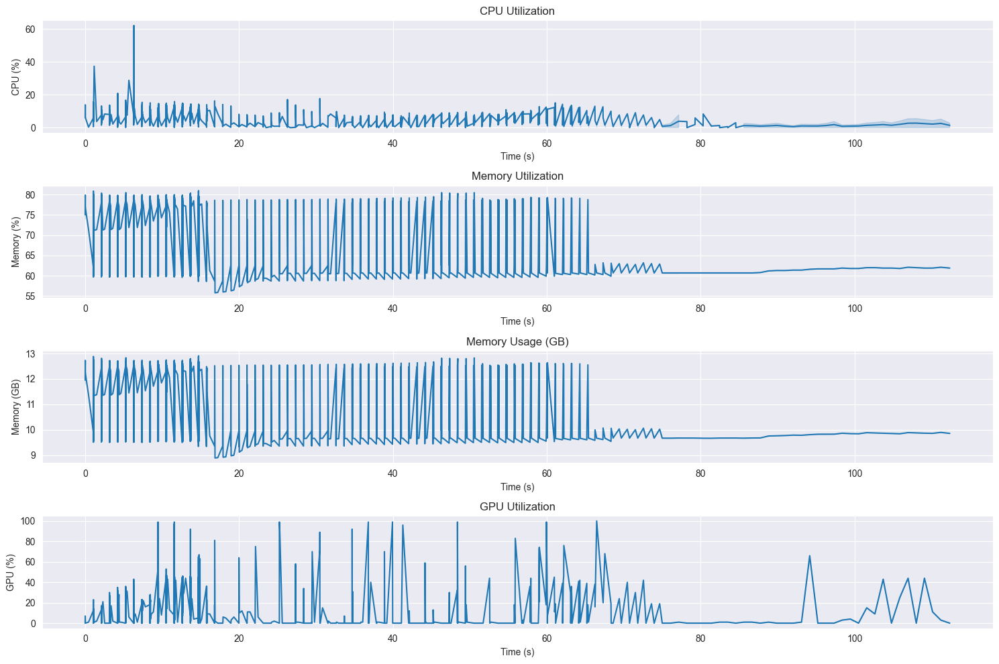



Local epochs:  83%|████████▎ | 5/6 [01:42<00:20, 20.52s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 6.80
max_cpu_percent: 62.20
avg_memory_gb: 11.72
max_memory_gb: 12.91
avg_memory_percent: 73.61
max_memory_percent: 81.00
avg_gpu_percent: 19.29
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2388.39
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.5228, Val Loss: 0.7736
Accuracy: 0.8069, Val Accuracy: 0.6510

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5113 - accuracy: 0.8105 - precision: 0.8105 - recall: 0.8105 - per_class_f1: 0.7999
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7983  0.7382    0.7671
Class 1     0.4690  0.5535    0.5078

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6337  0.6459    0.6374


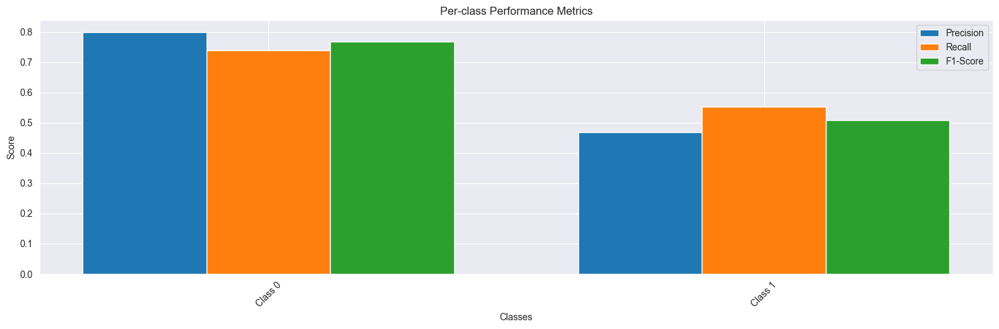


Other metrics:
loss: 0.5113
accuracy: 0.8105
precision: 0.8105
recall: 0.8105
val_loss: 0.7228
val_accuracy: 0.6838
val_precision: 0.6838
val_recall: 0.6838
val_per_class_f1: 0.6374

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5113 - accuracy: 0.8105 - precision: 0.8105 - recall: 0.8105 - per_class_f1: 0.7999 - val_loss: 0.7228 - val_accuracy: 0.6838 - val_precision: 0.6838 - val_recall: 0.6838 - val_per_class_f1: 0.6374


2024-11-13 14:43:21,283 - INFO - Shuffled data for next epoch


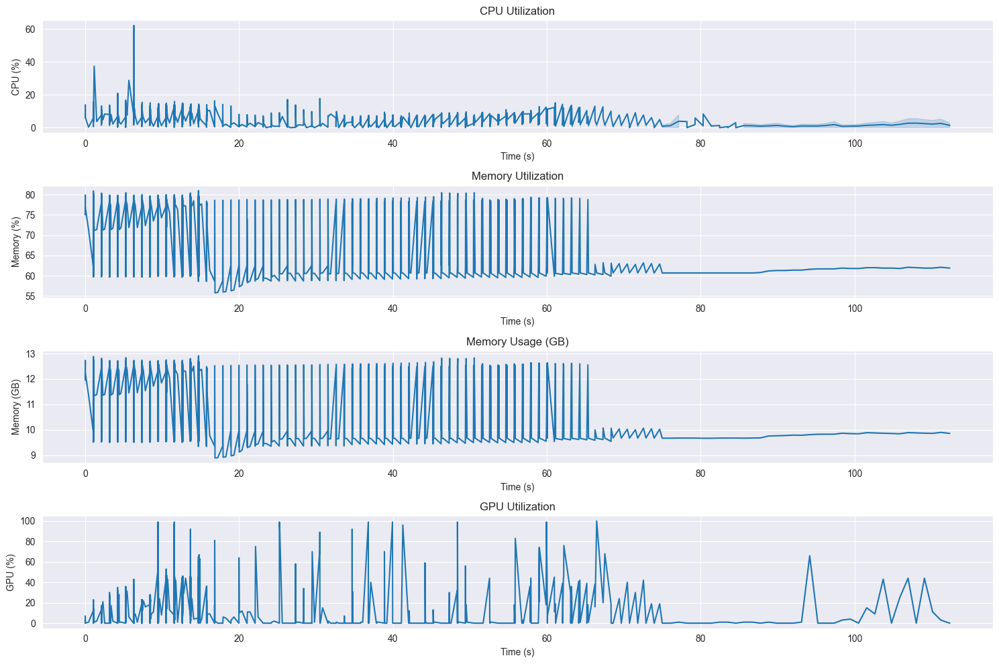

Local epochs:  83%|████████▎ | 5/6 [02:03<00:24, 24.62s/it]

Training Clients:  40%|████      | 2/5 [03:24<05:18, 106.06s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.80
max_cpu_percent: 62.20
avg_memory_gb: 11.73
max_memory_gb: 12.91
avg_memory_percent: 73.64
max_memory_percent: 81.00
avg_gpu_percent: 19.30
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2388.57
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.5113, Val Loss: 0.7228
Accuracy: 0.8105, Val Accuracy: 0.6838
Early stopping triggered for client 1

==================== Training Client 3 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5740 - accuracy: 0.7888 - precision: 0.7888 - recall: 0.7888 - per_class_f1: 0.7767
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7998  0.5782    0.6712
Class 1     0.3929  0.6535    0.4907

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5964  0.6159    0.5810


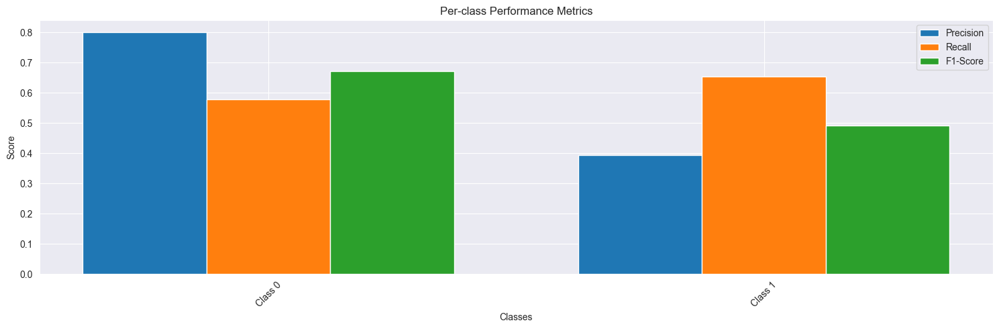


Other metrics:
loss: 0.5740
accuracy: 0.7888
precision: 0.7888
recall: 0.7888
val_loss: 0.7949
val_accuracy: 0.6004
val_precision: 0.6004
val_recall: 0.6004
val_per_class_f1: 0.5810

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 296ms/step - loss: 0.5740 - accuracy: 0.7888 - precision: 0.7888 - recall: 0.7888 - per_class_f1: 0.7767 - val_loss: 0.7949 - val_accuracy: 0.6004 - val_precision: 0.6004 - val_recall: 0.6004 - val_per_class_f1: 0.5810


2024-11-13 14:43:41,933 - INFO - Shuffled data for next epoch


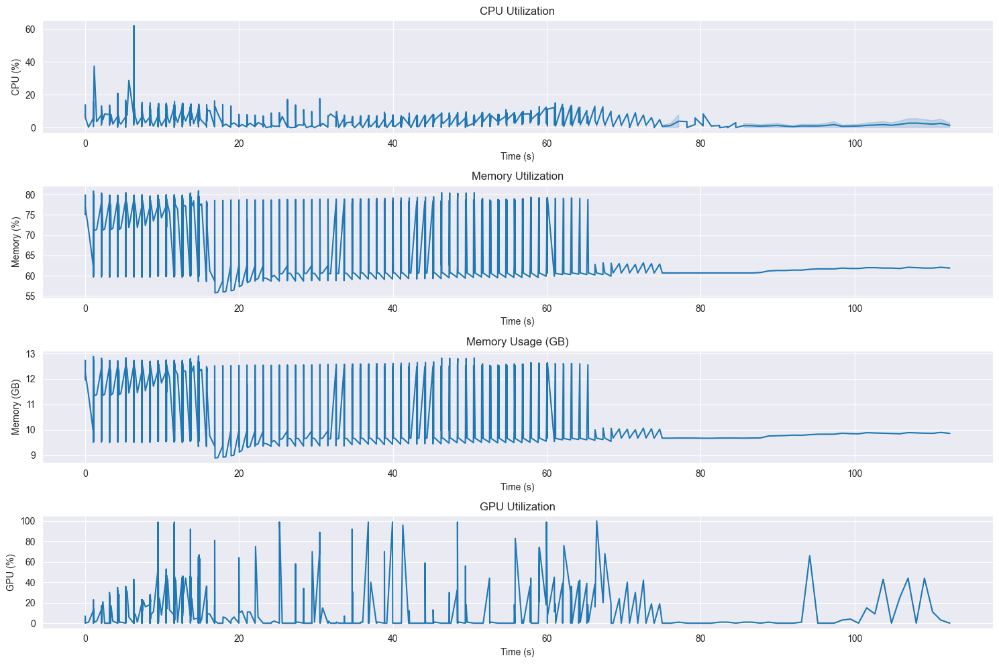



Local epochs:  17%|█▋        | 1/6 [00:20<01:42, 20.59s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 6.79
max_cpu_percent: 62.20
avg_memory_gb: 11.73
max_memory_gb: 12.91
avg_memory_percent: 73.66
max_memory_percent: 81.00
avg_gpu_percent: 19.32
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2388.75
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.5740, Val Loss: 0.7949
Accuracy: 0.7888, Val Accuracy: 0.6004

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5648 - accuracy: 0.7912 - precision: 0.7912 - recall: 0.7912 - per_class_f1: 0.7800
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8173  0.3341    0.4743
Class 1     0.3399  0.8211    0.4808

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5786  0.5776    0.4776


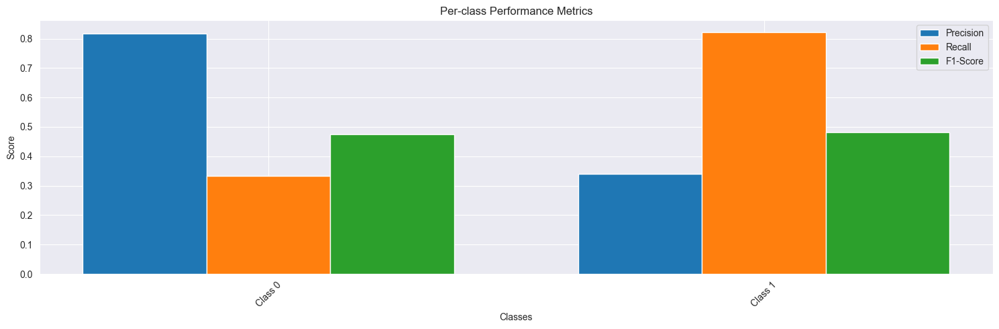


Other metrics:
loss: 0.5648
accuracy: 0.7912
precision: 0.7912
recall: 0.7912
val_loss: 0.8333
val_accuracy: 0.4776
val_precision: 0.4776
val_recall: 0.4776
val_per_class_f1: 0.4776

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5648 - accuracy: 0.7912 - precision: 0.7912 - recall: 0.7912 - per_class_f1: 0.7800 - val_loss: 0.8333 - val_accuracy: 0.4776 - val_precision: 0.4776 - val_recall: 0.4776 - val_per_class_f1: 0.4776


2024-11-13 14:44:02,419 - INFO - Shuffled data for next epoch


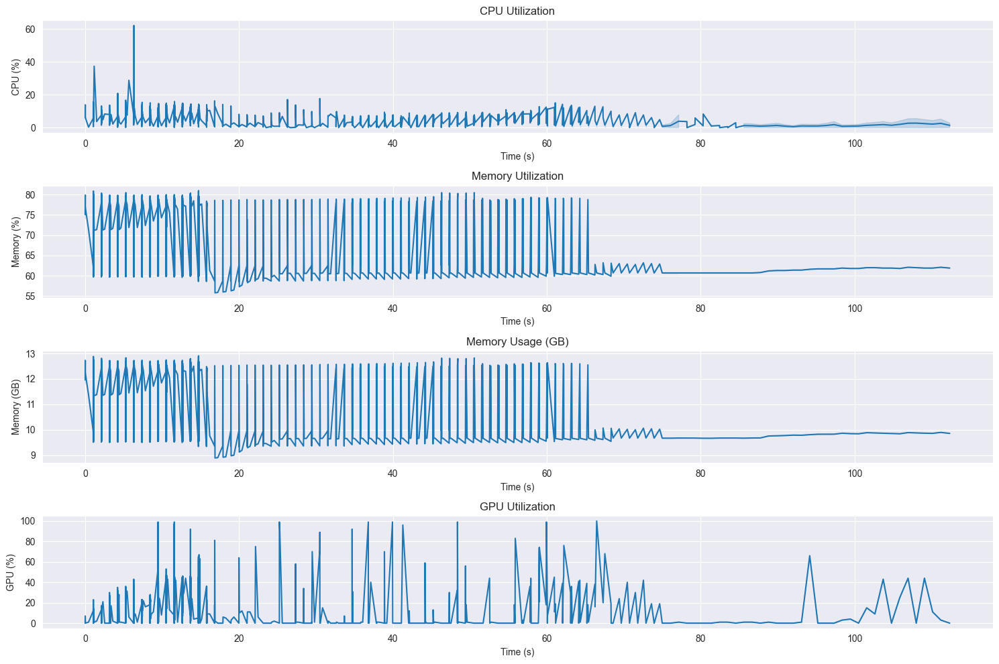



Local epochs:  33%|███▎      | 2/6 [00:41<01:22, 20.53s/it]


Resource Usage Summary:
duration_seconds: 14.72
avg_cpu_percent: 6.78
max_cpu_percent: 62.20
avg_memory_gb: 11.74
max_memory_gb: 12.91
avg_memory_percent: 73.69
max_memory_percent: 81.00
avg_gpu_percent: 19.34
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2388.93
max_gpu_memory_mb: 2415.00

Epoch 2/6
Loss: 0.5648, Val Loss: 0.8333
Accuracy: 0.7912, Val Accuracy: 0.4776

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5453 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7806
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7249  0.9176    0.8100
Class 1     0.4574  0.1662    0.2438

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5911  0.5419    0.5269


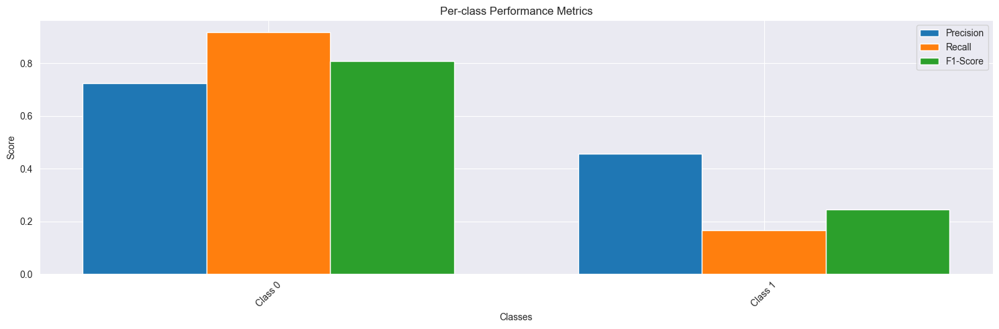


Other metrics:
loss: 0.5453
accuracy: 0.7900
precision: 0.7900
recall: 0.7900
val_loss: 0.8396
val_accuracy: 0.6963
val_precision: 0.6963
val_recall: 0.6963
val_per_class_f1: 0.5269

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5453 - accuracy: 0.7900 - precision: 0.7900 - recall: 0.7900 - per_class_f1: 0.7806 - val_loss: 0.8396 - val_accuracy: 0.6963 - val_precision: 0.6963 - val_recall: 0.6963 - val_per_class_f1: 0.5269


2024-11-13 14:44:22,919 - INFO - Shuffled data for next epoch


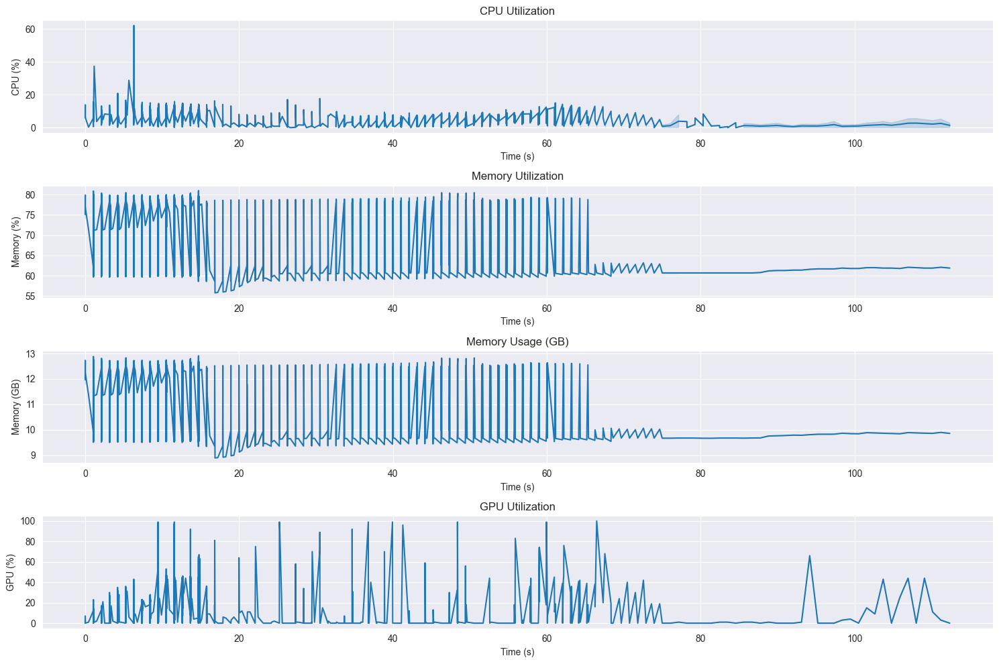



Local epochs:  50%|█████     | 3/6 [01:01<01:01, 20.56s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 6.78
max_cpu_percent: 62.20
avg_memory_gb: 11.74
max_memory_gb: 12.91
avg_memory_percent: 73.72
max_memory_percent: 81.00
avg_gpu_percent: 19.37
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2389.11
max_gpu_memory_mb: 2415.00

Epoch 3/6
Loss: 0.5453, Val Loss: 0.8396
Accuracy: 0.7900, Val Accuracy: 0.6963

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5336 - accuracy: 0.8087 - precision: 0.8087 - recall: 0.8087 - per_class_f1: 0.7995
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7214  0.9259    0.8109
Class 1     0.4474  0.1437    0.2175

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5844  0.5348    0.5142


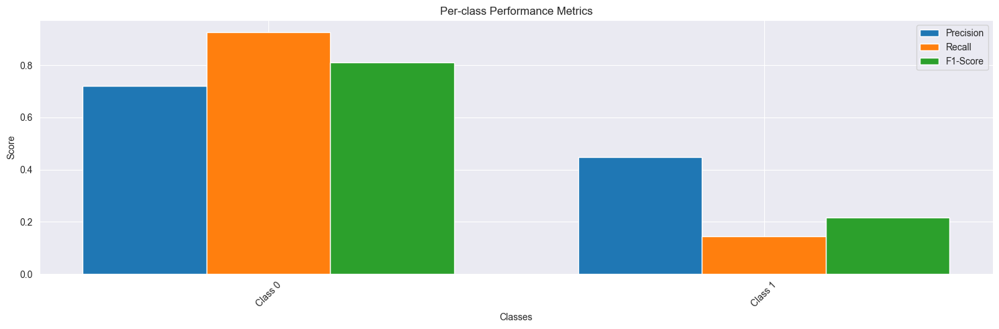


Other metrics:
loss: 0.5336
accuracy: 0.8087
precision: 0.8087
recall: 0.8087
val_loss: 0.6666
val_accuracy: 0.6954
val_precision: 0.6954
val_recall: 0.6954
val_per_class_f1: 0.5142

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5336 - accuracy: 0.8087 - precision: 0.8087 - recall: 0.8087 - per_class_f1: 0.7995 - val_loss: 0.6666 - val_accuracy: 0.6954 - val_precision: 0.6954 - val_recall: 0.6954 - val_per_class_f1: 0.5142


2024-11-13 14:44:43,517 - INFO - Shuffled data for next epoch


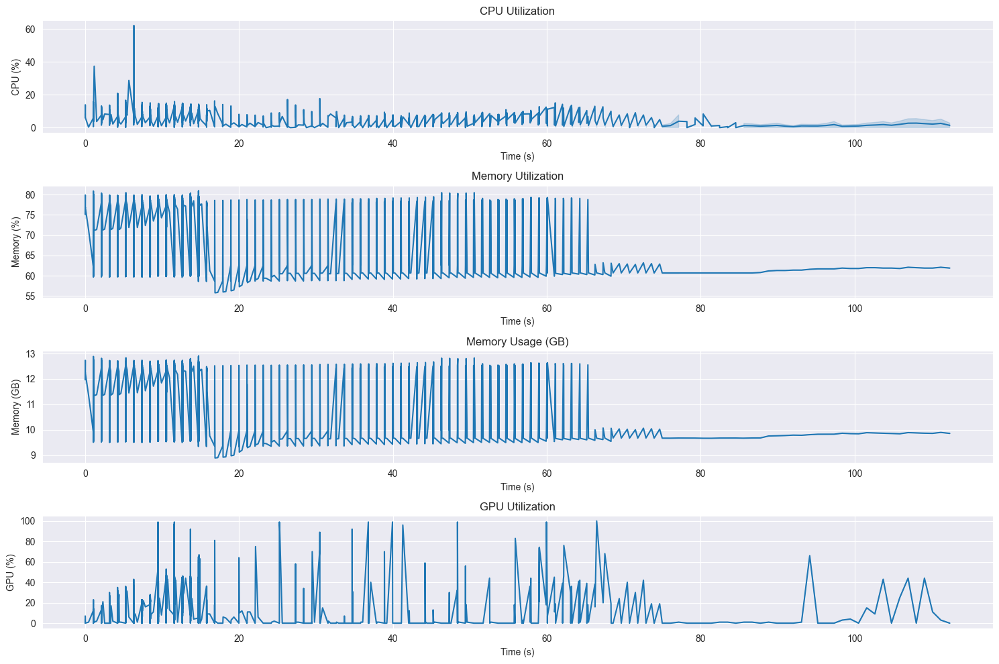



Local epochs:  67%|██████▋   | 4/6 [01:22<00:41, 20.54s/it]


Resource Usage Summary:
duration_seconds: 14.71
avg_cpu_percent: 6.77
max_cpu_percent: 62.20
avg_memory_gb: 11.75
max_memory_gb: 12.91
avg_memory_percent: 73.74
max_memory_percent: 81.00
avg_gpu_percent: 19.38
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2389.28
max_gpu_memory_mb: 2415.00

Epoch 4/6
Loss: 0.5336, Val Loss: 0.6666
Accuracy: 0.8087, Val Accuracy: 0.6954

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5325 - accuracy: 0.7954 - precision: 0.7954 - recall: 0.7954 - per_class_f1: 0.7852
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7511  0.8288    0.7880
Class 1     0.4551  0.3423    0.3907

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6031  0.5855    0.5894


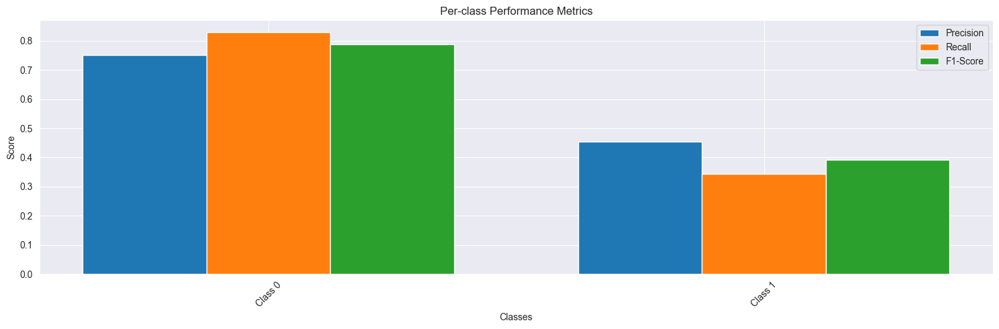


Other metrics:
loss: 0.5325
accuracy: 0.7954
precision: 0.7954
recall: 0.7954
val_loss: 0.6554
val_accuracy: 0.6855
val_precision: 0.6855
val_recall: 0.6855
val_per_class_f1: 0.5894

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 296ms/step - loss: 0.5325 - accuracy: 0.7954 - precision: 0.7954 - recall: 0.7954 - per_class_f1: 0.7852 - val_loss: 0.6554 - val_accuracy: 0.6855 - val_precision: 0.6855 - val_recall: 0.6855 - val_per_class_f1: 0.5894


2024-11-13 14:45:04,039 - INFO - Shuffled data for next epoch


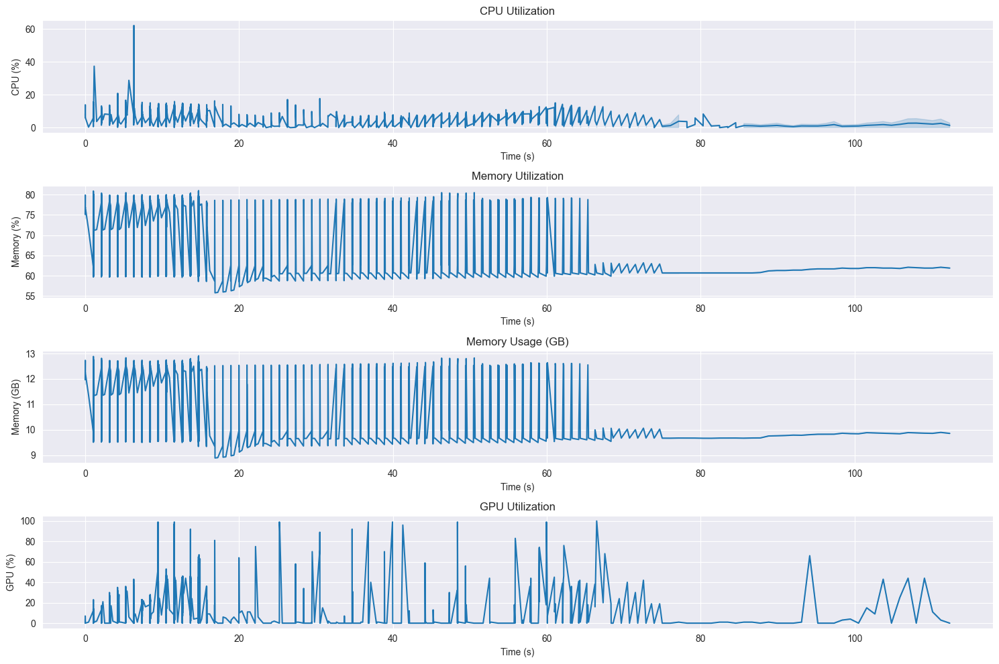



Local epochs:  83%|████████▎ | 5/6 [01:42<00:20, 20.56s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 6.77
max_cpu_percent: 62.20
avg_memory_gb: 11.75
max_memory_gb: 12.91
avg_memory_percent: 73.77
max_memory_percent: 81.00
avg_gpu_percent: 19.40
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2389.45
max_gpu_memory_mb: 2415.00

Epoch 5/6
Loss: 0.5325, Val Loss: 0.6554
Accuracy: 0.7954, Val Accuracy: 0.6855

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5247 - accuracy: 0.8045 - precision: 0.8045 - recall: 0.8045 - per_class_f1: 0.7922
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7586  0.7488    0.7537
Class 1     0.4167  0.4296    0.4230

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5877  0.5892    0.5884


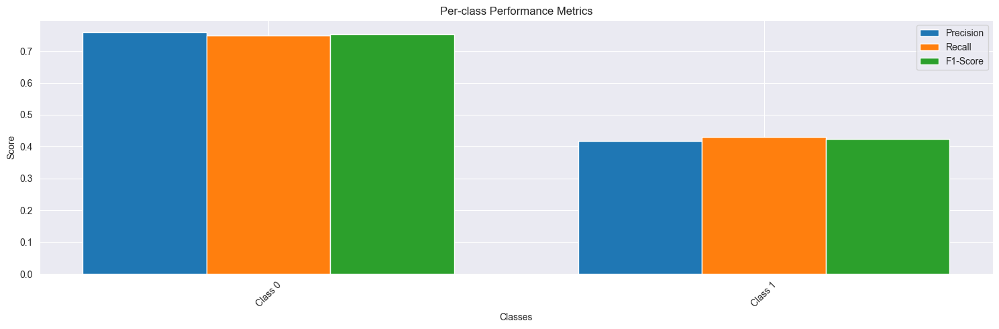


Other metrics:
loss: 0.5247
accuracy: 0.8045
precision: 0.8045
recall: 0.8045
val_loss: 0.7098
val_accuracy: 0.6548
val_precision: 0.6548
val_recall: 0.6548
val_per_class_f1: 0.5884

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 296ms/step - loss: 0.5247 - accuracy: 0.8045 - precision: 0.8045 - recall: 0.8045 - per_class_f1: 0.7922 - val_loss: 0.7098 - val_accuracy: 0.6548 - val_precision: 0.6548 - val_recall: 0.6548 - val_per_class_f1: 0.5884


2024-11-13 14:45:24,707 - INFO - Shuffled data for next epoch


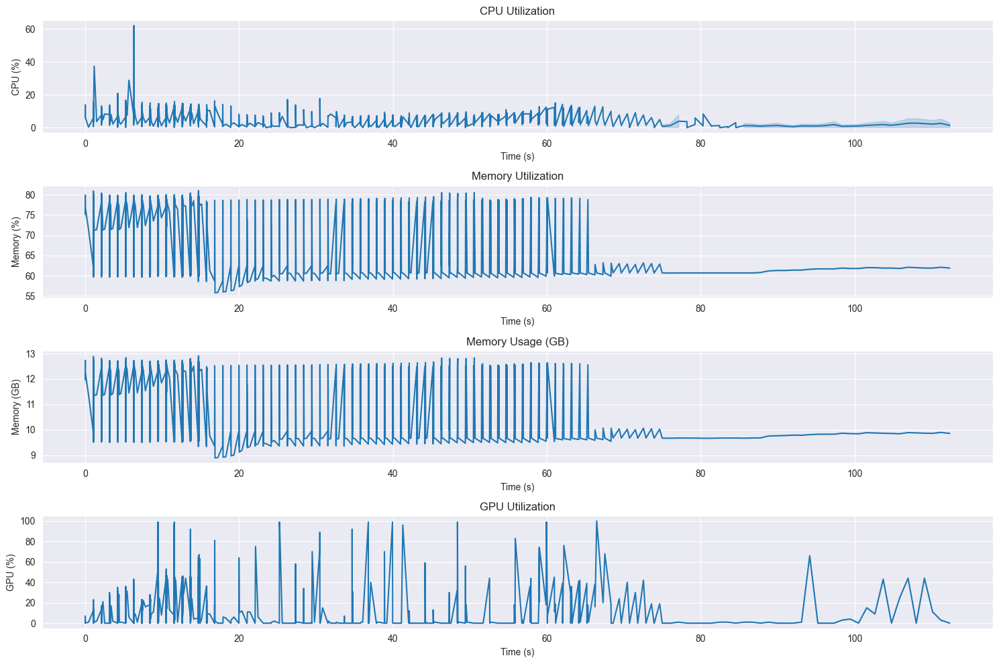



Local epochs: 100%|██████████| 6/6 [02:03<00:00, 20.56s/it]

Training Clients:  60%|██████    | 3/5 [05:28<03:47, 113.98s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.76
max_cpu_percent: 62.20
avg_memory_gb: 11.75
max_memory_gb: 12.91
avg_memory_percent: 73.79
max_memory_percent: 81.00
avg_gpu_percent: 19.43
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2389.62
max_gpu_memory_mb: 2415.00

Epoch 6/6
Loss: 0.5247, Val Loss: 0.7098
Accuracy: 0.8045, Val Accuracy: 0.6548

==================== Training Client 4 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5563 - accuracy: 0.8099 - precision: 0.8099 - recall: 0.8099 - per_class_f1: 0.8015
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7394  0.8429    0.7878
Class 1     0.4343  0.2887    0.3469

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5869  0.5658    0.5673


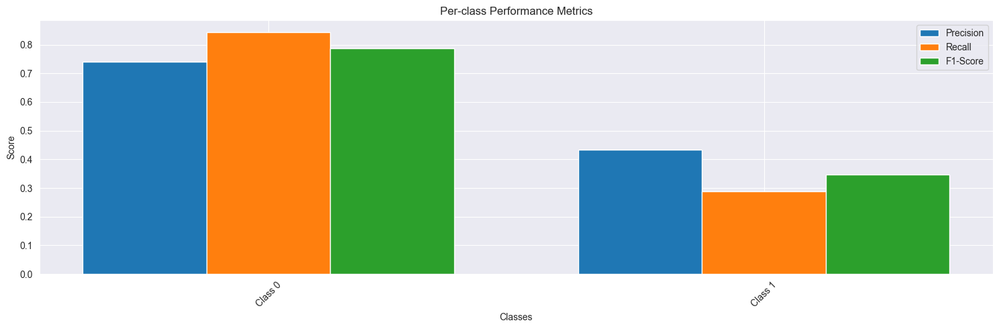


Other metrics:
loss: 0.5563
accuracy: 0.8099
precision: 0.8099
recall: 0.8099
val_loss: 0.7299
val_accuracy: 0.6797
val_precision: 0.6797
val_recall: 0.6797
val_per_class_f1: 0.5673

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 299ms/step - loss: 0.5563 - accuracy: 0.8099 - precision: 0.8099 - recall: 0.8099 - per_class_f1: 0.8015 - val_loss: 0.7299 - val_accuracy: 0.6797 - val_precision: 0.6797 - val_recall: 0.6797 - val_per_class_f1: 0.5673


2024-11-13 14:45:45,447 - INFO - Shuffled data for next epoch


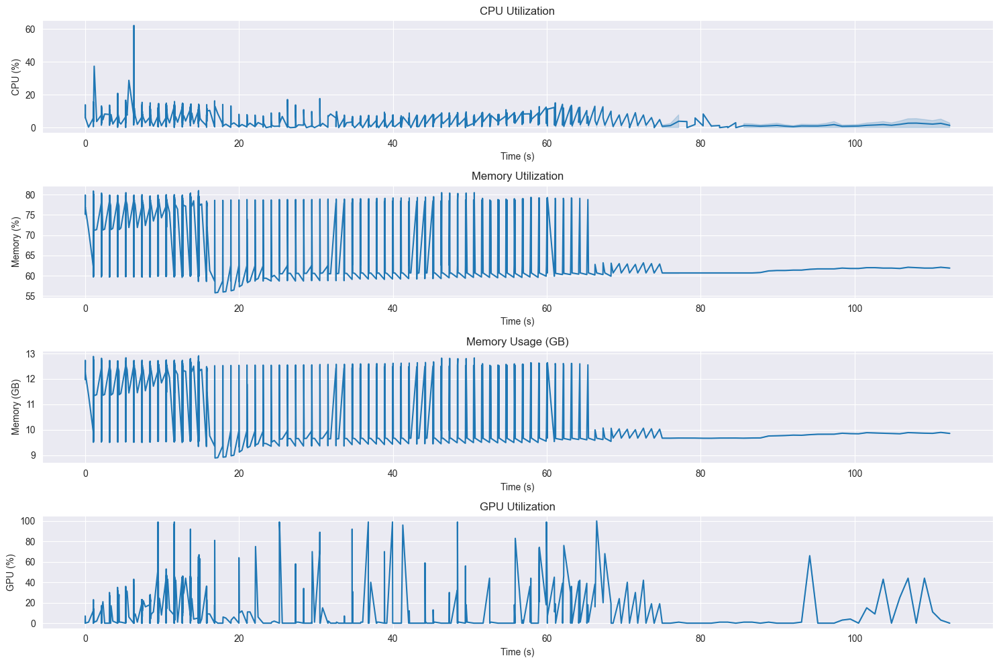



Local epochs:  17%|█▋        | 1/6 [00:20<01:43, 20.61s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 6.76
max_cpu_percent: 62.20
avg_memory_gb: 11.76
max_memory_gb: 12.91
avg_memory_percent: 73.82
max_memory_percent: 81.00
avg_gpu_percent: 19.45
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2389.79
max_gpu_memory_mb: 2415.00

Epoch 1/6
Loss: 0.5563, Val Loss: 0.7299
Accuracy: 0.8099, Val Accuracy: 0.6797

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5452 - accuracy: 0.8027 - precision: 0.8027 - recall: 0.8027 - per_class_f1: 0.7934
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7178  0.9324    0.8112
Class 1     0.4307  0.1225    0.1908

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5743  0.5274    0.5010


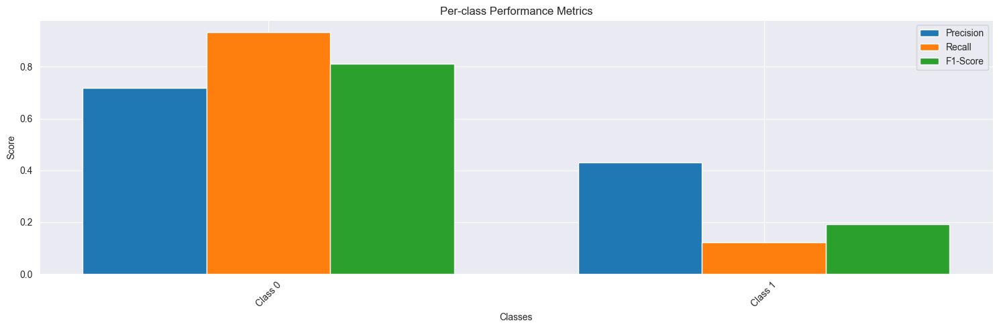


Other metrics:
loss: 0.5452
accuracy: 0.8027
precision: 0.8027
recall: 0.8027
val_loss: 1.2022
val_accuracy: 0.6938
val_precision: 0.6938
val_recall: 0.6938
val_per_class_f1: 0.5010

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 296ms/step - loss: 0.5452 - accuracy: 0.8027 - precision: 0.8027 - recall: 0.8027 - per_class_f1: 0.7934 - val_loss: 1.2022 - val_accuracy: 0.6938 - val_precision: 0.6938 - val_recall: 0.6938 - val_per_class_f1: 0.5010


2024-11-13 14:46:05,869 - INFO - Shuffled data for next epoch


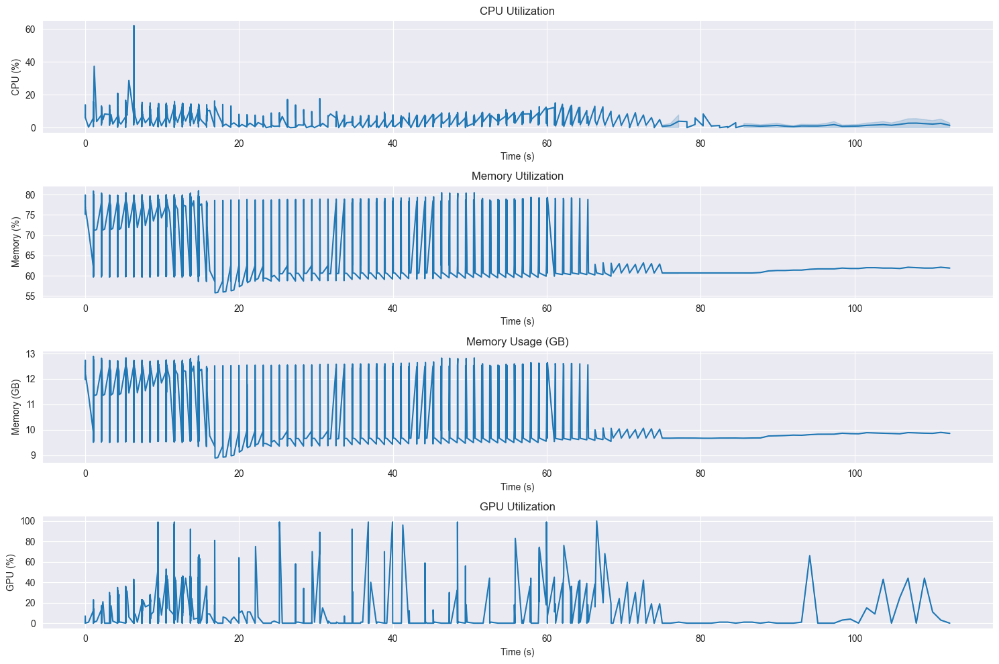



Local epochs:  33%|███▎      | 2/6 [00:41<01:22, 20.62s/it]


Resource Usage Summary:
duration_seconds: 14.77
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.76
max_memory_gb: 12.91
avg_memory_percent: 73.86
max_memory_percent: 81.00
avg_gpu_percent: 19.48
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2389.98
max_gpu_memory_mb: 2435.00

Epoch 2/6
Loss: 0.5452, Val Loss: 1.2022
Accuracy: 0.8027, Val Accuracy: 0.6938

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5190 - accuracy: 0.8171 - precision: 0.8171 - recall: 0.8171 - per_class_f1: 0.8080
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8762  0.2165    0.3472
Class 1     0.3307  0.9268    0.4874

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6034  0.5716    0.4173


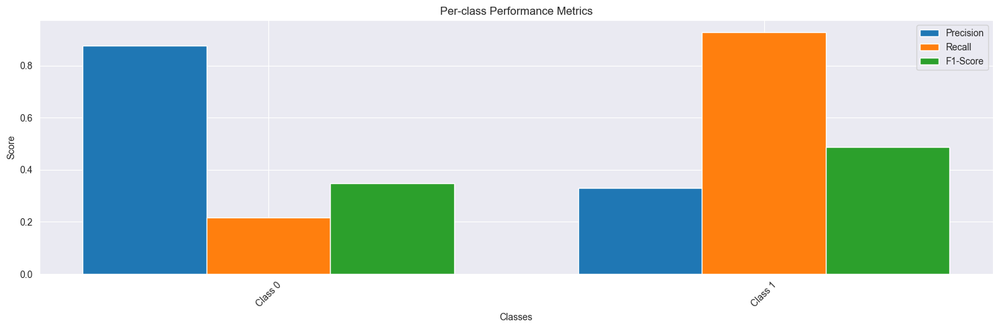


Other metrics:
loss: 0.5190
accuracy: 0.8171
precision: 0.8171
recall: 0.8171
val_loss: 1.2204
val_accuracy: 0.4257
val_precision: 0.4257
val_recall: 0.4257
val_per_class_f1: 0.4173

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 297ms/step - loss: 0.5190 - accuracy: 0.8171 - precision: 0.8171 - recall: 0.8171 - per_class_f1: 0.8080 - val_loss: 1.2204 - val_accuracy: 0.4257 - val_precision: 0.4257 - val_recall: 0.4257 - val_per_class_f1: 0.4173


2024-11-13 14:46:26,574 - INFO - Shuffled data for next epoch


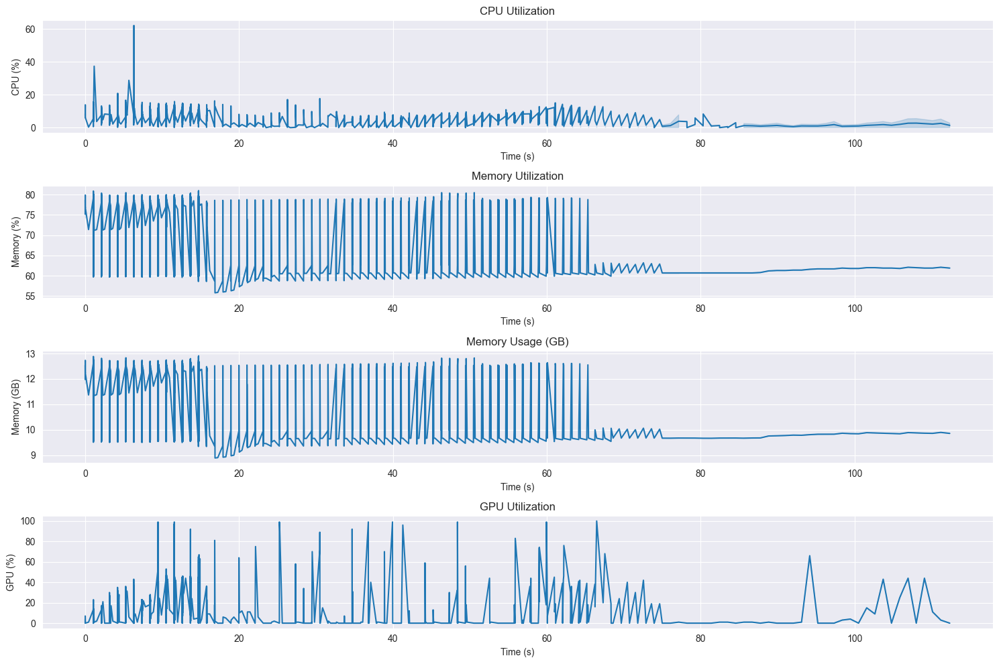



Local epochs:  50%|█████     | 3/6 [01:01<01:01, 20.62s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.76
max_cpu_percent: 62.20
avg_memory_gb: 11.77
max_memory_gb: 12.91
avg_memory_percent: 73.89
max_memory_percent: 81.00
avg_gpu_percent: 19.51
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2390.15
max_gpu_memory_mb: 2435.00

Epoch 3/6
Loss: 0.5190, Val Loss: 1.2204
Accuracy: 0.8171, Val Accuracy: 0.4257

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5159 - accuracy: 0.8087 - precision: 0.8087 - recall: 0.8087 - per_class_f1: 0.8007
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7271  0.9041    0.8060
Class 1     0.4493  0.1873    0.2644

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5882  0.5457    0.5352


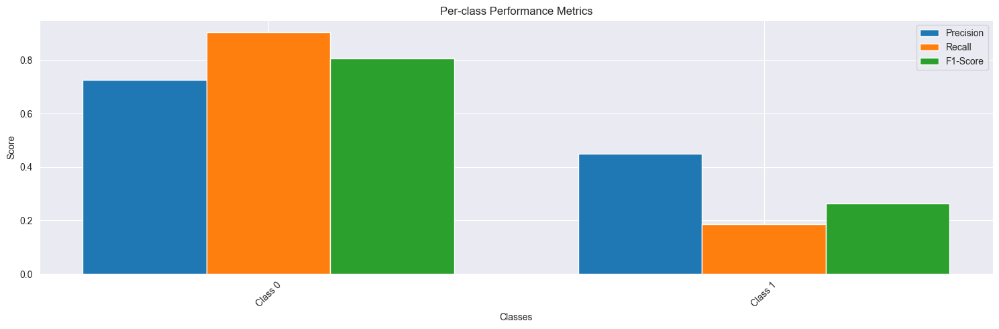


Other metrics:
loss: 0.5159
accuracy: 0.8087
precision: 0.8087
recall: 0.8087
val_loss: 0.6823
val_accuracy: 0.6929
val_precision: 0.6929
val_recall: 0.6929
val_per_class_f1: 0.5352

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 295ms/step - loss: 0.5159 - accuracy: 0.8087 - precision: 0.8087 - recall: 0.8087 - per_class_f1: 0.8007 - val_loss: 0.6823 - val_accuracy: 0.6929 - val_precision: 0.6929 - val_recall: 0.6929 - val_per_class_f1: 0.5352


2024-11-13 14:46:47,077 - INFO - Shuffled data for next epoch


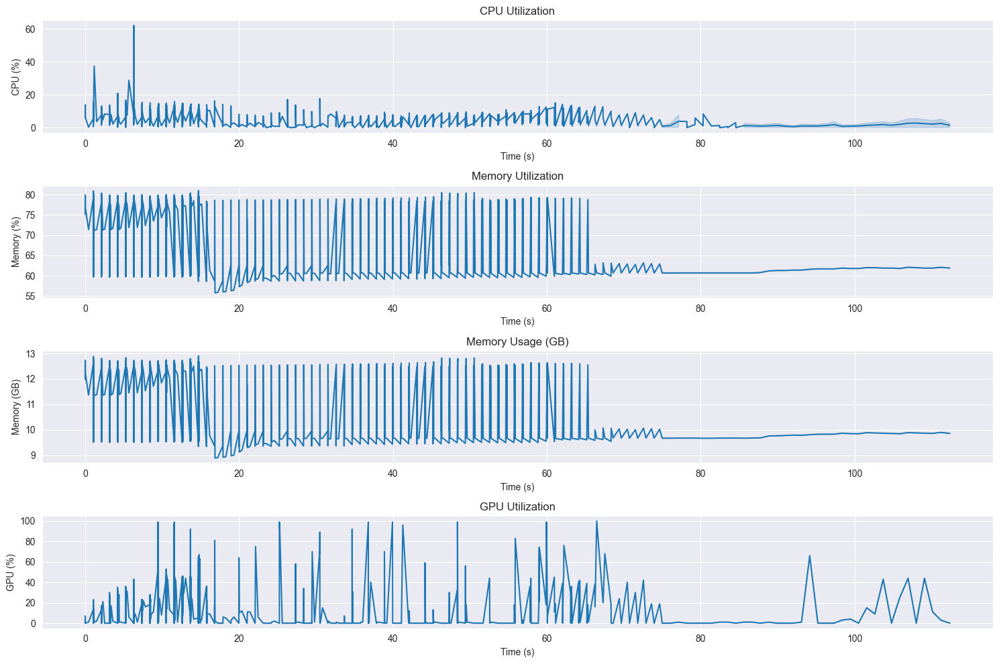



Local epochs:  67%|██████▋   | 4/6 [01:22<00:41, 20.63s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.77
max_memory_gb: 12.91
avg_memory_percent: 73.92
max_memory_percent: 81.00
avg_gpu_percent: 19.50
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2390.32
max_gpu_memory_mb: 2435.00

Epoch 4/6
Loss: 0.5159, Val Loss: 0.6823
Accuracy: 0.8087, Val Accuracy: 0.6929

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.4879 - accuracy: 0.8280 - precision: 0.8280 - recall: 0.8280 - per_class_f1: 0.8202
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7080  0.9512    0.8117
Class 1     0.3413  0.0606    0.1029

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5246  0.5059    0.4573


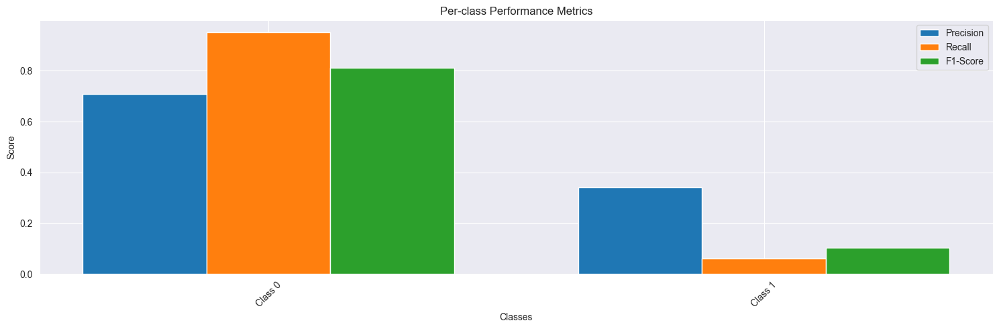


Other metrics:
loss: 0.4879
accuracy: 0.8280
precision: 0.8280
recall: 0.8280
val_loss: 0.9133
val_accuracy: 0.6888
val_precision: 0.6888
val_recall: 0.6888
val_per_class_f1: 0.4573

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 15s 296ms/step - loss: 0.4879 - accuracy: 0.8280 - precision: 0.8280 - recall: 0.8280 - per_class_f1: 0.8202 - val_loss: 0.9133 - val_accuracy: 0.6888 - val_precision: 0.6888 - val_recall: 0.6888 - val_per_class_f1: 0.4573


2024-11-13 14:47:07,674 - INFO - Shuffled data for next epoch


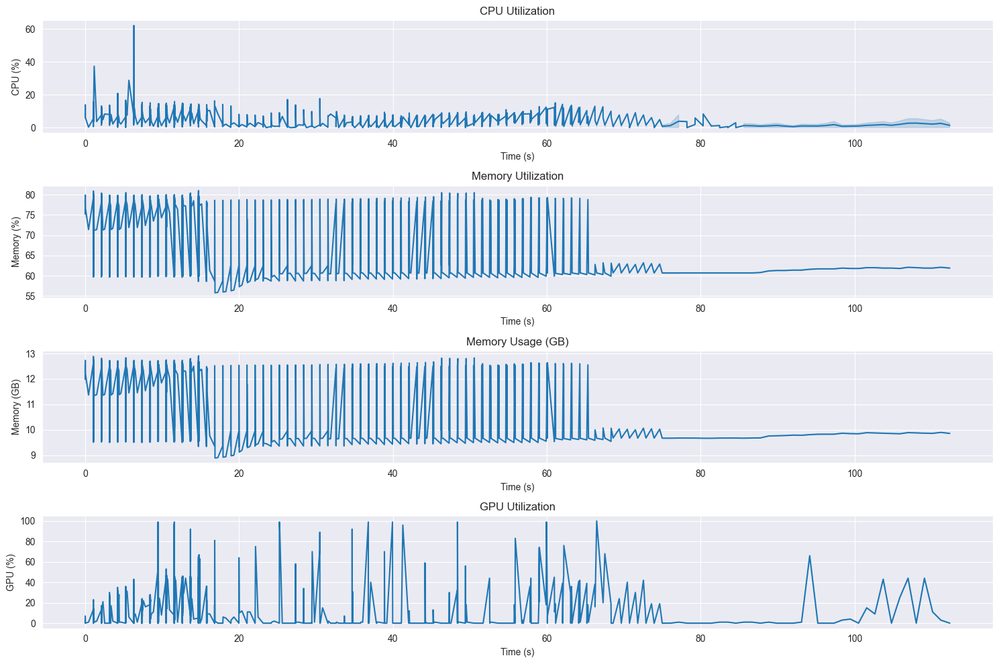



Local epochs:  83%|████████▎ | 5/6 [01:43<00:20, 20.63s/it]


Resource Usage Summary:
duration_seconds: 14.78
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.78
max_memory_gb: 12.91
avg_memory_percent: 73.95
max_memory_percent: 81.00
avg_gpu_percent: 19.55
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2390.48
max_gpu_memory_mb: 2435.00

Epoch 5/6
Loss: 0.4879, Val Loss: 0.9133
Accuracy: 0.8280, Val Accuracy: 0.6888

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.4817 - accuracy: 0.8316 - precision: 0.8316 - recall: 0.8316 - per_class_f1: 0.8239
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8235  0.4447    0.5775
Class 1     0.3673  0.7718    0.4977

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5954  0.6083    0.5376


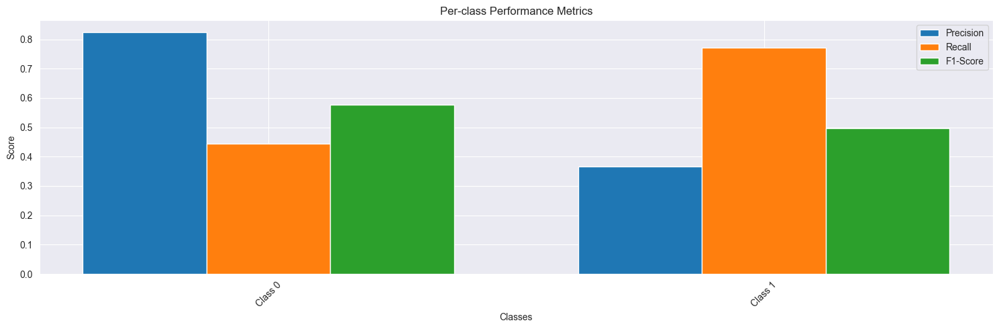


Other metrics:
loss: 0.4817
accuracy: 0.8316
precision: 0.8316
recall: 0.8316
val_loss: 0.9139
val_accuracy: 0.5411
val_precision: 0.5411
val_recall: 0.5411
val_per_class_f1: 0.5376

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 298ms/step - loss: 0.4817 - accuracy: 0.8316 - precision: 0.8316 - recall: 0.8316 - per_class_f1: 0.8239 - val_loss: 0.9139 - val_accuracy: 0.5411 - val_precision: 0.5411 - val_recall: 0.5411 - val_per_class_f1: 0.5376


2024-11-13 14:47:28,505 - INFO - Shuffled data for next epoch


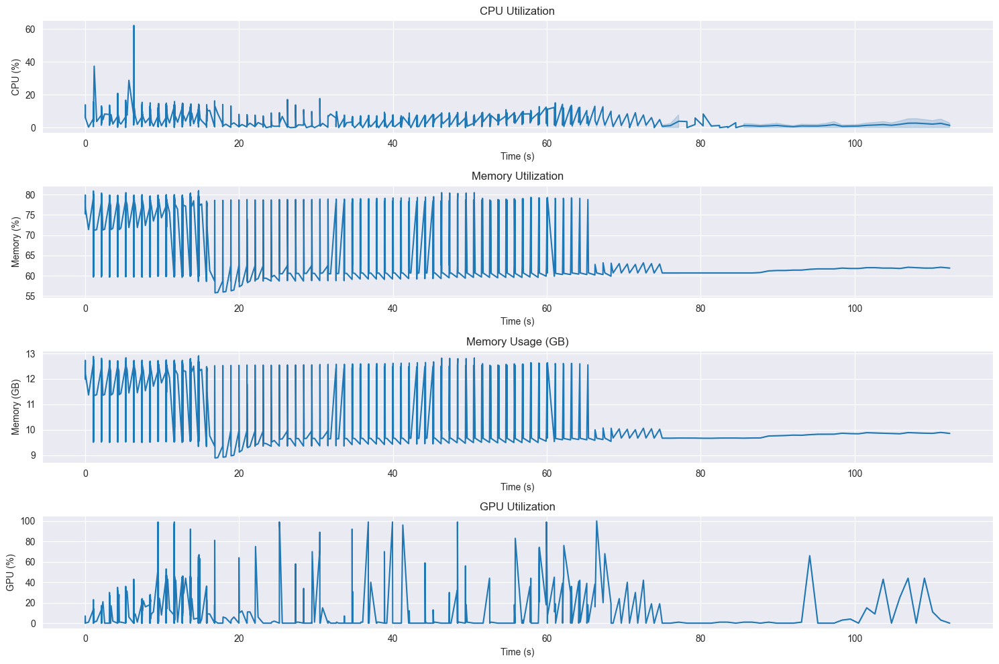



Local epochs: 100%|██████████| 6/6 [02:03<00:00, 20.63s/it]

Training Clients:  80%|████████  | 4/5 [07:32<01:57, 117.86s/it]


Resource Usage Summary:
duration_seconds: 14.76
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.78
max_memory_gb: 12.91
avg_memory_percent: 73.97
max_memory_percent: 81.00
avg_gpu_percent: 19.58
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2390.64
max_gpu_memory_mb: 2435.00

Epoch 6/6
Loss: 0.4817, Val Loss: 0.9139
Accuracy: 0.8316, Val Accuracy: 0.5411

==================== Training Client 5 ====================




Local epochs:   0%|          | 0/6 [00:00<?, ?it/s]


Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5496 - accuracy: 0.7988 - precision: 0.7988 - recall: 0.7988 - per_class_f1: 0.7894
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8542  0.4688    0.6054
Class 1     0.3886  0.8085    0.5249

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6214  0.6386    0.5652


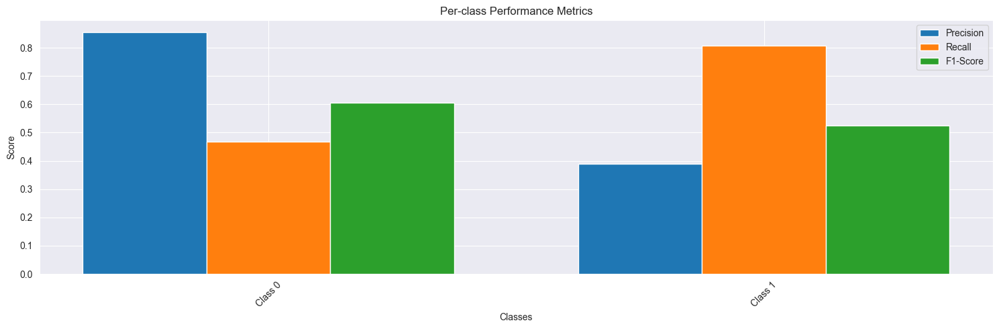


Other metrics:
loss: 0.5496
accuracy: 0.7988
precision: 0.7988
recall: 0.7988
val_loss: 0.9614
val_accuracy: 0.5689
val_precision: 0.5689
val_recall: 0.5689
val_per_class_f1: 0.5652

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 298ms/step - loss: 0.5496 - accuracy: 0.7988 - precision: 0.7988 - recall: 0.7988 - per_class_f1: 0.7894 - val_loss: 0.9614 - val_accuracy: 0.5689 - val_precision: 0.5689 - val_recall: 0.5689 - val_per_class_f1: 0.5652


2024-11-13 14:47:49,172 - INFO - Shuffled data for next epoch


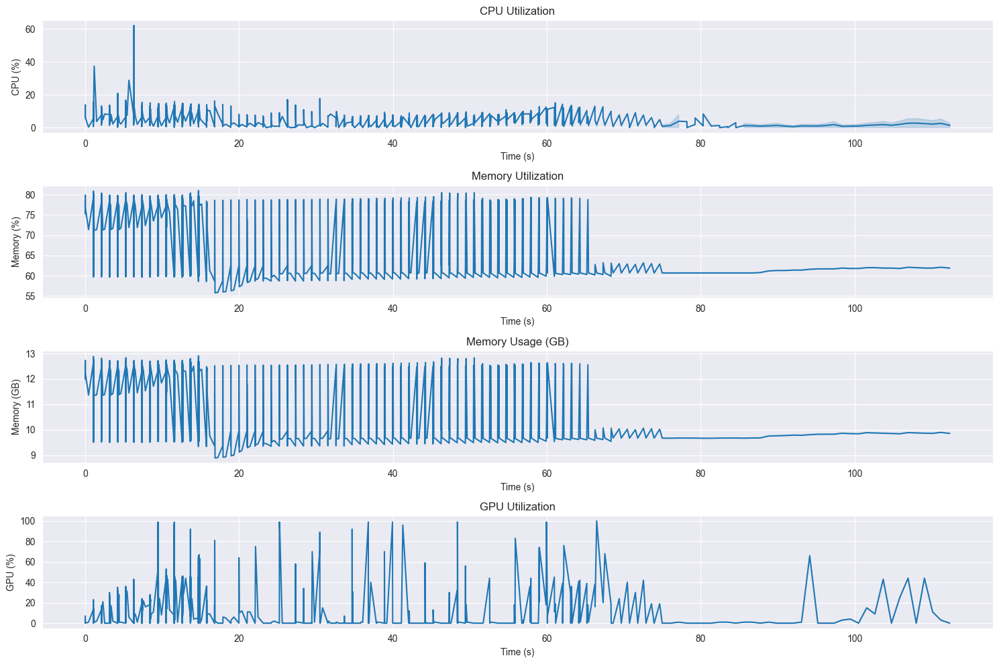



Local epochs:  17%|█▋        | 1/6 [00:20<01:43, 20.65s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.79
max_memory_gb: 12.91
avg_memory_percent: 74.00
max_memory_percent: 81.00
avg_gpu_percent: 19.58
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2390.80
max_gpu_memory_mb: 2435.00

Epoch 1/6
Loss: 0.5496, Val Loss: 0.9614
Accuracy: 0.7988, Val Accuracy: 0.5689

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5546 - accuracy: 0.8048 - precision: 0.8048 - recall: 0.8048 - per_class_f1: 0.7927
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8093  0.6665    0.7310
Class 1     0.4386  0.6239    0.5151

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6239  0.6452    0.6230


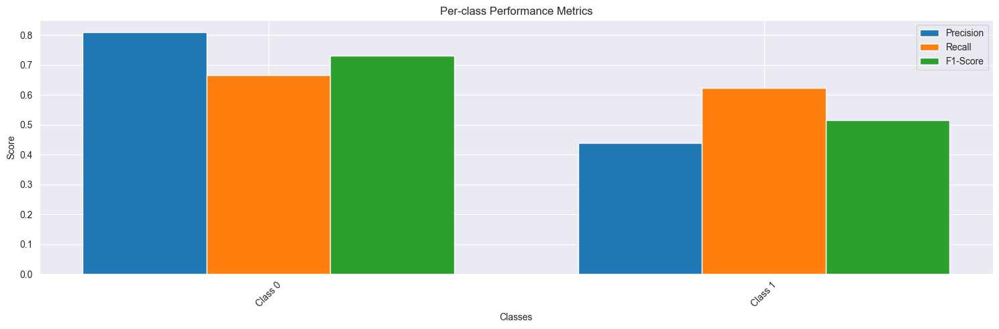


Other metrics:
loss: 0.5546
accuracy: 0.8048
precision: 0.8048
recall: 0.8048
val_loss: 0.7822
val_accuracy: 0.6539
val_precision: 0.6539
val_recall: 0.6539
val_per_class_f1: 0.6230

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 298ms/step - loss: 0.5546 - accuracy: 0.8048 - precision: 0.8048 - recall: 0.8048 - per_class_f1: 0.7927 - val_loss: 0.7822 - val_accuracy: 0.6539 - val_precision: 0.6539 - val_recall: 0.6539 - val_per_class_f1: 0.6230


2024-11-13 14:48:09,860 - INFO - Shuffled data for next epoch


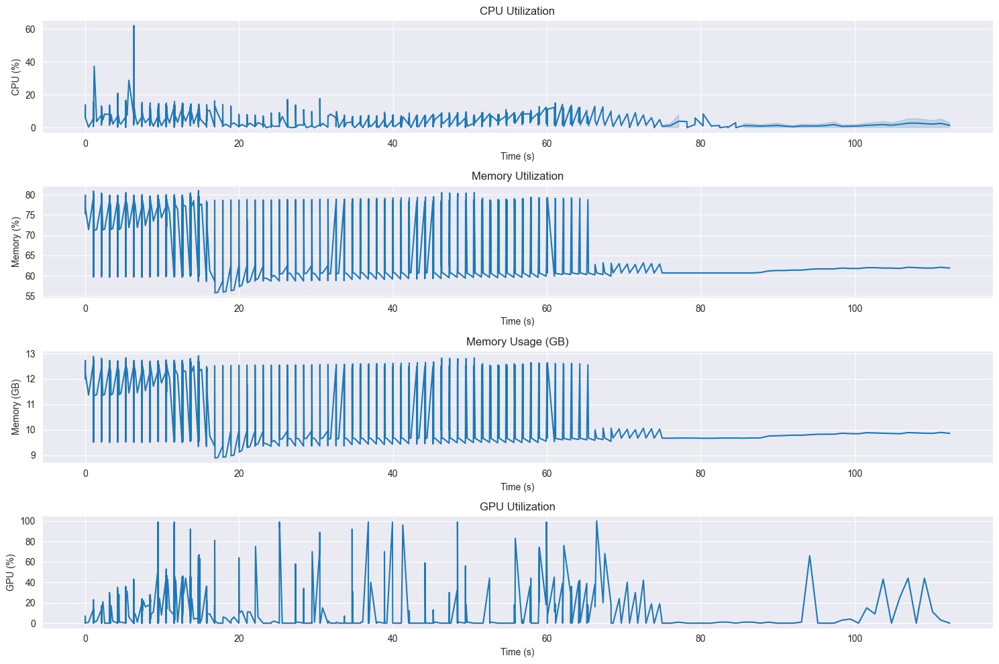



Local epochs:  33%|███▎      | 2/6 [00:41<01:22, 20.67s/it]


Resource Usage Summary:
duration_seconds: 14.74
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.79
max_memory_gb: 12.91
avg_memory_percent: 74.02
max_memory_percent: 81.00
avg_gpu_percent: 19.59
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2390.96
max_gpu_memory_mb: 2435.00

Epoch 2/6
Loss: 0.5546, Val Loss: 0.7822
Accuracy: 0.8048, Val Accuracy: 0.6539

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5374 - accuracy: 0.7964 - precision: 0.7964 - recall: 0.7964 - per_class_f1: 0.7850
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8186  0.6688    0.7362
Class 1     0.4486  0.6451    0.5292

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6336  0.6569    0.6327


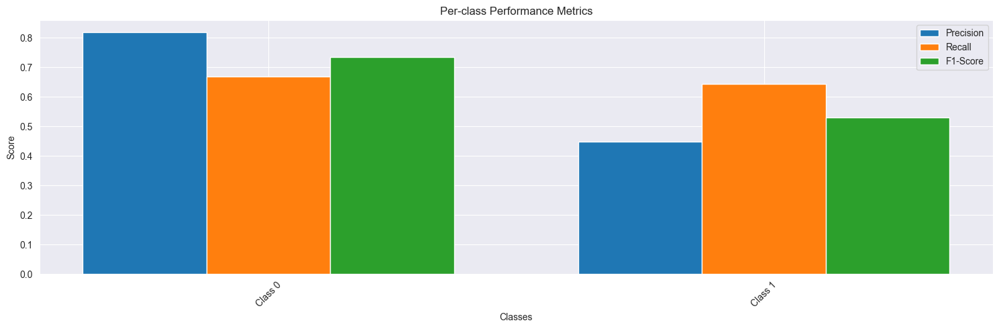


Other metrics:
loss: 0.5374
accuracy: 0.7964
precision: 0.7964
recall: 0.7964
val_loss: 0.7646
val_accuracy: 0.6618
val_precision: 0.6618
val_recall: 0.6618
val_per_class_f1: 0.6327

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 299ms/step - loss: 0.5374 - accuracy: 0.7964 - precision: 0.7964 - recall: 0.7964 - per_class_f1: 0.7850 - val_loss: 0.7646 - val_accuracy: 0.6618 - val_precision: 0.6618 - val_recall: 0.6618 - val_per_class_f1: 0.6327


2024-11-13 14:48:30,529 - INFO - Shuffled data for next epoch


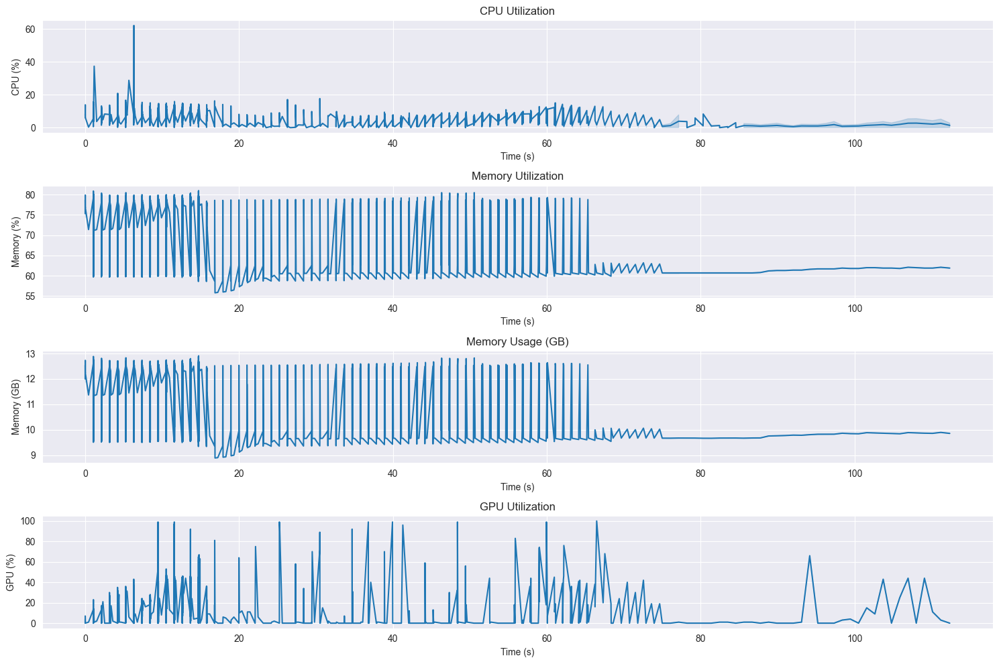



Local epochs:  50%|█████     | 3/6 [01:02<01:02, 20.68s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.79
max_memory_gb: 12.91
avg_memory_percent: 74.05
max_memory_percent: 81.00
avg_gpu_percent: 19.58
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2391.12
max_gpu_memory_mb: 2435.00

Epoch 3/6
Loss: 0.5374, Val Loss: 0.7646
Accuracy: 0.7964, Val Accuracy: 0.6618

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5180 - accuracy: 0.8217 - precision: 0.8217 - recall: 0.8217 - per_class_f1: 0.8117
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7184  0.9288    0.8102
Class 1     0.4292  0.1282    0.1974

Averages:
  Class  Precision  Recall  F1-Score
Average     0.5738  0.5285    0.5038


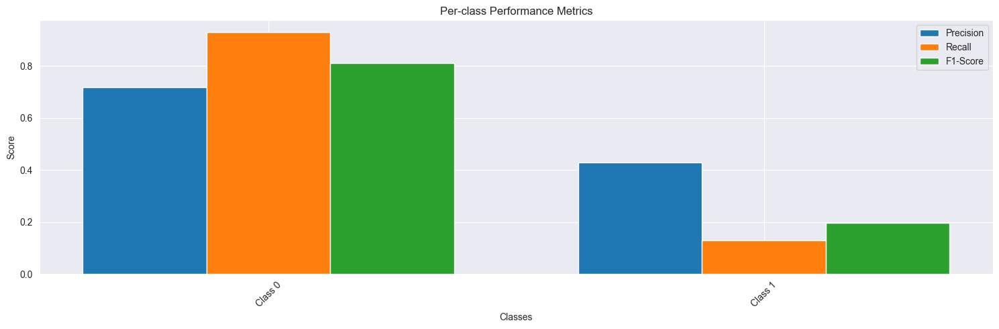


Other metrics:
loss: 0.5180
accuracy: 0.8217
precision: 0.8217
recall: 0.8217
val_loss: 0.7015
val_accuracy: 0.6929
val_precision: 0.6929
val_recall: 0.6929
val_per_class_f1: 0.5038

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 302ms/step - loss: 0.5180 - accuracy: 0.8217 - precision: 0.8217 - recall: 0.8217 - per_class_f1: 0.8117 - val_loss: 0.7015 - val_accuracy: 0.6929 - val_precision: 0.6929 - val_recall: 0.6929 - val_per_class_f1: 0.5038


2024-11-13 14:48:51,408 - INFO - Shuffled data for next epoch


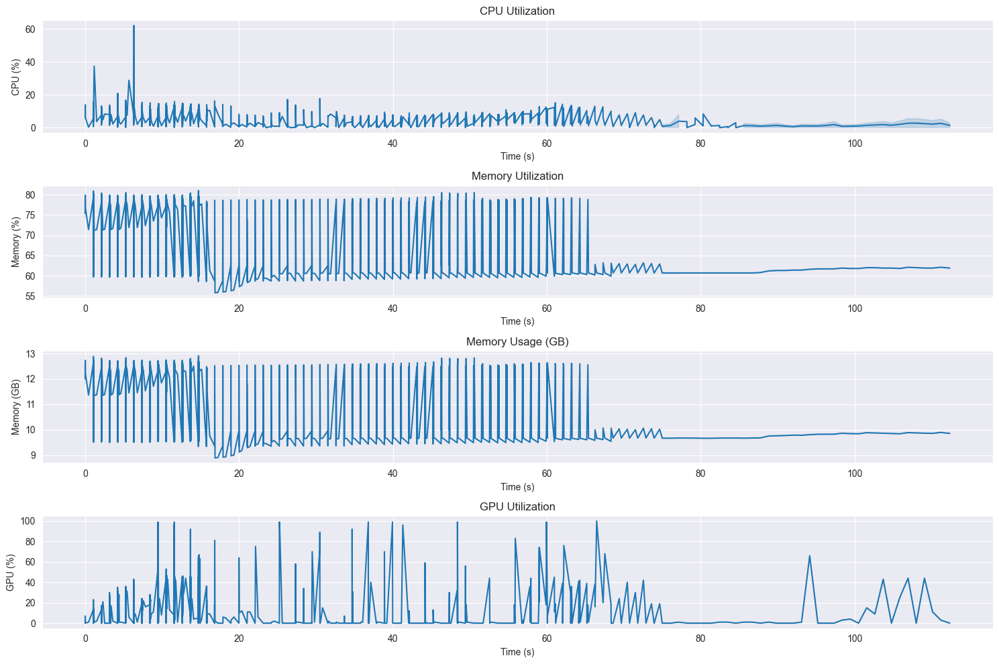



Local epochs:  67%|██████▋   | 4/6 [01:22<00:41, 20.69s/it]


Resource Usage Summary:
duration_seconds: 14.75
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.80
max_memory_gb: 12.91
avg_memory_percent: 74.08
max_memory_percent: 81.00
avg_gpu_percent: 19.58
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2391.27
max_gpu_memory_mb: 2435.00

Epoch 4/6
Loss: 0.5180, Val Loss: 0.7015
Accuracy: 0.8217, Val Accuracy: 0.6929

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5142 - accuracy: 0.8096 - precision: 0.8096 - recall: 0.8096 - per_class_f1: 0.8005
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.7561  0.8900    0.8176
Class 1     0.5428  0.3127    0.3968

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6495  0.6013    0.6072


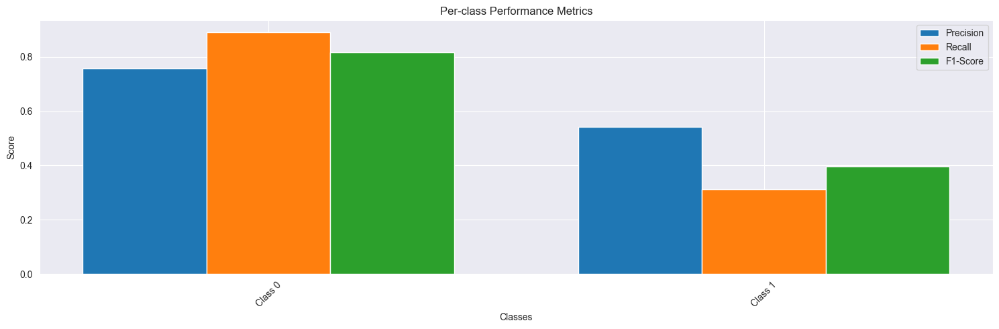


Other metrics:
loss: 0.5142
accuracy: 0.8096
precision: 0.8096
recall: 0.8096
val_loss: 0.7667
val_accuracy: 0.7199
val_precision: 0.7199
val_recall: 0.7199
val_per_class_f1: 0.6072

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 298ms/step - loss: 0.5142 - accuracy: 0.8096 - precision: 0.8096 - recall: 0.8096 - per_class_f1: 0.8005 - val_loss: 0.7667 - val_accuracy: 0.7199 - val_precision: 0.7199 - val_recall: 0.7199 - val_per_class_f1: 0.6072


2024-11-13 14:49:11,921 - INFO - Shuffled data for next epoch


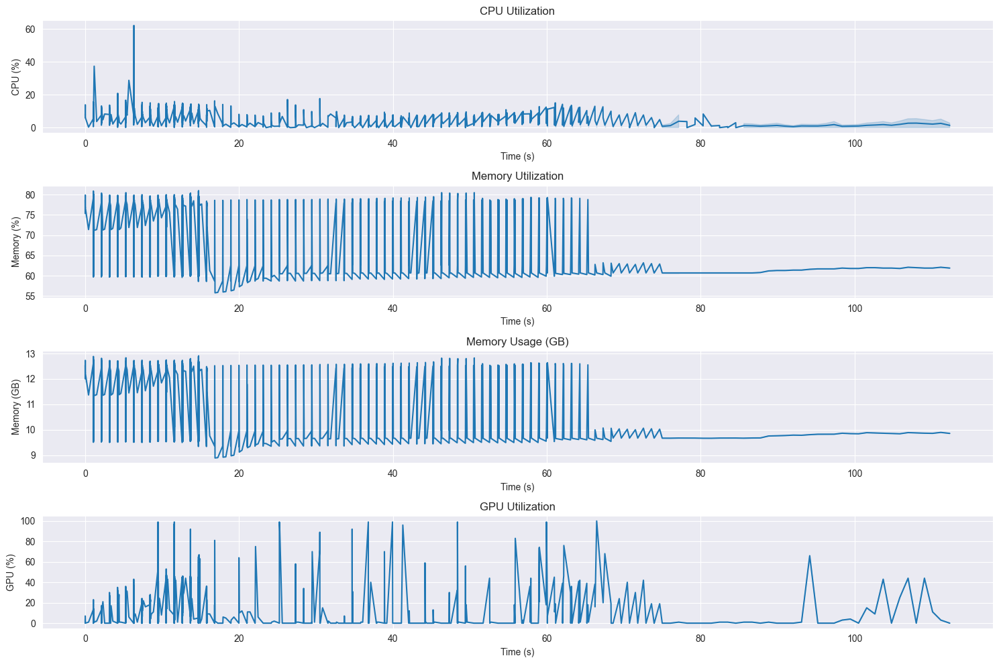



Local epochs:  83%|████████▎ | 5/6 [01:43<00:20, 20.71s/it]


Resource Usage Summary:
duration_seconds: 14.80
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.80
max_memory_gb: 12.91
avg_memory_percent: 74.10
max_memory_percent: 81.00
avg_gpu_percent: 19.60
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2391.42
max_gpu_memory_mb: 2435.00

Epoch 5/6
Loss: 0.5142, Val Loss: 0.7667
Accuracy: 0.8096, Val Accuracy: 0.7199

Epoch 1
52/52 [==============================] - ETA: 0s - loss: 0.5066 - accuracy: 0.8157 - precision: 0.8157 - recall: 0.8157 - per_class_f1: 0.8061
Per-class metrics:
  Class  Precision  Recall  F1-Score
Class 0     0.8329  0.5865    0.6883
Class 1     0.4204  0.7183    0.5304

Averages:
  Class  Precision  Recall  F1-Score
Average     0.6267  0.6524    0.6094


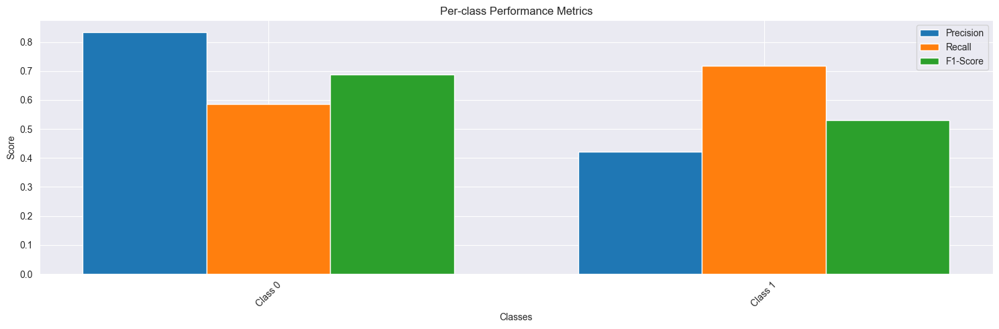


Other metrics:
loss: 0.5066
accuracy: 0.8157
precision: 0.8157
recall: 0.8157
val_loss: 0.7943
val_accuracy: 0.6253
val_precision: 0.6253
val_recall: 0.6253
val_per_class_f1: 0.6094

Epoch 1: val_accuracy did not improve from 0.72531
52/52 [==============================] - 16s 302ms/step - loss: 0.5066 - accuracy: 0.8157 - precision: 0.8157 - recall: 0.8157 - per_class_f1: 0.8061 - val_loss: 0.7943 - val_accuracy: 0.6253 - val_precision: 0.6253 - val_recall: 0.6253 - val_per_class_f1: 0.6094


2024-11-13 14:49:32,862 - INFO - Shuffled data for next epoch


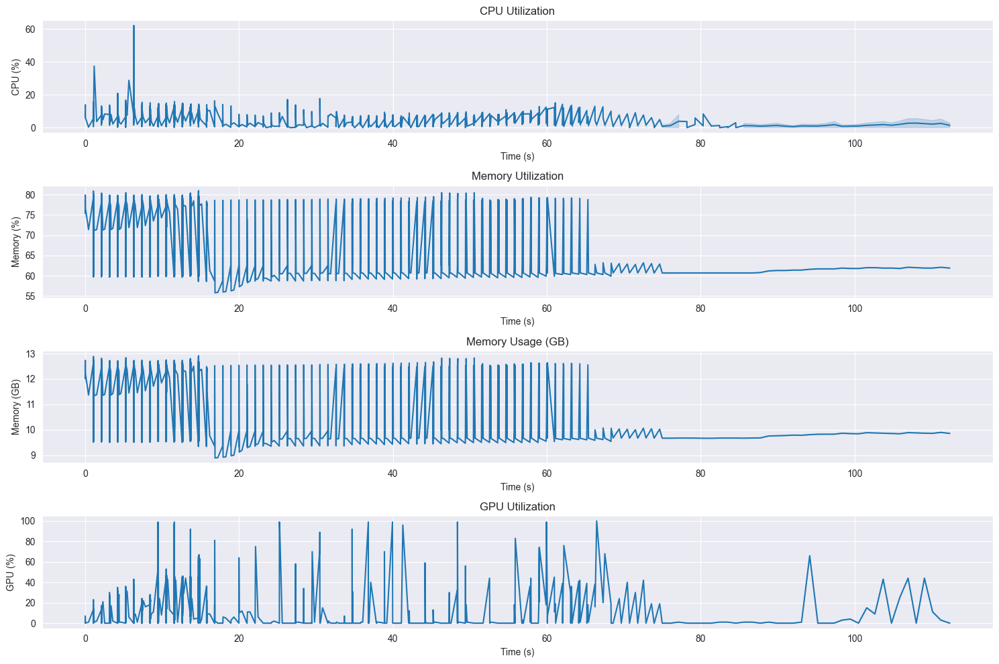



Local epochs: 100%|██████████| 6/6 [02:04<00:00, 20.70s/it]

Training Clients: 100%|██████████| 5/5 [09:36<00:00, 115.25s/it]


Resource Usage Summary:
duration_seconds: 14.73
avg_cpu_percent: 6.75
max_cpu_percent: 62.20
avg_memory_gb: 11.80
max_memory_gb: 12.91
avg_memory_percent: 74.11
max_memory_percent: 81.00
avg_gpu_percent: 19.62
max_gpu_percent: 100.00
avg_gpu_memory_mb: 2391.57
max_gpu_memory_mb: 2435.00

Epoch 6/6
Loss: 0.5066, Val Loss: 0.7943
Accuracy: 0.8157, Val Accuracy: 0.6253



Federated Learning Rounds: 100%|██████████| 5/5 [51:14<00:00, 614.96s/it]


Test metrics:
loss: 0.6327
accuracy: 0.6975
precision: 0.6975
recall: 0.6975
f1_metric: 0.4255

Round Summary:
val_loss: 0.7808
loss: 0.5084

Per-class F1 scores:
Class 0: 0.8488
Class 1: 0.7602
accuracy: 0.8146
precision: 0.8146
recall: 0.8146
val_accuracy: 0.6183
val_precision: 0.6183
val_recall: 0.6183
val_per_class_f1: 0.5882


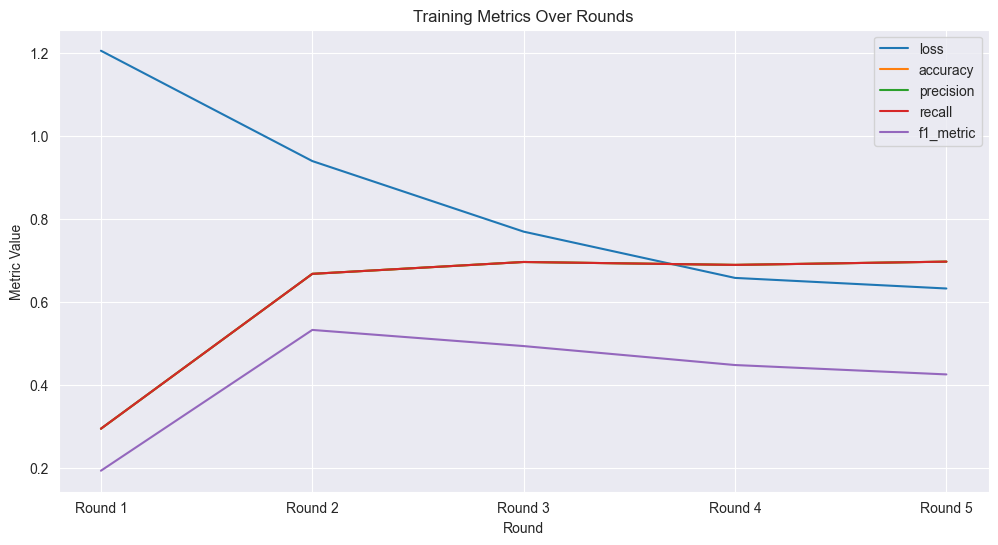

In [16]:
monitor.start()

server = create_federated_learning_system(
    num_clients=5,
    train_generator=train_generator,
    valid_generator=valid_generator,
    input_shape1=(64, 64, 3),
    input_shape2=(64, 64, 3),
    input_shape3=(64, 64, 3),
    num_classes=2
)

metrics_history = train_federated(
    server,
    num_rounds=5,
    local_epochs=6,
    test_generator=valid_generator,
    verbose=1
)

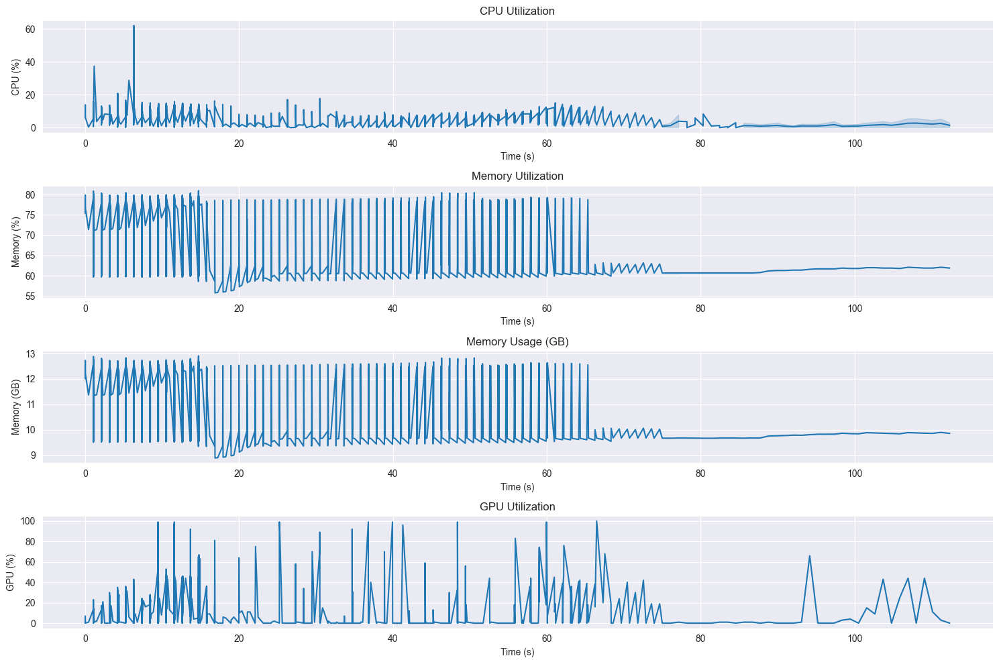

In [17]:
monitor.stop()
monitor.plot_resources()

In [57]:
train_generator.cleanup()
valid_generator.cleanup()

2024-11-13 07:10:55,772 - INFO - Successfully cleaned up resources
2024-11-13 07:10:55,780 - INFO - Successfully cleaned up resources
